# RG-A SIDIS Analysis

<!-- This code is to be run using the root files produced by the python script titled "makeROOT_histos.py" -->

In [1]:
%reset -f
import ROOT, numpy
import traceback

ROOT.TH1.AddDirectory(0)
ROOT.gStyle.SetTitleOffset(1.3,'y')

ROOT.gStyle.SetGridColor(17)
ROOT.gStyle.SetPadGridX(1)
ROOT.gStyle.SetPadGridY(1)

    
class color:
    PURPLE = '\033[95m'
    CYAN = '\033[96m'
    DARKCYAN = '\033[36m'
    BLUE = '\033[94m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    RED = '\033[91m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'
    DELTA = '\u0394' # symbol
    END = '\033[0m'
    
    
class root_color:
    # Colors
    White = 0
    Black = 1
    Red = 2
    Green = 3
    Blue = 4
    Yellow = 5
    Pink = 6
    Cyan = 7
    DGreen = 8 # Dark Green
    Purple = 9
    Grey = 13
    Brown = 28
    Gold = 41
    Rust = 46
    
    # Fonts
    Bold = '#font[22]'
    Italic = '#font[12]'
    
    # Symbols
    Delta = '#Delta'
    Phi = '#phi'
    π = '#pi'
    Degrees = '#circ'
    
    Line = '#splitline'
    


print(color.BOLD + "Starting RG-A SIDIS Analysis\n" + color.END)


runWith = "Real Data"        # Runs code using ONLY the 'real' reconstructed data files

# runWith = "Monte Carlo"    # Runs code using either the reconstructed or generated data from the Monte Carlo files

runWith = "Both"           # Runs code using both options from above


# For Monte Carlo Files:
gen_or_rec = "REC"      # Runs code using ONLY the reconstructed data from the Monte Carlo files

# gen_or_rec = "GEN"    # Runs code using ONLY the generated data from the Monte Carlo files

gen_or_rec = "Both"   # Runs code using BOTH types of Monte Carlo Data



list_of_DF = ['rdf']

if(runWith == "Real Data"):
    list_of_DF = ['rdf']
    
    print("".join(["Running with: ", str(runWith)]))
    
if(runWith == "Monte Carlo"):
    
    if(gen_or_rec == "REC"):
        list_of_DF = ['mdf']
        
    if(gen_or_rec == "GEN"):
        list_of_DF = ['gdf']
        
    if(gen_or_rec == "Both"):
        list_of_DF = ['mdf', 'gdf']
        
    print("".join(["Running with: ", str(runWith), " (", str(gen_or_rec), ")"]))
        
if(runWith == "Both"):
    
    if(gen_or_rec == "REC"):
        list_of_DF = ['rdf', 'mdf']
        
    if(gen_or_rec == "GEN"):
        list_of_DF = ['rdf', 'gdf']
        
    if(gen_or_rec == "Both"):
        list_of_DF = ['rdf', 'mdf', 'gdf']
        
    print("".join(["Running with: Real and MC Data (", str(gen_or_rec), ")"]))
        
    


print("\nDone")



Welcome to JupyROOT 6.22/06
Starting RG-A SIDIS Analysis

Running with: Real and MC Data (Both)

Done


.

.

# Finding Files (name)

In [2]:
def FileLocation(FileNum, Datatype):
    # location = "/lustre19/expphy/volatile/clas12/richcap/SIDIS_Analysis/Histo_Files_ROOT/"
    location = "Histo_Files_ROOT/"
    
    New_Name = ""

    if(str(Datatype) == 'rdf'):
        file = "".join(["REAL_Data/SIDIS_epip_Data_REC_", str(New_Name), str(FileNum), ".root"])
    if(str(Datatype) == 'mdf'):
        file = "".join(["Matching_REC_MC/SIDIS_epip_MC_Matched_", str(New_Name), str(FileNum), ".root"])
    if(str(Datatype) == 'gdf'):
        file = "".join(["GEN_MC/SIDIS_epip_MC_GEN_", str(New_Name), str(FileNum), ".root"])
        
    loading = "".join([location, file])
    
    return loading

print("Done")

Done


.

.

.

# Lists of Data Files Used

In [3]:
Common_File_Name = "Mom_Cor_Response_Matrix_V3_All"
Common_File_Name = "DNP_All"
Common_File_Name = "Unfolding_Tests_V1_All"
print("".join(["The Common File name to be used for all Data types is: ", color.BOLD, Common_File_Name, color.END]))

The Common File name to be used for all Data types is: Unfolding_Tests_V1_All


## Real Data Files

In [4]:
# Real Data Files (Full List)

# To remove a file from the overall data set, just comment out its line below

# To see a printed list of all file numbers being run for this data set, let print_num_of_files_q = 'yes'
print_num_of_files_q = 'yes'
print_num_of_files_q = 'no'


list_of_rdf_files = []

if(True):
    list_of_rdf_files.append(Common_File_Name)
else:
    print(color.BOLD + "\n\n\nNot using the common file name for this data type...\n\n\n" + color.END)

    list_of_rdf_files.append("DNP_V3_All")
    # list_of_rdf_files.append("Mom_Cor_Response_Matrix_V3_All")

    # list_of_rdf_files.append("Mom_Cor_Response_Matrix_V2_All")

    # list_of_rdf_files.append("Mom_Cor_Delta_P_Studies_All")


    # list_of_rdf_files.append("Bin_Test_Mom_Cor_Studies_All")

    # list_of_rdf_files.append("Bin_Test_Exclusive_Mom_Cor_All")
    # list_of_rdf_files.append("Bin_Test_Mom_Cor_All")
    # list_of_rdf_files.append("Bin_Test_GRC_All")

    # list_of_rdf_files.append("Bin_Test_20_V3_All")

    # list_of_rdf_files.append("Just_Q2_All")

    # list_of_rdf_files.append("Just_Q2_5116")

    # list_of_rdf_files.append("All")

    # list_of_rdf_files.append("5197")


print("Done making list_of_rdf_files.")
print("Length of list_of_rdf_files = " + str(len(list_of_rdf_files)))
if(print_num_of_files_q == 'yes'):
    print("Full list:\n" + str(list_of_rdf_files))


Done making list_of_rdf_files.
Length of list_of_rdf_files = 1


## MC REC Files

In [5]:
# MC REC Files (Full List)

# To remove a file from the overall data set, just comment out its line below

# To see a printed list of all file numbers being run for this data set, let print_num_of_files_q = 'yes'
print_num_of_files_q = 'yes'
print_num_of_files_q = 'no'


list_of_mdf_files = []

if(True):
    list_of_mdf_files.append(Common_File_Name)
else:
    print(color.BOLD + "\n\n\nNot using the common file name for this data type...\n\n\n" + color.END)

    list_of_mdf_files.append("Mom_Cor_Response_Matrix_V3_All")

    # list_of_mdf_files.append("Mom_Cor_Response_Matrix_V2_All")

    # list_of_mdf_files.append("Mom_Cor_Delta_P_Studies_All")
    # list_of_mdf_files.append("Bin_Test_Mom_Cor_Studies_All")

    # list_of_mdf_files.append("Bin_Test_Exclusive_Mom_Cor_All")
    # list_of_mdf_files.append("Bin_Test_Mom_Cor_All")
    # list_of_mdf_files.append("Bin_Test_GRC_All")

    # list_of_mdf_files.append("Bin_Test_20_V3_All")

    # # list_of_mdf_files.append("All")

    # # list_of_mdf_files.append("Purity_V14_New_All")

    # # list_of_mdf_files.append("Purity_V22_20_Bin_Test_3302_3")

    # list_of_mdf_files.append("Purity_V25_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V24_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V23_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V22_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V21_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V20_10_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V18_40_Bin_Test_All")
    # # list_of_mdf_files.append("Purity_V19_5_Bin_Test_All")
    # # list_of_mdf_files.append("Purity_V19_2_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V19_3_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V20_5_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V18_20_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V18_10_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V18_5_Bin_Test_All")

    # # list_of_mdf_files.append("Purity_V17_3166_0")

    # # list_of_mdf_files.append("Purity_V16_All")
    # # list_of_mdf_files.append("Purity_V15_All")
    # # list_of_mdf_files.append("Purity_V14_New_All")

    # # list_of_mdf_files.append("Purity_V14_All")

    # # list_of_mdf_files.append("Purity_V13_Incomplete")

    # # list_of_mdf_files.append("Purity_V11_All")
    # # list_of_mdf_files.append("Purity_V9_All")
    # # list_of_mdf_files.append("V8_All")


    # # list_of_mdf_files.append("V6_Most")
    # # list_of_mdf_files.append("V5_All")
    # # # list_of_mdf_files.append("V3_All")
    # # # list_of_mdf_files.append("V23147_4")
    # # # list_of_mdf_files.append("Test_3147_4")


print("Done making list_of_mdf_files.")
print("Length of list_of_mdf_files = " + str(len(list_of_mdf_files)))
if(print_num_of_files_q == 'yes'):
    print("Full list:\n" + str(list_of_mdf_files))


Done making list_of_mdf_files.
Length of list_of_mdf_files = 1


## MC GEN Files

In [6]:
# MC GEN Files (Full List)

# To remove a file from the overall data set, just comment out its line below

# To see a printed list of all file numbers being run for this data set, let print_num_of_files_q = 'yes'
print_num_of_files_q = 'yes'
print_num_of_files_q = 'no'


list_of_gdf_files = []

if(True):
    list_of_gdf_files.append(Common_File_Name)
else:
    print(color.BOLD + "\n\n\nNot using the common file name for this data type...\n\n\n" + color.END)
    

    list_of_gdf_files.append("Mom_Cor_Response_Matrix_V3_All")

    # list_of_gdf_files.append("Mom_Cor_Response_Matrix_V2_All")

    # list_of_gdf_files.append("Mom_Cor_Delta_P_Studies_All")
    # list_of_gdf_files.append("Bin_Test_Mom_Cor_Studies_All")

    # list_of_gdf_files.append("Bin_Test_Mom_Cor_All")
    # list_of_gdf_files.append("Bin_Test_GRC_All")

    # list_of_gdf_files.append("Bin_Test_20_V3_All")


    # list_of_gdf_files.append("All")

    # # list_of_gdf_files.append("3074_0")

    # # list_of_gdf_files.append("3051")
                         

print("Done making list_of_gdf_files.")
print("Length of list_of_gdf_files = " + str(len(list_of_gdf_files)))
if(print_num_of_files_q == 'yes'):
    print("Full list:\n" + str(list_of_gdf_files))


Done making list_of_gdf_files.
Length of list_of_gdf_files = 1


.

.

.

.

# Checking Loaded Information

### All Info

In [7]:
CheckDataFrameQ = 'y'
CheckDataFrameQ = 'n'

File_Type_to_Check = 'rdf'
# File_Type_to_Check = 'mdf'
# File_Type_to_Check = 'gdf'


if(File_Type_to_Check == 'rdf'):
    first_file = list_of_rdf_files[0]
if(File_Type_to_Check == 'mdf'):
    first_file = list_of_mdf_files[0]
if(File_Type_to_Check == 'gdf'):
    first_file = list_of_gdf_files[0]

rdf = ROOT.TFile(str(FileLocation(str(first_file), str(File_Type_to_Check))), "READ")


if(CheckDataFrameQ == 'y'):
    print("".join(["\nPrinting the full list of histogram names saved in the (first ", str(File_Type_to_Check), ") root file loaded...\n"]))
    
    for ii in rdf.GetListOfKeys():
#         if("Mom_Cor_Histos" in ii.GetName()):
#         if("Response_Matrix" not in ii.GetName()):
        print("".join([str(ii.GetName()), "   -----   object type: ", str(type(rdf.Get(ii.GetName())))]))
    
    
else:
    print("Not printing the full list of histograms saved in the file loaded.")
    print("To see what variables are available to be referenced by the code, let CheckDataFrameQ = 'y' (does not affect how the rest of the code runs).")
    
    
print("".join(["\n\tTotal length of ", str(FileLocation(str(first_file), str(File_Type_to_Check))), " = ", str(len(rdf.GetListOfKeys()))]))

# c1D = ROOT.TCanvas("c1Name", "c1Name", 400, 400)
# c1D.Divide(1, 1, 0, 0)
# c1D.SetGrid()
# ROOT.gStyle.SetAxisColor(16,'xy')
# ROOT.gStyle.SetOptStat(1)
# ROOT.gStyle.SetOptFit(1)
    
# c1D.Draw("same")

# c1D.cd(1)

# rdf.Get(str(('3D -> 1D Histogram -  With All Cuts', 'gdf', '', -1, 'MM'))).Draw("lego")

# print("test")
    
# print("\nTotal number of histograms available = "+str(len(rdf.GetListOfKeys())))


Printing the full list of histogram names saved in the (first rdf) root file loaded...

(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '-1', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '1', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '2', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '3', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '4', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '5', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '6', 'Q2', 'xB')   -----   object type: <class cppyy.gbl.TH3D at 0x561241fc8230>
(2D His

### Number of Histograms in (first) Files

In [8]:
for File_Type_to_Check in list_of_DF:
    if(File_Type_to_Check == 'rdf'):
        first_file = list_of_rdf_files[0]
    if(File_Type_to_Check == 'mdf'):
        first_file = list_of_mdf_files[0]
    if(File_Type_to_Check == 'gdf'):
        first_file = list_of_gdf_files[0]

    rdf = ROOT.TFile(str(FileLocation(str(first_file), str(File_Type_to_Check))), "READ")

    print("Total number of histograms available in " + File_Type_to_Check + " = "+str(len(rdf.GetListOfKeys())))
    
    rdf.Close()

Total number of histograms available in rdf = 150
Total number of histograms available in mdf = 348
Total number of histograms available in gdf = 65


.

### Getting total number of events per dataset/file

In [9]:
Show_Individual = 'y'
Show_Individual = 'n'

Total_Num_Events, out_list = {}, []

for File_Type_to_Check in list_of_DF:
    
    print("".join(["\nFile type = \033[1m", File_Type_to_Check, "\033[0m\n"]))
    
    if(File_Type_to_Check == 'rdf'):
        list_of_files = list_of_rdf_files
    if(File_Type_to_Check == 'mdf'):
        list_of_files = list_of_mdf_files
    if(File_Type_to_Check == 'gdf'):
        list_of_files = list_of_gdf_files
        
    Total_Num_Events[File_Type_to_Check] = 0
    
    for file in list_of_files:

        rdf = ROOT.TFile(str(FileLocation(str(file), str(File_Type_to_Check))), "READ")

        for ii in rdf.GetListOfKeys():

            out = (ii.GetName().replace("'3D -> 1D Histogram - ", "'")).replace(", '', -1, 'Q2'", "")
            out = (out.replace("'3D -> 1D Histogram - ", "'")).replace(", '', -1, 'Q2'", "")
            out = (out.replace("'3D -> 1D Histogram - ", "'")).replace(", '', -1, 'Q2'", "")
            
            out = (out.replace("'3D -> 1D Histogram - ", "'")).replace("'', -1, 'Q2_", "'")
            
            
            if("2D" not in out and 'Q2' in ii.GetName()):
                # print(str(ii.GetName()) + "   -----   object type: " + str(type(rdf.Get(ii.GetName()))))
                h1 = rdf.Get(str(ii.GetName())).Clone()

                Total_Num_Events[out] = int(h1.GetEntries())
                
                out_list.append((out))
                
                if(Show_Individual == 'y'):
                    print("".join(["Total_Num_Events['", out, "'] = ", str(Total_Num_Events[out]), "\n"]))
                
                if(File_Type_to_Check in out and Total_Num_Events[str(File_Type_to_Check)] < Total_Num_Events[str(out)]):
                    Total_Num_Events[File_Type_to_Check] = Total_Num_Events[out]
    
    print("".join(["Total_Num_Events['", File_Type_to_Check, "'] = ", str(Total_Num_Events[File_Type_to_Check]), "\n"]))
                    
                    
        
        
# if(runWith == "Both" and gen_or_rec == "Both"):
#     print("".join(["\nFile type = \033[1m tdf \033[0m\n"]))
#     test_done = []
#     for getting_tdf in out_list:
#         getting_tdf_2 = ((getting_tdf.replace("rdf", "tdf")).replace("mdf", "tdf")).replace("gdf", "tdf")

#         cut_name_current = str(((((getting_tdf.replace(", 'smeared')", ")")).replace(", 'rdf')", "")).replace(", 'mdf')", "")).replace(", 'gdf')", "")))


#         if(cut_name_current not in test_done):
#             test_done.append(cut_name_current)
#         else:
#             continue


#         mdf_num = "".join([cut_name_current, ", 'mdf')"])
#         if("Smear" in cut_name_current):
#             mdf_num = "".join([cut_name_current, ", 'mdf', 'smeared')"])

#         correction_factor_all = Total_Num_Events[mdf_num]/Total_Num_Events["(' No Cuts', 'gdf')"]

#         if(correction_factor_all != 0):
#             Total_Num_Events[getting_tdf_2] = int(Total_Num_Events["".join([(cut_name_current.replace(" (Smeared)", "")).replace("new", "New"), ", 'rdf')"])]/correction_factor_all)
#         else:
#             Total_Num_Events[getting_tdf_2] = 0
#             print("\n\nERROR\n\n")

#         print("".join(["Total_Num_Events['", getting_tdf_2, "'] = ", str(Total_Num_Events[getting_tdf_2]), "\n"]))




File type = rdf

Total_Num_Events['rdf'] = 189816238


File type = mdf

Total_Num_Events['mdf'] = 355226247


File type = gdf

Total_Num_Events['gdf'] = 5844207654



.

.

.

.

# Alerts and Timers (Initializing)

In [88]:
# To run an alert, set the variable to 'yes' (tells the code to run that alert)

# 'runAlert' is the main alert command which will sound off after the last line of this code to notify you that the whole code is finished (must always run this alert if any other one is to be run)
runAlert = 'yes'
# runAlert = 'no'


if(runAlert == 'yes'):
    # """ jupyter addin shows starttime, elapsedtime; sounds alert on cell finish
    import time
    from IPython.core.magics.execution import _format_time
    from IPython.display import display as d
    from IPython.display import Audio
    from IPython.core.display import HTML
    import numpy as np
    import logging as log

    def alert():
    #     """ makes sound on client using javascript (works with remote server) """      
        framerate = 44100
        duration=1
        freq=300
        t = np.linspace(0,duration,framerate*duration)
        data = np.sin(2*np.pi*freq*t)
        d(Audio(data,rate=framerate, autoplay=True))
        
    
    alert()
    print("Alert is set.")
else:
    print("There will be no alerts when this code is run.")

Alert is set.


.

.

## Clock

In [11]:
# import datetime class from datetime module
from datetime import datetime
print("Starting production of histograms...")

# getting current date
datetime_object_full = datetime.now()
# print(datetime_object)

startMin_full = datetime_object_full.minute
startHr_full = datetime_object_full.hour

if(datetime_object_full.minute <10):
    timeMin_full = '0'+str(datetime_object_full.minute)
else:
    timeMin_full = str(datetime_object_full.minute)

# printing current time
if(datetime_object_full.hour > 12 and datetime_object_full.hour < 24):
    print("The time that the code started is "+str((datetime_object_full.hour)-12)+":"+timeMin_full+" p.m.")
if(datetime_object_full.hour < 12 and datetime_object_full.hour > 0):
    print("The time that the code started is "+str(datetime_object_full.hour)+":"+timeMin_full+" a.m.")
if(datetime_object_full.hour == 12):
    print("The time that the code started is "+str(datetime_object_full.hour)+":"+timeMin_full+" p.m.")
if(datetime_object_full.hour == 0 or datetime_object_full.hour == 24):
    print("The time that the code started is 12:"+timeMin_full+" a.m.")

Starting production of histograms...
The time that the code started is 1:11 p.m.


.

.

.

.

.

.

# Save results?

In [12]:
SaveChoice = 'yes'
SaveChoice = 'no'


Bin_Option_For_Save = "20_"

print("".join(["Saving results? \033[1m", str(SaveChoice), '\033[0m']))

if(SaveChoice == 'yes'):
    print("Images of results produced will be saved.")
    if(Bin_Option_For_Save != ""):
        print("".join(["Option for extra (common) part of saved files:\n\n\t'", Bin_Option_For_Save, "'\n"]))
        # Bin_Option_For_Save add text in front of every file saved while running this code to give the files a common group name when needed (can be left as "" if not needed)
else:
    print("Not saving results.")


Saving results? no
Not saving results.


.

.

.

.

.

.

.

.

.

# Functions to help with Histograms

## Variable Titles

In [13]:
def variable_Title_name(variable):

    smeared_named = ''

    if("_smeared" in variable):
        smeared_named = 'yes'
        variable = variable.replace("_smeared","")

    output = 'error'    

    if(variable == 'el_E'):
        output = 'E_{el}'
    if(variable == 'pip_E'):
        output = 'E_{#pi^{+}}'
    if(variable == 'el'):
        output = "p_{el}"
    if(variable == 'pip'):
        output = "p_{#pi^{+}}"
    if(variable == 'elth'):
        output = "#theta_{el}"
    if(variable == 'pipth'):
        output = "#theta_{#pi^{+}}"
    if(variable == 'elPhi'):
        output = "#phi_{el}"
    if(variable == 'pipPhi'):
        output = "#phi_{#pi^{+}}"
    if(variable == 'MM'):
        output = "Missing Mass"
    if(variable == 'MM2'):
        output = "Missing Mass^{2}"
    if(variable == 'Q2'):
        output = "Q^{2}"
    if(variable == 'xB'):
        output = "x_{B}"
    if(variable == 'v'):
        output = "#nu (lepton energy loss)"
    if(variable == 's'):
        output = "s (CM Energy^{2})"
    if(variable == 'W'):
        output = "W (Invariant Mass)"
    if(variable == 'y'):
        output = "y (lepton energy loss fraction)"
    if(variable == 'z'):
        output = "z"
    if(variable == 'epsilon'):
        output = "#epsilon"
    if(variable == 'pT'):
        output = "P_{T}"
    if(variable == 'phi_t'):
        output = "#phi_{h}"
    if(variable == 'xF'):
        output = "x_{F} (Feynman x)"
    if(variable == 'pipx_CM'):
        output = "CM p_{#pi^{+}} in #hat{x}"
    if(variable == 'pipy_CM'):
        output = "CM p_{#pi^{+}} in #hat{y}"
    if(variable == 'pipz_CM'):
        output = "CM p_{#pi^{+}} in #hat{z}"
    if(variable == 'qx_CM'):
        output = "CM p_{q} in #hat{x}"
    if(variable == 'qy_CM'):
        output = "CM p_{q} in #hat{y}"
    if(variable == 'qz_CM'):
        output = "CM p_{q} in #hat{z}"
    if(variable == 'beamX_CM'):
        output = "CM p_{beam} in #hat{x}"
    if(variable == 'beamY_CM'):
        output = "CM p_{beam} in #hat{y}"
    if(variable == 'beamZ_CM'):
        output = "CM p_{beam} in #hat{z}"
    if(variable == 'eleX_CM'):
        output = "CM p_{el} in #hat{x}"
    if(variable == 'eleY_CM'):
        output = "CM p_{el} in #hat{y}"
    if(variable == 'eleZ_CM'):
        output = "CM p_{el} in #hat{z}"
    if(variable == 'event'):
        output = "Event Number"
    if(variable == 'runN'):
        output = "Run Number"
    if(variable == 'ex'):
        output = "Lab p_{el} in #hat{x}"
    if(variable == 'ey'):
        output = "Lab p_{el} in #hat{y}"
    if(variable == 'ez'):
        output = "Lab p_{el} in #hat{z}"
    if(variable == 'px'):
        output = "Lab p_{#pi^{+}} in #hat{x}"
    if(variable == 'py'):
        output = "Lab p_{#pi^{+}} in #hat{y}"
    if(variable == 'pz'):
        output = "Lab p_{#pi^{+}} in #hat{z}"
    if(variable == 'esec'):
        output = "Electron Sector"
    if(variable == 'pipsec'):
        output = "#pi^{+} Sector"
    # if(variable == 'esec_a'):
    if('esec_a' in variable):
        output = "Electron Sector (Angle Def)"
    # if(variable == 'pipsec_a'):
    if('pipsec_a' in variable):
        output = "#pi^{+} Sector (Angle Def)"
    if(variable == 'Q2_xB_Bin'):
        output = "Q^{2}-x_{B} Bin"
    if(variable == 'Q2_xB_Bin_2'):
        output = "Q^{2}-x_{B} Bin (New)"
    if(variable == 'z_pT_Bin'):
        output = "z-p_{T} Bin"
    if(variable == 'elec_events_found'):
        output = "Number of Electrons Found"
    if(variable == 'Delta_Smear_El_P'):
        output = "#Delta_{Smeared}p_{el}"
    if(variable == 'Delta_Smear_El_Th'):
        output = "#Delta_{Smeared}#theta_{el}"
    if(variable == 'Delta_Smear_El_Phi'):
        output = "#Delta_{Smeared}#phi_{el}"
    if(variable == 'Delta_Smear_Pip_P'):
        output = "#Delta_{Smeared}p_{#pi^{+}}"
    if(variable == 'Delta_Smear_Pip_Th'):
        output = "#Delta_{Smeared}#theta_{#pi^{+}}"
    if(variable == 'Delta_Smear_Pip_Phi'):
        output = "#Delta_{Smeared}#phi_{#pi^{+}}"
    if("Bin_4D" in variable):
        output = "".join(["Combined 4D Bin", " (Original)" if("OG" in variable) else ""])



    if(smeared_named == 'yes'):
        output = "".join([output, " (Smeared)"])

    if(output == 'error'):
        print("".join(["A variable name was not recognized.\nPlease assign a new name for variable = ", str(variable)]))
        output = str(variable)

    return output


print("Done")

Done


## Comparison Between Real and MC data

In [14]:
def percent_of_data_1D(h1):

    list_of_values_from_histo = []

    Num_of_Bins = h1.GetNbinsX()
    Total_Num_Events = h1.GetEntries()

    for bin_num in range(1, Num_of_Bins, 1):
        value_from_histo = h1.GetBinContent(bin_num)
        axis_value_from_histo = h1.GetBinCenter(h1.GetBin(bin_num))

        percent_of_entries_at_bin_num = (value_from_histo/Total_Num_Events)*100

        list_of_values_from_histo.append([percent_of_entries_at_bin_num, axis_value_from_histo])


    return list_of_values_from_histo



def Normalize_1D(h1, data_frame):
    
    ROOT.gStyle.SetAxisColor(16,'xy')
    ROOT.gStyle.SetOptFit(0)
    ROOT.gStyle.SetOptStat(0)
    

#     norm_factor = Total_Num_Events[data_frame]
    
    norm_factor = h1.Integral()
    h2 = h1.Clone()
    h2.Scale(100/norm_factor)

    # h2.SetTitle("".join(["#splitline{Normalized}{", str(h1.GetTitle()), "}"]))
    h2.SetTitle(str(h1.GetTitle()))
    
    if('rdf' in data_frame):
        h2.SetLineColor(4)
    if('mdf' in data_frame):
        h2.SetLineColor(2)
    if('gdf' in data_frame):
        h2.SetLineColor(3)
    if('tdf' in data_frame):
        h2.SetLineColor(6)
    else:
        h2.SetLineColor(5)
        
    h2.SetLineWidth(2)

    return h2


def Normalize_1D_Total(h1, data_frame):
    
    ROOT.gStyle.SetAxisColor(16,'xy')
    ROOT.gStyle.SetOptFit(0)
    ROOT.gStyle.SetOptStat(0)
    
    
    if('rdf' in data_frame):
        norm_factor = Total_Num_Events['rdf'] + Total_Num_Events['mdf']
        
    if('gdf' in data_frame):
        norm_factor = Total_Num_Events['gdf'] + Total_Num_Events['mdf']
    
            
    h2 = h1.Clone()
    h2.Scale(100/norm_factor)

    h2.SetTitle("#splitline{Normalized to Combined Total}{"+str(h1.GetTitle())+"}")
    h2.SetTitle(str(h1.GetTitle()))
    
    if(data_frame == 'rdf'):
        h2.SetLineColor(4)
    if('mdf' in data_frame):
        h2.SetLineColor(2)
    if(data_frame == 'gdf'):
        h2.SetLineColor(3)
        
        
    h2.SetLineWidth(2)

    return h2



def comparing_Real_2_MC_1D(real_h, mc_h, title, xvalue, max_error_print, rel_OR_abs):
    
    ROOT.gStyle.SetAxisColor(16,'xy')
    ROOT.gStyle.SetOptFit(0)
    ROOT.gStyle.SetOptStat(0)
    
    # let:
    #    real_h -> real data
    #    mc_h -> MC data

    
    # rel_1 -> relative to the total number of events in rdf
    # rel_2 -> relative to the total number of events in mdf
    # rel_3 -> relative to the total number of events in gdf
    
    # rel_4 -> relative to the values in each bin for rdf
    # rel_5 -> relative to the values in each bin for mdf
    # rel_6 -> relative to the values in each bin for gdf
    
    
    # rel_4 and rel_6 are calculated the same way, where they both use real_h as the relative histogram (assumes that proper inputs were given - these variables only effect the titles)
 
    # dif -> Just returns the difference between real_h and mc_h
    
    dif_between_Real_and_MC = []
    axis_values = []

    
    if('ratio' != rel_OR_abs and 'correction' != rel_OR_abs and '%_error' != rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Add(mc_h,-1)
        # Temp_Histo.Rebin(2)

        if('dif' not in rel_OR_abs):

        #     if(rel_OR_abs != 'abs' and rel_OR_abs != 'rel_4' and rel_OR_abs != 'rel_5' and rel_OR_abs != 'rel_6'):
            if((rel_OR_abs == 'rel_1' or rel_OR_abs == 'rel_2' or rel_OR_abs == 'rel_3') and rel_OR_abs != 'rel_t'):
                norm_factor = Total_Num_Events[rel_dataframe]
                Temp_Histo.Scale(100/norm_factor)
            elif(rel_OR_abs != 'abs' and rel_OR_abs != 'rel_t'):
                if(rel_OR_abs != 'rel_5' and rel_OR_abs != 'rel_8'):
        #             print("Dividing by: " + real_h.GetTitle())
                    Temp_Histo.Divide(real_h)
                else:
        #             print("Dividing by: " + mc_h.GetTitle())
                    Temp_Histo.Divide(mc_h)
                Temp_Histo.Scale(100)


            if(rel_OR_abs == 'rel_t'):
                Average_histos = mc_h.Clone()
                Average_histos.Add(real_h)
                Average_histos.Scale(1/2)
                Temp_Histo.Divide(Average_histos)
                Temp_Histo.Scale(100)


        if(rel_OR_abs == 'rel_dif_%'):
            total_val = 0
            for bin_num in range(0, real_h.GetNbinsX(), 1):
                total_val += abs(real_h.GetBinContent(bin_num))
            if(total_val != 0):
                Temp_Histo.Scale(1/total_val) 
            else:
                print("Error with :" + str(title))
                
                
               
    if('ratio' == rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Divide(mc_h)
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; Acceptance Correction Factor: #frac{MC GEN}{MC REC}")
        Temp_Histo.SetLineColor(1)
        # Temp_Histo.SetFillColor(6)
        Temp_Histo.SetLineColor(4)
        
    if('ratio2' == rel_OR_abs):
        Temp_Histo = mc_h.Clone()
        Temp_Histo.Divide(real_h)
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; Acceptance Correction Factor: #frac{MC REC}{MC GEN}")
        Temp_Histo.SetLineColor(1)
        # Temp_Histo.SetFillColor(6)
        Temp_Histo.SetLineColor(3)
        
    if('correction' == rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Multiply(mc_h)
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; Normalized (Corrected) % Values")
        Temp_Histo.SetLineColor(6)
        # Temp_Histo.SetFillColor(6)
        # Temp_Histo.SetFillStyle(3001)
        
    if('correction2' == rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Divide(mc_h)
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; Normalized (Corrected) % Values")
        Temp_Histo.SetLineColor(6)
        # Temp_Histo.SetFillColor(6)
        # Temp_Histo.SetFillStyle(3001)
        
    if('%_error' == rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Add(mc_h,-1)
        Temp_Histo.Divide(real_h)
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #splitline{% Error (of Normalized Values)}{Relative to Real}")
        Temp_Histo.SetLineColor(6)
        # Temp_Histo.SetFillColor(6)
        # Temp_Histo.SetFillStyle(3001)
        
    
    if('frac' in rel_OR_abs):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Divide(mc_h)
        
        frac_title = "".join([str(title), ";", str(xvalue), "; Normalized #frac{REAL}{MC ", rel_OR_abs.replace("frac_", ""), "}"])
        
        Temp_Histo.SetTitle(str(frac_title))
        Temp_Histo.SetLineColor(1)
        
        if("REC" in rel_OR_abs):
            Temp_Histo.SetLineColor(2)
        if("GEN" in rel_OR_abs):
            Temp_Histo.SetLineColor(3)
        
        
        

    if(rel_OR_abs == 'rel_t'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(" + str(xvalue) + ")}{Average of Data Sets} (% Dif)")
        Temp_Histo.SetLineColor(1)
    if(rel_OR_abs == 'abs'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #Delta(Normalized " + str(xvalue) + ") (% of Respective Totals)")
        Temp_Histo.SetLineColor(1)
    if(rel_OR_abs == 'rel_1'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Total Real Data}")
        Temp_Histo.SetLineColor(4)
    if(rel_OR_abs == 'rel_2'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Total MC (REC) Data}")
        Temp_Histo.SetLineColor(2)
    if(rel_OR_abs == 'rel_3'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Total MC (GEN) Data}")
        Temp_Histo.SetLineColor(3)
        
    if(rel_OR_abs == 'rel_4'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Normalized Real " + str(xvalue) + "} (% Dif)")
        Temp_Histo.SetLineColor(4)
    if(rel_OR_abs == 'rel_5'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Normalized MC (REC) " + str(xvalue) + "} (% Dif)")
        Temp_Histo.SetLineColor(2)
    if(rel_OR_abs == 'rel_6'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(Normalized " + str(xvalue) + ")}{Normalized MC (GEN) " + str(xvalue) + "} (% Dif)")
        Temp_Histo.SetLineColor(3)
        
        
    if(rel_OR_abs == 'rel_7'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(" + str(xvalue) + " Counts)}{Real " + str(xvalue) + " Counts} (% Dif)")
        Temp_Histo.SetLineColor(4)
    if(rel_OR_abs == 'rel_8'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(" + str(xvalue) + " Counts)}{MC (REC) " + str(xvalue) + " Counts} (% Dif)")
        Temp_Histo.SetLineColor(2)
    if(rel_OR_abs == 'rel_9'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(" + str(xvalue) + " Counts)}{MC (GEN) " + str(xvalue) + " Counts} (% Dif)")
        Temp_Histo.SetLineColor(3)
        
        
    if(rel_OR_abs == 'dif'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #Delta(" + str(xvalue) + ") (Counts)")
        Temp_Histo.SetLineColor(1)
    if(rel_OR_abs == 'dif_%'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #Delta(" + str(xvalue) + ") (% of Respective Totals)")
        Temp_Histo.SetLineColor(1)
        
        
    if(rel_OR_abs == 'rel_dif_%'):
        Temp_Histo.SetTitle(str(title) + ";" + str(xvalue) + "; #frac{#Delta(" + str(xvalue) + ")}{Total % of Real}")
        Temp_Histo.SetLineColor(4)
        
        
    Ave_Or_Peak = "Peak"
    Ave_Or_Peak = "Ave"
    Ave_Or_Peak = "Both"
#     Ave_Or_Peak = "None"

    Ave_Or_Peak = "Error_Ave"
        
    if(Ave_Or_Peak == "Peak"):
        if((abs(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())) >= max_error_print) and max_error_print != 0):
            print("Histogram Titled: '" + str(Temp_Histo.GetTitle()) + "' has exceeded the allowed error limit.")
            print("Maximum Value in Histogram = " + str(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())) + " (Error Limit = +/- " + str(max_error_print) + ")\n")
        if((abs(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) >= max_error_print) and max_error_print != 0):
            print("Histogram Titled: '" + str(Temp_Histo.GetTitle()) + "' has exceeded the allowed error limit.")
            print("Minimum Value in Histogram = " + str(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) + " (Error Limit = +/- " + str(max_error_print) + ")\n")
    
    if(Ave_Or_Peak == "Ave" or Ave_Or_Peak == "Both"):
        total_val_ave = 0
        for bin_num in range(0, Temp_Histo.GetNbinsX(), 1):
            total_val_ave += Temp_Histo.GetBinContent(bin_num)

        total_val_ave = total_val_ave/Temp_Histo.GetNbinsX()
        
        if((abs(total_val_ave) >= max_error_print) and max_error_print != 0 and Ave_Or_Peak == "Ave"):
            print("Histogram Titled: '" + str(Temp_Histo.GetTitle()) + "' has exceeded the allowed error limit.")
            print("Average Value of Histogram = " + str(total_val_ave) + " (Error Limit = +/- " + str(max_error_print) + ")\n")
            
        if(((abs(total_val_ave) >= max_error_print) or (abs(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())) >= max_error_print) or (abs(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) >= max_error_print)) and max_error_print != 0 and Ave_Or_Peak == "Both"):
            print("Histogram Titled: '" + str(Temp_Histo.GetTitle()) + "' has exceeded the allowed error limit.")
            print("Average Value of Histogram = " + str(total_val_ave) + " (Error Limit = +/- " + str(max_error_print) + ")")
            print("Maximum Value in Histogram = " + str(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())))
            print("Minimum Value in Histogram = " + str(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) + "\n\n")
            
            
    if(Ave_Or_Peak == "Error_Ave" and max_error_print != 0):
        total_val_ave, total_error_ave = 0, 0
        for bin_num in range(0, Temp_Histo.GetNbinsX(), 1):
            total_val_ave += Temp_Histo.GetBinContent(bin_num)
            total_error_ave += Temp_Histo.GetBinError(bin_num)

        total_val_ave = total_val_ave/Temp_Histo.GetNbinsX()
        total_error_ave = total_error_ave/Temp_Histo.GetNbinsX()
        
        if((total_val_ave - abs(total_error_ave)) >= max_error_print or (total_val_ave + abs(total_error_ave)) <= -max_error_print):
            print("Histogram Titled: '" + str(Temp_Histo.GetTitle()) + "' has exceeded the allowed error limit.")
            print("Average Value of Histogram = " + str(total_val_ave) + " +/- " + str(abs(total_error_ave)) + " (Error Limit = +/- " + str(max_error_print) + ")\n")
            
            
        
            
        
    return Temp_Histo

print("Done")


Done


## Functions for Cos(phi), Cos(2phi) fits

In [15]:
def fit_phi_t(h1):
    
    f1 = ROOT.TF1("f1","[pA] + [pB]*cos(x*(3.1415926/180)) + [pC]*cos(2*x*(3.1415926/180))",0,360)

    h1.Fit(f1,"RQ")
    
    h1.Fit(f1,"RQ")

.

.

.

## Fits for Missing Mass Histograms (Exclusive Focus)

In [16]:
print("\nDefining Missing Mass fits...\n")


def fitMM_1D(MM_histo, BGq):

    fit_function = "".join(["gaus(0)", " + pol1(3)" if BGq != 'yes' else " + pol2(3)"])

    fit_line_output = ROOT.TF1("fit_line_output", str(fit_function), MM_histo.GetBinCenter(0), MM_histo.GetBinCenter(MM_histo.GetNbinsX()))

    # mu = 0.9396
    mu = MM_histo.GetBinCenter(MM_histo.GetMaximumBin())
    if(mu < 0.5 or mu > 1.2):
        mu = 0.9396

    fit_line_output.SetParameters(1, mu, 0.06, 0, 0)
    fit_line_output.SetParLimits(1, 0.89, 1)
    fit_line_output.SetParLimits(2, 0.01, 0.075)
    fit_line_output.SetRange(mu - 0.09, mu + 0.09)        

    MM_histo.Fit(fit_line_output, "RQ")
    # MM_histo.Fit(fit_line_output,"RQN")

    mu, sig = fit_line_output.GetParameter(1), abs(fit_line_output.GetParameter(2))
    fit_line_output.SetRange(mu - 3*sig, mu + 3*sig)

    MM_histo.Fit(fit_line_output,"RQ")
    # MM_histo.Fit(fit_line_output, "RQN")

    if((fit_line_output.GetParameter(1) + fit_line_output.GetParError(1) > 0.98) or (fit_line_output.GetParameter(1) - fit_line_output.GetParError(1) < 0.90) or (abs(fit_line_output.GetParError(1)) > 0.0025)):
        mu = 0.9396 if(mu < 0.8 or mu > 1.1) else MM_histo.GetBinCenter(MM_histo.GetMaximumBin())
        # print("".join(["Trying to fix ", str(MM_histo.GetTitle())]))
        fit_line_output.SetParameters(1, mu, 0.06, 0, 0)
        fit_line_output.SetParLimits(1, 0.8, 1.1)
        fit_line_output.SetParLimits(2, 0.01, 0.075)
        fit_line_output.SetRange(0.8, 1.1)


        MM_histo.Fit(fit_line_output, "RQ")
        # MM_histo.Fit(fit_line_output, "RQN")
        
        
    MM_Peak, SIG = fit_line_output.GetParameter(1), abs(fit_line_output.GetParameter(2))
    FindPeak_1D_y = MM_histo.GetBinContent(MM_histo.FindBin(MM_Peak))
    
    setattr(MM_histo, "FindPeak_1D_x", MM_Peak)
    setattr(MM_histo, "FindPeak_1D_y", FindPeak_1D_y)
    setattr(MM_histo, "SIG_1D", SIG)
        
    return fit_line_output



# Meaning of below: h2 is the 2D histogram to be sliced and fit; minR/maxR is the starting/ending point of the slice range, and dR is the increments of increase between each slice (for p_e, fit range should be minR=2, maxR=8, and dR=1)
def fit2dall(h2, minR, maxR, dR, Title, BGq, Particle):
    
    if(" -- Sector" in Title):
        Title = ((((Title.replace("Sector", "".join([Particle, " Sector"]))).replace(" -- p", " -- P")).replace(" -- Pip", " -- Pi+")).replace(" -- Pim", " -- Pi-")).replace("el Sector", "El Sector")

    hx = h2.ProjectionX()
    hys2 = []
    
    gr2, gr2_Sigma, gr2_Cut_Range_Up, gr2_Cut_Range_Down = ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors()
    gr2_V2 = ROOT.TGraphAsymmErrors()
    
    gr2.SetMarkerStyle(20)
    gr2_V2.SetMarkerStyle(20)
    gr2_Sigma.SetMarkerStyle(20)
    gr2_Cut_Range_Up.SetMarkerStyle(20)
    gr2_Cut_Range_Down.SetMarkerStyle(20)
    
    FindPeak_x, FindPeak_y = [], []

    while minR+dR<=maxR:
        ib0, ib1 = hx.FindBin(minR), hx.FindBin(minR+dR)
        hy2 = h2.ProjectionY(f"hy{ib1}", ib0, ib1)
        hy2.SetDirectory(0)
        
        if(BGq == 'yes'):
            hy2.Add(hy2.ShowBackground(35,""), -1)
            for ii in range(0, hy2.GetNbinsX() + 1, 1):
                if(hy2.GetBinContent(ii) < 0):
                    hy2.SetBinContent(ii, 0)
                    
        hys2.append(hy2)
        
        if(hy2.GetBinContent(hy2.GetMaximumBin()) < 100):
            hy2.Rebin(2)
            
        if(hy2.GetBinContent(hy2.GetMaximumBin()) < 100):
            hy2.Rebin(2)
             
            
        hy2.SetTitle("".join([Title, " ---- p_{", Particle, "} Bin: ", str(minR), " < p_{", Particle, "} < ", str(minR+dR), "}}"]))
            
        fy2 = fitMM_1D(hy2, BGq)
            
        # sigma_factor = 1.25
        sigma_factor = 3
        sigma_factor_up = 1.75
        sigma_factor_down = 2
        
        MM_Peak, SIG = fy2.GetParameter(1), abs(fy2.GetParameter(2))
        FindPeak_x.append(MM_Peak)
        FindPeak_y.append(hy2.GetBinContent(hy2.FindBin(MM_Peak)))

        gr2.SetPoint(gr2.GetN(), minR+dR/2.0, MM_Peak)
        gr2_V2.SetPoint(gr2_V2.GetN(), minR+dR/2.0, MM_Peak)
        
        gr2_Sigma.SetPoint(gr2_Sigma.GetN(), minR+dR/2.0, SIG)
        
        gr2_Cut_Range_Up.SetPoint(gr2_Sigma.GetN(), minR+dR/2.0, MM_Peak + sigma_factor_up*(SIG))
        gr2_Cut_Range_Down.SetPoint(gr2_Sigma.GetN(), minR+dR/2.0, MM_Peak - sigma_factor_down*(SIG))
            
            
        Error_of_MM_Peak = fy2.GetParError(1)
        Error_of_SIG = fy2.GetParError(2)
        
        gr2.SetPointError(gr2.GetN() - 1, 0, Error_of_MM_Peak)
        gr2_V2.SetPointError(gr2_V2.GetN() - 1, 0, 0, Error_of_MM_Peak + sigma_factor_down*(SIG + Error_of_SIG), Error_of_MM_Peak + sigma_factor_up*(SIG + Error_of_SIG))
        
        gr2_Sigma.SetPointError(gr2_Sigma.GetN() - 1, 0, Error_of_SIG)
        
        gr2_Cut_Range_Up.SetPointError(gr2_Cut_Range_Up.GetN() - 1, 0, Error_of_MM_Peak + sigma_factor_up*(Error_of_SIG))
        gr2_Cut_Range_Down.SetPointError(gr2_Cut_Range_Down.GetN() - 1, 0, Error_of_MM_Peak + sigma_factor_down*(Error_of_SIG))
        
        minR += dR
        
            
            
    setattr(h2, "hys2", hys2)
    setattr(h2, "gr2", gr2)
    setattr(h2, "gr2_V2", gr2_V2)
    setattr(h2, "gr2_Sigma", gr2_Sigma)
    setattr(h2, "gr2_Cut_Range_Up", gr2_Cut_Range_Up)
    setattr(h2, "gr2_Cut_Range_Down", gr2_Cut_Range_Down)
    setattr(h2, "FindPeak_x", FindPeak_x)
    setattr(h2, "FindPeak_y", FindPeak_y)
    
    return h2



Defining Missing Mass fits...



## Fits for ∆P Histograms (Exclusive Focus)

In [17]:
print("Defining ∆P fits...")
                
# Same as for fit2dall but this function is specifically meant for the ∆p histograms
def fit2dPE(h2, minR, maxR, dR, Title, BGq, Particle):
    hx = h2.ProjectionX()
    hys2 = []
    gr2 = ROOT.TGraphErrors()
    gr2.SetMarkerStyle(20)
    
    gr_sigma_up = ROOT.TGraphErrors()
    gr_sigma_up.SetMarkerStyle(20)
    gr_sigma_down = ROOT.TGraphErrors()
    gr_sigma_down.SetMarkerStyle(20)
    
    FindPeak_x, FindPeak_y, Sigma_Peak = [], [], []
    
    SB_ii = 0
    
    while minR+dR<=maxR:
        ib0, ib1 = hx.FindBin(minR), hx.FindBin(minR+dR)
        hy2 = h2.ProjectionY(f"hy{ib1}",ib0,ib1)
        hy2.SetDirectory(0)
        
        if(BGq == 'yes'):
            hy2.Add(hy2.ShowBackground(int(30/((SB_ii/2) + 1))), -1)
            SB_ii += 1
            for ii in range(0,hy2.GetNbinsX()+1,1):
                if(hy2.GetBinContent(ii) < 0):
                    hy2.SetBinContent(ii,0)
                    
                    
        hys2.append(hy2)
        fy2 = ROOT.TF1("fy2","gaus(0)+pol1(3)", -1, 1) # Fitting with linear background
        # fy2 = ROOT.TF1("fy2", "gaus(0)", -1, 1) 
            
        # mu = 0
        mu = hy2.GetBinCenter(hy2.GetMaximumBin())
    
        if(hy2.GetBinContent(hy2.GetMaximumBin()) < 180 and Particle == 'el'):
            hy2.Rebin()
    
        
        fy2.SetParameters(1, mu, 0.05)
        if(mu < 0):
            fy2.SetParLimits(1, mu - 0.1, 0)
        else:
            fy2.SetParLimits(1, 0, mu + 0.1)
            
        fy2.SetParLimits(1, mu - 0.1, mu + 0.1)
        
        
        fy2.SetParameter(0,hy2.GetBinContent(hy2.GetMaximumBin()))
        fy2.SetParLimits(0, 0.75*(hy2.GetBinContent(hy2.GetMaximumBin())), 1.25*(hy2.GetBinContent(hy2.GetMaximumBin())))
        
        fy2.SetRange(mu - 0.1, mu + 0.1)
        fy2.SetRange(mu - 0.15, mu + 0.15)

        
        hy2.Fit(fy2,"RQ")
        
        
        hy2.SetTitle("".join(["#splitline{", Title, "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"]).replace("#DEl", "#Del"))
        mu,sig = fy2.GetParameter(1),abs(fy2.GetParameter(2))

        fy2.SetRange(mu - 3*sig, mu + 3*sig)


        if(minR > 1):
            hy2.Fit(fy2,"RQ")
            
            
            
            
        # # ERROR BAR OPTIONS:
        # Error_Option = "Stat" # This option uses the default errors given by the fits (i.e., Error_Bars = fy2.GetParError(1))
        Error_Option = "Set" # This option uses a user defined error for error bars (i.e., Error_Bars = Fit_Fixed_Error)
        # # This code will always default to fy2.GetParError(1) if it gives the largest error bars
        

        # if("l" in Particle):
        #     Slice_Title = str(((("".join(["#splitline{", ((Title.replace("Pi+: No Phi Bins -- ", "")).replace(" -- El: No Phi Bins", "")).replace("El: No Phi Bins", "Integrated Phi"), "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"])).replace("elPhi", "#phi_{el}")).replace("el", "El")).replace("pip", "#pi+"))
        # else:
        #     Slice_Title = str((("".join(["#splitline{#splitline{", ((Title.replace("Pi+: No Phi Bins -- ", "")).replace(" -- El: No Phi Bins", "")).replace("El: No Phi Bins", "Integrated Phi"), "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"])).replace("pipPhi", "#phi_{#pi+}")).replace("pip", "#pi+"))
        # hy2.SetTitle(Slice_Title)
        
        
        Fit_Fixed_Error = 0.01
        
        # Statistical Error Bars
        Error_Bars = fy2.GetParError(1)
        
        
        # Pre-Set Error Bars
        if(Error_Option == "Set"):
            # if("l" in Particle):
            #     Slice_Title = str((("".join(["#splitline{", ((Title.replace("Pi+: No Phi Bins -- ", "")).replace(" -- El: No Phi Bins", "")).replace("El: No Phi Bins", "Integrated Phi"), "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"])).replace("el", "El")).replace("pip", "#pi+"))
            # else:
            #     Slice_Title = str((("".join(["#splitline{#splitline{", ((Title.replace("Pi+: No Phi Bins -- ", "")).replace(" -- El: No Phi Bins", "")).replace("El: No Phi Bins", "Integrated Phi"), "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"])).replace("pipPhi", "#phi_{#pi+}")).replace("pip", "#pi+"))
            # hy2.SetTitle(Slice_Title.replace("#DEl", "#Del"))

            if(abs(fy2.GetParError(1)) < Fit_Fixed_Error):
                Error_Bars = Fit_Fixed_Error
            else:
                if("El" not in Title):
                    print("The statistical error is too large for: " + str(hy2.GetTitle()))
                Error_Bars = fy2.GetParError(1)
                
        
        gr2.SetPoint(gr2.GetN(), minR+dR/2.0, fy2.GetParameter(1))
        gr2.SetPointError(gr2.GetN()-1, 0, Error_Bars)
        
        
        gr_sigma_up.SetPoint(gr_sigma_up.GetN(), minR+dR/2.0, fy2.GetParameter(1) + abs(fy2.GetParameter(2)))
        gr_sigma_up.SetPointError(gr_sigma_up.GetN()-1, 0, Error_Bars + fy2.GetParError(2))
        
        gr_sigma_down.SetPoint(gr_sigma_down.GetN(), minR+dR/2.0, fy2.GetParameter(1) - abs(fy2.GetParameter(2)))
        gr_sigma_down.SetPointError(gr_sigma_down.GetN()-1, 0, Error_Bars + fy2.GetParError(2))
        
        
        Sigma_Peak.append(abs(fy2.GetParameter(2)))
            
        FindPeak_x.append(fy2.GetParameter(1))
        FindPeak_y.append(hy2.GetBinContent(hy2.FindBin(fy2.GetParameter(1))))

                        
        minR += dR
        
    setattr(h2, "hys2", hys2)
    setattr(h2, "gr2", gr2)
    setattr(h2, "FindPeak_x", FindPeak_x)
    setattr(h2, "FindPeak_y", FindPeak_y)
    setattr(h2, "gr_sigma_up", gr_sigma_up)
    setattr(h2, "gr_sigma_down", gr_sigma_down)
    setattr(h2, "Sigma_Peak", Sigma_Peak)
    
    

    

Defining ∆P fits...


In [18]:
print("Defining ∆P (Smearing Correction) fits...")
                
# Fits the ∆P Peaks for all 3 datasets at the same time
def Sigma_Smearing_Correction(Histo2D_Data, Histo2D_MC, Histo2D_MC_Smear, minR, maxR, dR, Particle, Title_Data, Title_MC, Title_MC_Smeared):
    hys2_Data, hys2_MC, hys2_MC_Smear, Sigma_Peaks = [], [], [], []
    FindPeak_X_Data, FindPeak_X_MC, FindPeak_X_MC_Smear, FindPeak_Y_Data, FindPeak_Y_MC, FindPeak_Y_MC_Smear = [], [], [], [], [], []
    
    Histo2D_Data_X, Histo2D_MC_X, Histo2D_MC_Smear_X = Histo2D_Data.ProjectionX(), Histo2D_MC.ProjectionX(), Histo2D_MC_Smear.ProjectionX()

    gr_Data, gr_MC, gr_MC_Smear = ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors()
    gr_Data.SetMarkerStyle(20)
    gr_MC.SetMarkerStyle(20)
    gr_MC_Smear.SetMarkerStyle(20)
    
    gr_Data_sigma_up, gr_MC_sigma_up, gr_MC_Smear_sigma_up = ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors()
    gr_Data_sigma_up.SetMarkerStyle(20)
    gr_MC_sigma_up.SetMarkerStyle(20)
    gr_MC_Smear_sigma_up.SetMarkerStyle(20)
    
    gr_Data_sigma_down, gr_MC_sigma_down, gr_MC_Smear_sigma_down = ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors()
    gr_Data_sigma_down.SetMarkerStyle(20)
    gr_MC_sigma_down.SetMarkerStyle(20)
    gr_MC_Smear_sigma_down.SetMarkerStyle(20)
    
    gr2_Data_MC, gr2_Data_MC_Smear = ROOT.TGraphErrors(), ROOT.TGraphErrors()
    gr2_Data_MC.SetMarkerStyle(20)
    gr2_Data_MC_Smear.SetMarkerStyle(20)
    
    while minR+dR <= maxR:
        
        ib0_Data, ib1_Data = Histo2D_Data_X.FindBin(minR), Histo2D_Data_X.FindBin(minR+dR)
        Histo2D_Data_Y = Histo2D_Data.ProjectionY(f"hy_Data{ib1_Data}", ib0_Data, ib1_Data)
        Histo2D_Data_Y.SetDirectory(0)
        
        ib0D_MC, ib1D_MC = Histo2D_MC_X.FindBin(minR), Histo2D_MC_X.FindBin(minR+dR)
        Histo2D_MC_Y = Histo2D_MC.ProjectionY(f"hy_MC{ib1D_MC}", ib0D_MC, ib1D_MC)
        Histo2D_MC_Y.SetDirectory(0)
        
        ib0_MC_Smear, ib1_MC_Smear = Histo2D_MC_Smear_X.FindBin(minR), Histo2D_MC_Smear_X.FindBin(minR+dR)
        Histo2D_MC_Smear_Y = Histo2D_MC_Smear.ProjectionY(f"hy_MC_Smear{ib1_MC_Smear}", ib0_MC_Smear, ib1_MC_Smear)
        Histo2D_MC_Smear_Y.SetDirectory(0)
                    
        hys2_Data.append(Histo2D_Data_Y)
        hys2_MC.append(Histo2D_MC_Y)
        hys2_MC_Smear.append(Histo2D_MC_Smear_Y)
        
        # fit_function = "gaus(0) + pol1(3)" # Fitting with linear background
        fit_function = "gaus(0) + gaus(3)"   # Fitting with gausian background
        fit_function = "gaus(0)"           # Fitting without background
        
        fy_Data = ROOT.TF1("fy_Data", fit_function, -1, 1)
        fy_MC = ROOT.TF1("fy_MC", fit_function, -1, 1)
        fy_MC_Smear = ROOT.TF1("fy_MC_Smear", fit_function, -1, 1)
        
        mu_Data = Histo2D_Data_Y.GetBinCenter(Histo2D_Data_Y.GetMaximumBin())
        mu_MC = Histo2D_MC_Y.GetBinCenter(Histo2D_MC_Y.GetMaximumBin())
        mu_MC_Smear = Histo2D_MC_Smear_Y.GetBinCenter(Histo2D_MC_Smear_Y.GetMaximumBin())
    
        if(Histo2D_Data_Y.GetBinContent(Histo2D_Data_Y.GetMaximumBin()) < 180 and Particle == 'el'):
            Histo2D_Data_Y.Rebin()
        if(Histo2D_MC_Y.GetBinContent(Histo2D_MC_Y.GetMaximumBin()) < 180 and Particle == 'el'):
            Histo2D_MC_Y.Rebin()
        if(Histo2D_MC_Smear_Y.GetBinContent(Histo2D_MC_Smear_Y.GetMaximumBin()) < 180 and Particle == 'el'):
            Histo2D_MC_Smear_Y.Rebin()
            
        fy_Data.SetParameters(1, mu_Data, 0.05)
        fy_Data.SetParLimits(1, mu_Data - 0.1, mu_Data + 0.1)
        
        fy_MC.SetParameters(1, mu_MC, 0.05)
        fy_MC.SetParLimits(1, mu_MC - 0.1, mu_MC + 0.1)
        
        fy_MC_Smear.SetParameters(1, mu_MC_Smear, 0.05)
        fy_MC_Smear.SetParLimits(1, mu_MC_Smear - 0.1, mu_MC_Smear + 0.1)
        
        
        fy_Data.SetParameter(0, Histo2D_Data_Y.GetBinContent(Histo2D_Data_Y.GetMaximumBin()))
        fy_Data.SetParLimits(0, 0.75*(Histo2D_Data_Y.GetBinContent(Histo2D_Data_Y.GetMaximumBin())), 1.25*(Histo2D_Data_Y.GetBinContent(Histo2D_Data_Y.GetMaximumBin())))
        
        fy_MC.SetParameter(0, Histo2D_MC_Y.GetBinContent(Histo2D_MC_Y.GetMaximumBin()))
        fy_MC.SetParLimits(0, 0.75*(Histo2D_MC_Y.GetBinContent(Histo2D_MC_Y.GetMaximumBin())), 1.25*(Histo2D_MC_Y.GetBinContent(Histo2D_MC_Y.GetMaximumBin())))
        
        fy_MC_Smear.SetParameter(0, Histo2D_MC_Smear_Y.GetBinContent(Histo2D_MC_Smear_Y.GetMaximumBin()))
        fy_MC_Smear.SetParLimits(0, 0.75*(Histo2D_MC_Smear_Y.GetBinContent(Histo2D_MC_Smear_Y.GetMaximumBin())), 1.25*(Histo2D_MC_Smear_Y.GetBinContent(Histo2D_MC_Smear_Y.GetMaximumBin())))
        
        
        fy_Data.SetRange(mu_Data - 0.15, mu_Data + 0.15)
        fy_MC.SetRange(mu_MC - 0.15, mu_MC + 0.15)
        fy_MC_Smear.SetRange(mu_MC_Smear - 0.15, mu_MC_Smear + 0.15)

        Histo2D_Data_Y.Fit(fy_Data, "RQ")
        Histo2D_MC_Y.Fit(fy_MC, "RQ")
        Histo2D_MC_Smear_Y.Fit(fy_MC_Smear, "RQ")
        
        Histo2D_Data_Y.SetTitle("".join(["#splitline{", Title_Data, "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"]).replace("#DEl", "#Del"))
        Histo2D_MC_Y.SetTitle("".join(["#splitline{", Title_MC, "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"]).replace("#DEl", "#Del"))
        Histo2D_MC_Smear_Y.SetTitle("".join(["#splitline{", Title_MC_Smeared, "}{", str(minR), " < p_{", str(Particle), "} < ", str(minR + dR), "}"]).replace("#DEl", "#Del"))
        
        mu_Data, sig_Data = fy_Data.GetParameter(1), abs(fy_Data.GetParameter(2))
        mu_MC, sig_MC = fy_MC.GetParameter(1), abs(fy_MC.GetParameter(2))
        mu_MC_Smear, sig_MC_Smear = fy_MC_Smear.GetParameter(1), abs(fy_MC_Smear.GetParameter(2))
        
        fy_Data.SetRange(mu_Data - 3*sig_Data, mu_Data + 3*sig_Data)
        fy_MC.SetRange(mu_MC - 3*sig_MC, mu_MC + 3*sig_MC)
        fy_MC_Smear.SetRange(mu_MC_Smear - 3*sig_MC_Smear, mu_MC_Smear + 3*sig_MC_Smear)
        
        if(minR > 1):
            Histo2D_Data_Y.Fit(fy_Data, "RQ")
            Histo2D_MC_Y.Fit(fy_MC, "RQ")
            Histo2D_MC_Smear_Y.Fit(fy_MC_Smear, "RQ")
            

        # # ERROR BAR OPTIONS:
        # Error_Option = "Stat" # This option uses the default errors given by the fits (i.e., Error_Bars = fy2.GetParError(1))
        Error_Option = "Set" # This option uses a user defined error for error bars (i.e., Error_Bars = Fit_Fixed_Error)
        # # This code will always default to fy2.GetParError(1) if it gives the largest error bars
        
        
        Fit_Fixed_Error = 0.01
        
        # Statistical Error Bars
        Error_Bars_Data = abs(fy_Data.GetParError(1))
        Error_Bars_MC = abs(fy_MC.GetParError(1))
        Error_Bars_MC_Smear = abs(fy_MC_Smear.GetParError(1))
        
        # Pre-Set Error Bars
        if(Error_Option == "Set"):
            if(Error_Bars_Data < Fit_Fixed_Error):
                Error_Bars_Data = Fit_Fixed_Error
            if(Error_Bars_MC < Fit_Fixed_Error):
                Error_Bars_MC = Fit_Fixed_Error
            if(Error_Bars_MC_Smear < Fit_Fixed_Error):
                Error_Bars_MC_Smear = Fit_Fixed_Error
        
        mu_Data, sig_Data = fy_Data.GetParameter(1), abs(fy_Data.GetParameter(2))
        mu_MC, sig_MC = fy_MC.GetParameter(1), abs(fy_MC.GetParameter(2))
        mu_MC_Smear, sig_MC_Smear = fy_MC_Smear.GetParameter(1), abs(fy_MC_Smear.GetParameter(2))
        
        gr_Data.SetPoint(gr_Data.GetN(), minR+dR/2.0, mu_Data)
        gr_Data.SetPointError(gr_Data.GetN()-1, 0, Error_Bars_Data)
        
        gr_MC.SetPoint(gr_MC.GetN(), minR+dR/2.0, mu_MC)
        gr_MC.SetPointError(gr_MC.GetN()-1, 0, Error_Bars_MC)
        
        gr_MC_Smear.SetPoint(gr_MC_Smear.GetN(), minR+dR/2.0, mu_MC_Smear)
        gr_MC_Smear.SetPointError(gr_MC_Smear.GetN()-1, 0, Error_Bars_MC_Smear)
        
        
        
        gr_Data_sigma_up.SetPoint(gr_Data_sigma_up.GetN(), minR+dR/2.0, mu_Data + abs(sig_Data))
        # gr_Data_sigma_up.SetPointError(gr_Data_sigma_up.GetN()-1, 0, Error_Bars_Data + fy_Data.GetParError(2))
        gr_Data_sigma_up.SetPointError(gr_Data_sigma_up.GetN()-1, 0, Error_Propagation("add", Error_Bars_Data, fy_Data.GetParError(2)))
        
        gr_MC_sigma_up.SetPoint(gr_MC_sigma_up.GetN(), minR+dR/2.0, mu_MC + abs(sig_MC))
        # gr_MC_sigma_up.SetPointError(gr_MC_sigma_up.GetN()-1, 0, Error_Bars_MC + fy_MC.GetParError(2))
        gr_MC_sigma_up.SetPointError(gr_MC_sigma_up.GetN()-1, 0, Error_Propagation("add", Error_Bars_MC, fy_MC.GetParError(2)))
        
        gr_MC_Smear_sigma_up.SetPoint(gr_MC_Smear_sigma_up.GetN(), minR+dR/2.0, mu_MC_Smear + abs(sig_MC_Smear))
        # gr_MC_Smear_sigma_up.SetPointError(gr_MC_Smear_sigma_up.GetN()-1, 0, Error_Bars_MC_Smear + fy_MC_Smear.GetParError(2))
        gr_MC_Smear_sigma_up.SetPointError(gr_MC_Smear_sigma_up.GetN()-1, 0, Error_Propagation("add", Error_Bars_MC_Smear, fy_MC_Smear.GetParError(2)))
        
        gr_Data_sigma_down.SetPoint(gr_Data_sigma_down.GetN(), minR+dR/2.0, mu_Data - abs(sig_Data))
        # gr_Data_sigma_down.SetPointError(gr_Data_sigma_down.GetN()-1, 0, Error_Bars_Data + fy_Data.GetParError(2))
        gr_Data_sigma_down.SetPointError(gr_Data_sigma_down.GetN()-1, 0, Error_Propagation("add", Error_Bars_Data, fy_Data.GetParError(2)))
        
        gr_MC_sigma_down.SetPoint(gr_MC_sigma_down.GetN(), minR+dR/2.0, mu_MC - abs(sig_MC))
        # gr_MC_sigma_down.SetPointError(gr_MC_sigma_down.GetN()-1, 0, Error_Bars_MC + fy_MC.GetParError(2))
        gr_MC_sigma_down.SetPointError(gr_MC_sigma_down.GetN()-1, 0, Error_Propagation("add", Error_Bars_MC, fy_MC.GetParError(2)))
        
        gr_MC_Smear_sigma_down.SetPoint(gr_MC_Smear_sigma_down.GetN(), minR+dR/2.0, mu_MC_Smear - abs(sig_MC_Smear))
        # gr_MC_Smear_sigma_down.SetPointError(gr_MC_Smear_sigma_down.GetN()-1, 0, Error_Bars_MC_Smear + fy_MC_Smear.GetParError(2))
        gr_MC_Smear_sigma_down.SetPointError(gr_MC_Smear_sigma_down.GetN()-1, 0, Error_Propagation("add", Error_Bars_MC_Smear, fy_MC_Smear.GetParError(2)))
        
        Sigma_Peaks.append([sig_Data, sig_MC, sig_MC_Smear])
            
        FindPeak_X_Data.append(mu_Data)
        FindPeak_X_MC.append(mu_MC)
        FindPeak_X_MC_Smear.append(mu_MC_Smear)
        
        FindPeak_Y_Data.append(Histo2D_Data_Y.GetBinContent(Histo2D_Data_Y.FindBin(mu_Data)))
        FindPeak_Y_MC.append(Histo2D_MC_Y.GetBinContent(Histo2D_MC_Y.FindBin(mu_MC)))
        FindPeak_Y_MC_Smear.append(Histo2D_MC_Smear_Y.GetBinContent(Histo2D_MC_Smear_Y.FindBin(mu_MC_Smear)))
        
        gr2_Data_MC.SetPoint(gr2_Data_MC.GetN(), minR+dR/2.0, sig_Data/sig_MC)
        # gr2_Data_MC.SetPointError(gr2_Data_MC.GetN()-1, 0, (sig_Data/sig_MC)*ROOT.sqrt(((fy_Data.GetParError(2)/sig_Data)*(fy_Data.GetParError(2)/sig_Data)) + ((fy_MC.GetParError(2)/sig_MC)*(fy_MC.GetParError(2)/sig_MC))))
        gr2_Data_MC_Error = Error_Propagation("div", fy_Data.GetParError(2), fy_MC.GetParError(2), sig_Data, sig_MC, (sig_Data/sig_MC))
        try:
            gr2_Data_MC.SetPointError(gr2_Data_MC.GetN()-1, 0, gr2_Data_MC_Error)
        except Exception as e:
            print("Error Propergation failed...")
            print(e)
        
        gr2_Data_MC_Smear.SetPoint(gr2_Data_MC_Smear.GetN(), minR+dR/2.0, sig_Data/sig_MC_Smear)
        # gr2_Data_MC_Smear.SetPointError(gr2_Data_MC_Smear.GetN()-1, 0, (sig_Data/sig_MC_Smear)*ROOT.sqrt(((fy_Data.GetParError(2)/sig_Data)*(fy_Data.GetParError(2)/sig_Data)) + ((fy_MC_Smear.GetParError(2)/sig_MC_Smear)*(fy_MC_Smear.GetParError(2)/sig_MC_Smear))))
        gr2_Data_MC_Smear_Error = Error_Propagation("div", fy_Data.GetParError(2), fy_MC_Smear.GetParError(2), sig_Data, sig_MC_Smear, (sig_Data/sig_MC_Smear))
        try:
            gr2_Data_MC_Smear.SetPointError(gr2_Data_MC_Smear.GetN()-1, 0, gr2_Data_MC_Smear_Error)
        except Exception as e:
            print("Error Propergation failed...")
            print(e)
        
        minR += dR
        
    setattr(Histo2D_Data, "hys", hys2_Data)
    setattr(Histo2D_Data, "gr", gr_Data)
    setattr(Histo2D_Data, "FindPeak_x", FindPeak_X_Data)
    setattr(Histo2D_Data, "FindPeak_y", FindPeak_Y_Data)
    setattr(Histo2D_Data, "gr_sigma_up", gr_Data_sigma_up)
    setattr(Histo2D_Data, "gr_sigma_down", gr_Data_sigma_down)
    setattr(Histo2D_Data, "Sigma_Peaks", Sigma_Peaks)
    setattr(Histo2D_Data, "gr2_Data_MC", gr2_Data_MC)
    setattr(Histo2D_Data, "gr2_Data_MC_Smear", gr2_Data_MC_Smear)
    
    setattr(Histo2D_MC, "hys", hys2_MC)
    setattr(Histo2D_MC, "gr", gr_MC)
    setattr(Histo2D_MC, "FindPeak_x", FindPeak_X_MC)
    setattr(Histo2D_MC, "FindPeak_y", FindPeak_Y_MC)
    setattr(Histo2D_MC, "gr_sigma_up", gr_MC_sigma_up)
    setattr(Histo2D_MC, "gr_sigma_down", gr_MC_sigma_down)
    setattr(Histo2D_MC, "Sigma_Peaks", Sigma_Peaks)
    setattr(Histo2D_MC, "gr2_Data_MC", gr2_Data_MC)
    setattr(Histo2D_MC, "gr2_Data_MC_Smear", gr2_Data_MC_Smear)
    
    setattr(Histo2D_MC_Smear, "hys", hys2_MC_Smear)
    setattr(Histo2D_MC_Smear, "gr", gr_MC_Smear)
    setattr(Histo2D_MC_Smear, "FindPeak_x", FindPeak_X_MC_Smear)
    setattr(Histo2D_MC_Smear, "FindPeak_y", FindPeak_Y_MC_Smear)
    setattr(Histo2D_MC_Smear, "gr_sigma_up", gr_MC_Smear_sigma_up)
    setattr(Histo2D_MC_Smear, "gr_sigma_down", gr_MC_Smear_sigma_down)
    setattr(Histo2D_MC_Smear, "Sigma_Peaks", Sigma_Peaks)
    setattr(Histo2D_MC_Smear, "gr2_Data_MC", gr2_Data_MC)
    setattr(Histo2D_MC_Smear, "gr2_Data_MC_Smear", gr2_Data_MC_Smear)
    
    return Sigma_Peaks
    

    

Defining ∆P (Smearing Correction) fits...


## Draw 1D Histos (from Correction Code)

In [19]:
def Draw_1D_Histos_with_Canvas(Histo_2D, Canvas_Object, Canvas_Name, Sector_Number, Save_Option):
    
    stats_box_1D_all = {}
    
    Divide_1 = 6
    try:
        Divide_1 = len(Histo_2D.hys2)
    except:
        print("ERROR")
    
    Divide_2 = 1 if(Sector_Number == 0 or Sector_Number == "all") else 6
    
    Canvas_Size_1 = 600*Divide_1 if(600*Divide_1 < 3600) else 3600
    Canvas_Size_2 = 1200 if(Sector_Number == 0 or Sector_Number == "all") else Canvas_Size_1
    
    
    try:
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])]
    except:
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])] = ROOT.TCanvas("".join([Canvas_Name, "_1D_histos"]), "".join([Canvas_Name, "_1D_histos"]), Canvas_Size_1, Canvas_Size_2)
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])].Divide(Divide_1, Divide_2, 0, 0)
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])].SetGrid()

    ROOT.gStyle.SetAxisColor(16,'xy')
    # ROOT.gStyle.SetOptFit(0)
    ROOT.gStyle.SetOptFit(1)
    ROOT.gStyle.SetOptStat("er")
    # ROOT.gStyle.SetOptStat(1)
    ROOT.gStyle.SetTitleY(1)
    ROOT.gStyle.SetTitleX(0.5)
    
    
    Canvas_Object["".join([Canvas_Name, "_1D_histos"])].Draw()
    
    cd_start = 0 if(Sector_Number == 0 or Sector_Number == "all") else (Sector_Number - 1)*Divide_1
    
    # try:
    for Drawing_1D_Hist in Histo_2D.hys2:
        cd_start +=1
        
        # print("cd_start = " + str(cd_start))
        # print("Sector_Number = " + str(Sector_Number))
        
        Draw_Canvas(Canvas_Object["".join([Canvas_Name, "_1D_histos"])], cd_start, 0.05, 0, -0.02, 0)
        Drawing_1D_Hist.Draw("same")

        Canvas_Object["".join([Canvas_Name, "_1D_histos"])].Modified()
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])].Update()
        stats_box_1D_all["".join([Canvas_Name, "_1D_histos_", str(cd_start)])] = ""
        # statbox_move(Drawing_1D_Hist, Canvas_Object["".join([Canvas_Name, "_1D_histos"])], stats_box_1D_all["".join([Canvas_Name, "_1D_histos_", str(cd_start)])], Sector_Number, "norm", 0.1, 0.45, 0.5, 0.5)


        Tline_Simple_1D = ROOT.TLine()
        Tline_Simple_1D.SetLineColor(root_color.Red)
        Tline_Simple_1D.SetLineWidth(2)

        Tline_Simple_Ideal_1D = ROOT.TLine()
        Tline_Simple_Ideal_1D.SetLineColor(root_color.Black)
        Tline_Simple_Ideal_1D.SetLineWidth(2)

        Tline_Simple_1D_Peak_X = Histo_2D.FindPeak_x[(cd_start - 1) if(Sector_Number == 0 or Sector_Number == "all") else (cd_start - 1 - (Sector_Number - 1)*Divide_1)]
        Tline_Simple_1D_Ideal_X = 0.9383 if("HWC_Histo_All" in Canvas_Name) else 0
        Tline_Simple_1D_Y1, Tline_Simple_Y2 = 0, Histo_2D.FindPeak_y[(cd_start - 1) if(Sector_Number == 0 or Sector_Number == "all") else (cd_start - 1 - (Sector_Number - 1)*Divide_1)]

        Tline_Simple_1D.DrawLine(Tline_Simple_1D_Peak_X, Tline_Simple_1D_Y1, Tline_Simple_1D_Peak_X, Tline_Simple_Y2)
        Tline_Simple_Ideal_1D.DrawLine(Tline_Simple_1D_Ideal_X, Tline_Simple_1D_Y1, Tline_Simple_1D_Ideal_X, Tline_Simple_Y2)

        Drawing_1D_Hist.GetYaxis().SetRangeUser(Tline_Simple_1D_Y1, 1.5*Tline_Simple_Y2)



    if(Save_Option == "yes"):
        # print(str("".join([Canvas_Name, "_1D_histos.png"])))
        Canvas_Object["".join([Canvas_Name, "_1D_histos"])].SaveAs("".join([Canvas_Name, "_1D_histos.png"]))

    # except:
    #     print("\nFailed to draw canvas...\n")
    
    # return Canvas_Object["".join([Canvas_Name, "_1D_histos"])]
        
        
        
print("Done")


Done


.

.

.

## Other Canvas Functions

In [20]:
def Canvas_Create(Name, Num_Columns=1, Num_Rows=1, Size_X=600, Size_Y=800, cd_Space=0):
    canvas_test = ROOT.TCanvas(str(Name), str(Name), Size_X, Size_Y)
    canvas_test.Divide(Num_Columns, Num_Rows, cd_Space, cd_Space)
    canvas_test.SetGrid()
    ROOT.gStyle.SetAxisColor(16, 'xy')
    ROOT.gStyle.SetOptStat(0)
    ROOT.gStyle.SetOptFit(1)

    return canvas_test

def palette_move(canvas, histo, x_left=0, x_right=0, y_up=0, y_down=0):
    
    canvas.Modified()
    canvas.Update()
    
    palette_test = 0

    while(palette_test < 4 and palette_test != -1):
        try:
            palette_histo = histo.GetListOfFunctions().FindObject("palette")

            palette_histo.SetX1NDC(0.905 + x_left)
            palette_histo.SetX2NDC(0.925 + x_right)
            palette_histo.SetY1NDC(0.1 + y_down)
            palette_histo.SetY2NDC(0.9 + y_up)

            canvas.Modified()
            canvas.Update()
            palette_test = -1
        except:
            palette_test += 1

    if(palette_test > 0):
            print("\nFailed to move palette...")
              
    
def Draw_Canvas(canvas, cd_num, left_add=0, right_add=0, up_add=0, down_add=0):
    canvas.cd(cd_num)
    canvas.cd(cd_num).SetLeftMargin(0.05 + left_add)
    canvas.cd(cd_num).SetRightMargin(0.05 + right_add)
    canvas.cd(cd_num).SetTopMargin(0.1 + up_add)
    canvas.cd(cd_num).SetBottomMargin(0.1 + down_add)
    
    

    
def statbox_move(Histogram, Canvas, Default_Stat_Obj, Y1_add, Y2_add, X1_add, X2_add):
    
    finding, search = 0, 0

    while(finding == 0 and search < 5):
        Default_Stat_Obj = Histogram.GetListOfFunctions().FindObject("stats")
        try:
            Default_Stat_Obj.SetY1NDC(0.05 + Y1_add)
            Default_Stat_Obj.SetY2NDC(0.25 + Y2_add)
            Default_Stat_Obj.SetX1NDC(0.05 + X1_add)
            Default_Stat_Obj.SetX2NDC(0.35 + X2_add)

            Default_Stat_Obj.Draw("same")
            Canvas.Modified()
            Canvas.Update()
            finding += 1
        except:
            Canvas.Modified()
            Canvas.Update()
            finding = 0
            search += 1

    if(search > 4):
        print("Failed search")

        
def statbox_move_new(Histogram, Canvas, Default_Stat_Obj, Y1_add=0.05, Y2_add=0.25, X1_add=0.05, X2_add=0.35):
    
    finding, search = 0, 0

    while(finding == 0 and search < 5):
        Default_Stat_Obj = Histogram.GetListOfFunctions().FindObject("stats")
        try:
            Default_Stat_Obj.SetY1NDC(Y1_add)
            Default_Stat_Obj.SetY2NDC(Y2_add)
            Default_Stat_Obj.SetX1NDC(X1_add)
            Default_Stat_Obj.SetX2NDC(X2_add)

            Default_Stat_Obj.Draw("same")
            Canvas.Modified()
            Canvas.Update()
            finding += 1
        except:
            Canvas.Modified()
            Canvas.Update()
            finding = 0
            search += 1

    if(search > 4):
        print("Failed search")
        
        
def print_rounded_str(number, rounding):
    if(rounding != 0 and type(number) != str):
        output = round(number, rounding)
    else:
        output = number
        
    if(type(output) == str):
        print("".join([color.BOLD, color.RED, "Error: number = ", str(output), " is not accepted", " --> failed to round input..." if(rounding != 0) else "", color.END]))
        
    if(abs(output) < 0.01):
        output = "{:.4e}".format(output)        

        
    return output


def Error_Propagation(Type_of_Prop, Error1, Error2=0, Number1=0, Number2=0, Result=False):
    
    Error = False
    
    try:
    
        if("ave" in Type_of_Prop or "Ave" in Type_of_Prop or "average" in Type_of_Prop or "Average" in Type_of_Prop):
            # Average of given numbers
            if(type(Error1) is list):
                for x in Error1:
                    Error += (x - np.average(Error1))**2
                Error /= (len(Error1) - 1)
                Error *= 1/2
            else:
                ave = (Error1 + Error2)/2
                Error = ((Error1 - ave)**2 + (Error2 - ave)**2)**0.5
                
                
        if("add" in Type_of_Prop or "Add" in Type_of_Prop or "subtract" in Type_of_Prop or "Subtract" in Type_of_Prop or "sub" in Type_of_Prop or "Sub" in Type_of_Prop):
            # Addition or Subtraction
            Error = ((Error1)**2 + (Error2)**2)**0.5
            
            
        if("mult" in Type_of_Prop or "Mult" in Type_of_Prop or "multiply" in Type_of_Prop or "Multiply" in Type_of_Prop):
            # Multiplication
            if(not Result):
                Error = (Number1*Number2)*((Error1/Number1)**2 + (Error2/Number2)**2)**0.5
            else:
                Error = Result*((Error1/Number1)**2 + (Error2/Number2)**2)**0.5
            
            
        if("div" in Type_of_Prop or "Div" in Type_of_Prop or "divide" in Type_of_Prop or "Divide" in Type_of_Prop):
            # Division
            if(not Result):
                Error = (Number1/Number2)*((Error1/Number1)**2 + (Error2/Number2)**2)**0.5
            else:
                Error = Result*((Error1/Number1)**2 + (Error2/Number2)**2)**0.5
        
        if(not Error):
            print("ERROR: error not calculated... (See option selection for 'Type_of_Prop')")
        else:
            return Error
    
    except Exception as e:
        print("".join([color.RED, "Error taking Error Propagation with inputs:\n", color.END, "Type_of_Prop = ", str(Type_of_Prop), ", Error1 = ", str(Error1), ", Error2 = ", str(Error2), ", Number1 = ", str(Number1), ", Number2 = ", str(Number2), "".join([", Result = ", str(Result)]) if(not Result) else ""]))
        print("Error is: \n\t" + str(e))
        
        
        
        
    


print("\nDone\n")


Done



.

.

.

.

.

## Testing size of TFiles (not required to run for this code to work)

In [21]:
# List_of_Q2_xB_Bins_to_include = [-1, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 100], ['el', 0, 8, 100], ['elth', 0, 40, 100], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 100], ['pip', 0, 6, 100], ['pipth', 0, 40, 100], ['pipPhi', 0, 360, 200], ['Q2_xB_Bin', -1, 10, 50], ['z_pT_Bin', -1, 50, 250], ['esec', 0.75, 6.75, 12], ['esec_a', 0.75, 6.75, 12], ['pipsec', 0.75, 6.75, 12], ['pipsec_a', 0.75, 6.75, 12]]

# print((len(List_of_Q2_xB_Bins_to_include) + 8)*len(List_of_Quantities_1D))



# if('pip' in 'pipPhi'):
#     print("OK")
# else:
#     print("NOT OK")

In [22]:
# list_Exclude = []

# # List_of_Q2_xB_Bins_to_include = [-1, 1, 2, 3, 4, 5, 6, 7, 8, 9]
# List_of_Q2_xB_Bins_to_include = [-1, 1, 4, 5, 8, 9]


# List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 100], ['el', 0, 8, 100], ['elth', 0, 40, 100], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 100], ['pip', 0, 6, 100], ['pipth', 0, 40, 100], ['pipPhi', 0, 360, 200], ['Q2_xB_Bin', -1, 10, 50], ['z_pT_Bin', -1, 50, 250], ['esec', 0.75, 6.75, 12], ['esec_a', 0.75, 6.75, 12], ['pipsec', 0.75, 6.75, 12], ['pipsec_a', 0.75, 6.75, 12]]
# List_of_Quantities_2D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200]]

# List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200], ['Q2_xB_Bin', -1, 10, 50], ['z_pT_Bin', -1, 50, 250], ['esec', 0.75, 6.75, 12], ['esec_a', 0.75, 6.75, 12], ['pipsec', 0.75, 6.75, 12], ['pipsec_a', 0.75, 6.75, 12]]
# List_of_Quantities_2D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200]]


# List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200], ['Q2_xB_Bin', -1, 10, 50], ['z_pT_Bin', -1, 50, 250], ['esec', 0.75, 6.75, 12], ['esec_a', 0.75, 6.75, 12], ['pipsec', 0.75, 6.75, 12], ['pipsec_a', 0.75, 6.75, 12]]
# List_of_Quantities_2D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200]]


# count = 0
# count_2 = 0

# list_combo = []

# for q_xb_bin in List_of_Q2_xB_Bins_to_include:
#     if(q_xb_bin == 1 or q_xb_bin == 6):
#         z_pt_bin_nums = 0
#     else:
#         z_pt_bin_nums = 0
#     for z_pt_bin in range(0, z_pt_bin_nums + 1, 1):
#         for list1 in List_of_Quantities_1D:
#             count = count + 1
#             if(list1 in List_of_Quantities_2D):
# #                 count_2 = count_2 + 1
# #                 continue
#                 if(list1[0] != 'el' and list1[0] != 'pip' and list1[0] != 'el_E' and list1[0] != 'pip_E'):
#                     for list2 in List_of_Quantities_2D:

#                         if(list1 == list2):
#                             continue

#                         list3 = [list1[0],list2[0]]

#                         list4 = [list2[0],list1[0]]

#                         if(list4 in list_Exclude):
#                             continue

#                         list_Exclude.append(list3)

#                         if('W' in list3 and 's' in list3):
#                             continue
#                         if('el' in list3 and 'y' in list3):
#                             continue
#                         if('el' in list3 and 'v' in list3):
#                             continue
#                         if('el' in list3 and 'el_E' in list3):
#                             continue
#                         if('y' in list3 and 'v' in list3):
#                             continue
#                         if('pip' in list3 and 'pip_E' in list3):
#                             continue

#                         count = count + 1
                        
#                         if('pip' in list1[0] and 'el' in list2[0]):
#                             continue
#                         if('el' in list1[0] and 'pip' in list2[0]):
#                             continue
#                         if('el_E' in list3 and 'v' in list3):
#                             continue
#                         if('el_E' in list3 and 'y' in list3):
#                             continue

#                         count_2 = count_2 + 1
                        
#                         if([list1,list2] not in list_combo):
#                             list_combo.append([list1,list2])


            
# print(count)
# print(count_2)
# print(str(((count_2/count) - 1)*100))
# print("")

# print(str(3348))
# print(str(((count_2/3348) - 1)*100))
# print("")

# print(str(2646))
# print(str(((count_2/2646) - 1)*100))


# print("")
# print(count - count_2)

# print(3348 - count_2)


# print("\n")

# print(str(len(list_combo)))

# # for combo in range(0,len(list_combo), 1):
# #     print(str(list_combo[combo]))


.

.

.

.

.

.

.

.

.

.

.

# Kinematic Binning

## Border Lines for Q2 and xB Bins

In [23]:
# For My Modified Binning (based on Stefan's)
def Q2_xB_Border_Lines(Q2_xB_Bin_Select):
#     Defining Borders for z and pT Bins (based on 'Q2_xB_Bin')

    # Notation used: points are given by [xB, Q2] in sets of 2 points so they can be used to create the appropriate TLines 
    # All points are given in Table 4.2 on page 18 of "A multidimensional study of SIDIS π+ beam spin asymmetry over a wide range of kinematics" - Stefan Diehl
    Draw_Lines = []

    
#     For Q2_xB Bin 1
    if(Q2_xB_Bin_Select == 1 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.126602, 2], [0.15, 2.28]])
        Draw_Lines.append([[0.15, 2.28], [0.24, 3.625]])
        Draw_Lines.append([[0.24, 3.625], [0.24, 2.75]])
        Draw_Lines.append([[0.24, 2.75], [0.15, 2]])
        # Draw_Lines.append([[0.15, 1.98], [0.15, 1.95]])
        Draw_Lines.append([[0.15, 2], [0.126602, 2]])
        
#     For Q2_xB Bin 2
    if(Q2_xB_Bin_Select == 2 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.15, 2], [0.24, 2.75]])
        Draw_Lines.append([[0.24, 2.75], [0.24, 2]])
        Draw_Lines.append([[0.24, 2], [0.15, 2]])
#         Draw_Lines.append([[0.15, 1.95], [0.15, 1.98]])
#         Draw_Lines.append([[0.15, 1.98], [0.24, 2.75]])
#         Draw_Lines.append([[0.24, 2.75], [0.24, 1.95]])
#         Draw_Lines.append([[0.24, 1.95], [0.15, 1.95]])


#     For Q2_xB Bin 3
    if(Q2_xB_Bin_Select == 3 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.24, 2.75], [0.24, 3.625]])
        Draw_Lines.append([[0.24, 3.625], [0.34, 5.12]])
        Draw_Lines.append([[0.34, 5.12], [0.34, 3.63]])
        Draw_Lines.append([[0.34, 3.63], [0.24, 2.75]])
        
#     For Q2_xB Bin 4
    if(Q2_xB_Bin_Select == 4 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.24, 2], [0.24, 2.75]])
#         Draw_Lines.append([[0.24, 1.95], [0.24, 2.75]])
        Draw_Lines.append([[0.24, 2.75], [0.34, 3.63]])
#         Draw_Lines.append([[0.34, 3.63], [0.34, 1.95]])
#         Draw_Lines.append([[0.34, 1.95], [0.24, 1.95]])
        Draw_Lines.append([[0.34, 3.63], [0.34, 2]])
        Draw_Lines.append([[0.34, 2], [0.24, 2]])

#     For Q2_xB Bin 5
    if(Q2_xB_Bin_Select == 5 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.34, 3.63], [0.34, 5.12]])
        Draw_Lines.append([[0.34, 5.12], [0.45, 6.76]])
        Draw_Lines.append([[0.45, 6.76], [0.45, 4.7]])
        Draw_Lines.append([[0.45, 4.7], [0.34, 3.63]])

#     For Q2_xB Bin 6
    if(Q2_xB_Bin_Select == 6 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.34, 2], [0.34, 3.63]])
        Draw_Lines.append([[0.34, 3.63], [0.45, 4.7]])
        Draw_Lines.append([[0.45, 4.7], [0.45, 2.52]])
        Draw_Lines.append([[0.45, 2.52], [0.387826, 2]])
        Draw_Lines.append([[0.387826, 2], [0.34, 2]])
#         Draw_Lines.append([[0.45, 2.52], [0.381848, 1.95]])
#         Draw_Lines.append([[0.381848, 1.95], [0.34, 1.95]])
        
#     For Q2_xB Bin 7
    if(Q2_xB_Bin_Select == 7 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.45, 4.7], [0.45, 6.76]])
        Draw_Lines.append([[0.45, 6.76], [0.677, 10.185]])
        Draw_Lines.append([[0.677, 10.185], [0.7896, 11.351]])
        Draw_Lines.append([[0.7896, 11.351], [0.75, 9.52]])
        Draw_Lines.append([[0.75, 9.52], [0.708, 7.42]])
        Draw_Lines.append([[0.708, 7.42], [0.45, 4.7]])

#     For Q2_xB Bin 8
    if(Q2_xB_Bin_Select == 8 or Q2_xB_Bin_Select < 1):
        Draw_Lines.append([[0.45, 2.52], [0.45, 4.7]])
        Draw_Lines.append([[0.45, 4.7], [0.708, 7.42]])
        Draw_Lines.append([[0.708, 7.42], [0.64, 5.4]])
        Draw_Lines.append([[0.64, 5.4], [0.57, 4.05]])
        Draw_Lines.append([[0.57, 4.05], [0.50, 3.05]])
        Draw_Lines.append([[0.50, 3.05],[0.45, 2.52]])

        
    
    return Draw_Lines



# For my new 2D binning (only 8 Q2-xB bins)
def z_pT_Border_Lines(Q2_xB_Bin_Select):
#     Defining Borders for z and pT Bins (based on 'Q2_xB_Bin')


#     For Q2_xB Bin 1 (was 3 in Stefan's binning)
    if(Q2_xB_Bin_Select == 1):
        z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8
        
# #     For Q2_xB Bin 1
#     if(Q2_xB_Bin_Select == 1):
#         z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
#         Num_z_Borders = 8
#         pT_Borders = [0.05, 0.22, 0.32, 0.41, 0.50, 0.60, 0.75, 1.0]
#         Num_pT_Borders = 8

#     For Q2_xB Bin 2
    if(Q2_xB_Bin_Select == 2):
        z_Borders  = [0.18, 0.25, 0.29, 0.34, 0.41, 0.50, 0.60, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8
        
#     For Q2_xB Bin 3 (was 5 in Stefan's binning)
    if(Q2_xB_Bin_Select == 3):
        z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8

#     For Q2_xB Bin 4
    if(Q2_xB_Bin_Select == 4):
        z_Borders  = [0.20, 0.29, 0.345, 0.41, 0.50, 0.60, 0.70]
        Num_z_Borders = 7
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8

#     For Q2_xB Bin 5 (was 7 in Stefan's binning)
    if(Q2_xB_Bin_Select == 5):
        z_Borders  = [0.15, 0.215, 0.26, 0.32, 0.40, 0.50, 0.70]
        Num_z_Borders = 7
        pT_Borders = [0.05, 0.22, 0.32, 0.41, 0.51, 0.65, 1.0]
        Num_pT_Borders = 7

#     For Q2_xB Bin 6
    if(Q2_xB_Bin_Select == 6):
        z_Borders  = [0.22, 0.32, 0.40, 0.47, 0.56, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.22, 0.32, 0.42, 0.54, 0.80]
        Num_pT_Borders = 6
        
#     For Q2_xB Bin 7 (was 9 in Stefan's binning)
    if(Q2_xB_Bin_Select == 7):
        z_Borders  = [0.15, 0.23, 0.30, 0.39, 0.50, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.23, 0.34, 0.435, 0.55, 0.80]
        Num_pT_Borders = 6

#     For Q2_xB Bin 8
    if(Q2_xB_Bin_Select == 8):
        z_Borders  = [0.22, 0.30, 0.36, 0.425, 0.50, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.23, 0.34, 0.45, 0.70]
        Num_pT_Borders = 5

        
                    # Info about z bins              # Info about pT bins         # Total number of z-pT bins
    output = [['z', Num_z_Borders, z_Borders],['pT', Num_pT_Borders, pT_Borders], (Num_z_Borders-1)*(Num_pT_Borders-1)]
    
    return output




def Bin_Volume_Calc(Histo_Main, Q2_xB_Bin, z_pT_Bin):
    
    Delta_phi_t, Area_Q2_xB, Area_z_pT = 0, 0, 0

    for Q2_xB_Bin_Loop in range(1, 10, 1):
        if((Q2_xB_Bin_Loop == 0) or (Q2_xB_Bin != Q2_xB_Bin_Loop and Q2_xB_Bin > 0)):
            continue
        for binning in Q2_xB_Border_Lines(Q2_xB_Bin_Loop):
            Area_Q2_xB += (binning[0][0]*binning[1][1] - binning[1][0]*binning[0][1])

    Area_Q2_xB = abs(Area_Q2_xB/2)
    
    try:
        if(Q2_xB_Bin > 0 and z_pT_Bin > 0):
            width_pT = round((z_pT_Border_Lines(Q2_xB_Bin)[1][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[0][1] - 1)] - z_pT_Border_Lines(Q2_xB_Bin)[1][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[0][1] - 1) - 1]), 4)
            hieght_z = round((z_pT_Border_Lines(Q2_xB_Bin)[0][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[1][1] - 1)] - z_pT_Border_Lines(Q2_xB_Bin)[0][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[1][1] - 1) - 1]), 4)

            Area_z_pT = width_pT*hieght_z
        else:
            print("Cannot define area of z-pT bin...\nDefaults to 0.")
    except:
        Area_z_pT = 1
    
    try:
        Delta_phi_t = numpy.radians(Histo_Main.GetBinWidth()) # Gets the 'volume' of the phi_t bin by measuring its width
    except:
        Delta_phi_t = 1
            
    Volume = Area_Q2_xB * Area_z_pT * Delta_phi_t
    
    # print("Volume = " + str(Volume))
    return Volume
            
              
print("Done")



# print(round(Bin_Volume_Calc("hi", 3, 1), 6))


Done


.

.

## Border Lines for z and pT Bins

In [24]:
# For my new 2D binning (only 8 Q2-xB bins)
def z_pT_Border_Lines(Q2_xB_Bin_Select):
#     Defining Borders for z and pT Bins (based on 'Q2_xB_Bin')


#     For Q2_xB Bin 1 (was 3 in Stefan's binning)
    if(Q2_xB_Bin_Select == 1):
        z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8
        
# #     For Q2_xB Bin 1
#     if(Q2_xB_Bin_Select == 1):
#         z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
#         Num_z_Borders = 8
#         pT_Borders = [0.05, 0.22, 0.32, 0.41, 0.50, 0.60, 0.75, 1.0]
#         Num_pT_Borders = 8

#     For Q2_xB Bin 2
    if(Q2_xB_Bin_Select == 2):
        z_Borders  = [0.18, 0.25, 0.29, 0.34, 0.41, 0.50, 0.60, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8
        
#     For Q2_xB Bin 3 (was 5 in Stefan's binning)
    if(Q2_xB_Bin_Select == 3):
        z_Borders  = [0.15, 0.20, 0.24, 0.29, 0.36, 0.445, 0.55, 0.70]
        Num_z_Borders = 8
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8

#     For Q2_xB Bin 4
    if(Q2_xB_Bin_Select == 4):
        z_Borders  = [0.20, 0.29, 0.345, 0.41, 0.50, 0.60, 0.70]
        Num_z_Borders = 7
        pT_Borders = [0.05, 0.20, 0.30, 0.40, 0.50, 0.60, 0.75, 1.0]
        Num_pT_Borders = 8

#     For Q2_xB Bin 5 (was 7 in Stefan's binning)
    if(Q2_xB_Bin_Select == 5):
        z_Borders  = [0.15, 0.215, 0.26, 0.32, 0.40, 0.50, 0.70]
        Num_z_Borders = 7
        pT_Borders = [0.05, 0.22, 0.32, 0.41, 0.51, 0.65, 1.0]
        Num_pT_Borders = 7

#     For Q2_xB Bin 6
    if(Q2_xB_Bin_Select == 6):
        z_Borders  = [0.22, 0.32, 0.40, 0.47, 0.56, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.22, 0.32, 0.42, 0.54, 0.80]
        Num_pT_Borders = 6
        
#     For Q2_xB Bin 7 (was 9 in Stefan's binning)
    if(Q2_xB_Bin_Select == 7):
        z_Borders  = [0.15, 0.23, 0.30, 0.39, 0.50, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.23, 0.34, 0.435, 0.55, 0.80]
        Num_pT_Borders = 6

#     For Q2_xB Bin 8
    if(Q2_xB_Bin_Select == 8):
        z_Borders  = [0.22, 0.30, 0.36, 0.425, 0.50, 0.70]
        Num_z_Borders = 6
        pT_Borders = [0.05, 0.23, 0.34, 0.45, 0.70]
        Num_pT_Borders = 5

        
                    # Info about z bins              # Info about pT bins         # Total number of z-pT bins
    output = [['z', Num_z_Borders, z_Borders],['pT', Num_pT_Borders, pT_Borders], (Num_z_Borders-1)*(Num_pT_Borders-1)]
    
    return output

print("Done")

Done


.

.

.

## Bin Volume Calculations

In [25]:
def Bin_Volume_Calc(Histo_Main, Q2_xB_Bin, z_pT_Bin):
    
    Delta_phi_t, Area_Q2_xB, Area_z_pT = 0, 0, 0

    for Q2_xB_Bin_Loop in range(1, 10, 1):
        if((Q2_xB_Bin_Loop == 0) or (Q2_xB_Bin != Q2_xB_Bin_Loop and Q2_xB_Bin > 0)):
            continue
        for binning in Q2_xB_Border_Lines(Q2_xB_Bin_Loop):
            Area_Q2_xB += (binning[0][0]*binning[1][1] - binning[1][0]*binning[0][1])

    Area_Q2_xB = abs(Area_Q2_xB/2)
    
    if(Q2_xB_Bin > 0 and z_pT_Bin > 0):
        width_pT = round((z_pT_Border_Lines(Q2_xB_Bin)[1][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[0][1] - 1)] - z_pT_Border_Lines(Q2_xB_Bin)[1][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[0][1] - 1) - 1]), 4)
        hieght_z = round((z_pT_Border_Lines(Q2_xB_Bin)[0][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[1][1] - 1)] - z_pT_Border_Lines(Q2_xB_Bin)[0][2][z_pT_Bin%(z_pT_Border_Lines(Q2_xB_Bin)[1][1] - 1) - 1]), 4)
    
        Area_z_pT = width_pT*hieght_z
    else:
        print("Cannot define area of z-pT bin...\nDefaults to 0.")
    
    Delta_phi_t = numpy.radians(Histo_Main.GetBinWidth()) # Gets the 'volume' of the phi_t bin by measuring its width
            
    Volume = Area_Q2_xB * Area_z_pT * Delta_phi_t
    
    # print("Volume = " + str(Volume))
    return Volume
            
              
print("Done")


Done


.

.

.

## Cross Section Conversion

In [26]:
def Cross_Section_Convert(Histo_Main, MC_GEN, MC_REC, W_Histo, W2_Histo, Q2_Histo, epsilon_Histo, Variable_Title, Cut_Q, Q2_xB_Bin, z_pT_Bin):
    
    # Radiative Correction (not known now)
    Rad_Cor = 1
    
    # Unknown now
    BC = 1
    
    
    if(MC_GEN != "None" and MC_REC != "None"): # If these inputs are set to "None" instead of the proper histograms, then the acceptance corrections are not applied
        # Acceptance Correction (Counts)
        Acceptance_Histo = MC_REC.Clone()
        Acceptance_Histo.Divide(MC_GEN)
    
    # Life-time corrected incident electron flux (N0) - Not sure about definition 
    N_0 = 0.95
    
    # Avogadro's Number
    N_A = 6.0221409e+23
    
    # Target density (+/- 0.0001 g/cm^3)
    rho_density = 0.07151
    
    # Target length (cm)
    t_length = 5
    
    # Atomic weight (g/mol)
    A_w = 1.00794
    
    
    bin_Volume = Bin_Volume_Calc(Histo_Main, Q2_xB_Bin, z_pT_Bin)
    
    
    print("bin_Volume = " + str(bin_Volume))
    
    
    # # Virtual Photon Flux Factor
    # Fine Stucture Constant
    alpha = 1/137
    # Proton Mass Squared
    Mpro2 = (0.938)*(0.938)
    # Beam Energy Squared
    E_beam2 = (10.6041)*(10.6041)
    # Mean values from (binned) histograms
    W_Mean = W_Histo.GetMean()
    W2_Mean = W2_Histo.GetMean()
    Q2_Mean = Q2_Histo.GetMean()
    epsilon_Mean = epsilon_Histo.GetMean()
    
    # Virtual Photon Flux Factor
    Virtual_Photon_Flux_Factor = (alpha/(4*numpy.pi)) * (W_Mean/(Mpro2*E_beam2)) * ((W2_Mean - Mpro2)/Q2_Mean) * (1/(1 - epsilon_Mean))
    
    print("Virtual_Photon_Flux_Factor = " + str(Virtual_Photon_Flux_Factor))
    
    # Conversion Factor (Scale)
    Conversion_Factor = (1/Virtual_Photon_Flux_Factor) * (1/bin_Volume) * ((Rad_Cor*BC)/(N_0)) * (1/(N_A * rho_density * t_length / A_w))
    
    
    Temp_Histo_Main = Histo_Main.Clone()
    if(MC_GEN != "None" and MC_REC != "None"): 
        Temp_Histo_Main.Divide(Acceptance_Histo)
        Acceptance_Title = "Acceptance Corrected RG-A Data"
    else:
        if(MC_GEN == 'rdf'):
            Acceptance_Title = "Real Data"
        if(MC_GEN == 'mdf'):
            Acceptance_Title = "Monte Carlo (REC) Data"
        if(MC_GEN == 'gdf'):
            Acceptance_Title = "Monte Carlo (GEN) Data"
        
        
    Temp_Histo_Main.Scale(Conversion_Factor)
    
    Histo_Bin_Title_V2(Q2_xB_Bin, z_pT_Bin, Cut_Q, smearing_Q)
    
    
    
    Temp_Histo_Main.SetTitle("".join(["#splitline{Differential Cross-section of ", str(Variable_Title), "}{", Acceptance_Title,"}   ", str(Histo_Bin_Title_V2(Q2_xB_Bin, z_pT_Bin, Cut_Q, smearing_Q)), "; ", str(Variable_Title), "; #frac{d#sigma}{dQ^{2}dx_{B}dp_{T}dzd#phi_{t}}"]))
    
    return Temp_Histo_Main
    
    
    
print("Done")

Done


.

.

.

<!-- ## Single Variable Binning -->

.


.

.

.

.

.

.

.

.

.

.

.

.

.

# Graphing results

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

# **1D/2D From 3D Histograms**

# Get 1D/2D From 3D Histograms?

In [27]:
run1D_from_3D_histos_Q = 'yes'
# run1D_from_3D_histos_Q = 'no'


run2D_from_3D_histos_Q = 'yes'
# run2D_from_3D_histos_Q = 'no'



Run_Comparison_Q = 'yes'
Run_Comparison_Q = 'no'


Run_Match_Comparison_Q = 'yes'
Run_Match_Comparison_Q = 'no'


Run_Purity_Q = 'yes'
# Run_Purity_Q = 'no'


Run_Exclusive_Study_Q = 'yes'
# Run_Exclusive_Study_Q = 'no'


if(run1D_from_3D_histos_Q == 'no' or (runWith != "Monte Carlo" and runWith != "Both") or (gen_or_rec != "REC" and gen_or_rec != "Both")):
    Run_Purity_Q = 'no'
    Run_Match_Comparison_Q = 'no'


print1D_from_3D_histos_Q_with_Cross_Section = "no"
# print1D_from_3D_histos_Q_with_Cross_Section = "yes"

# if(run1D_from_3D_histos_Q == 'no' or runWith != "Both" or gen_or_rec != "Both" or print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
if(run1D_from_3D_histos_Q == 'no' or runWith != "Both" or (gen_or_rec != "REC" and gen_or_rec != "Both") or print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
    Run_Comparison_Q = 'no'
    
    


    
print1D_from_3D_histos_Q = 'yes'
# print1D_from_3D_histos_Q = 'no'



if(run1D_from_3D_histos_Q == 'no'):
    print1D_from_3D_histos_Q = 'no'
    Run_Match_Comparison_Q = 'no'


    
print2D_from_3D_histos_Q = 'yes'
# print2D_from_3D_histos_Q = 'no'

if(run2D_from_3D_histos_Q == 'no'):
    print2D_from_3D_histos_Q = 'no'


    
print_Comparison_Q = 'yes'
# print_Comparison_Q = 'no'

if(Run_Comparison_Q == 'no'):
    print_Comparison_Q = 'no'




if(print1D_from_3D_histos_Q == 'no' and run1D_from_3D_histos_Q != 'no'):
    print("".join(["Running 1D histograms (from 3D): ", run1D_from_3D_histos_Q, " but not printing."]))
else:
    print("".join(["Running 1D histograms (from 3D): ", run1D_from_3D_histos_Q]))
if(print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
    print("\tPrinting Using Cross-Section Measurements instead of Counts")
    
if(print2D_from_3D_histos_Q == 'no' and run2D_from_3D_histos_Q != 'no'):
    print("".join(["Running 2D histograms (from 3D): ", run2D_from_3D_histos_Q, " but not printing."]))
else:
    print("".join(["Running 2D histograms (from 3D): ", run2D_from_3D_histos_Q]))
    
if(print_Comparison_Q == 'no' and Run_Comparison_Q != 'no'):
    print("".join(["Running Data Comparison?: ", str(Run_Comparison_Q), " but not printing."]))
else:
    print("".join(["Running Data Comparison?: ", str(Run_Comparison_Q)]))
    
    
print("".join(["Running Matching?: ", str(Run_Purity_Q)]))

print("".join(["Running Match Comparison?: ", str(Run_Match_Comparison_Q)]))

print("".join(["Running Exclusive Studies?: ", str(Run_Exclusive_Study_Q)]))
    


    
Num_of_canvas_made = 0

Running 1D histograms (from 3D): yes
Running 2D histograms (from 3D): yes
Running Data Comparison?: no
Running Matching?: yes
Running Match Comparison?: no
Running Exclusive Studies?: yes


.

.

.

.

.

# Options for 1D/2D from 3D Histos

In [28]:
# Variables uses while running the python code:
# List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 100], ['el', 0, 8, 100], ['elth', 0, 40, 100], ['elPhi', -30, 360, 150], ['pip_E', 0, 6, 100], ['pip', 0, 6, 100], ['pipth', 0, 40, 100], ['pipPhi', -30, 330, 150], ['Q2_xB_Bin', -1, 10, 50], ['z_pT_Bin', -1, 50, 250], ['esec', 0.75, 6.75, 12], ['esec_a', 0.75, 6.75, 12], ['pipsec', 0.75, 6.75, 12], ['pipsec_a', 0.75, 6.75, 12]]
List_of_Quantities_1D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200]]

# Canvas Info:
# # size_of_canvas_1D = [4000, 3000, 6, 3, 0, 0]
# # size_of_canvas_1D = [3000, 4000, 4, 3, 0, 0]
# size_of_canvas_1D = [3000, 8000, 4, 6, 0, 0]
size_of_canvas_1D = [3000, 4000, 4, 3, 0, 0]

size_of_canvas_1D = [1500, 1500, 4, 3, 0, 0]


Canvas_For_Each_Var_Q = "y" # Each variable will be plotted on its own canvas
# Canvas_For_Each_Var_Q = "n"

size_of_canvas_1D = [1500, 800, 1, 1, 0, 0]

# # size_of_canvas_1D = [3000, 4000, 3, 2, 0, 0]


# size_of_canvas_2D = [2000, 4000, 3, 3, 0, 0]
# size_of_canvas_2D = [1500, 1500, 2, 2, 0, 0]
# size_of_canvas_2D = [1500, 800, 2, 1, 0.01, 0.01]

size_of_canvas_2D = [1800, 800, 3, 1, 0.01, 0.01]

size_of_canvas_2D = [2160, 1200, 2, 1, 0.01, 0.01]

# size_of_canvas_2D = [960, 800, 2, 2, 0.00001, 0.00001]

# Example of how size_of_canvas is used for arbitrary canvas:
# # canvas = ROOT.TCanvas("canvas_name", "canvas_name", size_of_canvas_1D[0], size_of_canvas_1D[1])
# # canvas.Divide(size_of_canvas_1D[2], size_of_canvas_1D[3], size_of_canvas_1D[4], size_of_canvas_1D[5])


# Quantities to be plotted with their location (i.e. the number 'num' that would correspond to canvas.cd(num)):
# List_of_Quantities_1D_print = [['MM', 1], ['Q2', 2], ['W', 3], ['s', 4], ['xB', 5], ['v', 6], ['y', 7], ['pT', 8], ['xF', 9], ['el', 10], ['elth', 11], ['elPhi', 12], ['esec', 13], ['pipsec', 13], ['pip', 14], ['pipth', 15], ['pipPhi', 16], ['z', 17], ['Q2_xB_Bin', 18], ['z_pT_Bin', 19], ['phi_t', 20]]



# List_of_Quantities_1D = [['MM', 1], ['W', 2], ['s', 3], ['v', 4], ['xF', 5], ['y', 6], ['el', 7], ['pip', 8], ['elth', 9], ['pipth', 10], ['elPhi', 11], ['pipPhi', 12], ['Q2', 13], ['xB', 14], ['z', 15], ['pT', 16], ['phi_t', 20]]
 
    
# List_of_Quantities_1D = [['MM', 1], ['W', 2], ['s', 3], ['v', 4], ['xF', 5], ['y', 6], ['el', 7], ['elth', 8], ['elPhi', 9], ['pip', 10],  ['pipth', 11],  ['pipPhi', 12], ['Q2', 13], ['xB', 14], ['z', 15], ['pT', 16], ['phi_t', 18]]

# # List_of_Quantities_1D = [['MM', 1], ['W', 2], ['s', 3], ['v', 0], ['xF', 4], ['y', 5], ['Q2', 6], ['xB', 7], ['z', 8], ['pT', 9], ['phi_t', 11], ['el', 13], ['elth', 14], ['elPhi', 15], ['pip', 16],  ['pipth', 17],  ['pipPhi', 18]]


# List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['MM', 5], ['W', 6], ['s', 7], ['v', 9], ['xF', 10], ['y', 11]]
# List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['elPhi', 7], ['pip', 9],  ['pipth', 10],  ['pipPhi', 11], ['phi_t', 12]]



# # List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['pip', 9], ['pipth', 10], ['phi_t', 12]]
# # List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['pip', 9], ['pipth', 10], ['phi_t', 12]]

# List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['elPhi', 7], ['pip', 9], ['pipth', 10], ['pipPhi', 11], ['phi_t', 12]]
# List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['el_smeared', 5], ['elth_smeared', 6], ['elPhi_smeared', 7], ['pip_smeared', 9], ['pipth_smeared', 10], ['pipPhi_smeared', 11], ['phi_t_smeared', 12]]

# # List_of_Quantities_1D = [['Q2', 2], ['xB', 5], ['z', 8], ['pT', 10], ['MM', 1], ['W', 3], ['s', 4], ['v', 6], ['y', 7], ['xF', 9], ['phi_t', 11], ['el', 12], ['elth', 13], ['elPhi', 14], ['pip', 15], ['pipth', 16], ['pipPhi', 17]]
# # List_of_Quantities_1D_smeared = [['MM_smeared', 1], ['Q2_smeared', 2], ['W_smeared', 3], ['s_smeared', 4], ['xB_smeared', 5], ['v_smeared', 6], ['y_smeared', 7], ['z_smeared', 8], ['xF_smeared', 9], ['pT_smeared', 10], ['phi_t_smeared', 11], ['el_smeared', 12], ['elth_smeared', 13], ['elPhi_smeared', 14], ['pip_smeared', 15], ['pipth_smeared', 16], ['pipPhi_smeared', 17], ['Delta_Smear_El_P', 18], ['Delta_Smear_El_Th', 19], ['Delta_Smear_El_Phi', 20], ['Delta_Smear_Pip_P', 21], ['Delta_Smear_Pip_Th', 22], ['Delta_Smear_Pip_Phi', 23]]

# List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['MM', 5], ['s', 6], ['v', 7], ['y', 8], ['el', 9], ['elth', 10], ['elPhi', 11], ['xF', 12], ['pip', 13], ['pipth', 14], ['pipPhi', 15], ['phi_t', 16]]
# # List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['MM_smeared', 5], ['s_smeared', 6], ['v_smeared', 7], ['y_smeared', 8], ['el_smeared', 9], ['elth_smeared', 10], ['elPhi_smeared', 11], ['xF_smeared', 12], ['pip_smeared', 13], ['pipth_smeared', 14], ['pipPhi_smeared', 15], ['phi_t_smeared', 16], ['Delta_Smear_El_P', 17], ['Delta_Smear_El_Th', 18], ['Delta_Smear_El_Phi', 19], ['Delta_Smear_Pip_P', 21], ['Delta_Smear_Pip_Th', 22], ['Delta_Smear_Pip_Phi', 23]]
# List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['MM_smeared', 5], ['s_smeared', 6], ['v_smeared', 7], ['y_smeared', 8], ['el_smeared', 9], ['elth_smeared', 10], ['elPhi_smeared', 11], ['xF_smeared', 12], ['pip_smeared', 13], ['pipth_smeared', 14], ['pipPhi_smeared', 15], ['phi_t_smeared', 16]]



# List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['phi_t', 5]]
# List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['phi_t_smeared', 5]]


List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['elPhi', 7], ['pip', 9], ['pipth', 10], ['pipPhi', 11], ['phi_t', 12]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['el_smeared', 5], ['elth_smeared', 6], ['elPhi_smeared', 7], ['pip_smeared', 9], ['pipth_smeared', 10], ['pipPhi_smeared', 11], ['phi_t_smeared', 12]]



List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['elPhi', 7], ['y', 8], ['pip', 9], ['pipth', 10], ['pipPhi', 11], ['phi_t', 12]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['el_smeared', 5], ['elth_smeared', 6], ['elPhi_smeared', 7], ['y_smeared', 8], ['pip_smeared', 9], ['pipth_smeared', 10], ['pipPhi_smeared', 11], ['phi_t_smeared', 12]]



List_of_Quantities_1D = [['Q2', 1], ['xB', 2], ['z', 3], ['pT', 4], ['el', 5], ['elth', 6], ['elPhi', 7], ['pip', 9], ['pipth', 10], ['pipPhi', 11], ['phi_t', 12]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 2], ['z_smeared', 3], ['pT_smeared', 4], ['el_smeared', 5], ['elth_smeared', 6], ['elPhi_smeared', 7], ['pip_smeared', 9], ['pipth_smeared', 10], ['pipPhi_smeared', 11], ['phi_t_smeared', 12]]

# List_of_Quantities_1D_smeared = [['Delta_Smear_El_P', 1], ['Delta_Smear_El_Th', 2], ['Delta_Smear_El_Phi', 3], ['Delta_Smear_Pip_P', 4], ['Delta_Smear_Pip_Th', 5], ['Delta_Smear_Pip_Phi', 6]]


# List_of_Quantities_1D_smeared = [['phi_t_smeared', 1]]

# List_of_Quantities_1D = [['W', 0], ['s', 0], ['Q2', 0], ['epsilon', 0], ['phi_t', 1]]
# List_of_Quantities_1D_smeared = [['W_smeared', 0], ['s_smeared', 0], ['Q2_smeared', 0], ['epsilon_smeared', 0], ['phi_t_smeared', 1]]






List_of_Quantities_1D = [['Q2', 1], ['xB', 1], ['z', 1], ['pT', 1], ['phi_t', 1], ['y', 1]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 1], ['z_smeared', 1], ['pT_smeared', 1], ['phi_t_smeared', 1], ['y_smeared', 1]]


# Binning_4D = ['Bin_4D', -5.5, 304.5, 310]
# Binning_4D_Smeared = ['Bin_4D_smeared', -5.5, 304.5, 310]


List_of_Quantities_1D = [['phi_t', 1]]
List_of_Quantities_1D_smeared = [['phi_t_smeared', 1]]

List_of_Quantities_1D = [['Bin_4D', 1], ["Bin_4D_OG", 1]]
List_of_Quantities_1D_smeared = [['Bin_4D_smeared', 1], ["Bin_4D_OG_smeared", 1]]

# List_of_Quantities_1D = [['Q2', 1]]
# List_of_Quantities_1D_smeared = [['Q2_smeared', 1]]

# For 2D (from 3D) histograms:
# List_of_Quantities_2D = [[['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 1], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 2], [['el', 0, 8, 200], ['elth', 0, 40, 200], 4], [['el', 0, 8, 200], ['elPhi', 0, 360, 200], 5], [['elth', 0, 40, 200], ['elPhi', 0, 360, 200], 6], [['pip', 0, 6, 200], ['pipth', 0, 40, 200], 7], [['pip', 0, 6, 200], ['pipPhi', 0, 360, 200], 8], [['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200], 9]]

# List_of_Quantities_2D = [[['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 1], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 2], [['el', 0, 8, 200], ['elth', 0, 40, 200], 4], [['el', 0, 8, 200], ['elPhi', 0, 360, 200], 5], [['elth', 0, 40, 200], ['elPhi', 0, 360, 200], 6], [['pip', 0, 6, 200], ['pipth', 0, 40, 200], 7], [['pip', 0, 6, 200], ['pipPhi', 0, 360, 200], 8], [['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200], 9]]
# List_of_Quantities_2D_smeared = [[['Q2_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 1], [['z_smeared', 0, 1, 200], ['pT_smeared', 0, 1.6, 200], 2], [['el_smeared', 0, 8, 200], ['elth_smeared', 0, 40, 200], 4], [['el_smeared', 0, 8, 200], ['elPhi_smeared', 0, 360, 200], 5], [['elth_smeared', 0, 40, 200], ['elPhi_smeared', 0, 360, 200], 6], [['pip_smeared', 0, 6, 200], ['pipth_smeared', 0, 40, 200], 7], [['pip_smeared', 0, 6, 200], ['pipPhi_smeared', 0, 360, 200], 8], [['pipth_smeared', 0, 40, 200], ['pipPhi_smeared', 0, 360, 200], 9]]


List_of_Quantities_1D = [['Q2', 1], ['xB', 1], ['z', 1], ['pT', 1], ['phi_t', 1], ['y', 1]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 1], ['z_smeared', 1], ['pT_smeared', 1], ['phi_t_smeared', 1], ['y_smeared', 1]]

List_of_Quantities_1D = [['Q2', 1], ['xB', 1], ['z', 1], ['pT', 1], ['phi_t', 1], ['Bin_4D', 1]]
List_of_Quantities_1D_smeared = [['Q2_smeared', 1], ['xB_smeared', 1], ['z_smeared', 1], ['pT_smeared', 1], ['phi_t_smeared', 1], ['Bin_4D_smeared', 1]]


# List_of_Quantities_1D = [['Bin_4D', 1]]
# List_of_Quantities_1D_smeared = [['Bin_4D_smeared', 1]]


# List_of_Quantities_1D = [['el', 1], ['pip', 1], ['MM', 1]]
# List_of_Quantities_1D_smeared = [['el_smeared', 1], ['pip_smeared', 1], ['MM_smeared', 1]]












List_of_Quantities_2D = [[['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 1], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 2]]
List_of_Quantities_2D_smeared = [[['Q2_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 1], [['z_smeared', 0, 1, 200], ['pT_smeared', 0, 1.6, 200], 2]]

List_of_Quantities_2D = [[['y', 0, 1, 200], ['xB', 0, 0.8, 200], 1], [['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 2], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 3]]
List_of_Quantities_2D_smeared = [[['y_smeared', 0, 1, 200], ['xB_smeared', 0, 0.8, 200], 1], [['Q2_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 2], [['z_smeared', 0, 1, 200], ['pT_smeared', 0, 1.6, 200], 3]]

List_of_Quantities_2D = [[['y', 0, 12, 200], ['xB', 0, 0.8, 200], 1], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 2]]
List_of_Quantities_2D_smeared = [[['y_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 1], [['z_smeared', 0, 1, 200], ['pT_smeared', 0, 1.6, 200], 2]]



# List_of_Quantities_2D = [[['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 1], [['z', 0, 1, 200], ['pT', 0, 1.6, 200], 2]]
# List_of_Quantities_2D_smeared = [[['Q2_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 1], [['z_smeared', 0, 1, 200], ['pT_smeared', 0, 1.6, 200], 2]]


# # List_of_Quantities_2D = [[['Q2', 0, 12, 200], ['phi_t', 0, 360, 200], 1], [['xB', 0, 0.8, 200], ['phi_t', 0, 360, 200], 2], [['z', 0, 1, 200], ['phi_t', 0, 360, 200], 3], [['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], 4]]
# # List_of_Quantities_2D_smeared = [[['Q2_smeared', 0, 12, 200], ['phi_t_smeared', -360, 360, 400], 1], [['xB_smeared', 0, 0.8, 200], ['phi_t_smeared', -360, 360, 400], 2], [['z_smeared', 0, 1, 200], ['phi_t_smeared', -360, 360, 400], 3], [['pT_smeared', 0, 1.6, 200], ['phi_t_smeared', -360, 360, 400], 4]]


# List_of_Quantities_2D = [[['el', 0, 8, 200], ['elth', 0, 40, 200], 1], [['elth', 0, 40, 200], ['elPhi', 0, 360, 200], 2], [['pip', 0, 6, 200], ['pipth', 0, 40, 200], 3], [['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200], 4]]


# List_of_Quantities_2D = [[['y', 0, 1, 200], ['xB', 0, 0.8, 200], 1], [['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], 2]]
# List_of_Quantities_2D_smeared = [[['y_smeared', 0, 1, 200], ['xB_smeared', 0, 0.8, 200], 1], [['Q2_smeared', 0, 12, 200], ['xB_smeared', 0, 0.8, 200], 2]]



# Types_Of_Sectors = ['', 'esec_a_temp', 'pipsec_a_temp']
# Types_Of_Sectors = ['', 'esec_a_temp']
Types_Of_Sectors = ['']
# Sector_Numbers = [-1, 1, 2, 3, 4, 5, 6]
Sector_Numbers = [-1]




List_of_Q2_xB_Bins_to_include = [-1, 1, 2, 3, 4, 5, 6, 7, 8, 9]

List_of_Q2_xB_Bins_to_include = [-1, 1, 2, 3, 4, 5, 6, 7, 8]
# List_of_Q2_xB_Bins_to_include = [-1, 1, 5, 6]
# List_of_Q2_xB_Bins_to_include = [-1, 1]
# List_of_Q2_xB_Bins_to_include = [-2, -1, 1]
    
# List_of_Q2_xB_Bins_to_include = [-1, -2, 1, 2, 3, 4, 5, 6, 7, 8, 9]

# List_of_Q2_xB_Bins_to_include = [1, 2, 4, 6, -2]
# List_of_Q2_xB_Bins_to_include = [-1, 1, 2, 4]

# List_of_Q2_xB_Bins_to_include = [-2, 9]

# List_of_Q2_xB_Bins_to_include = [-2]

# # List_of_Q2_xB_Bins_to_include = [-1, -2]

# List_of_Q2_xB_Bins_to_include = [-1, 8]


List_of_Q2_xB_Bins_to_include = [-1, 1]

print("Options choosen.")

    
    
Plot_Variable_With_Log_List = ['pT']

run_with_log_Q = 'no'
# run_with_log_Q = 'yes'


cut_list = ['no_cut', 'cut']

cut_list = ['no_cut', 'cut_Valerii_Cut']
# cut_list = ['cut_Valerii_Cut']
# cut_list = ['no_cut', 'SIDIS_cut', 'cut', 'cut_Valerii_Cut']

cut_list = ['no_cut', 'cut_all_Valerii_Cut', 'cut_all_Q2_Valerii_Cut']

cut_list = ['cut_all_Valerii_Cut', 'cut_all_Q2_Valerii_Cut']

cut_list = ['cut_all_Valerii_Cut']

cut_list = ['cut_all_Q2_Valerii_Cut']

# cut_list = ['no_cut', 'cut_all_Valerii_Cut']

cut_list = ['no_cut', 'cut_all_Q2_Valerii_Cut']
# cut_list = ['no_cut', 'cut_exclusive_Valerii_Cut']

cut_list = ['no_cut', 'cut_Complete', 'cut_Complete_EDIS', 'cut_Complete_SIDIS']

Smear_List = ["", "smear"]
# Smear_List = ["smear"]
Smear_List = [""]
Smear_List = ["2"]


# Smear_List = ["", "2"]
# # # Smear_List = ["smear2"]

Smear_List = ["2", "smear2"]

# Smear_List = ["", "smear", "2", "smear2"]

# cut_list = ['no_cut']
# cut_list = ['no_cut', "cut_all_Q2_PID_Valerii_Cut"]
# cut_list = ['cut_all_Q2_PID_Valerii_Cut']

Options choosen.


.

.

.

.

.

.

.

.

.

.

## Function for picking z-pT bins

In [29]:
def Choose_Correct_Bin_List(Q2_xB_Bin):
    output_list = 'error'
    
    no_z_pT_bins_Q = "yes"
#     no_z_pT_bins_Q = "no"
    
    if(no_z_pT_bins_Q == "yes"):
        # Automatically turns off z-pT binning
        output_list = [-2]
        # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
        
        if(Q2_xB_Bin == -2):
            # Overwrites the z-pT binning option (option is for giving histograms where all events are required to be in a kinematic bin already)
            output_list = [-1]
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
        
#         if(Q2_xB_Bin == 1):
#             output_list = [-2, 1]
#             # Extra option (Only 1 z-pT bin for this particular Q2-xB bin)
        
        return output_list
    

    else:
        if(Q2_xB_Bin == -2):
            output_list = [-1]

        if(Q2_xB_Bin == -1 or Q2_xB_Bin == 0):
            output_list = [-2]

        if(Q2_xB_Bin == 1):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_1
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            # output_list = [-2]

            output_list = [-2, 1, 5, 29, 33]
            output_list = [-2, 1, 5, 43, 47]

        if(Q2_xB_Bin == 2):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_2
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            # output_list = [-2]

            output_list = [-2, 1, 5, 43, 47]

        if(Q2_xB_Bin == 3):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_3
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            # output_list = [-2]

            output_list = [-2, 1, 5, 43, 47]
            output_list = [-2, 1, 5, 43, 47]

        if(Q2_xB_Bin == 4):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_4
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42]
            # output_list = [-2]

            output_list = [-2, 1, 6, 29, 34]

        if(Q2_xB_Bin == 5):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_5
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
            # output_list = [-2]

            output_list = [-2, 1, 5, 43, 47]
            output_list = [-2, 1, 5, 25, 29]

        if(Q2_xB_Bin == 6):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_6
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
            # output_list = [-2]

            output_list = [-2, 1, 5, 21, 25]

        if(Q2_xB_Bin == 7):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_7
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36]
            # output_list = [-2]

            output_list = [-2, 1, 5, 25, 29]
            output_list = [-2, 1, 4, 16, 19]

        if(Q2_xB_Bin == 8):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_8
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]
            # output_list = [-2]

            output_list = [-2, 5, 7, 17, 19]
            output_list = [-2, 17]

        if(Q2_xB_Bin == 9):
            # output_list = List_of_z_pT_Bins_to_include_for_Q2_xB_Bin_9
            # output_list = [-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
            output_list = [-2, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
            # output_list = [-2]

            output_list = [-2, 1, 4, 16, 19]



        if(output_list == 'error'):
            print("There was an error with the Q2-xB/z-pT bin choice.")
            print("The input that gave the error was: " + str(Q2_xB_Bin))
            output_list = [-1]

        return output_list

print("Done")

Done


.

.

.

.

## Printing Options

In [30]:
if("" in Smear_List):
    if("smear" in Smear_List):
        print("Running both smeared data AND unsmeared data.")
    else:
        print("Running unsmeared data.")
elif("smear" in Smear_List):
    print("Running smeared data.")
    
    
print("".join(["Cuts in use: ", str(cut_list)]))



Cuts in use: ['no_cut', 'cut_Complete', 'cut_Complete_EDIS', 'cut_Complete_SIDIS']


.

.

## Function for Binning Names

In [31]:
# def Histo_Bin_Title(Sector_Full, Q2_xB_Bin, z_pT_Bin):
def Histo_Bin_Title(Q2_xB_Bin, z_pT_Bin, smearing_Q):
    
    Title, Q2_xB_Bin_Title, z_pT_Bin_Title = "", "", ""
    
    if(Q2_xB_Bin == -1):
        Q2_xB_Bin_Title, z_pT_Bin_Title = "All Events", ""
    else:
        Q2_xB_Bin_Title = "".join(["Q^{2}-x_{B} Bin: ", str(Q2_xB_Bin)])
        if(z_pT_Bin != -2):
            z_pT_Bin_Title = "".join(["z-p_{T} Bin: ", str(z_pT_Bin)])
        else:
            z_pT_Bin_Title = ""
            
    if(Q2_xB_Bin == -2 or (Q2_xB_Bin < 0 and z_pT_Bin == -1)):
        Q2_xB_Bin_Title, z_pT_Bin_Title = "Only Binned Events", ""
        
    if(Q2_xB_Bin > 0 and z_pT_Bin == -1):
        z_pT_Bin_Title = "Only (z-p_{T}) Binned Events"
        
        
        
#     Q2_xB_Bin_Title = "".join(["Q^{2}-x_{B} Bin: ", str(Q2_xB_Bin)])
#     z_pT_Bin_Title = "".join(["z-p_{T} Bin: ", str(z_pT_Bin)])
    
#     if(z_pT_Bin == -1):
#         z_pT_Bin_Title = "Only (z-p_{T}) Binned Events"
#     if(Q2_xB_Bin == -1):
#         Q2_xB_Bin_Title = "All Events"
#     if(Q2_xB_Bin == -2):
#         Q2_xB_Bin_Title = "Only Binned Events"
            
            

            
    if(z_pT_Bin_Title != ""):
        Title = "".join(["#splitline{", Q2_xB_Bin_Title,"}{", z_pT_Bin_Title,"}"])
    else:
        Title = Q2_xB_Bin_Title
        
    # if(Sector_Full != ""):
    #     Title = "".join(["#splitline{", Sector_Full, "}{", Title,"}"])
    
    if("" != smearing_Q):
        smear_title = ""
        if("2" in smearing_Q):
            smear_title = "New"
        if("smear" in smearing_Q):
            smear_title = " ".join(["Smeared", smear_title])
        if(smear_title != ""):
            smear_title = " ".join([smear_title, " Binning"])
            
        Title = "".join(["#splitline{", str(smear_title), "}{", str(Title), "}"])
    
    

    if(Title != ""):
        Title = "".join(["#color[2]{", str(Title), "}"])
    
    return Title







###################=======================================###################
##===============##     Full Filter + Histogram Title     ##===============##
###################=======================================###################

def DF_Filter_Function_Full(DF, Sec_type, Sec_num, Q2_xB_Bin_Filter, z_pT_Bin_Filter, Variables, Smearing_Q, Data_Type, Cut_Choice, Titles_or_DF):

    if('str' in str(type(Variables)) and Q2_xB_Bin_Filter != -1):
        return "continue"

    ##============================================##
    ##----------## Setting Data Title ##----------##
    ##============================================##
    if(Titles_or_DF == 'Title'):
        if(Data_Type == 'rdf'):
            Data_Title = "Real Data"
        if(Data_Type == 'mdf' or Data_Type == 'pdf' or Data_Type == 'udf' or ("miss_idf" in Data_Type)):
            Data_Title = "".join(["Monte Carlo Data (REC", " - Smeared)" if "smear" in Smearing_Q else ")"])
        if(Data_Type == 'pdf'):
            Data_Title = Data_Title.replace("REC", "Matched")
        if(Data_Type == 'miss_idf'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified Match")
        if(Data_Type == 'miss_idf_el'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified (Electron) Match")
        if(Data_Type == 'miss_idf_pip'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified (Pi+ Pion) Match")
        if(Data_Type == 'udf'):
            Data_Title = Data_Title.replace("REC", "Unmatched")
        if(Data_Type == 'gdf'):
            Data_Title = "Monte Carlo Data (GEN)"
        if(Data_Type == 'gen'):
            Data_Title = "Monte Carlo Data (GEN - Matched)"
    ##============================================##
    ##----------## Setting Data Title ##----------##
    ##============================================##


    ##===============================================##
    ##----------## Skipping Bad Requests ##----------##
    ##===============================================##
    # No smearing frames which are not the Monte Carlo Reconstructed
    if((Data_Type != "mdf" and Data_Type != "pdf" and Data_Type != "udf" and ("miss_idf" not in Data_Type)) and "smear" in Smearing_Q):
        return "continue"
    # No Cuts for Monte Carlo Generated events
    if((Data_Type == "gdf" or Data_Type == "gen") and "no_cut" not in Cut_Choice):
        return "continue"
    # No PID cuts except for matched MC events
    if((Data_Type != "pdf" and Data_Type != "gen") and "PID" in Cut_Choice):
        return "continue"
    ##===============================================##
    ##----------## Skipping Bad Requests ##----------##
    ##===============================================##


    ##=======================================================##
    ##----------## Smeared Binning (MC REC Only) ##----------##
    ##=======================================================##
    Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin", "z_pT_Bin"
    if("2" in Smearing_Q):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_2"]), "".join([z_pT_Bin_Filter_str, "_2"])
    # No smearing frames which are not the Monte Carlo Reconstructed
    if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin_smeared", "z_pT_Bin_smeared"
    if(Data_Type == "gen"):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin_gen", "z_pT_Bin_gen"
    ##=======================================================##
    ##----------## Smeared Binning (MC REC->End) ##----------##
    ##=======================================================##


    ##==========================================================##
    ##----------## Kinematic Binning (Filter - str) ##----------##
    ##==========================================================##
    Filter_Name, Q2_xB_BinList_Name, z_pT_BinList_Name = "", "", ""

    if(Q2_xB_Bin_Filter == -2):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "Only Binned Events", "".join([str(Q2_xB_Bin_Filter_str), " != 0"]), -1

    if(Q2_xB_Bin_Filter == -1):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "All Events", "", -2

    if(Q2_xB_Bin_Filter == 0):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "None - Events without a bin", "".join([str(Q2_xB_Bin_Filter_str), " == ", str(Q2_xB_Bin_Filter)]), -2

    if(Q2_xB_Bin_Filter > 0):
        Q2_xB_BinList_Name, Filter_1 = "".join([variable_Title_name(Q2_xB_Bin_Filter_str), ": ", str(Q2_xB_Bin_Filter)]), "".join([str(Q2_xB_Bin_Filter_str), " == ", str(Q2_xB_Bin_Filter)])

    if(z_pT_Bin_Filter == -2): # This skips z-pT bins
        z_pT_BinList_Name, Filter_2 = "", ""

    if(z_pT_Bin_Filter == -1):
        z_pT_BinList_Name, Filter_2 = "Only Binned Events", "".join([str(z_pT_Bin_Filter_str), " != 0"])

    if(z_pT_Bin_Filter == 0):
        z_pT_BinList_Name, Filter_2 = "None - Events without a bin", "".join([str(z_pT_Bin_Filter_str), " == ", str(z_pT_Bin_Filter)])

    if(z_pT_Bin_Filter > 0):
        z_pT_BinList_Name, Filter_2 = "".join([variable_Title_name(z_pT_Bin_Filter_str), ": ", str(z_pT_Bin_Filter)]), "".join([str(z_pT_Bin_Filter_str), " == ", str(z_pT_Bin_Filter)])


    if(Filter_2 != ""):
        Filter_Name = "".join([Filter_1, " && ", Filter_2])
    else:
        Filter_Name = Filter_1
    ##==========================================================##
    ##----------## Kinematic Binning (Filter - End) ##----------##
    ##==========================================================##


    ##===============================================##
    ##----------## Sector Filter (Start) ##----------##
    ##===============================================##
    if(Titles_or_DF == 'DF'):
        if(Filter_Name != ""):
            if(Sec_type != '' and Sec_num != -1):
                Filter_Name = "".join([Filter_Name, " && ", str(Sec_type), " == ", str(Sec_num)])
        elif(Sec_type != '' and Sec_num != -1):
            Filter_Name = "".join([str(Sec_type), " == ", str(Sec_num)])


        if(Filter_Name != ""):
            DF_Out = DF.Filter(Filter_Name)
        else:
            DF_Out = DF

    else:
        particle_sector = ""
        if(Sec_type != '' and Sec_num != -1):
            if('esec' in Sec_type):
                particle_sector = 'El'
            if('pipsec' in Sec_type):
                particle_sector = 'Pi+'
            if('_a' in Sec_type):
                particle_sector = ''.join([particle_sector, ' (Angle Def)'])

            Sector_Title_Name = ''.join([particle_sector, ' Sector ', str(Sec_num)])
        else:
            Sector_Title_Name = ''
    ##===============================================##
    ##----------##  Sector Filter (End)  ##----------##
    ##===============================================##



    ##################################################
    ##==========## General Cuts (Start) ##==========##
    ##################################################
    cutname = " "
    if((Data_Type == "pdf" or Data_Type == "gen") and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("PID_el != 0 && PID_pip != 0")

    if(Data_Type == "udf" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("PID_el == 0 || PID_pip == 0")

    if(Data_Type == "miss_idf" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && (PID_el != 11 || PID_pip != 211)")

    if(Data_Type == "miss_idf_el" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && PID_el != 11")

    if(Data_Type == "miss_idf_pip" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && PID_pip != 211")

    if(Data_Type != "gdf" and Data_Type != "gen" and "no_cut" != Cut_Choice):
        if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q):
            cutname = " (Smeared)"
            #-----------------------------#
            #-----# As of 3-10-2022 #-----#
            #-----------------------------#
            # # Data_Frame.Define('y_smeared', 'smeared_vals[7]')
            # # Data_Frame.Define('xF_smeared', 'smeared_vals[12]')
            # # Data_Frame.Define('W_smeared', 'smeared_vals[6]')
            # # Data_Frame.Define('Q2_smeared', 'smeared_vals[2]')
            # # Data_Frame.Define('MM_smeared', 'smeared_vals[0]')
            # # Data_Frame.Define('MM2_smeared', 'smeared_vals[1]')
            # # Data_Frame.Define('pip_smeared', 'smeared_vals[19]')
            # # Data_Frame.Define('elth_smeared', 'smeared_vals[17]')
            # # Data_Frame.Define('pipth_smeared', 'smeared_vals[21]')
            if("all" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    # DF_Out = DF_Out.Filter("y < 0.75             && xF > 0               && W > 2               && Q2 > 1              && MM > 1.5                    && pip > 1.25              && pip < 5              && 5 < elth             && elth < 35             && 5 < pipth            && pipth < 35")
                    DF_Out = DF_Out.Filter("smeared_vals[7] < 0.75 && smeared_vals[12] > 0 && smeared_vals[6] > 2 && smeared_vals[2] > 1 && sqrt(smeared_vals[1]) > 1.5 && smeared_vals[19] > 1.25 && smeared_vals[19] < 5 && 5 < smeared_vals[17] && smeared_vals[17] < 35 && 5 < smeared_vals[21] && smeared_vals[21] < 35")
                cutname = " All (Smeared) Cuts"
            else:
                if('SIDIS' in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        # DF_Out = DF_Out.Filter("y < 0.75             && xF > 0               && W > 2               && Q2 > 1")
                        DF_Out = DF_Out.Filter("smeared_vals[7] < 0.75 && smeared_vals[12] > 0 && smeared_vals[6] > 2 && smeared_vals[2] > 1")
                    cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "SIDIS Cuts"])
                if('Mom' in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        # DF_Out = DF_Out.Filter("pip > 1.25            && pip < 5              && 5 < elth             && elth < 35             && 5 < pipth            && pipth < 35")
                        DF_Out = DF_Out.Filter("smeared_vals[19] > 1.25 && smeared_vals[19] < 5 && 5 < smeared_vals[17] && smeared_vals[17] < 35 && 5 < smeared_vals[21] && smeared_vals[21] < 35")
                    cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "Mom Cuts"])
            if("Q2" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    # DF_Out = DF_Out.Filter("Q2 > 2")
                    DF_Out = DF_Out.Filter("smeared_vals[2] > 2")
                cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "(new) Q^{2} Cut"])
            if(Data_Type == "pdf" and 'PID' in Cut_Choice):
                cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "Matched PID Cut"])
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter("PID_el == 11 && PID_pip == 211")
        else:
            if("all" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter("y < 0.75 && xF > 0 && W > 2 && Q2 > 1 && sqrt(MM2) > 1.5 && pip > 1.25 && pip < 5 && 5 < elth && elth < 35 && 5 < pipth && pipth < 35")
                cutname = " All Cuts"
            else:
                if('SIDIS' in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("y < 0.75 && xF > 0 && W > 2 && Q2 > 1")
                    cutname = "".join([cutname, "" if cutname == " " else " + ", "SIDIS Cuts"])
                if('Mom' in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("pip > 1.25 && pip < 5 && 5 < elth && elth < 35 && 5 < pipth && pipth < 35")
                    cutname = "".join([cutname, "" if cutname == " " else " + ", "Mom Cuts"])
            if("Q2" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter("Q2 > 2")
                cutname = "".join([cutname, " " if cutname == " " else " + ", "(New) Q^{2} Cut"])
            if(Data_Type == "pdf" and 'PID' in Cut_Choice):
                cutname = "".join([cutname, " " if cutname == " " else " + ", "Matched PID Cut"])
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter("PID_el == 11 && PID_pip == 211")
        if('Valerii_Cut' in Cut_Choice):
            if(Titles_or_DF == 'DF'):
                DF_Out = filter_Valerii(DF_Out, Cut_Choice)
            cutname = "".join([cutname, "" if(" " == cutname or " (Smeared)" == cutname) else " + ", "Valerii Cuts"])

        if("P2" in Cut_Choice):
            if(Titles_or_DF == 'DF'):
                DF_Out = bin_purity_filter_fuction(DF_Out, Q2_xB_Bin_Filter_str, 0, 0, 20)
            cutname = "".join([cutname, "" if(" " == cutname or " (Smeared)" == cutname) else " + ", "Binning Purity (New)"])


    else:
        # Generated Monte Carlo should not have cuts applied to it
        cutname = " No Cuts"
    ##################################################
    ##==========##  General Cuts (End)  ##==========##
    ##################################################




    ##====================================================##
    ##----------## Smearing Variables (Start) ##----------##
    ##====================================================##
    # This information does not need to be run if titles are the only things of interest
    if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q and Titles_or_DF == 'DF'):
        if('str' in str(type(Variables))):
            DF_Out = smear_frame_compatible(DF_Out, Variables, Smearing_Q)
        else:
            for variable in Variables:
                DF_Out = smear_frame_compatible(DF_Out, variable, Smearing_Q)
    ##====================================================##
    ##----------##  Smearing Variables (End)  ##----------##
    ##====================================================##



    ###########################################
    ##=======================================##
    ##==========## Final Outputs ##==========##
    ##=======================================##
    ###########################################

    ##==========## Title Creation ##==========##
    if(Titles_or_DF == 'Title'):
        Title_out_put = "error"
        if('str' in str(type(Variables))):
            # This indicates that the title is for a 1D histogram
            Title_out_put = "".join(["#splitline{", str(Data_Title), " ", str(variable_Title_name(Variables)), "}{", str(Sector_Title_Name), str(cutname), "}; ", str(variable_Title_name(Q2_xB_Bin_Filter_str)), "; ", str(variable_Title_name(z_pT_Bin_Filter_str)), "; ", str(variable_Title_name(Variables))])
        else:
            # Variables = list of variables (for 2D histograms)
            Title_out_put = "".join(["#splitline{", str(Data_Title), " ", str(variable_Title_name(Variables[0])), " vs ", str(variable_Title_name(Variables[1])), "}{", str(Sector_Title_Name), Q2_xB_BinList_Name, str(cutname), "}; ", z_pT_Bin_Filter_str, "; ", str(variable_Title_name(Variables[0])), "; ", str(variable_Title_name(Variables[1]))])
        return Title_out_put
    ##==========## Title Creation ##==========##


    ##==========## Cut Name ##==========##
    if(Titles_or_DF == 'Cut'):
        return cutname
    ##==========## Cut Name ##==========##


    ##==========## Data Frame Output ##==========##
    if(Titles_or_DF == 'DF'): 
        return DF_Out
    ##==========## Data Frame Output ##==========##

    ###########################################
    ##=======================================##
    ##==========## Final Outputs ##==========##
    ##=======================================##
    ###########################################

###################=======================================###################
##===============##     Full Filter + Histogram Title     ##===============##
###################=======================================###################

    
print("Done")


Done


.

.

## Function for Binning Names V2

In [32]:
def Histo_Bin_Title_V2(Q2_xB_Bin, z_pT_Bin, Cut_Q, smearing_Q):
    
    Title, Q2_xB_Bin_Title, z_pT_Bin_Title = "", "", ""
    
    if(Q2_xB_Bin == -1):
        Q2_xB_Bin_Title, z_pT_Bin_Title = "All Events", ""
    else:
        Q2_xB_Bin_Title = "".join(["Q^{2}-x_{B} Bin: ", str(Q2_xB_Bin)])
        if(z_pT_Bin != -2):
            z_pT_Bin_Title = "".join(["z-P_{T} Bin: ", str(z_pT_Bin)])
        else:
            z_pT_Bin_Title = ""
            
            
    if(Q2_xB_Bin == -2):
        Q2_xB_Bin_Title, z_pT_Bin_Title = "Only Binned Events", ""
            
    if(z_pT_Bin_Title != ""):
        Title = "".join(["#splitline{", Q2_xB_Bin_Title,"}{", z_pT_Bin_Title,"}"])
    else:
        Title = Q2_xB_Bin_Title
        
    if(Cut_Q != ""):
        if(Title != ""):
            Title = "".join(["#splitline{", Title, "}{", str(Cut_Q), "}"])
        else:
            Title = str(Cut_Q)
#     else:
#         if(Title != ""):
#             Title = "".join(["#splitline{", Title, "}{Without Cuts}"])
#         else:
#             Title = "Without Cuts"

    if("" != smearing_Q):
        smear_title = ""
        if("2" in smearing_Q):
            smear_title = "New"
        if("smear" in smearing_Q):
            smear_title = " ".join(["Smeared", smear_title])
        if(smear_title != ""):
            smear_title = " ".join([smear_title, " Binning"])
            
        Title = "".join(["#splitline{", str(smear_title), "}{", str(Title), "}"])
            
    Title = "".join(["#color[2]{", str(Title), "}"])
    
    return Title
        
    
    
    
    
    
    
    
    
    
    
def DF_Filter_Function_Full(DF, Sec_type, Sec_num, Q2_xB_Bin_Filter, z_pT_Bin_Filter, Variables, Smearing_Q, Data_Type, Cut_Choice, Titles_or_DF):

    if('str' in str(type(Variables)) and Q2_xB_Bin_Filter != -1 and Variables != "2D_Purity"):
        return "continue"

    ##============================================##
    ##----------## Setting Data Title ##----------##
    ##============================================##
    if(Titles_or_DF == 'Title'):
        if(Data_Type == 'rdf'):
            Data_Title = "Real Data"
        if(Data_Type == 'mdf' or Data_Type == 'pdf' or Data_Type == 'udf' or ("miss_idf" in Data_Type)):
            Data_Title = "".join(["Monte Carlo Data (REC", " - Smeared)" if "smear" in Smearing_Q else ")"])
        if(Data_Type == 'pdf'):
            Data_Title = Data_Title.replace("REC", "Matched")
        if(Data_Type == 'miss_idf'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified Match")
        if(Data_Type == 'miss_idf_el'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified (Electron) Match")
        if(Data_Type == 'miss_idf_pip'):
            Data_Title = Data_Title.replace("REC", "Mis-Identified (Pi+ Pion) Match")
        if(Data_Type == 'udf'):
            Data_Title = Data_Title.replace("REC", "Unmatched")
        if(Data_Type == 'gdf'):
            Data_Title = "Monte Carlo Data (GEN)"
        if(Data_Type == 'gen'):
            Data_Title = "Monte Carlo Data (GEN - Matched)"
    ##============================================##
    ##----------## Setting Data Title ##----------##
    ##============================================##


    ##===============================================##
    ##----------## Skipping Bad Requests ##----------##
    ##===============================================##
    # No smearing frames which are not the Monte Carlo Reconstructed
    if((Data_Type != "mdf" and Data_Type != "pdf" and Data_Type != "udf" and ("miss_idf" not in Data_Type)) and "smear" in Smearing_Q):
        return "continue"
    # No Cuts for Monte Carlo Generated events
    if((Data_Type == "gdf" or Data_Type == "gen") and "no_cut" not in Cut_Choice):
        return "continue"
    # No PID cuts except for matched MC events
    if((Data_Type != "pdf" and Data_Type != "gen") and "PID" in Cut_Choice):
        return "continue"
    ##===============================================##
    ##----------## Skipping Bad Requests ##----------##
    ##===============================================##


    ##=======================================================##
    ##----------## Smeared Binning (MC REC Only) ##----------##
    ##=======================================================##
    Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin", "z_pT_Bin"
    if("2" in Smearing_Q):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_2"]), "".join([z_pT_Bin_Filter_str, "_2"])
    # No smearing frames which are not the Monte Carlo Reconstructed
    if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_smeared"]), "".join([z_pT_Bin_Filter_str, "_smeared"])
    if(Data_Type == "gen"):
        Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_gen"]), "".join([z_pT_Bin_Filter_str, "_gen"])
    ##=======================================================##
    ##----------## Smeared Binning (MC REC->End) ##----------##
    ##=======================================================##


    ##==========================================================##
    ##----------## Kinematic Binning (Filter - str) ##----------##
    ##==========================================================##
    Filter_Name, Q2_xB_BinList_Name, z_pT_BinList_Name = "", "", ""

    if(Q2_xB_Bin_Filter == -2):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "Only Binned Events", "".join([str(Q2_xB_Bin_Filter_str), " != 0"]), -1

    if(Q2_xB_Bin_Filter == -1):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "All Events", "", -2

    if(Q2_xB_Bin_Filter == 0):
        Q2_xB_BinList_Name, Filter_1, z_pT_Bin_Filter = "None - Events without a bin", "".join([str(Q2_xB_Bin_Filter_str), " == ", str(Q2_xB_Bin_Filter)]), -2

    if(Q2_xB_Bin_Filter > 0):
        Q2_xB_BinList_Name, Filter_1 = "".join([variable_Title_name(Q2_xB_Bin_Filter_str), ": ", str(Q2_xB_Bin_Filter)]), "".join([str(Q2_xB_Bin_Filter_str), " == ", str(Q2_xB_Bin_Filter)])

    if(z_pT_Bin_Filter == -2): # This skips z-pT bins
        z_pT_BinList_Name, Filter_2 = "", ""

    if(z_pT_Bin_Filter == -1):
        z_pT_BinList_Name, Filter_2 = "Only Binned Events", "".join([str(z_pT_Bin_Filter_str), " != 0"])

    if(z_pT_Bin_Filter == 0):
        z_pT_BinList_Name, Filter_2 = "None - Events without a bin", "".join([str(z_pT_Bin_Filter_str), " == ", str(z_pT_Bin_Filter)])

    if(z_pT_Bin_Filter > 0):
        z_pT_BinList_Name, Filter_2 = "".join([variable_Title_name(z_pT_Bin_Filter_str), ": ", str(z_pT_Bin_Filter)]), "".join([str(z_pT_Bin_Filter_str), " == ", str(z_pT_Bin_Filter)])


    if(Filter_2 != ""):
        Filter_Name = "".join([Filter_1, " && ", Filter_2])
    else:
        Filter_Name = Filter_1
    ##==========================================================##
    ##----------## Kinematic Binning (Filter - End) ##----------##
    ##==========================================================##


    ##===============================================##
    ##----------## Sector Filter (Start) ##----------##
    ##===============================================##
    if(Titles_or_DF == 'DF'):
        if(Filter_Name != ""):
            if(Sec_type != '' and Sec_num != -1):
                Filter_Name = "".join([Filter_Name, " && ", str(Sec_type), " == ", str(Sec_num)])
        elif(Sec_type != '' and Sec_num != -1):
            Filter_Name = "".join([str(Sec_type), " == ", str(Sec_num)])


        if(Filter_Name != ""):
            DF_Out = DF.Filter(Filter_Name)
        else:
            DF_Out = DF

    else:
        particle_sector = ""
        if(Sec_type != '' and Sec_num != -1):
            if('esec' in Sec_type):
                particle_sector = 'El'
            if('pipsec' in Sec_type):
                particle_sector = 'Pi+'
            if('_a' in Sec_type):
                particle_sector = ''.join([particle_sector, ' (Angle Def)'])

            Sector_Title_Name = ''.join([particle_sector, ' Sector ', str(Sec_num)])
        else:
            Sector_Title_Name = ''
    ##===============================================##
    ##----------##  Sector Filter (End)  ##----------##
    ##===============================================##



    ##################################################
    ##==========## General Cuts (Start) ##==========##
    ##################################################
    cutname = " "
    if((Data_Type == "pdf" or Data_Type == "gen") and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("PID_el != 0 && PID_pip != 0")

    if(Data_Type == "udf" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("PID_el == 0 || PID_pip == 0")

    if(Data_Type == "miss_idf" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && (PID_el != 11 || PID_pip != 211)")

    if(Data_Type == "miss_idf_el" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && PID_el != 11")

    if(Data_Type == "miss_idf_pip" and Titles_or_DF == 'DF'):
        DF_Out = DF_Out.Filter("(PID_el != 0 && PID_pip != 0) && PID_pip != 211")



    if(Data_Type != "gdf" and Data_Type != "gen" and "no_cut" != Cut_Choice):

        if("Complete" in Cut_Choice):

            cutname = " Complete Set of "

            if("smear" in Smearing_Q and Data_Type != "rdf"):
                cutname = "".join([cutname, "(Smeared) "])

            if(Titles_or_DF == 'DF'):
                if("smear" in Smearing_Q and Data_Type != "rdf"):
                    #        DF_Out.Filter("              y < 0.75 &&               xF > 0 &&               W > 2 &&              Q2 > 2 &&              pip > 1.25 &&              pip < 5 && 5 < elth             &&             elth < 35 && 5 < pipth            &&            pipth < 35")
                    DF_Out = DF_Out.Filter("smeared_vals[7] < 0.75 && smeared_vals[12] > 0 && smeared_vals[6] > 2 && smeared_vals[2] > 2 && smeared_vals[19] > 1.25 && smeared_vals[19] < 5 && 5 < smeared_vals[17] && smeared_vals[17] < 35 && 5 < smeared_vals[21] && smeared_vals[21] < 35")
                    DF_Out = filter_Valerii(DF_Out, Cut_Choice)
                else:
                    DF_Out = DF_Out.Filter("y < 0.75 && xF > 0 && W > 2 && Q2 > 2 && pip > 1.25 && pip < 5 && 5 < elth && elth < 35 && 5 < pipth && pipth < 35")
                    DF_Out = filter_Valerii(DF_Out, Cut_Choice)

            if("EDIS" in Cut_Choice):
                cutname = "".join([cutname, "Exclusive "])
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter(str(Calculated_Exclusive_Cuts(Smearing_Q)))

            if("SIDIS" in Cut_Choice):
                cutname = "".join([cutname, "SIDIS "])
                if(Titles_or_DF == 'DF'):
                    if("smear" in Smearing_Q and Data_Type != "rdf"):
                        #       DF_Out.Filter("sqrt(MM2) > 1.5")
                        DF_Out = DF_Out.Filter("sqrt(smeared_vals[1]) > 1.5")
                    else:
                        DF_Out = DF_Out.Filter("sqrt(MM2) > 1.5")

            cutname = "".join([cutname, "Cuts"])

        else:
            if("exclusive" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    DF_Out = DF_Out.Filter(str(Calculated_Exclusive_Cuts(Smearing_Q)))
                cutname = "".join([" Exclusive ", "(Smeared) " if("smear" in Smearing_Q) else "", "Cuts"])

            if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q):
                if("Exclusive" not in cutname):
                    cutname = " (Smeared)"
                #-----------------------------#
                #-----# As of 3-10-2022 #-----#
                #-----------------------------#
                if("all" in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        # DF_Out = DF_Out.Filter("y < 0.75             && xF > 0               && W > 2               && Q2 > 1              && MM > 1.5                    && pip > 1.25              && pip < 5              && 5 < elth             && elth < 35             && 5 < pipth            && pipth < 35")
                        DF_Out = DF_Out.Filter("smeared_vals[7] < 0.75 && smeared_vals[12] > 0 && smeared_vals[6] > 2 && smeared_vals[2] > 1 && sqrt(smeared_vals[1]) > 1.5 && smeared_vals[19] > 1.25 && smeared_vals[19] < 5 && 5 < smeared_vals[17] && smeared_vals[17] < 35 && 5 < smeared_vals[21] && smeared_vals[21] < 35")
                    cutname = " All (Smeared) Cuts"
                else:
                    if('SIDIS' in Cut_Choice):
                        if(Titles_or_DF == 'DF'):
                            # DF_Out = DF_Out.Filter("y < 0.75             && xF > 0               && W > 2               && Q2 > 1")
                            DF_Out = DF_Out.Filter("smeared_vals[7] < 0.75 && smeared_vals[12] > 0 && smeared_vals[6] > 2 && smeared_vals[2] > 1")
                        cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "SIDIS Cuts"])
                    if('Mom' in Cut_Choice):
                        if(Titles_or_DF == 'DF'):
                            # DF_Out = DF_Out.Filter("pip > 1.25            && pip < 5              && 5 < elth             && elth < 35             && 5 < pipth            && pipth < 35")
                            DF_Out = DF_Out.Filter("smeared_vals[19] > 1.25 && smeared_vals[19] < 5 && 5 < smeared_vals[17] && smeared_vals[17] < 35 && 5 < smeared_vals[21] && smeared_vals[21] < 35")
                        cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "Mom Cuts"])
                if("Q2" in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        # DF_Out = DF_Out.Filter("Q2 > 2")
                        DF_Out = DF_Out.Filter("smeared_vals[2] > 2")
                    cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "(New) Q^{2} Cut"])
                if(Data_Type == "pdf" and 'PID' in Cut_Choice):
                    cutname = "".join([cutname, " " if cutname == " (Smeared)" else " + ", "Matched PID Cut"])
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("PID_el == 11 && PID_pip == 211")
            else:
                if("all" in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("y < 0.75 && xF > 0 && W > 2 && Q2 > 1 && sqrt(MM2) > 1.5 && pip > 1.25 && pip < 5 && 5 < elth && elth < 35 && 5 < pipth && pipth < 35")
                    if("Exclusive" not in cutname):
                        cutname = " All Cuts"
                    else:
                        cutname = "".join([cutname, " " if cutname == " " else " + ", "All SIDIS Cuts"])
                else:
                    if('SIDIS' in Cut_Choice):
                        if(Titles_or_DF == 'DF'):
                            DF_Out = DF_Out.Filter("y < 0.75 && xF > 0 && W > 2 && Q2 > 1")
                        cutname = "".join([cutname, "" if cutname == " " else " + ", "SIDIS Cuts"])
                    if('Mom' in Cut_Choice):
                        if(Titles_or_DF == 'DF'):
                            DF_Out = DF_Out.Filter("pip > 1.25 && pip < 5 && 5 < elth && elth < 35 && 5 < pipth && pipth < 35")
                        cutname = "".join([cutname, "" if cutname == " " else " + ", "Mom Cuts"])
                if("Q2" in Cut_Choice):
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("Q2 > 2")
                    cutname = "".join([cutname, " " if cutname == " " else " + ", "(New) Q^{2} Cut"])
                if(Data_Type == "pdf" and 'PID' in Cut_Choice):
                    cutname = "".join([cutname, " " if cutname == " " else " + ", "Matched PID Cut"])
                    if(Titles_or_DF == 'DF'):
                        DF_Out = DF_Out.Filter("PID_el == 11 && PID_pip == 211")
            if('Valerii_Cut' in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    DF_Out = filter_Valerii(DF_Out, Cut_Choice)
                cutname = "".join([cutname, "" if(" " == cutname or " (Smeared)" == cutname) else " + ", "Valerii Cuts"])

            if("P2" in Cut_Choice):
                if(Titles_or_DF == 'DF'):
                    DF_Out = bin_purity_filter_fuction(DF_Out, Q2_xB_Bin_Filter_str, 0, 0, 20)
                cutname = "".join([cutname, "" if(" " == cutname or " (Smeared)" == cutname) else " + ", "Binning Purity (New)"])

    else:
        # Generated Monte Carlo should not have cuts applied to it
        cutname = " No Cuts"
    ##################################################
    ##==========##  General Cuts (End)  ##==========##
    ##################################################




    ##====================================================##
    ##----------## Smearing Variables (Start) ##----------##
    ##====================================================##
    # This information does not need to be run if titles are the only things of interest
    if((Data_Type == "mdf" or Data_Type == "pdf" or Data_Type == "udf" or ("miss_idf" in Data_Type)) and "smear" in Smearing_Q and Titles_or_DF == 'DF'):
        if('str' in str(type(Variables))):
            DF_Out = smear_frame_compatible(DF_Out, Variables, Smearing_Q)
        else:
            for variable in Variables:
                DF_Out = smear_frame_compatible(DF_Out, variable, Smearing_Q)
    ##====================================================##
    ##----------##  Smearing Variables (End)  ##----------##
    ##====================================================##



    ###########################################
    ##=======================================##
    ##==========## Final Outputs ##==========##
    ##=======================================##
    ###########################################

    ##==========## Title Creation ##==========##
    if(Titles_or_DF == 'Title'):
        Title_out_put = "error"
        if('str' in str(type(Variables))):
            # This indicates that the title is for a 1D histogram
            Title_out_put = "".join(["#splitline{", str(Data_Title), " ", str(variable_Title_name(Variables)), "}{", str(Sector_Title_Name), str(cutname), "}; ", str(variable_Title_name(Q2_xB_Bin_Filter_str)), "; ", str(variable_Title_name(z_pT_Bin_Filter_str)), "; ", str(variable_Title_name(Variables))])
        else:
            # Variables = list of variables (for 2D histograms)
            Title_out_put = "".join(["#splitline{", str(Data_Title), " ", str(variable_Title_name(Variables[0])), " vs ", str(variable_Title_name(Variables[1])), "}{", str(Sector_Title_Name), Q2_xB_BinList_Name, str(cutname), "}; ", z_pT_Bin_Filter_str, "; ", str(variable_Title_name(Variables[0])), "; ", str(variable_Title_name(Variables[1]))])
        return Title_out_put
    ##==========## Title Creation ##==========##


    ##==========## Cut Name ##==========##
    if(Titles_or_DF == 'Cut'):
        return cutname
    ##==========## Cut Name ##==========##


    ##==========## Data Frame Output ##==========##
    if(Titles_or_DF == 'DF'): 
        return DF_Out
    ##==========## Data Frame Output ##==========##

    ###########################################
    ##=======================================##
    ##==========## Final Outputs ##==========##
    ##=======================================##
    ###########################################

###################=======================================###################
##===============##     Full Filter + Histogram Title     ##===============##
###################=======================================###################





def DF_Filter_Function_Full_2(DF, Sec_type, Sec_num, Q2_xB_Bin_Filter, z_pT_Bin_Filter, Variables, Smearing_Q, Data_Type, Cut_Choice, Titles_or_DF):
    return DF_Filter_Function_Full(DF, Sec_type, Sec_num, Q2_xB_Bin_Filter, z_pT_Bin_Filter, Variables, Smearing_Q, Data_Type, Cut_Choice, Titles_or_DF)



print("Done")


Done


.

.

.

.



.

### Making 1D/2D Histograms from 3D histograms

In [33]:
if(run1D_from_3D_histos_Q == 'yes' or run2D_from_3D_histos_Q == 'yes'):

    count_1D, count_2D, count_3D, count_1D_failed, count_2D_failed, count_3D_failed = 0, 0, 0, 0, 0, 0
    # Kinetic_Histo_1D_From_3D, list_Exclude, list_Exclude_1D = {}, [], []
    Kinetic_Histo_1D_From_3D, Kinetic_Histo_2D_From_3D, Kinetic_Histo_1D_WB, Kinetic_Histo_2D_WB = {}, {}, {}, {}
    
    already_run = 0
    
    if(Run_Purity_Q == "yes" and "miss_idf" not in list_of_DF and "udf" not in list_of_DF and "pdf" not in list_of_DF):
#         list_of_DF.append("udf")
        list_of_DF.append("pdf")
#         list_of_DF.append("miss_idf")
#         list_of_DF.append("miss_idf_el")
#         list_of_DF.append("miss_idf_pip")
    
    ##=====##    Data Type Loop    ##=====##
    for datatype in list_of_DF:

        data_files_list = "error"

        if(datatype == 'rdf'):
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files

        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue


        for data_file in data_files_list:

            #########################     Openning TFile     #########################

            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            

            ##=====##    Cut Loop    ##=====##
            for cut_or_no_cut in cut_list:
                cutname = ""
                if(datatype == 'gdf'):
                    if(cut_or_no_cut == "no_cut"):
                        already_run = 1
                    else:
                        if(already_run == 0):
                            cut_or_no_cut = "no_cut" 
                            already_run = 1
                        else:
                            continue
                            
                
                ##=====##    Smearing Loop    ##=====##
                for smearing_Q in Smear_List:

                    if(datatype != 'mdf' and (datatype != 'pdf') and (datatype != 'udf') and ('miss_idf' not in datatype) and smearing_Q == "smear"):
                        if("" in Smear_List):
                            continue
                        else:
                            smearing_Q = ""
                    
                    if("smear" in smearing_Q and ((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype))):
                        Variable_Loop = List_of_Quantities_1D_smeared
                        Variable_Loop_2D = List_of_Quantities_2D_smeared
                    else:
                        Variable_Loop = List_of_Quantities_1D
                        Variable_Loop_2D = List_of_Quantities_2D
                        
                        
                    ##=====##    Sector (Type) Loop    ##=====##
                    for sec_type in Types_Of_Sectors:
                        
                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers
                            
                            
                        ##=====##    Sector (Number) Loop    ##=====##
                        for sec_num in Sector_Numbers_List:
                            
                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue
                                
                                
                            cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Cut")
                            Sector_Title_Name = "" # DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Sector")
                            # print((Sector_Title_Name) + "\n\n\n\n\n")
                            
                            Data_Title = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Data")
                            
                            if(cutname == "continue" or Sector_Title_Name == "continue" or Data_Title == "continue"):
                                # print("skip")
                                continue
                                
                                
                            if(run1D_from_3D_histos_Q == 'yes'):
                                for list1 in Variable_Loop:

                                    Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, str(list1[0]))
                                    if("2" in smearing_Q):
                                        Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, str(list1[0]))
                                    if("2" not in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" not in str(list1[0])):
                                        continue # These 4D bins have only been defined with my new binning schemes
                                    if("2" in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" in str(list1[0])):
                                        continue # These 4D bins were defined with the original binning scheme
                                    
                                    try:
                                        Temp_Histo = rdf.Get(str(Kinetic_Histo_3D_Name)).Clone()
                                    except:
                                        print("Error with " + str(Kinetic_Histo_3D_Name))
                                        count_3D_failed += 1
                                        continue

                                    Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)] = Temp_Histo
                                    count_3D += 1
                                    
                                    if("Phi" in str(list1[0]) and "_smeared" in str(list1[0]) and "Delta" not in str(list1[0])):
                                        Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].GetXaxis().SetRangeUser(0,360)
                                    if("Delta" in str(list1[0])):
                                        Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].GetXaxis().SetRangeUser(-2,2)
                                    

                            if(run2D_from_3D_histos_Q == 'yes'):
                                for list2 in Variable_Loop_2D:
                                    for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:

                                        if(Q2_xB_Bin_Num == -2):
                                            Q2_xB_Bin_Num = -1
                                        
                                        Kinetic_Histo_3D_Name = (''.join(['3D -> 2D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                        if("2" in smearing_Q):
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 2D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, str(list2[0][0]), str(list2[1][0]))

                                        try:
                                            Temp_Histo = rdf.Get(str(Kinetic_Histo_3D_Name)).Clone()
                                        except:
                                            # print("Error with " + str(Kinetic_Histo_3D_Name))
                                            count_3D_failed += 1
                                            continue

                                        Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)] = Temp_Histo
                                        count_3D += 1



                            ######################################################
                            ##########   Making the Binned Histograms   ##########
                            ######################################################

                            for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                                for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):

                                    ##---------------------------------##
                                    ##-------##   1D Histos   ##-------##
                                    ##---------------------------------##
                                    if(run1D_from_3D_histos_Q == 'yes'):

                                        for list1 in Variable_Loop:
                                            
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, str(list1[0]))
                                            Kinetic_Histo_1D_Name = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                            if("2" in smearing_Q):
                                                Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, str(list1[0]))
                                                Kinetic_Histo_1D_Name = (''.join(['1D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                            

                                            try:
                                                Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)]
                                            except:
                                                count_1D_failed += 1
                                                # print("".join(["Failed: ", str(Kinetic_Histo_3D_Name)]))
                                                continue

                                            histo_title_1D = "".join([str(Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].GetTitle()), "  #color[2]{", Histo_Bin_Title(Q2_xB_Bin_Num, z_pT_Bin_Num, smearing_Q), "}"])

                                            if(Q2_xB_Bin_Num == -1):
                                                if(z_pT_Bin_Num == -2):
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Project3D("z")

                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(histo_title_1D))
                                                    count_1D += 1

                                                else:
                                                    continue
                                                    
                                            if(Q2_xB_Bin_Num == -2 and z_pT_Bin_Num == -1):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(1, 10)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(1, 50)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Project3D("z")

                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(histo_title_1D))
                                                count_1D += 1
                                                
                                                
                                            if(Q2_xB_Bin_Num != -1 and Q2_xB_Bin_Num != -2 and z_pT_Bin_Num == -2):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(Q2_xB_Bin_Num, Q2_xB_Bin_Num)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Project3D("z")

                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(histo_title_1D))
                                                count_1D += 1

                                            elif(Q2_xB_Bin_Num != -1 and Q2_xB_Bin_Num != -2):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(Q2_xB_Bin_Num, Q2_xB_Bin_Num)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(z_pT_Bin_Num, z_pT_Bin_Num)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Project3D("z")

                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(histo_title_1D))
                                                count_1D += 1
                                                # print(count_1D)



                                    ##---------------------------------##
                                    ##-------##   2D Histos   ##-------##
                                    ##---------------------------------##
                                    if(run2D_from_3D_histos_Q == 'yes'):
                                        

                                        for list2 in Variable_Loop_2D:
                                            
                                            # Temp issue with Q2_xB_Bin_Num == -2
                                            if(Q2_xB_Bin_Num == -2):
                                                Q2_xB_Bin_Num = -1
                                            
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 2D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                            Kinetic_Histo_2D_Name = (''.join(['2D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                            
                                            if("2" in smearing_Q):
                                                Kinetic_Histo_3D_Name = (''.join(['3D -> 2D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                                Kinetic_Histo_2D_Name = (''.join(['2D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                            

                                            try:
                                                rdf.Get(str(Kinetic_Histo_3D_Name))
                                            except:
                                                count_2D_failed += 1
                                                print("".join(["2D Fail = ", str(Kinetic_Histo_3D_Name)]))
                                                continue

                                            try:
                                                histo_title_2D = "".join([str(Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)].GetTitle()), "  #color[2]{", Histo_Bin_Title(Q2_xB_Bin_Num, z_pT_Bin_Num, smearing_Q), "}"])
                                            except:
                                                count_2D_failed += 1
                                                print("".join(["2D Fail = ", str(Kinetic_Histo_3D_Name)]))
                                                continue          
                                                
                                            
                                            histo_title_2D = "".join([str(str(Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)].GetTitle()).replace("".join(["Q^{2}-x_{B} Bin: ", str(Q2_xB_Bin_Num)]), "")).replace("".join(["Q^{2}-x_{B} Bin (Smeared): ", str(Q2_xB_Bin_Num)]), ""), "  #color[2]{", Histo_Bin_Title(Q2_xB_Bin_Num, z_pT_Bin_Num, smearing_Q), "}"])

                                            # print(histo_title_2D)
                                                
                                                
                                            if(z_pT_Bin_Num == -1):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)] = Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                if(Q2_xB_Bin_Num > 0):
                                                    # print("z_pT_Bin_Num == -1")
                                                    Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(1, z_pT_Border_Lines(Q2_xB_Bin_Num)[2])
                                                else:
                                                    Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(1, 49)
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)] = Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].Project3D("yz")

                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitle(str(histo_title_2D))
                                                count_2D += 1
                                            elif(z_pT_Bin_Num > -1):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)] = Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(z_pT_Bin_Num, z_pT_Bin_Num)
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)] = Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].Project3D("yz")

                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitle(str(histo_title_2D))
                                                count_2D += 1
                                            else:
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)] = Kinetic_Histo_2D_From_3D[str(Kinetic_Histo_3D_Name)].Project3D("yz")

                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitle(str(histo_title_2D))
                                                count_2D += 1

                        
    print("".join(["Count (3D) Grabbed: ", str(count_3D)]))
    if(count_2D != 0):
        print("".join(["Count (2D) Made: ", str(count_2D)]))
    if(count_1D != 0):
        print("".join(["Count (1D) Made: ", str(count_1D)]))
    if(count_3D_failed != 0):
        print("".join(["Count (3D) Failed: ", str(count_3D_failed)]))
    if(count_2D_failed != 0):
        print("".join(["Count (2D) Failed: ", str(count_2D_failed)]))
    if(count_1D_failed != 0):
        print("".join(["Count (1D) Failed: ", str(count_1D_failed)]))
        
    print("Done")

else:
    print("Not Run.")                    
                      

Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'Q2')
Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'xB')
Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'z')
Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'pT')
Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'phi_t')
Error with ('3D -> 1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 'Bin_4D')
2D Fail = ('3D -> 2D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, 'y', 'xB')
2D Fail = ('3D -> 2D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, 'z', 'pT')
2D Fail = ('3D -> 2D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, 'y', 'xB')
2D Fail = ('3D -> 2D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, 'z', 'pT')
Error with ('3D -> 1D Histogram - New 2D Binning -  Complete Set of Cuts', 'rdf', '', -1, 'Q2')
Error with ('3D -> 1D Histogram - New 

.

.

.

In [34]:
def y_xB_binning_Lines(y_xB_bin):
    boarder_out = []
    if(y_xB_bin == 1 or y_xB_bin < 1):
        boarder_out.append([[0.14, 0.75], [0.24, 0.75]])
        boarder_out.append([[0.24, 0.75], [0.24, 0.65]])
        boarder_out.append([[0.24, 0.65], [0.14, 0.65]])
        boarder_out.append([[0.14, 0.65], [0.14, 0.75]])
        
    if(y_xB_bin == 2 or y_xB_bin < 1):
        boarder_out.append([[0.14, 0.65], [0.24, 0.65]])
        boarder_out.append([[0.24, 0.65], [0.24, 0.4]])
        boarder_out.append([[0.24, 0.4], [0.14, 0.4]])
        boarder_out.append([[0.14, 0.4], [0.14, 0.65]])
        
    if(y_xB_bin == 3 or y_xB_bin < 1):
        boarder_out.append([[0.1266, 0.75], [0.7, 0.75]])
        boarder_out.append([[0.7, 0.75], [0.7, 0.3]])
        boarder_out.append([[0.7, 0.3], [0.1266, 0.3]])
        boarder_out.append([[0.1266, 0.3], [0.1266, 0.75]])
        
        
    return boarder_out
    
    
# y_xB_Borders = {}
# line_num = 0
# for b_lines in y_xB_binning_Lines(-1):
#     print(str([b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1]]))
#     line_num += 1

In [35]:
def y_xB_binning_Lines(y_xB_bin):
    y_min, y_max = 0.29, 0.75
    xB_min, xB_max = 0.14, 0.7
    
    boarder_out = []
    boarder_out.append([[xB_min, y_max], [xB_max, y_max]])
    boarder_out.append([[xB_max, y_max], [xB_max, y_min]])
    boarder_out.append([[xB_max, y_min], [xB_min, y_min]])
    boarder_out.append([[xB_min, y_min], [xB_min, y_max]])
    
    if(y_xB_bin > 0):
        boarder_out = []
        if(y_xB_bin > 0 and y_xB_bin < 3):
            xB_min, xB_max = 0.14, 0.24
        if(y_xB_bin > 2 and y_xB_bin < 5):
            xB_min, xB_max = 0.24, 0.34
        if(y_xB_bin > 4 and y_xB_bin < 7):
            xB_min, xB_max = 0.34, 0.45
        if(y_xB_bin > 6 and y_xB_bin < 9):
            xB_min, xB_max = 0.45, 0.7

        if(y_xB_bin == 1):
            y_min, y_max = 0.68, 0.75
        if(y_xB_bin == 2):
            y_min, y_max = 0.42, 0.68
        if(y_xB_bin == 3):
            y_min, y_max = 0.55, 0.75
        if(y_xB_bin == 4):
            y_min, y_max = 0.29, 0.55
        if(y_xB_bin == 5):
            y_min, y_max = 0.55, 0.75
        if(y_xB_bin == 6):
            y_min, y_max = 0.29, 0.55
        if(y_xB_bin == 7):
            y_min, y_max = 0.55, 0.75
        if(y_xB_bin == 8):
            y_min, y_max = 0.29, 0.55

        boarder_out.append([[xB_min, y_max], [xB_max, y_max]])
        boarder_out.append([[xB_max, y_max], [xB_max, y_min]])
        boarder_out.append([[xB_max, y_min], [xB_min, y_min]])
        boarder_out.append([[xB_min, y_min], [xB_min, y_max]])
    
    else:
        boarder_out = []
        # Bin 1
        boarder_out.append([[0.14, 0.75], [0.24, 0.75]])
        boarder_out.append([[0.24, 0.75], [0.24, 0.68]])
        boarder_out.append([[0.24, 0.68], [0.14, 0.68]])
        boarder_out.append([[0.14, 0.68], [0.14, 0.75]])
        # Bin 2
        boarder_out.append([[0.14, 0.68], [0.24, 0.68]])
        boarder_out.append([[0.24, 0.68], [0.24, 0.42]])
        boarder_out.append([[0.24, 0.42], [0.14, 0.42]])
        boarder_out.append([[0.14, 0.42], [0.14, 0.68]])
        # Bin 3
        boarder_out.append([[0.24, 0.75], [0.34, 0.75]])
        boarder_out.append([[0.34, 0.75], [0.34, 0.55]])
        boarder_out.append([[0.34, 0.55], [0.24, 0.55]])
        boarder_out.append([[0.24, 0.55], [0.24, 0.75]])
        # Bin 4
        boarder_out.append([[0.24, 0.55], [0.34, 0.55]])
        boarder_out.append([[0.34, 0.55], [0.34, 0.29]])
        boarder_out.append([[0.34, 0.29], [0.24, 0.29]])
        boarder_out.append([[0.24, 0.29], [0.24, 0.55]])
        # Bin 5
        boarder_out.append([[0.34, 0.75], [0.45, 0.75]])
        boarder_out.append([[0.45, 0.75], [0.45, 0.55]])
        boarder_out.append([[0.45, 0.55], [0.34, 0.55]])
        boarder_out.append([[0.34, 0.55], [0.34, 0.75]])
        # Bin 6
        boarder_out.append([[0.34, 0.55], [0.45, 0.55]])
        boarder_out.append([[0.45, 0.55], [0.45, 0.29]])
        boarder_out.append([[0.45, 0.29], [0.34, 0.29]])
        boarder_out.append([[0.34, 0.29], [0.34, 0.55]])
        # Bin 7
        boarder_out.append([[0.45, 0.75], [0.7, 0.75]])
        boarder_out.append([[0.7, 0.75], [0.7, 0.55]])
        boarder_out.append([[0.7, 0.55], [0.45, 0.55]])
        boarder_out.append([[0.45, 0.55], [0.45, 0.75]])
        # Bin 8
        boarder_out.append([[0.45, 0.55], [0.7, 0.55]])
        boarder_out.append([[0.7, 0.55], [0.7, 0.29]])
        boarder_out.append([[0.7, 0.29], [0.45, 0.29]])
        boarder_out.append([[0.45, 0.29], [0.45, 0.55]])
    

        
    return boarder_out
    
    
# y_xB_Borders = {}
# line_num = 0
# for ii in [1, 2, 3, 4, 5, 6, 7, 8]:
#     print("".join(["\t\t# Bin ", str(ii)]))
#     for b_lines in y_xB_binning_Lines(ii):
#         print("".join(["\t\tboarder_out.append(", str([[b_lines[0][0], b_lines[0][1]], [b_lines[1][0], b_lines[1][1]]]), ")"]))
#         line_num += 1

### Printing 1D/2D Histograms from 3D histograms

In [36]:
%jsroot off

if(run1D_from_3D_histos_Q == 'yes' or run2D_from_3D_histos_Q == 'yes'):
    
    if(print1D_from_3D_histos_Q == 'no' and print2D_from_3D_histos_Q == 'no'):
        print("Neither option was choosen for printing")
        
        
    else:


        c1D, c2D = {}, {}

        error_count, already_run = 0, 0


        #################################################################################################
        ####----------------------------####     Making Canvases     ####----------------------------####
        #################################################################################################

        for datatype in list_of_DF:

            data_files_list = "error"

            if(datatype == 'rdf'):
                datatype_file = "rdf"
                data_files_list = list_of_rdf_files
            if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
                datatype_file = "mdf"
                data_files_list = list_of_mdf_files
            if(datatype == 'gdf'):
                datatype_file = "gdf"
                data_files_list = list_of_gdf_files

            if(data_files_list == "error"):
                print("\nERROR in data files.")
                continue
                
                
            ################################################################
            #-------------------#    Start/Cut Loop    #-------------------#
            ################################################################
            
            for cut_or_no_cut in cut_list:
                cutname = ""
                if(datatype == 'gdf'):
                    if(cut_or_no_cut == "no_cut"):
                        already_run = 1
                    else:
                        if(already_run == 0):
                            cut_or_no_cut = "no_cut" 
                            already_run = 1
                        else:
                            continue
                
                
                ###############################################################
                #-------------------#    Smearing Loop    #-------------------#
                ###############################################################
                
                for smearing_Q in Smear_List:
                    
                    if((datatype != 'mdf') and (datatype != 'pdf') and (datatype != 'udf') and ('miss_idf' not in datatype) and smearing_Q == "smear"):
                        if("" in Smear_List):
                            continue
                        else:
                            smearing_Q = ""

                    if("smear" in smearing_Q and ((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype))):
                        Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D_smeared, List_of_Quantities_2D_smeared
                    else:
                        Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D, List_of_Quantities_2D
                        
                        
                    #####################################################################
                    #-------------------#    Sector (Type) Loops    #-------------------#
                    #####################################################################
                    
                    for sec_type in Types_Of_Sectors:
                        
                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers
                            
                            
                        #######################################################################
                        #-------------------#    Sector (Number) Loops    #-------------------#
                        #######################################################################
                        
                        for sec_num in Sector_Numbers_List:
                            
                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue
                                
                                
                            cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Cut")
                            Sector_Title_Name = ""# DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Sector")
                            Data_Title = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Data")
                            
                            if(cutname == "continue" or Sector_Title_Name == "continue" or Data_Title == "continue"):
                                continue
                                
                                
                            ############################################################
                            #-------------------#    Q2-xB Bins    #-------------------#
                            ############################################################
                            
                            for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:

                                #############################################################
                                #--------------------#    z-pT Bins    #--------------------#
                                #############################################################

                                for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):
                                        
                                    if('n' in Canvas_For_Each_Var_Q):
                                        Variable_Loop = [""]

                                        
                                    for list1 in Variable_Loop:
                                        
                                        if(Run_Match_Comparison_Q != 'no' and (datatype == "pdf" or datatype == "udf")):
                                            c1Name = (Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                        else:
                                            c1Name = (datatype, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                        
                                        if('y' in Canvas_For_Each_Var_Q):
                                            c1Name = "".join(["(", str(c1Name), ", ", str(list1[0]), ")"])

                                        if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes"):
                                            try: c1D[c1Name]
                                            except:
                                                c1D[c1Name] = ROOT.TCanvas("".join(["c1Name_", str(c1Name)]), "".join(["c1Name_", str(c1Name)]), size_of_canvas_1D[0], size_of_canvas_1D[1])
                                                c1D[c1Name].Divide(size_of_canvas_1D[2], size_of_canvas_1D[3], size_of_canvas_1D[4], size_of_canvas_1D[5])
                                                c1D[c1Name].SetGrid()
                                                ROOT.gStyle.SetAxisColor(16,'xy')
                                            Num_of_canvas_made += 1

                                    if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                        c2Name = (datatype, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                        try: c2D[c2Name]
                                        except:
                                            c2D[c2Name] = ROOT.TCanvas("".join(["c2Name_", str(c2Name)]), "".join(["c2Name_", str(c2Name)]), size_of_canvas_2D[0], size_of_canvas_2D[1])
                                            c2D[c2Name].Divide(size_of_canvas_2D[2], size_of_canvas_2D[3], size_of_canvas_2D[4], size_of_canvas_2D[5])
                                            c2D[c2Name].SetGrid()
                                            ROOT.gStyle.SetAxisColor(16,'xy')
                                        Num_of_canvas_made += 1

                                    ROOT.gStyle.SetAxisColor(16,'xy')
                                    # ROOT.gStyle.SetOptStat(1)
                                    ROOT.gStyle.SetOptStat(0)
                                    ROOT.gStyle.SetOptFit(1)




        #################################################################################################
        ####-----------------------------####     Made Canvases     ####-----------------------------####
        ####-----------------------------------------------------------------------------------------####
        ####---------------------------####     Printing Canvases     ####---------------------------####
        #################################################################################################

        already_run = 0
        for datatype in list_of_DF:

            data_files_list = "error"

            if(datatype == 'rdf'):
                datatype_file = "rdf"
                data_files_list = list_of_rdf_files
            if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
                datatype_file = "mdf"
                data_files_list = list_of_mdf_files
            if(datatype == 'gdf'):
                datatype_file = "gdf"
                data_files_list = list_of_gdf_files

            if(data_files_list == "error"):
                print("\nERROR in data files.")
                continue


            ################################################################
            #-------------------#    Start/Cut Loop    #-------------------#
            ################################################################
            
            for cut_or_no_cut in cut_list:
                cutname = ""
                if(datatype == 'gdf'):
                    if(cut_or_no_cut == "no_cut"):
                        already_run = 1
                    else:
                        if(already_run == 0):
                            cut_or_no_cut = "no_cut" 
                            already_run = 1
                        else:
                            continue
                
                
                ###############################################################
                #-------------------#    Smearing Loop    #-------------------#
                ###############################################################
                
                for smearing_Q in Smear_List:
                    
                    if((datatype != 'mdf') and (datatype != 'pdf') and (datatype != 'udf') and ('miss_idf' not in datatype) and smearing_Q == "smear"):
                        if("" in Smear_List):
                            continue
                        else:
                            smearing_Q = ""

                    if("smear" in smearing_Q and ((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype))):
                        Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D_smeared, List_of_Quantities_2D_smeared
                    else:
                        Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D, List_of_Quantities_2D
                        
                        
                    #####################################################################
                    #-------------------#    Sector (Type) Loops    #-------------------#
                    #####################################################################
                    
                    for sec_type in Types_Of_Sectors:
                        
                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers
                            
                            
                        #######################################################################
                        #-------------------#    Sector (Number) Loops    #-------------------#
                        #######################################################################
                        
                        for sec_num in Sector_Numbers_List:
                            
                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue
                                
                                
                            cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Cut")
                            Sector_Title_Name = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Sector")
                            Data_Title = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, datatype, cut_or_no_cut, "Data")
                            
                            if(cutname == "continue" or Sector_Title_Name == "continue" or Data_Title == "continue"):
                                continue

                            ############################################################
                            #-------------------#    Q2-xB Bins    #-------------------#
                            ############################################################


                            for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                                if(Q2_xB_Bin_Num == -2):
                                    Q2_xB_BinListname = "Only Binned Events"
                                if(Q2_xB_Bin_Num == -1):
                                    Q2_xB_BinListname = "All Events"
                                if(Q2_xB_Bin_Num == 0):
                                    Q2_xB_BinListname = "None - Events without a bin"
                                if(Q2_xB_Bin_Num > 0):
                                    Q2_xB_BinListname = Q2_xB_Bin_Num

                                #############################################################
                                #--------------------#    z-pT Bins    #--------------------#
                                #############################################################

                                for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):
                                    z_pT_BinListname = "All Events"
                                    if(z_pT_Bin_Num == -2):
                                        z_pT_BinListname = "All"
                                    if(z_pT_Bin_Num == -1):
                                        z_pT_BinListname = "Only Binned Events"
                                    if(z_pT_Bin_Num == 0):
                                        z_pT_BinListname = "None - Events without a bin"
                                    if(z_pT_Bin_Num > 0):
                                        z_pT_BinListname = z_pT_Bin_Num
                                        
                                    if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                        c2Name = (datatype, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)

                                    #################################################
                                    ###--------###    Variable Loop    ###--------###
                                    #################################################
                                    #----------#      1D Histograms      #----------#
                                    #################################################

                                    
                                    ##=====================================================##
                                    ##==========##     TEMPORARY CONDITION     ##==========##
                                    ##=====================================================##
                                    if(print1D_from_3D_histos_Q == "yes"):# and Q2_xB_Bin_Num == -1):
                                    ##=====================================================##
                                    ##==========##     TEMPORARY CONDITION     ##==========##
                                    ##=====================================================##
                                    
                                    # if(print1D_from_3D_histos_Q == "yes"):
                                        for list1 in Variable_Loop:

                                            if(run1D_from_3D_histos_Q != 'yes'):
                                                print("Not Running 1D histograms.")
                                                break

                                            if(list1[1] == 0):
                                                continue

                                            Kinetic_Histo_1D_Name = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                            if("2" in smearing_Q):
                                                Kinetic_Histo_1D_Name = (''.join(['1D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                            if("2" not in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" not in str(list1[0])):
                                                continue # These 4D bins have only been defined with my new binning schemes
                                            if("2" in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" in str(list1[0])):
                                                continue # These 4D bins were defined with the original binning scheme
                                        
                                            
                                            if(print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
                                                Kinetic_Histo_1D_Name_W = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["W", "" if smearing_Q == "" else "_smeared"]))
                                                Kinetic_Histo_1D_Name_W2 = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["s", "" if smearing_Q == "" else "_smeared"]))
                                                Kinetic_Histo_1D_Name_Q2 = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["Q2", "" if smearing_Q == "" else "_smeared"]))
                                                Kinetic_Histo_1D_Name_epsilon = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["epsilon", "" if smearing_Q == "" else "_smeared"]))
                                            

                                            try:
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)]
                                            except:
                                                print("".join(["Error with ", str(Kinetic_Histo_1D_Name)]))
                                                error_count += 1
                                                continue
                                                
                                            if(print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
                                                try:
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W)]
                                                except:
                                                    print("".join(["Error with ", str(Kinetic_Histo_1D_Name_W)]))
                                                    error_count += 1
                                                    continue

                                                try:
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W2)]
                                                except:
                                                    print("".join(["Error with ", str(Kinetic_Histo_1D_Name_W2)]))
                                                    error_count += 1
                                                    continue

                                                try:
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_Q2)]
                                                except:
                                                    print("".join(["Error with ", str(Kinetic_Histo_1D_Name_Q2)]))
                                                    error_count += 1
                                                    continue

                                                try:
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_epsilon)]
                                                except:
                                                    print("".join(["Error with ", str(Kinetic_Histo_1D_Name_epsilon)]))
                                                    error_count += 1
                                                    continue

                                            if(Run_Match_Comparison_Q != 'no' and (datatype == "pdf" or datatype == "udf")):
                                                c1Name = (Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                            else:
                                                c1Name = (datatype, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                                    
                                            if('y' in Canvas_For_Each_Var_Q):
                                                c1Name = "".join(["(", str(c1Name), ", ", str(list1[0]), ")"])
                                                
                                            c1D[c1Name].Draw()

                                            if(run_with_log_Q == 'no'):
                                                ROOT.gPad.SetLogy(0)
                                            else:
                                                ROOT.gPad.SetLogy(1)

                                            if(print1D_from_3D_histos_Q_with_Cross_Section != "yes"):
                                                c1D[c1Name].cd(list1[1]).SetLeftMargin(0.12)
                                                c1D[c1Name].cd(list1[1]).SetRightMargin(0.05)
                                                c1D[c1Name].cd(list1[1]).SetTopMargin(0.1)
                                                c1D[c1Name].cd(list1[1]).SetBottomMargin(0.075)
                                            else:
                                                c1D[c1Name].cd(list1[1]).SetLeftMargin(0.155)
                                                c1D[c1Name].cd(list1[1]).SetRightMargin(0.005)
                                                c1D[c1Name].cd(list1[1]).SetTopMargin(0.1)
                                                c1D[c1Name].cd(list1[1]).SetBottomMargin(0.075)
                                            
                                            
                                            # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetMinimum(0)
                                            
                                            if("Phi" in str(list1[0]) and "_smeared" in str(list1[0]) and "Delta" not in str(list1[0])):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(0, 360)
                                            if("Delta" in str(list1[0])):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(-2, 2)
                                            if('phi_t_smeared' == str(list1[0])):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(0, 360)
                                            # if("Bin_4D" in list1[0]):
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(-2.5, 304.5)
                                                
                                                
                                                
                                            if("phi_t" in str(list1[0]) and print1D_from_3D_histos_Q_with_Cross_Section == "yes"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)] = Cross_Section_Convert(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)], str(datatype), "None", Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W)], Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W2)], Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_Q2)], Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_epsilon)], variable_Title_name(str(list1[0])), str(cutname), Q2_xB_Bin_Num, z_pT_Bin_Num)
                                            
                                            if('phi_t' in str(list1[0]) and datatype == 'gdf'):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(0, 1.2*Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetBinContent(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetMaximumBin()))
                                                

                                            title_test = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetTitle()
                                            
                                            title_test = ((((title_test.replace("Smeared","")).replace(" ()", "")).replace(" - ", "")).replace("Real", "CLAS12 RG-A Experimental")).replace(" With All Cuts (and Valerii's Cuts)","With SIDIS and Fiducial Cuts")
                                            
                                            # title_test = "".join(["#scale[1.25]{", title_test, "};", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().GetTitle()).replace("(Smeared)", ""), "[#circ];Counts"])
                                            if('phi_t' in str(list1[0])):
                                                if(print1D_from_3D_histos_Q_with_Cross_Section != "yes"):
                                                    title_test = "".join(["#scale[1.25]{", title_test, "};", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().GetTitle()).replace("[#circ]", ""), "[#circ];Counts"])
                                                else:
                                                    title_test = "".join(["#scale[1.25]{", title_test, "};", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().GetTitle()).replace("[#circ]", ""), "[#circ];", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().GetTitle())])
                                            
                                            
                                            # print(title_test)
                                            
                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(title_test))
                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitleOffset(1.8)
                                            
                                            # fit_phi_t(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)])
                                            
                                            if(print1D_from_3D_histos_Q_with_Cross_Section != "yes"):
                                                c1D[c1Name].cd(list1[1]).SetTopMargin(0.15)
                                            else:
                                                c1D[c1Name].cd(list1[1]).SetTopMargin(0.2)

                                                
                                            if(datatype == "rdf"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(4)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(4)
                                            if(datatype == "mdf"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(2)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(2)
                                            if(datatype == "gdf"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(3)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(3)
                                                
                                            if(datatype == "pdf"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(8)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(8)
                                            if(datatype == "udf"):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(28)
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(28)
                                                
                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineWidth(2)
                                            
                                            
                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(0, 1.4*Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetBinContent(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetMaximumBin()))
                                            
                                            # if("hi_t" in list1[0]):
                                            if("Bin_4D" not in list1[0]):
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Draw("BAR1 HIST text90")
                                            else:
                                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Draw("BAR1 HIST")
                                            
                                            
                                            if('y' in Canvas_For_Each_Var_Q and SaveChoice == "yes"):
                                                try:
                                                    save_name = "".join(["Error_", str(c1Name), "_.png"])
                                                    if(datatype == 'rdf'):
                                                        save_name = ("".join(["(Real Data) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'mdf'):
                                                        save_name = ("".join(["(Monte Carlo Data - REC) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'miss_idf'):
                                                        save_name = ("".join(["(Monte Carlo Data - Mis-Identified) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'miss_idf_el'):
                                                        save_name = ("".join(["(Monte Carlo Data - Mis-Identified - Electron) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'miss_idf_pip'):
                                                        save_name = ("".join(["(Monte Carlo Data - Mis-Identified - Pi+ Pion) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'udf'):
                                                        save_name = ("".join(["(Monte Carlo Data - Unmatched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'pdf'):
                                                        save_name = ("".join(["(Monte Carlo Data - Matched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                    if(datatype == 'gdf'):
                                                        save_name = ("".join(["(Monte Carlo Data - GEN) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
                                                        
                                                    save_name = ((save_name.replace(").png", "".join(["_(", str(c1Name), ").png"]))).replace(" ", "_")).replace("__", "_")
                                                        
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, save_name]))
                                                except:
                                                    print("".join(["Save failure occured with canvas: ", str(c1Name)]))

                                            
                                            # else:
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Draw("BAR1 HIST text0")
                                            # if(Run_Match_Comparison_Q != 'no' and (datatype == "pdf" or datatype == "udf")):
                                            #     try: legend
                                            #     except:
                                            #         legend = ROOT.TLegend(0.1, 0.7, 0.48, 0.9)
                                            #         legend.SetHeader("The Legend Title","C")
                                            #     legend.AddEntry(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)], "Matched" if datatype == "pdf" else "Unmatched", "l");
                                            #     legend.Draw("same")
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(0, 1)
                                            #     if("phi_t" in str(list1[0])):
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.01)
                                            #     elif("Phi" in str(list1[0])):
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.05)
                                            #     elif("th" in str(list1[0])):
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.175)
                                            #     elif("el" in str(list1[0]) and "hi" not in str(list1[0]) and "th" not in str(list1[0])):
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.2)
                                            #     elif(("pip" in str(list1[0])  and "hi" not in str(list1[0]) and "th" not in str(list1[0])) or "z" in str(list1[0]) or "pT" in str(list1[0])):
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.7)
                                            #     else:
                                            #         Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same").GetYaxis().SetRangeUser(0, 0.5)
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("BAR1 HIST text0")#.GetYaxis().SetRangeUser(0, 0.5)
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same")
                                            # else:
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Draw("BAR1 HIST text0")
                                            #     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Draw("same")
                                                


                                        ###################################################
                                        #--------#      1D Histograms (End)      #--------#
                                        ###################################################


                
                
                
                
                
                
                
                
                

                                    #################################################
                                    #----------#      2D Histograms      #----------#
                                    #################################################

                                    if(print2D_from_3D_histos_Q == "yes"):
                                    
                                    
                                        ##=====================================================##
                                        ##==========##     TEMPORARY CONDITION     ##==========##
                                        ##=====================================================##
                                        if("smear" in smearing_Q or "2" not in smearing_Q or "No" in cutname):
                                            print("skipping smeared/uncut data/old binning schemes")
                                            continue
                                        ##=====================================================##
                                        ##==========##     TEMPORARY CONDITION     ##==========##
                                        ##=====================================================##
                                    
                                    
                                        for list2 in Variable_Loop_2D:

                                            if(run2D_from_3D_histos_Q != 'yes'):
                                                print("Not Running 2D histograms.")
                                                break

                                            
                                            if(list2[2] == 0):
                                                continue
                                                
                                            # Temp issue with Q2_xB_Bin_Num == -2
                                            if(Q2_xB_Bin_Num == -2):
                                                Q2_xB_Bin_Num = -1

                                            Kinetic_Histo_2D_Name = (''.join(['2D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list2[0][0]), str(list2[1][0]))
                                            if("2" in smearing_Q):
                                                Kinetic_Histo_2D_Name = (''.join(['2D Histogram - New 2D Binning - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list2[0][0]), str(list2[1][0]))

                                            try:
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)]
                                            except:
                                                print("".join(["Error with ", str(Kinetic_Histo_2D_Name)]))
                                                error_count += 1
                                                continue

                                            c2D[c2Name].Draw()

                                            if(run_with_log_Q == 'no'):
                                                ROOT.gPad.SetLogy(0)
                                            else:
                                                ROOT.gPad.SetLogy(1)


                                            # Draw_Canvas(c2D[c2Name], list2[2], 0.05, 0.07, 0, -0.025)
                                            if(Q2_xB_Bin_Num != -1):
                                                Draw_Canvas(c2D[c2Name], list2[2], 0.05, 0.07, 0.05, 0.05)
                                            else:
                                                Draw_Canvas(c2D[c2Name], list2[2], 0.05, 0.07, -0.025, 0.05)
                                            # ROOT.gPad.SetLogz(1)
                                            
                                            
                                            if('phi_t' in str(list2[1][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(0, 360)
                                                
                                                
                                            if('Q2' in str(list2[0][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().SetRangeUser(1.5, 11.5)
                                                
                                            if('xB' in str(list2[1][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(0.05, 0.85)
                                                
                                                
                                            if('z' in str(list2[0][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().SetRangeUser(0.1, 0.9 if(Q2_xB_Bin_Num < 8) else 0.8)
                                                
                                            if('pT' in str(list2[1][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetRangeUser(-0.05, 1.7 if(Q2_xB_Bin_Num < 2) else 1.5 if(Q2_xB_Bin_Num == 2 or Q2_xB_Bin_Num == 3) else 1.4 if(Q2_xB_Bin_Num == 4 or Q2_xB_Bin_Num == 5) else 1 if(Q2_xB_Bin_Num == 8) else 1.2)
                                                
                                                
                                            if('el' == str(list2[0][0])):
                                                Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().SetRangeUser(2, 8)

                                            
                                            title_test_2D = Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetTitle().replace("(lepton energy loss fraction)", "")
                                            
                                            title_test_2D = ((((title_test_2D.replace("Smeared","")).replace(" ()", "")).replace(" - ", "")).replace("Real", "CLAS12 RG-A Experimental")).replace(" With All Cuts (and Valerii's Cuts)","With SIDIS and Fiducial Cuts")
                                            
                                            ##=====================================================##
                                            ##==========##     TEMPORARY CONDITION     ##==========##
                                            ##=====================================================##
                                            if("CLAS12 RG-A" in title_test_2D):
                                                title_test_2D_X = Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().GetTitle()
                                                title_test_2D_Y = Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().GetTitle()
                                                
                                                
                                                
                                                if("Q^{2}" in title_test_2D_X):
                                                    title_test_2D_X = "Q^{2} [GeV^{2}]"
                                                if("p_{T}" in title_test_2D_X or "P_{T}" in title_test_2D_X or "p_T" in title_test_2D_X or "P_T" in title_test_2D_X):
                                                    title_test_2D_X = "P_{T} [GeV]"
                                                
                                                if("Q^{2}" in title_test_2D_Y):
                                                    title_test_2D_Y = "Q^{2} [GeV^{2}]"
                                                if("p_{T}" in title_test_2D_Y or "P_{T}" in title_test_2D_Y or "p_T" in title_test_2D_Y or "P_T" in title_test_2D_Y):
                                                    title_test_2D_Y = "P_{T} [GeV]"
                                                    
                                                
                                                
                                                if("elth" in str(list2[0][0]) or "pipth" in str(list2[0][0]) or "elPhi" in str(list2[0][0]) or "pipPhi" in str(list2[0][0])):
                                                    title_test_2D_Y = "".join([title_test_2D_Y.replace(" [#circ]", ""), " [#circ]"])
                                                elif("el" in str(list2[0][0]) or "pip" in str(list2[0][0])):
                                                    title_test_2D_Y = "".join([title_test_2D_Y.replace(" [GeV]", ""), " [GeV]"])
                                                    
                                                if("elth" in str(list2[1][0]) or "pipth" in str(list2[1][0]) or "elPhi" in str(list2[1][0]) or "pipPhi" in str(list2[1][0])):
                                                    title_test_2D_X = "".join([title_test_2D_X.replace(" [#circ]", ""), " [#circ]"])
                                                elif("el" in str(list2[1][0]) or "pip" in str(list2[1][0])):
                                                    title_test_2D_X = "".join([title_test_2D_X.replace(" [GeV]", ""), " [GeV]"])
                                                
                                                
                                                
                                                title_test_2D = "".join(["#font[22]{CLAS12 RG-A Experimental Data ",  variable_Title_name(str(list2[0][0])).replace("(lepton energy loss fraction)", ""), " vs ", variable_Title_name(str(list2[1][0])).replace("(lepton energy loss fraction)", ""), "};", title_test_2D_X, ";", title_test_2D_Y])
                                                
                                                if(Q2_xB_Bin_Num != -1):
                                                    title_test_2D = "".join(["#splitline{#font[22]{CLAS12 RG-A Experimental Data ",  variable_Title_name(str(list2[0][0])).replace("(lepton energy loss fraction)", ""), " vs ", variable_Title_name(str(list2[1][0])).replace("(lepton energy loss fraction)", ""), "}}{#scale[1.25]{#font[22]{Q^{2}-x_{B} Bin: ", str(Q2_xB_BinListname), "".join([" #topbar z-P_{T} Bin: ", str(z_pT_BinListname)]) if(z_pT_Bin_Num != -2) else "", "}}};", title_test_2D_X, ";", title_test_2D_Y])
                                                    
                                                    
                                            else:
                                                print("Currently skipping any 2D histograms from Simulations")
                                                continue
                                            ##=====================================================##
                                            ##==========##     TEMPORARY CONDITION     ##==========##
                                            ##=====================================================##
                                            
                                            
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitle(str(title_test_2D))
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitleOffset(1.5) # 1.8)
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].SetTitleSize(5)

                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetTitleSize(0.04)
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetXaxis().SetTitleOffset(1)
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().SetTitleSize(0.04)
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].GetYaxis().SetTitleOffset(1)
                                            
                                            # print("".join(["\n", str(title_test_2D)]))
                                            
                                            Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)].Draw("colz")
                                            
                                            c2D[c2Name].Modified()
                                            c2D[c2Name].Update()
                                            
                                            
                                            if(Q2_xB_Bin_Num != -1):
                                                palette_move(c2D[c2Name], Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)], 0, 0, -0.05, 0.05)
                                            else:
                                                palette_move(c2D[c2Name], Kinetic_Histo_2D_WB[str(Kinetic_Histo_2D_Name)], 0, 0, 0.025, 0.05)

                                                
                                                

                                            if("y" in str(list2[0][0])):
                                                y_xB_Borders = {}
                                                line_num = 0
                                                for b_lines in y_xB_binning_Lines(-1):
                                                    y_xB_Borders[line_num] = ROOT.TLine()
                                                    y_xB_Borders[line_num].SetLineColor(1)    
                                                    y_xB_Borders[line_num].SetLineWidth(4)
                                                    y_xB_Borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                                                    line_num += 1
                                                    
                                                if(Q2_xB_Bin_Num > 0):
                                                    try:
                                                        for b_lines in y_xB_binning_Lines(Q2_xB_Bin_Num):
                                                            y_xB_Borders[line_num] = ROOT.TLine()
                                                            y_xB_Borders[line_num].SetLineColor(2)    
                                                            y_xB_Borders[line_num].SetLineWidth(5)
                                                            y_xB_Borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                                                            line_num += 1
                                                    except:
                                                        print("failed to draw y bins...")
                                                
                                                

                                            # if(list2[2] == 1 or (len(Variable_Loop_2D) == 3 and list2[2] == 2)):
                                            if("Q2" in str(list2[0][0])):
                                                Q2_xB_borders = {}
                                                line_num = 0
                                                for b_lines in Q2_xB_Border_Lines(-1):
                                                    Q2_xB_borders[line_num] = ROOT.TLine()
                                                    Q2_xB_borders[line_num].SetLineColor(1)    
                                                    Q2_xB_borders[line_num].SetLineWidth(4)
                                                    Q2_xB_borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                                                    line_num += 1
                                                    
#                                                 ##=====================================================##
#                                                 ##==========##     TEMPORARY CONDITION     ##==========##
#                                                 ##=====================================================##
#                                                 line_num_2 = 0
#                                                 for b_lines_2 in Q2_xB_Border_Lines(8):
#                                                     Q2_xB_borders[line_num_2] = ROOT.TLine()
#                                                     Q2_xB_borders[line_num_2].SetLineColor(2)    
#                                                     Q2_xB_borders[line_num_2].SetLineWidth(5)
#                                                     Q2_xB_borders[line_num_2].DrawLine(b_lines_2[0][0], b_lines_2[0][1], b_lines_2[1][0], b_lines_2[1][1])
#                                                     line_num_2 += + 1
#                                                 ##=====================================================##
#                                                 ##==========##     TEMPORARY CONDITION     ##==========##
#                                                 ##=====================================================##

                                            # if((len(Variable_Loop_2D) != 3 and list2[2] == 2) or (len(Variable_Loop_2D) == 3 and list2[2] == 3)):
                                            if("z" in str(list2[0][0]) or "pT" in str(list2[0][0])):
                                                if(Q2_xB_Bin_Num > 0):
                                                    z_pT_borders = {}

                                                    Max_z = max(z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2])
                                                    Min_z = min(z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2])

                                                    Max_pT = max(z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2])
                                                    Min_pT = min(z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2])

                                                    for zline in z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2]:
                                                        for pTline in z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2]:

                                                            z_pT_borders[zline] = ROOT.TLine()
                                                            z_pT_borders[zline].SetLineColor(1)
                                                            z_pT_borders[zline].SetLineWidth(4)
                                                            z_pT_borders[zline].DrawLine(Max_pT, zline, Min_pT, zline)

                                                            z_pT_borders[pTline] = ROOT.TLine()
                                                            z_pT_borders[pTline].SetLineColor(1)
                                                            z_pT_borders[pTline].SetLineWidth(4)
                                                            z_pT_borders[pTline].DrawLine(pTline, Max_z, pTline, Min_z)
                                                            
                                                            
                                                    ##=====================================================##
                                                    ##==========##     TEMPORARY CONDITION     ##==========##
                                                    ##=====================================================##
                                                    if(Q2_xB_Bin_Num == 8):
                                                        
                                                        z_pT_borders["fz_min"] = ROOT.TLine()

                                                        z_pT_borders["fz_min"].SetLineColor(2)
                                                        z_pT_borders["fz_min"].SetLineWidth(5)
                                                        
                                                        z_pT_borders["fpT_min"] = ROOT.TLine()

                                                        z_pT_borders["fpT_min"].SetLineColor(2)
                                                        z_pT_borders["fpT_min"].SetLineWidth(5)
                                                        
                                                        z_pT_borders["fz_max"] = ROOT.TLine()

                                                        z_pT_borders["fz_max"].SetLineColor(2)
                                                        z_pT_borders["fz_max"].SetLineWidth(5)
                                                        
                                                        z_pT_borders["fpT_max"] = ROOT.TLine()

                                                        z_pT_borders["fpT_max"].SetLineColor(2)
                                                        z_pT_borders["fpT_max"].SetLineWidth(5)

                                                        z_pT_borders["fz_min"].DrawLine(0.05, 0.22, 0.05, 0.3)
                                                        z_pT_borders["fpT_min"].DrawLine(0.05, 0.22, 0.23, 0.22)
                                                        z_pT_borders["fz_max"].DrawLine(0.23, 0.22, 0.23, 0.3)
                                                        z_pT_borders["fpT_max"].DrawLine(0.05, 0.3, 0.23, 0.3)
                                                    ##=====================================================##
                                                    ##==========##     TEMPORARY CONDITION     ##==========##
                                                    ##=====================================================##
                                                            

                                        ###################################################
                                        #--------#      2D Histograms (End)      #--------#
                                        ###################################################




                                    #######################################################
                                    #------------#    Variable Loop (End)    #------------#
                                    #######################################################




                                    ############################################
                                    #-------------#    Saving    #-------------#
                                    ############################################

                                    if(SaveChoice == 'yes'):
                                        try:
                                            if(datatype == 'rdf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Real Data) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Real Data) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'mdf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - REC) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - REC) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'miss_idf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'miss_idf_el'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join(["40_(Monte Carlo Data - Mis-Identified - Electron) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join(["40_(Monte Carlo Data - Mis-Identified - Electron) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'miss_idf_pip'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified - Pi+ Pion) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified - Pi+ Pion) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'udf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Unmatched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Unmatched) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'pdf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Matched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Matched) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))

                                            if(datatype == 'gdf'):
                                                if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
                                                    c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - GEN) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                                if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
                                                    c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - GEN) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
                                        except:
                                            print("Save failure occured with canvas: " + str(c1Name))

                                    ###########################################
                                    #-------------#    Saved    #-------------#
                                    ###########################################







        print("".join(["Number Made = ", str(Num_of_canvas_made)]))
        print("".join(["Number of errors: ", str(error_count)]))

        print("Done")


else:
    print("Not Run.")


Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'Q2')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'xB')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'z')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'pT')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'phi_t')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, -1, -2, 'Bin_4D')
skipping smeared/uncut data/old binning schemes
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, -2, 'Q2')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, -2, 'xB')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, -2, 'z')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, -2, 'pT')
Error with ('1D Histogram - New 2D Binning -  No Cuts', 'rdf', '', -1, 1, -2, 'phi_t')
Error with ('1

In [37]:
try: run_of_this_cell
except:
    run_of_this_cell = 0
    print("no run_of_this_cell")

try:
    
    ll = ROOT.TLine()
    ll.SetLineColor(2)

    def fit1d(h1):
    #     f1 = ROOT.TF1("f1","gaus(0) + gaus(3) + pol(6)", 0, 12)
#         f1 = ROOT.TF1("f1","pol2(0) + (([Constant_Scale])*TMath::Landau(x, [Mean], [Sigma], 0))", 0, 10)
#         f1 = ROOT.TF1("f1","(([Constant_Scale])*TMath::Landau(x, [Mean], [Sigma], 0))", 0, 10)
        

#         f1.SetParameter(0, 0)
# #         f1.SetParLimits(0, -100, 100)
#         f1.SetParLimits(0, 0, 0)
    
#         f1.SetParameter(1, 0)
# #         f1.SetParLimits(1, -100, 100)
#         f1.SetParLimits(1, 0, 0)
    
#         f1.SetParameter(2, 0)
#         f1.SetParLimits(2, 0, 0)
        
        
#         max_content = h1.GetBinContent(h1.GetMaximumBin())

# #         f1.SetParameter("Constant_Scale", max_content)
# #         f1.SetParLimits(3, 0.75*max_content, 10*max_content)
# #         f1.SetParameter("Mean", 2)
# #         f1.SetParLimits(4, 1.8, 2.05)
# #         f1.SetParameter("Sigma", 0.3)
# #         f1.SetParLimits(5, 0.1, 0.5)
#         f1.SetParameter("Constant_Scale", max_content)
#         f1.SetParLimits(0, 0.75*max_content, 5.5*max_content)
#         f1.SetParameter("Mean", 2)
#         f1.SetParLimits(1, 1.8, 2.45)
#         f1.SetParameter("Sigma", 0.4)
#         f1.SetParLimits(2, 0.01, 0.5)
        
#         h1.Fit(f1, "RQ")

#         con = f1.GetParameter("Constant_Scale")
#         mu = f1.GetParameter("Mean")
#         sig = f1.GetParameter("Sigma")
        
        
#         f1.SetParameter("Constant_Scale", con)
#         f1.SetParLimits(3, 0.75*con, 1.15*con)
#         f1.SetParameter("Mean", mu)
#         f1.SetParLimits(4, 0.75*mu, 1.05*mu)
#         f1.SetParameter("Sigma", sig)
#         f1.SetParLimits(5, 0.75*sig, 1.05*sig)
        
#         h1.Fit(f1, "RQ")
        
#         con = f1.GetParameter("Constant_Scale")
#         mu = f1.GetParameter("Mean")
#         sig = f1.GetParameter("Sigma")
    
        h2 = h1.Clone()
    
        h2.Rebin(2)
        mu = round(h2.GetBinCenter(h2.GetMaximumBin()), 3)
        
        FindPeak_x = mu
        FindPeak_y = h1.GetBinContent(h1.FindBin(mu))
        
        print("".join(["\n\n\nThe Peak of this histogram is located at Q2 = ", str(mu), " GeV^2\n\n\n"]))


        setattr(h1,"FindPeak_x", FindPeak_x)
        setattr(h1,"FindPeak_y", FindPeak_y)




    histo_Q2 = Kinetic_Histo_1D_WB[str(('1D Histogram -  All Cuts + Valerii Cuts', 'rdf', '', -1, -1, -2, 'Q2'))]    

    c = ROOT.TCanvas("".join(["myCanvasName Version ", str(run_of_this_cell)]),"".join(["The Canvas Title Version ", str(run_of_this_cell)]), 800, 600)
    c.Draw()
    histo_Q2.Draw()
    fit1d(histo_Q2)
    ll.DrawLine(histo_Q2.FindPeak_x, 0, histo_Q2.FindPeak_x, histo_Q2.FindPeak_y)
    
    run_of_this_cell += 1

#     finding, search = 0, 0

#     stats_dp = histo_Q2.GetListOfFunctions().FindObject("stats")

#     while(finding == 0 and search < 5):
#         stats_dp = histo_Q2.GetListOfFunctions().FindObject("stats")
#         try: 
#             stats_dp.SetY1NDC(0.45)
#             stats_dp.SetY2NDC(0.7)
#             stats_dp.SetX1NDC(0.05 + 0.45)
#             stats_dp.SetX2NDC(0.4 + 0.45)
#             stats_dp.Draw("same")
#             c.Modified()
#             c.Update()
#             finding += 1
#         except:
#             c.Modified()
#             c.Update()
#             finding = 0
#             search += 1

#     if(search > 4):
#         print("Failed search")
except:
    print("Failed")




no run_of_this_cell
Failed


.

.

.

### 1D (from 2D) Histo Alert

In [38]:
if(runAlert == 'yes'):
    
    alert()

.

.

.

## Making list for comparison

In [39]:
List_of_Quantities_Compare = []

# # List_of_Quantities_2D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['W', 1, 5, 200], ['s', 1, 20, 200], ['xB', 0, 0.8, 200], ['v', 1, 12, 200], ['y', 0, 1, 200], ['z', 0, 1, 200], ['xF', -0.6, 0.8, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200], ['el_E', 0, 8, 200], ['el', 0, 8, 200], ['elth', 0, 40, 200], ['elPhi', 0, 360, 200], ['pip_E', 0, 6, 200], ['pip', 0, 6, 200], ['pipth', 0, 40, 200], ['pipPhi', 0, 360, 200]]

# List_of_Quantities_1D_from_2D = [['MM', 0, 4.5, 200], ['Q2', 0, 12, 200], ['xB', 0, 0.8, 200], ['z', 0, 1, 200], ['pT', 0, 1.6, 200], ['phi_t', 0, 360, 200]]

# print(List_of_Quantities_1D)

for quantity in List_of_Quantities_1D:
    if('phi_t' in quantity[0]):
        List_of_Quantities_Compare.append(['phi_t', "#phi_{t}", 0, 360])
    if('MM' == quantity[0]):
        List_of_Quantities_Compare.append(['MM', "Missing Mass", 0, 4.5])
    if('Q2' == quantity[0]):
        List_of_Quantities_Compare.append(['Q2', "Q^{2}", 0, 12])
    if('W' == quantity[0]):
        List_of_Quantities_Compare.append(['W', "W (Invariant Mass)", 1, 5])
    if('s' == quantity[0]):
        List_of_Quantities_Compare.append(['s', "s (CM energy^{2})", 1, 20])
    if('xB' == quantity[0]):
        List_of_Quantities_Compare.append(['xB', "x_{B}", 0, 0.8])
    if('v' == quantity[0]):
        List_of_Quantities_Compare.append(['v', "#nu (lepton energy loss)", 1, 12])
    if('y' == quantity[0]):
        List_of_Quantities_Compare.append(['y', "y (lepton energy loss fraction)", 0, 1])
    if('z' == quantity[0]):
        List_of_Quantities_Compare.append(['z', "z", 0, 1])
    if('xF' == quantity[0]):
        List_of_Quantities_Compare.append(['xF', "x_{F} (Feynman x)", -0.6, 0.8])
    if('pT' == quantity[0]):
        List_of_Quantities_Compare.append(['pT', "p_{T}", 0, 1.6])
    if('el_E' == quantity[0]):
        # continue
        List_of_Quantities_Compare.append(['el_E', "E_{el}", 0, 8])
    if('el' == quantity[0]):
        List_of_Quantities_Compare.append(['el', "p_{el}", 0, 8])
    if('elth' == quantity[0]):
        List_of_Quantities_Compare.append(['elth', "#theta_{el}", 0, 40])
    if('elPhi' == quantity[0]):
        List_of_Quantities_Compare.append(['elPhi', "#phi_{el}", 0, 360])
    if('pip_E' == quantity[0]):
        # continue
        List_of_Quantities_Compare.append(['pip_E', "E_{#pi^{+}}", 0, 6])
    if('pip' == quantity[0]):
        List_of_Quantities_Compare.append(['pip', "p_{#pi^{+}}", 0, 6])
    if('pipth' == quantity[0]):
        List_of_Quantities_Compare.append(['pipth', "#theta_{#pi^{+}}", 0, 40])
    if('pipPhi' == quantity[0]):
        List_of_Quantities_Compare.append(['pipPhi', "#phi_{#pi^{+}}", 0, 360])
    if('Bin_4D' in quantity[0]):
        List_of_Quantities_Compare.append([quantity[0], variable_Title_name(quantity[0]), -2, 354 if("OG" in quantity[0]) else 304])
        
        
print("Done")

# print(List_of_Quantities_Compare)

Done


.

.

.

.

# Comparison from 3D

In [40]:
run_this_old_cell = "no"

if(run_this_old_cell != "no"):

    print_failures_Q = 'yes'
    print_failures_Q = 'no'


    Norm_Or_Not_Norm = "Acceptance_Ratio_2_Cross"

    Norm_Or_Not_Norm = "Not Cross"

    if(Run_Comparison_Q == 'yes' and runWith == "Both" and gen_or_rec == "Both"):
        ll = ROOT.TLine()
        ll.SetLineColor(1)
        ll.SetLineWidth(2)


        # Initial Canvas/Histogram Lists:
        c1Compare, gCompare = {}, {}
        overlap_var_1, overlap_var_2, overlap_var_3, overlap_1, overlap_2 = {}, {}, {}, {}, {}
        from_rdf_histo_2, from_mdf_histo_2, Temp_Histo_rdf_plus_mdf_2 = {}, {}, {}

        from_rdf_histo_list, Temp_Histo_rdf_list = {}, {}

        from_mdf_histo_list, Temp_Histo_mdf_list = {}, {}

        from_gdf_histo_list, Temp_Histo_gdf_list = {}, {}

        ############################################################################
        ##==========##==========##     Start of Loops     ##==========##==========##
        ############################################################################

        ##-------------------------------------------------------------##
        ##----------------##     Cut/No-Cut Loop     ##----------------##
        ##-------------------------------------------------------------##

        for cut_or_no_cut in cut_list:
            cutname = ""
            if(cut_or_no_cut == 'cut' or cut_or_no_cut == 'cut_Valerii_Cut'):
                cutname = " With All Cuts"
            elif('Mom_cut' in cut_or_no_cut):
                cutname = " With Momentum Cuts"
            elif('SIDIS_cut' in cut_or_no_cut):
                cutname = " With SIDIS+Momentum Cuts"
            else:
                cutname = " Without Cuts"

            if('Valerii_Cut' in cut_or_no_cut):
                cutname = "".join([cutname, " (and Valerii's Cuts)"])

            cutname_gdf = " Without Cuts"



            ##-----------------------------------------------------------##
            ##-----------------##    Smearing Loop    ##-----------------##
            ##-----------------------------------------------------------##

            for smearing_Q in Smear_List:

                if("smear" in smearing_Q):
                    cutname = "".join([cutname, " - Smeared"])
                    cutname_gdf = "".join([cutname_gdf, " - Smeared"])



                ##-------------------------------------------------------------##
                ##-----------------##     Quantity Loop     ##-----------------##
                ##-------------------------------------------------------------##
                for Quantity in List_of_Quantities_Compare:

                    df_name, var_title_name, var_max, var_min = Quantity[0], Quantity[1], Quantity[2], Quantity[3]

                    if("smear" in smearing_Q):
                        df_name = "".join([df_name, "_smeared"])
                        var_title_name = "".join([var_title_name, " - Smeared"])


                    ##--------------------------------------------------------------##
                    ##------------------##     Sector Loops     ##------------------##
                    ##--------------------------------------------------------------##

                    for sec_type in Types_Of_Sectors:
                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers

                        for sec_num in Sector_Numbers_List:
                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue

                            if(sec_type != '' and sec_num != -1):
                                if('esec' in sec_type):
                                    particle_sector = 'El'
                                if('pipsec' in sec_type):
                                    particle_sector = 'Pi+'
                                if('_a' in sec_type):
                                    particle_sector = ''.join([particle_sector, ' (Angle Def)'])

                                Sector_Title_Name = ''.join(['[', particle_sector, ' Sector ', str(sec_num), ']'])

                            else:
                                Sector_Title_Name = ""


                            #----------------------------------------------------------#
                            #-------------------#    Q2-xB Bins    #-------------------#
                            #----------------------------------------------------------#


                            for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                                if(Q2_xB_Bin_Num == -2):
                                    Q2_xB_BinListname = "Only Binned Events"
                                if(Q2_xB_Bin_Num == -1):
                                    Q2_xB_BinListname = "All Events"
                                if(Q2_xB_Bin_Num == 0):
                                    Q2_xB_BinListname = "None - Events without a bin"
                                if(Q2_xB_Bin_Num > 0):
                                    Q2_xB_BinListname = Q2_xB_Bin_Num

                                #-----------------------------------------------------------#
                                #--------------------#    z-pT Bins    #--------------------#
                                #-----------------------------------------------------------#

                                for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):
                                    z_pT_BinListname = "All Events"
                                    if(z_pT_Bin_Num == -2):
                                        z_pT_BinListname = ""
                                    if(z_pT_Bin_Num == -1):
                                        z_pT_BinListname = "Only Binned Events"
                                    if(z_pT_Bin_Num == 0):
                                        z_pT_BinListname = "None - Events without a bin"
                                    if(z_pT_Bin_Num > 0):
                                        z_pT_BinListname = z_pT_Bin_Num


                                    ##--------------------------------------------------------------------##
                                    ##--------------------##     Getting Histos     ##--------------------##
                                    ##--------------------------------------------------------------------##

                                    # Kinetic_Histo_1D_Name = (''.join(['1D Histogram - ', str(cutname)]), datatype, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))

                                    # histo_name_rdf = ('1D Histogram', 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))
                                    histo_name_rdf =(''.join(['1D Histogram - ', str(cutname)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))

                                    # histo_name_mdf = ('1D Histogram', 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))
                                    histo_name_mdf =(''.join(['1D Histogram - ', str(cutname)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))

                                    # histo_name_gdf = ('1D Histogram', 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))
    #                                 histo_name_gdf =(''.join(['1D Histogram - ', str(" Without Cuts")]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))
                                    histo_name_gdf =(''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))

                                    Kinetic_Histo_1D_Name_W_rdf = (''.join(['1D Histogram - ', str(cutname)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["W", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_W2_rdf = (''.join(['1D Histogram - ', str(cutname)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["s", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_Q2_rdf = (''.join(['1D Histogram - ', str(cutname)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["Q2", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_epsilon_rdf = (''.join(['1D Histogram - ', str(cutname)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["epsilon", "" if smearing_Q == "" else "_smeared"]))

                                    Kinetic_Histo_1D_Name_W_mdf = (''.join(['1D Histogram - ', str(cutname)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["W", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_W2_mdf = (''.join(['1D Histogram - ', str(cutname)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["s", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_Q2_mdf = (''.join(['1D Histogram - ', str(cutname)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["Q2", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_epsilon_mdf = (''.join(['1D Histogram - ', str(cutname)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["epsilon", "" if smearing_Q == "" else "_smeared"]))

                                    Kinetic_Histo_1D_Name_W_gdf = (''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["W", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_W2_gdf = (''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["s", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_Q2_gdf = (''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["Q2", "" if smearing_Q == "" else "_smeared"]))
                                    Kinetic_Histo_1D_Name_epsilon_gdf = (''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, "".join(["epsilon", "" if smearing_Q == "" else "_smeared"]))

                                    try: Kinetic_Histo_1D_WB[str(histo_name_rdf)]
                                    except KeyError:
                                        if(print_failures_Q == 'yes'):
                                            print("Failed to make Kinetic_Histo_1D_WB[" + str(histo_name_rdf) + "]")
                                        continue

                                    try: Kinetic_Histo_1D_WB[str(histo_name_mdf)]
                                    except KeyError:
                                        if(print_failures_Q == 'yes'):
                                            print("Failed to make Kinetic_Histo_1D_WB[" + str(histo_name_mdf) + "]")
                                        continue

                                    try: Kinetic_Histo_1D_WB[str(histo_name_gdf)]
                                    except KeyError:
                                        if(print_failures_Q == 'yes'):
                                            print("Failed to make Kinetic_Histo_1D_WB[" + str(histo_name_gdf) + "]")
                                        continue



                                    Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1 = Kinetic_Histo_1D_WB[str(histo_name_rdf)].Clone(), Kinetic_Histo_1D_WB[str(histo_name_mdf)].Clone(), Kinetic_Histo_1D_WB[str(histo_name_gdf)].Clone()

                                    if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                        Temp_Histo_rdf_W = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W_rdf)].Clone()
                                        Temp_Histo_rdf_W2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W2_rdf)].Clone()
                                        Temp_Histo_rdf_Q2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_Q2_rdf)].Clone()
                                        Temp_Histo_rdf_epsilon = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_epsilon_rdf)].Clone()

                                        Temp_Histo_mdf_W = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W_mdf)].Clone()
                                        Temp_Histo_mdf_W2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W2_mdf)].Clone()
                                        Temp_Histo_mdf_Q2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_Q2_mdf)].Clone()
                                        Temp_Histo_mdf_epsilon = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_epsilon_mdf)].Clone()

                                        Temp_Histo_gdf_W = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W_gdf)].Clone()
                                        Temp_Histo_gdf_W2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_W2_gdf)].Clone()
                                        Temp_Histo_gdf_Q2 = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_Q2_gdf)].Clone()
                                        Temp_Histo_gdf_epsilon = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_epsilon_gdf)].Clone()


                                    # Temp_Histo_rdf_1 = Kinetic_Histo_1D_From_2D[histo_name_rdf].Clone()
                                    Temp_Histo_rdf_1.Rebin(4)
                                    Temp_Histo_rdf_1.SetLineColor(4)
                                    Temp_Histo_rdf_1.SetLineWidth(2)

                                    if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                        Temp_Histo_rdf_W.Rebin(4)
                                        Temp_Histo_rdf_W.SetLineColor(4)
                                        Temp_Histo_rdf_W.SetLineWidth(2)

                                        Temp_Histo_rdf_W2.Rebin(4)
                                        Temp_Histo_rdf_W2.SetLineColor(4)
                                        Temp_Histo_rdf_W2.SetLineWidth(2)

                                        Temp_Histo_rdf_Q2.Rebin(4)
                                        Temp_Histo_rdf_Q2.SetLineColor(4)
                                        Temp_Histo_rdf_Q2.SetLineWidth(2)

                                        Temp_Histo_rdf_epsilon.Rebin(4)
                                        Temp_Histo_rdf_epsilon.SetLineColor(4)
                                        Temp_Histo_rdf_epsilon.SetLineWidth(2)


                                    # Temp_Histo_mdf_1 = Kinetic_Histo_1D_From_2D[histo_name_mdf].Clone()
                                    Temp_Histo_mdf_1.Rebin(4)
                                    Temp_Histo_mdf_1.SetLineColor(2)
                                    Temp_Histo_mdf_1.SetLineWidth(2)

                                    if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                        Temp_Histo_mdf_W.Rebin(4)
                                        Temp_Histo_mdf_W.SetLineColor(2)
                                        Temp_Histo_mdf_W.SetLineWidth(2)

                                        Temp_Histo_mdf_W2.Rebin(4)
                                        Temp_Histo_mdf_W2.SetLineColor(2)
                                        Temp_Histo_mdf_W2.SetLineWidth(2)

                                        Temp_Histo_mdf_Q2.Rebin(4)
                                        Temp_Histo_mdf_Q2.SetLineColor(2)
                                        Temp_Histo_mdf_Q2.SetLineWidth(2)

                                        Temp_Histo_mdf_epsilon.Rebin(4)
                                        Temp_Histo_mdf_epsilon.SetLineColor(2)
                                        Temp_Histo_mdf_epsilon.SetLineWidth(2)


                                    # Temp_Histo_gdf_1 = Kinetic_Histo_1D_From_2D[histo_name_gdf].Clone()
                                    Temp_Histo_gdf_1.Rebin(4)
                                    Temp_Histo_gdf_1.SetLineColor(3)
                                    Temp_Histo_gdf_1.SetLineWidth(2)

                                    if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                        Temp_Histo_gdf_W.Rebin(4)
                                        Temp_Histo_gdf_W.SetLineColor(3)
                                        Temp_Histo_gdf_W.SetLineWidth(2)

                                        Temp_Histo_gdf_W2.Rebin(4)
                                        Temp_Histo_gdf_W2.SetLineColor(3)
                                        Temp_Histo_gdf_W2.SetLineWidth(2)

                                        Temp_Histo_gdf_Q2.Rebin(4)
                                        Temp_Histo_gdf_Q2.SetLineColor(3)
                                        Temp_Histo_gdf_Q2.SetLineWidth(2)

                                        Temp_Histo_gdf_epsilon.Rebin(4)
                                        Temp_Histo_gdf_epsilon.SetLineColor(3)
                                        Temp_Histo_gdf_epsilon.SetLineWidth(2)



                                    ############################################################################
                                    ##----------##----------##     Got All Histos     ##----------##----------##
                                    ############################################################################



                        ################################################################################################################################################
                        ######==================##========================#############################################========================##==================#####
                        ##==========##==========##==========##==========##        Part 2 - Preparing Comparison        ##==========##==========##==========##=========##
                        ######==================##========================#############################################========================##==================#####
                        ################################################################################################################################################

                                    # for Norm_Or_Not_Norm in ["Normalized", "Unnormalized", "Normalized_Relative"]:
                                    # for Norm_Or_Not_Norm in ["Normalized_Relative"]:
                                    # for Norm_Or_Not_Norm in ["Normalized_V2", "Combination"]:
        #                             for Norm_Or_Not_Norm in ["Normalized_V2"]:
        #                             for Norm_Or_Not_Norm in ["Combination_Ratio"]:
        #                             for Norm_Or_Not_Norm in ["Dif_of_Norm", "Combination"]:
        #                             for Norm_Or_Not_Norm in ["Dif_of_Norm"]:
    #                                 for Norm_Or_Not_Norm in ["Acceptance"]:
    #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio"]:
    #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio", "Acceptance_Ratio_2"]:
    #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio_2"]:
    #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio_2_Cross"]:
                                    for Norm_Or_Not_Norm in ["Unnormalized"]:


                                        ###########################################################################
                                        ##----------##----------##     Making Canvas     ##----------##----------##
                                        ###########################################################################


                                        c1Compare_Name = (Norm_Or_Not_Norm, df_name, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)

                                        if(print_Comparison_Q != 'no'):
                                            c1Compare[c1Compare_Name] = ROOT.TCanvas("c1Compare_"+str(c1Compare_Name),"c1Compare_"+str(c1Compare_Name),1200,1000)
                                            if("Acceptance_Ratio" in Norm_Or_Not_Norm and "Cross" not in Norm_Or_Not_Norm):
                                                # c1Compare[c1Compare_Name] = ROOT.TCanvas("c1Compare_"+str(c1Compare_Name),"c1Compare_"+str(c1Compare_Name),1200,1000)
                                                c1Compare[c1Compare_Name].Divide(2,3,0,0)
    #                                             c1Compare[c1Compare_Name].Divide(2,2,0,0)
                                            else:
                                                # c1Compare[c1Compare_Name] = ROOT.TCanvas("c1Compare_"+str(c1Compare_Name),"c1Compare_"+str(c1Compare_Name),1200,1000)
                                                c1Compare[c1Compare_Name].Divide(2,2,0,0)
                                            c1Compare[c1Compare_Name].SetGrid()
                                            ROOT.gStyle.SetAxisColor(16,'xy')
                                            ROOT.gStyle.SetOptFit(0)
                                            ROOT.gStyle.SetOptStat(0)

                                            Num_of_canvas_made += 1


                                        Bin_Title = Histo_Bin_Title_V2(Q2_xB_Bin_Num, z_pT_Bin_Num, str(cutname), smearing_Q)


                                        if(Norm_Or_Not_Norm != "Unnormalized"):

                                            ###########################################################################################################################        
                                            ##===##===## Normalizing so that the y-axis shows the % of the total data evaluated to the value on the x-axis ##===##===##
                                            ###########################################################################################################################
                                            from_rdf_histo_1, from_mdf_histo_1, from_gdf_histo_1 = Normalize_1D(Temp_Histo_rdf_1, 'rdf'), Normalize_1D(Temp_Histo_mdf_1, 'mdf'), Normalize_1D(Temp_Histo_gdf_1, 'gdf')

                                            Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                            Title_2 = "".join(["#splitline{Comparison Between Norm MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])

                                        else:
                                            Title_1 = "".join(["#splitline{Comparison Between Real and MC (REC) Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                            Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])


                                        if(Norm_Or_Not_Norm != "Normalized"):
                                            Title_3 = "".join(["#splitline{Direct Comparison Between Real and MC (REC) Data: ", str(var_title_name), "}{Relative to MC (REC) Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                            Title_4 = "".join(["#splitline{Direct Comparison Between MC REC and GEN Data: ", str(var_title_name), "}{Relative to REC Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                        else:
                                            Title_3 = "".join(["#splitline{Direct Comparison Between Real and MC (REC) Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                            Title_4 = "".join(["#splitline{Direct Comparison Between MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title)])


                                        if(Norm_Or_Not_Norm == "Combination"):
                                            # Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "Q^{2}-x_{B} Bin = ", str(Q2_xB_Bin_Num), "}; ", str(var_title_name), "; % of Total Data"])
                                            # Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "Q^{2}-x_{B} Bin = ", str(Q2_xB_Bin_Num), "}; ", str(var_title_name), "; Counts"])
                                            # Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data: ", str(var_title_name), "}{Relative to Normalized Real Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                            # Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                            if(Sector_Title_Name == ""):
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Relative to Normalized Real Data}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Difference in Entry Counts}   ", str(Bin_Title)])
                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Relative to Normalized Real Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Difference in Entry Counts - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])

                                        if(Norm_Or_Not_Norm == "Normalized_V2"):
                                            Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "Q^{2}-x_{B} Bin = ", str(Q2_xB_Bin_Num), "}; ", str(var_title_name), "; % of Total Data"])
                                            Title_2 = "".join(["#splitline{Comparison Between Norm MC REC and GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), "Q^{2}-x_{B} Bin = ", str(Q2_xB_Bin_Num), "}; ", str(var_title_name), "; % of Total Data"])
                                            Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data: ", str(var_title_name), "}{Relative to Normalized Real Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                            Title_4 = "".join(["#splitline{Comparison Between Norm MC REC and GEN Data: ", str(var_title_name), "}{Relative to Normalized MC GEN Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])

                                        if(Norm_Or_Not_Norm == "Dif_of_Norm"):
                                            if(Sector_Title_Name == ""):
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Difference in Normalized Data}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Difference in Entry Counts}   ", str(Bin_Title)])
                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Difference in Normalized Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Difference in Entry Counts - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])

                                        if(Norm_Or_Not_Norm == "Combination_Ratio"):
                                            if(Sector_Title_Name == ""):
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Relative to Normalized Real Data}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REC}{GEN}}   ", str(Bin_Title)])
                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Relative to Normalized Real Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between MC REC and GEN Data}{Variable Name: ", str(var_title_name), " - Ratio of GEN to REC - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])

                                        if(Norm_Or_Not_Norm == "Acceptance"):
                                            if(Sector_Title_Name == ""):
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Error Relative to Normalized Real Data}   ", str(Bin_Title)])
                                                # Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Corrected Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - Error Relative to Real Data}   ", str(Bin_Title)])
                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Error Relative to Normalized Real Data - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                # Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Corrected Counts"])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), " - Error Relative to Real Data}   ", str(Bin_Title)])


                                        if("Acceptance_Ratio" in Norm_Or_Not_Norm and "Cross" not in Norm_Or_Not_Norm):
                                            if(Sector_Title_Name == ""):
    #                                             Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
    #                                             Title_2 = "".join(["#splitline{Difference Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{REC}}   ", str(Bin_Title)])
    #                                             Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
    #                                             Title_4 = "".join(["#splitline{Difference Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{GEN}}   ", str(Bin_Title)])
    #                                             Title_5 = "".join(["#splitline{Acceptance Correction: Ratio of Normalized #frac{REAL}{GEN}}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
    #                                             Title_6 = "".join(["#splitline{Acceptance Correction: Ratio of Normalized #frac{GEN}{REAL}}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])




                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Difference Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{REC}}   ", str(Bin_Title)])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Difference Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{GEN}}   ", str(Bin_Title)])
                                                Title_5 = "".join(["#splitline{Acceptance Correction: Ratio of #frac{REAL}{GEN}}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
                                                Title_6 = "".join(["#splitline{Acceptance Correction: Ratio of #frac{GEN}{REAL}}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])

                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
                                                Title_2 = "".join(["#splitline{Difference Comparison Between Norm Real and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{REC}} - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Difference Comparison Between (Acceptance Corrected) Real and GEN Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), " - Ratio of #frac{REAL}{GEN}}   ", str(Bin_Title)])
                                                Title_5 = "".join(["#splitline{Acceptance Correction: Ratio of Normalized #frac{REAL}{GEN}}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_6 = "".join(["#splitline{Acceptance Correction: Ratio of Normalized #frac{GEN}{REAL}}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])

                                        if("Acceptance_Ratio" in Norm_Or_Not_Norm and "Cross" in Norm_Or_Not_Norm):
                                            if(Sector_Title_Name == ""):
                                                Title_1 = "".join(["#splitline{Comparison Between Experimental and MC (REC) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; ; #frac{d#sigma}{dQ^{2}dx_{B}dp_{T}dzd#phi_{t}}"])
                                                Title_2 = "".join(["#splitline{Difference Comparison Between Experimental and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{REC}}   ", str(Bin_Title)])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Experimental and MC (GEN) Data}{Variable Name: ", str(var_title_name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Difference Comparison Between (Acceptance Corrected) Experimental and MC (GEN) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{GEN}}   ", str(Bin_Title)])

                                            else:
                                                Title_1 = "".join(["#splitline{Comparison Between Experimental and MC (REC) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title), "; ", str(var_title_name), "; ; #frac{d#sigma}{dQ^{2}dx_{B}dp_{T}dzd#phi_{t}}"])
                                                Title_2 = "".join(["#splitline{Difference Comparison Between Experimental and MC (REC) Data}{Variable Name: ", str(var_title_name), " - Ratio of #frac{REAL}{REC}} - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_3 = "".join(["#splitline{Comparison Between (Acceptance Corrected) Experimental and MC (GEN) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), "}   ", str(Bin_Title)])
                                                Title_4 = "".join(["#splitline{Difference Comparison Between (Acceptance Corrected) Experimental and MC (GEN) Data}{Variable Name: ", str(var_title_name), " - ", str(Sector_Title_Name), " - Ratio of #frac{REAL}{GEN}}   ", str(Bin_Title)])

                                        ###########################################################################################
                                        ##===================## Getting Max and Min Content (to set y-axis) ##===================##
                                        ###########################################################################################



                                        if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                            Temp_Histo_tdf_1 = Cross_Section_Convert(Temp_Histo_rdf_1, Temp_Histo_gdf_1, Temp_Histo_mdf_1, Temp_Histo_rdf_W, Temp_Histo_rdf_W2, Temp_Histo_rdf_Q2, Temp_Histo_rdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)

                                            Temp_Histo_rdf_1 = Cross_Section_Convert(Temp_Histo_rdf_1, "rdf", "None", Temp_Histo_rdf_W, Temp_Histo_rdf_W2, Temp_Histo_rdf_Q2, Temp_Histo_rdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)

                                            Temp_Histo_mdf_1 = Cross_Section_Convert(Temp_Histo_mdf_1, "mdf", "None", Temp_Histo_mdf_W, Temp_Histo_mdf_W2, Temp_Histo_mdf_Q2, Temp_Histo_mdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)

                                            Temp_Histo_gdf_1 = Cross_Section_Convert(Temp_Histo_gdf_1, "gdf", "None", Temp_Histo_gdf_W, Temp_Histo_gdf_W2, Temp_Histo_gdf_Q2, Temp_Histo_gdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)


    # Temporary
    #                                     Max_Content_from_rdf_histo_1, Max_Content_from_mdf_histo_1, Max_Content_from_gdf_histo_1 = from_rdf_histo_1.GetBinContent(from_rdf_histo_1.GetMaximumBin()), from_mdf_histo_1.GetBinContent(from_mdf_histo_1.GetMaximumBin()), from_gdf_histo_1.GetBinContent(from_gdf_histo_1.GetMaximumBin())
    #                                     # Min_Content_from_rdf_histo_1, Min_Content_from_mdf_histo_1, Min_Content_from_gdf_histo_1 = from_rdf_histo_1.GetBinContent(from_rdf_histo_1.GetMinimumBin()), from_mdf_histo_1.GetBinContent(from_mdf_histo_1.GetMinimumBin()), from_gdf_histo_1.GetBinContent(from_gdf_histo_1.GetMinimumBin())


    #                                     max_from_rdf_and_mdf_histo = max([Max_Content_from_rdf_histo_1, Max_Content_from_mdf_histo_1])
    #                                     # min_from_rdf_and_mdf_histo = min([Min_Content_from_rdf_histo_1, Min_Content_from_mdf_histo_1])
    #                                     max_from_gdf_and_mdf_histo = max([Max_Content_from_gdf_histo_1, Max_Content_from_mdf_histo_1])
    #                                     # min_from_gdf_and_mdf_histo = min([Min_Content_from_gdf_histo_1, Min_Content_from_mdf_histo_1])


    #                                     Max_Content_Temp_Histo_rdf_1, Max_Content_Temp_Histo_mdf_1, Max_Content_Temp_Histo_gdf_1 = Temp_Histo_rdf_1.GetBinContent(Temp_Histo_rdf_1.GetMaximumBin()), Temp_Histo_mdf_1.GetBinContent(Temp_Histo_mdf_1.GetMaximumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMaximumBin())
    #                                     # Min_Content_Temp_Histo_rdf_1, Min_Content_Temp_Histo_mdf_1, Min_Content_Temp_Histo_gdf_1 = Temp_Histo_rdf_1.GetBinContent(Temp_Histo_rdf_1.GetMinimumBin()), Temp_Histo_mdf_1.GetBinContent(Temp_Histo_mdf_1.GetMinimumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMinimumBin())

    #                                     max_Temp_Histo_rdf_and_mdf = max([Max_Content_Temp_Histo_rdf_1, Max_Content_Temp_Histo_mdf_1])
    #                                     # min_Temp_Histo_rdf_and_mdf = min([Min_Content_Temp_Histo_rdf_1, Min_Content_Temp_Histo_mdf_1])
    #                                     max_Temp_Histo_gdf_and_mdf = max([Max_Content_Temp_Histo_gdf_1, Max_Content_Temp_Histo_mdf_1])
    #                                     # min_Temp_Histo_gdf_and_mdf = min([Min_Content_Temp_Histo_gdf_1, Min_Content_Temp_Histo_mdf_1])





                                        ###########################################################################################
                                        ##===================## Got the Max and Min Content (to set y-axis) ##===================##
                                        ###########################################################################################











                                        #################################################################################################################
                                        ##==============================##  Getting the Comparisons between Data Sets  ##==============================##
                                        #################################################################################################################

                                        if(Norm_Or_Not_Norm == "Unnormalized"):
                                            gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Title_3, var_title_name, 100, "rel_8")
                                            gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, Title_4, var_title_name, 100, "rel_9")

                                            gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Title_3, var_title_name, 100, "ratio")
                                            gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, Title_4, var_title_name, 100, "ratio")

                                        else:
                                            if(Norm_Or_Not_Norm == "Normalized"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 0, "abs")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_4, var_title_name, 0, "abs")
                                            elif(Norm_Or_Not_Norm == "Normalized_Relative"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 100, "rel_5")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_4, var_title_name, 100, "rel_6")
                                                # gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 'mdf', "rel_t")
                                                # gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_4, var_title_name, 'mdf', "rel_t")
                                            elif(Norm_Or_Not_Norm == "Combination"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 50, "rel_4")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, Title_4, var_title_name, 0, "dif") # "rel_9")
                                            elif(Norm_Or_Not_Norm == "Dif_of_Norm"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 1.5, "dif_%")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, Title_4, var_title_name, 0, "dif")
                                            elif(Norm_Or_Not_Norm == "Combination_Ratio"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 50, "rel_4")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, Title_4, var_title_name, 0, "ratio")
                                            elif(Norm_Or_Not_Norm != "Acceptance"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_3, var_title_name, 100, "rel_4")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_4, var_title_name, 100, "rel_6")


                                            if(Norm_Or_Not_Norm == "Acceptance"):
    #                                             gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_2, var_title_name, 100, "rel_4")                                                
    #                                             gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, "Acceptance Correction", var_title_name, 0, "ratio"), Title_3, var_title_name, 0, "correction")
    #                                             gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))], Temp_Histo_gdf_1, Title_4, var_title_name, 100, "%_error")

    #                                             gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_2, var_title_name, 100, "rel_4")                                                
    #                                             gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, "Acceptance Correction", var_title_name, 0, "ratio"), Title_3, var_title_name, 0, "correction")
    #                                             gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))], from_gdf_histo_1, Title_4, var_title_name, 0.05, "%_error")


                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Title_2, var_title_name, 100, "rel_4")                                                
                                                gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, comparing_Real_2_MC_1D(Temp_Histo_gdf_1, Temp_Histo_mdf_1, "Acceptance Correction", var_title_name, 0, "ratio"), Title_3, var_title_name, 0, "correction")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))], from_gdf_histo_1, Title_4, var_title_name, 0.05, "%_error")


                                            if("Acceptance_Ratio" in Norm_Or_Not_Norm and "Cross" not in Norm_Or_Not_Norm):

                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, from_mdf_histo_1, Title_2, var_title_name, 100, "frac_REC")

                                                gCompare[str((c1Compare_Name, "accept_cor1", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_5, var_title_name, 0, "ratio")

                                                gCompare[str((c1Compare_Name, "accept_cor2", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_gdf_histo_1, from_mdf_histo_1, Title_6, var_title_name, 0, "ratio2")

                                                if("2" in Norm_Or_Not_Norm):
                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, gCompare[str((c1Compare_Name, "accept_cor2", Norm_Or_Not_Norm))], Title_3, var_title_name, 0, "correction2")
                                                else:
                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(from_rdf_histo_1, gCompare[str((c1Compare_Name, "accept_cor1", Norm_Or_Not_Norm))], Title_3, var_title_name, 0, "correction")

                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))], from_gdf_histo_1, Title_4, var_title_name, 100, "frac_GEN")


                                            if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):

                                                gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))] = Temp_Histo_tdf_1
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Title_2, var_title_name, 100, "frac_REC")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = comparing_Real_2_MC_1D(Temp_Histo_tdf_1, Temp_Histo_gdf_1, Title_4, var_title_name, 100, "frac_GEN")

                                        gCompare_rdf_and_mdf_rel_min, gCompare_rdf_and_mdf_rel_max = gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].GetMinimumBin()), gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].GetMaximumBin())

                                        # gCompare_gdf_and_mdf_rel_min, gCompare_gdf_and_mdf_rel_max = gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetMinimumBin()), gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetMaximumBin())
                                        gCompare_gdf_and_mdf_rel_min, gCompare_gdf_and_mdf_rel_max = gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetMinimumBin()), gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].GetMaximumBin())


                                        # if(gCompare_rdf_and_mdf_rel_max > 50):
                                        #     print("\nThe maximum value of the relative comparison between rdf and mdf for " + str(c1Compare_Name) + " is too high.")
                                        #     print("Maximum was: " + str(gCompare_rdf_and_mdf_rel_max))
                                        #     gCompare_rdf_and_mdf_rel_max = 50
                                        # if(gCompare_gdf_and_mdf_rel_max > 50):
                                        #     print("\nThe maximum value of the relative comparison between gdf and mdf for " + str(c1Compare_Name) + " is too high.")
                                        #     print("Maximum was: " + str(gCompare_gdf_and_mdf_rel_max))
                                        #     gCompare_gdf_and_mdf_rel_max = 50



                                        gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].SetMinimum(1.2*gCompare_rdf_and_mdf_rel_min)
                                        gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].SetMaximum(1.2*gCompare_rdf_and_mdf_rel_max)
                                        gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].SetMinimum(1.2*gCompare_gdf_and_mdf_rel_min)
                                        gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].SetMaximum(1.2*gCompare_gdf_and_mdf_rel_max)


                                        if(gCompare_rdf_and_mdf_rel_min > 0):
                                            gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].SetMinimum(0)
                                        if(gCompare_gdf_and_mdf_rel_min > 0):
                                            gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].SetMinimum(0)


                                        if(gCompare_rdf_and_mdf_rel_max < 0):
                                            gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].SetMaximum(0.2*abs(gCompare_rdf_and_mdf_rel_max))
                                        if(gCompare_gdf_and_mdf_rel_max < 0):
                                            gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].SetMaximum(0.2*abs(gCompare_gdf_and_mdf_rel_max))


                                        if("Acceptance" in Norm_Or_Not_Norm):
                                            gCompare_rdf_correct_rel_min, gCompare_rdf_correct_rel_max = gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetMinimumBin()), gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetMaximumBin())

                                            gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].SetMinimum(1.2*gCompare_rdf_correct_rel_min)
                                            gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].SetMaximum(1.2*gCompare_rdf_correct_rel_max)

                                            if(gCompare_rdf_correct_rel_min > 0):
                                                gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].SetMinimum(0)
                                            if(gCompare_rdf_correct_rel_max < 0):
                                                gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].SetMaximum(0.2*abs(gCompare_rdf_correct_rel_max))


                                        ##################################################################################################################
                                        ##==============================##  Got the Comparisons between both Data Sets  ##==============================##
                                        ##################################################################################################################



                                        if(print_Comparison_Q != 'no'):

                                            c1Compare[c1Compare_Name].Draw()
                                            ROOT.gStyle.SetOptStat(0)


                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(1) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(1).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(1).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(1).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(1).SetBottomMargin(0.085)

                                            if(Norm_Or_Not_Norm != "Unnormalized" and "Cross" not in Norm_Or_Not_Norm):
                                                from_rdf_histo_1.SetTitle(str(Title_1))
                                                from_mdf_histo_1.SetTitle(str(Title_1))

                                                from_rdf_histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_rdf_and_mdf_histo)
                                                from_mdf_histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_rdf_and_mdf_histo)

                                                from_rdf_histo_list[c1Compare_Name] = from_rdf_histo_1.Clone()
                                                from_mdf_histo_list[str((c1Compare_Name, 1))] = from_mdf_histo_1.Clone()

                                                from_rdf_histo_list[c1Compare_Name].Draw("E1 HC same")
                                                from_mdf_histo_list[str((c1Compare_Name, 1))].Draw("E1 HC same")
                                            else:
                                                Temp_Histo_rdf_1.SetTitle(str(Title_1))
                                                Temp_Histo_mdf_1.SetTitle(str(Title_1))

    #                                             Temp_Histo_rdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_rdf_and_mdf)
    #                                             Temp_Histo_mdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_rdf_and_mdf)

                                                Temp_Histo_rdf_list[c1Compare_Name] = Temp_Histo_rdf_1.Clone()
                                                Temp_Histo_mdf_list[str((c1Compare_Name, 1))] = Temp_Histo_mdf_1.Clone()

                                                Temp_Histo_rdf_list[c1Compare_Name].Draw("E0 HC same")
                                                Temp_Histo_mdf_list[str((c1Compare_Name, 1))].Draw("E0 HC same")

                                            ll.DrawLine(var_min,0,var_max,0)



                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(2) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(2).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(2).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(2).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(2).SetBottomMargin(0.085)


                                            if("Acceptance" not in Norm_Or_Not_Norm):
                                                if(Norm_Or_Not_Norm != "Unnormalized" and "Combination" not in Norm_Or_Not_Norm and Norm_Or_Not_Norm != "Dif_of_Norm"):
                                                    from_gdf_histo_1.SetTitle(str(Title_2))
                                                    from_mdf_histo_1.SetTitle(str(Title_2))

                                                    from_gdf_histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                                    from_mdf_histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)

                                                    from_gdf_histo_list[c1Compare_Name] = from_gdf_histo_1.Clone()
                                                    from_mdf_histo_list[str((c1Compare_Name, 2))] = from_mdf_histo_1.Clone()

                                                    from_gdf_histo_list[c1Compare_Name].Draw("E1 HC same")
                                                    from_mdf_histo_list[str((c1Compare_Name, 2))].Draw("E1 HC same")
                                                else:
                                                    Temp_Histo_gdf_1.SetTitle(str(Title_2))
                                                    Temp_Histo_mdf_1.SetTitle(str(Title_2))

    #                                                 Temp_Histo_gdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)
    #                                                 Temp_Histo_mdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)

                                                    Temp_Histo_gdf_list[c1Compare_Name] = Temp_Histo_gdf_1.Clone()
                                                    Temp_Histo_mdf_list[str((c1Compare_Name, 2))] = Temp_Histo_mdf_1.Clone()

                                                    Temp_Histo_gdf_list[c1Compare_Name].Draw("E1 HC same")
                                                    Temp_Histo_mdf_list[str((c1Compare_Name, 2))].Draw("E1 HC same")

                                            else:

                                                if("Cross" not in Norm_Or_Not_Norm):
        #                                             Temp_Histo_gdf_1.SetTitle(str(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetTitle()))
                                                    from_gdf_histo_1.SetTitle(str(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetTitle()))

        #                                             Temp_Histo_gdf_1.GetYaxis().SetRangeUser(0, 1.2*gCompare_rdf_correct_rel_max)
                                                    from_gdf_histo_1.GetYaxis().SetRangeUser(0, 1.2*gCompare_rdf_correct_rel_max)
                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetYaxis().SetRangeUser(0, 1.2*gCompare_rdf_correct_rel_max)

        #                                             Temp_Histo_gdf_list[c1Compare_Name] = Temp_Histo_gdf_1.Clone()
                                                    from_gdf_histo_list[c1Compare_Name] = from_gdf_histo_1.Clone()

        #                                             Temp_Histo_gdf_list[c1Compare_Name].Draw("E1 HC same")
                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].Draw("E0 HC same")
                                                    from_gdf_histo_list[c1Compare_Name].Draw("E0 HC same")

                                                else:
                                                    Temp_Histo_gdf_1.SetTitle(str(gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetTitle()))

                                                    Temp_Histo_gdf_1.GetYaxis().SetRangeUser(0, 1.2*gCompare_rdf_correct_rel_max)

                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].GetYaxis().SetRangeUser(0, 1.2*gCompare_rdf_correct_rel_max)
                                                    Temp_Histo_gdf_list[c1Compare_Name] = Temp_Histo_gdf_1.Clone()

                                                    Temp_Histo_gdf_list[c1Compare_Name].Draw("E0 HC same")
                                                    gCompare[str((c1Compare_Name, "rdf_correct", Norm_Or_Not_Norm))].Draw("E0 HC same")


                                            ll.DrawLine(var_min,0,var_max,0)



                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(3) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(3).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(3).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(3).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(3).SetBottomMargin(0.085)

                                            if(Norm_Or_Not_Norm != "Unnormalized" and "Combination" not in Norm_Or_Not_Norm and Norm_Or_Not_Norm != "Dif_of_Norm"):
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].Draw("E0 HC same")
                                            else:
                                                # gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].Draw("E5 HC same")
                                                gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))].Draw("E0 HC same")

                                            ll.DrawLine(var_min,0,var_max,0)

                                            if("Acceptance_Ratio" in Norm_Or_Not_Norm):
                                                ll3 = ROOT.TLine()
                                                ll3.SetLineColor(2)
                                                ll3.SetLineWidth(2)
                                                ll3.DrawLine(var_min,1,var_max,1)



                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(4) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(4).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(4).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(4).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(4).SetBottomMargin(0.085)

                                            # if(Norm_Or_Not_Norm != "Acceptance"):
                                            if(Norm_Or_Not_Norm != "Unnormalized" and "Combination" not in Norm_Or_Not_Norm and Norm_Or_Not_Norm != "Dif_of_Norm"):
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].Draw("E0 HC same")
                                            else:
                                                # gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].Draw("E5 HC same")
                                                gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].Draw("E0 HC same")

                                            # else:
                                            #     gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))].Draw("E1 HC same")


                                            ll.DrawLine(var_min,0,var_max,0)

                                            if("Acceptance_Ratio" in Norm_Or_Not_Norm):
                                                ll4 = ROOT.TLine()
                                                ll4.SetLineColor(2)
                                                ll4.SetLineWidth(2)
                                                ll4.DrawLine(var_min,1,var_max,1)


                                            if("Cross" not in Norm_Or_Not_Norm):
                                                if(Norm_Or_Not_Norm == "Acceptance_Ratio"):
                                                    #####################################################################################
                                                    ##=====##=====##=====##=====##     cd(5) of Canvas     ##=====##=====##=====##=====##
                                                    #####################################################################################

                                                    c1Compare[c1Compare_Name].cd(5).SetLeftMargin(0.175)
                                                    c1Compare[c1Compare_Name].cd(5).SetRightMargin(0.05)
                                                    c1Compare[c1Compare_Name].cd(5).SetTopMargin(0.175)
                                                    c1Compare[c1Compare_Name].cd(5).SetBottomMargin(0.085)


        #                                             ll.DrawLine(var_min,0,var_max,0)


                                                    gCompare[str((c1Compare_Name, "accept_cor1", Norm_Or_Not_Norm))].Draw("E0 HC same")

                                                if("Acceptance_Ratio" in Norm_Or_Not_Norm):
                                                    #####################################################################################
                                                    ##=====##=====##=====##=====##     cd(6) of Canvas     ##=====##=====##=====##=====##
                                                    #####################################################################################

                                                    c1Compare[c1Compare_Name].cd(6).SetLeftMargin(0.175)
                                                    c1Compare[c1Compare_Name].cd(6).SetRightMargin(0.05)
                                                    c1Compare[c1Compare_Name].cd(6).SetTopMargin(0.175)
                                                    c1Compare[c1Compare_Name].cd(6).SetBottomMargin(0.085)


        #                                             ll.DrawLine(var_min,0,var_max,0)


                                                    gCompare[str((c1Compare_Name, "accept_cor2", Norm_Or_Not_Norm))].Draw("E0 HC same")



                                            Save_Title = "".join([Bin_Option_For_Save, "Data_Comparison_of_", str(Norm_Or_Not_Norm), "_", str(df_name), "_Sec_", str(Sector_Title_Name), "_[Q2_xB_Bin=", str(Q2_xB_Bin_Num), "_z_pT_Bin=", str(z_pT_Bin_Num), "_", str(cutname), "].png"])
                                            if(Sector_Title_Name == ""):
                                                Save_Title = "".join([Bin_Option_For_Save, "Data_Comparison_of_", str(Norm_Or_Not_Norm), "_", str(df_name), "_Sec_All_[Q2_xB_Bin=", str(Q2_xB_Bin_Num), "_z_pT_Bin=", str(z_pT_Bin_Num), "_", str(cutname), "].png"])

                                            #print("Name of saved file: \n\t" + str(Save_Title) + "\n")

                                            if(SaveChoice == 'yes'):
                                                c1Compare[c1Compare_Name].SaveAs(Save_Title)



        if(print_Comparison_Q == 'no'):
            print("Not printing these histograms at this time.")
        print("As of this cell, the number of images that would be saved is = " + str(Num_of_canvas_made))


    else:
        print("Not running comparison.")
else:
    print("Not running this cell.")

Not running this cell.


.

.

.

# Data and MC Comparisons (Direct)

In [41]:
%jsroot off

if(Run_Comparison_Q == 'yes' and runWith == "Both"):
    

    c1D, c2D, Kinetic_Histo_1D_Norm = {}, {}, {}

    error_count, already_run = 0, 0


    #################################################################################################
    ####----------------------------####     Making Canvases     ####----------------------------####
    #################################################################################################



    ################################################################
    #-------------------#    Start/Cut Loop    #-------------------#
    ################################################################

    for cut_or_no_cut in cut_list:


        ###############################################################
        #-------------------#    Smearing Loop    #-------------------#
        ###############################################################

        for smearing_Q in Smear_List:

            if("smear" in smearing_Q):
                Variable_Loop = List_of_Quantities_1D_smeared
            else:
                Variable_Loop = List_of_Quantities_1D


            #####################################################################
            #-------------------#    Sector (Type) Loops    #-------------------#
            #####################################################################

            for sec_type in Types_Of_Sectors:

                if(sec_type == ''):
                    Sector_Numbers_List = [-1]
                else:
                    Sector_Numbers_List = Sector_Numbers


                #######################################################################
                #-------------------#    Sector (Number) Loops    #-------------------#
                #######################################################################

                for sec_num in Sector_Numbers_List:

                    if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                        continue

                    cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, "mdf", cut_or_no_cut, "Cut")

                    if(cutname == "continue"):
                        continue


                    ############################################################
                    #-------------------#    Q2-xB Bins    #-------------------#
                    ############################################################

                    for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:

                        #############################################################
                        #--------------------#    z-pT Bins    #--------------------#
                        #############################################################

                        for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):

                            if('n' in Canvas_For_Each_Var_Q):
                                Variable_Loop = [""]

                            for list1 in Variable_Loop:

                                c1Name = (Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)

                                if('y' in Canvas_For_Each_Var_Q):
                                    c1Name = "".join(["(", str(c1Name), ", ", str(list1[0]), ")"])


                                # try: c1D[c1Name]
                                # except:
                                # c1D[c1Name] = ROOT.TCanvas("".join(["c1Name_", str(c1Name)]), "".join(["c1Name_", str(c1Name)]), size_of_canvas_1D[0], size_of_canvas_1D[1])
                                # c1D[c1Name].Divide(size_of_canvas_1D[2], size_of_canvas_1D[3], size_of_canvas_1D[4], size_of_canvas_1D[5])
                                c1D[c1Name] = ROOT.TCanvas("".join(["c1Name_", str(c1Name)]), "".join(["c1Name_", str(c1Name)]), 900, 800)
                                c1D[c1Name].Divide(1, 1, size_of_canvas_1D[4], size_of_canvas_1D[5])
                                c1D[c1Name].SetGrid()
                                ROOT.gStyle.SetAxisColor(16,'xy')
                                Num_of_canvas_made += 1


                            ROOT.gStyle.SetAxisColor(16,'xy')
                            # ROOT.gStyle.SetOptStat(1)
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)




    #################################################################################################
    ####-----------------------------####     Made Canvases     ####-----------------------------####
    ####-----------------------------------------------------------------------------------------####
    ####---------------------------####     Printing Canvases     ####---------------------------####
    #################################################################################################

    already_run = 0

    ################################################################
    #-------------------#    Start/Cut Loop    #-------------------#
    ################################################################

    for cut_or_no_cut in cut_list:


        ###############################################################
        #-------------------#    Smearing Loop    #-------------------#
        ###############################################################

        for smearing_Q in Smear_List:

            if("smear" in smearing_Q):
                Variable_Loop = List_of_Quantities_1D_smeared
            else:
                print("skipping unsmeared reconstruction")
                continue
                Variable_Loop = List_of_Quantities_1D
                
                
            if("2" not in smearing_Q):
                print("skipping old binning schemes")
                continue


            #####################################################################
            #-------------------#    Sector (Type) Loops    #-------------------#
            #####################################################################

            for sec_type in Types_Of_Sectors:

                if(sec_type == ''):
                    Sector_Numbers_List = [-1]
                else:
                    Sector_Numbers_List = Sector_Numbers


                #######################################################################
                #-------------------#    Sector (Number) Loops    #-------------------#
                #######################################################################

                for sec_num in Sector_Numbers_List:

                    if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                        continue


                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                        cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", smearing_Q, "mdf", cut_or_no_cut, "Cut")
                    else:
                        cutname = ""
                    if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                        cutname_gdf = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", "2" if("2" in smearing_Q) else "", "gdf", "no_cut", "Cut")
                    else:
                        cutname_gdf = ""
                    cutname_rdf = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "Variables", "2" if("2" in smearing_Q) else "", "rdf", cut_or_no_cut, "Cut")


                    if(cutname == "continue" or cutname_gdf == "continue" or cutname_rdf == "continue"):
                        print("".join(["One of the cuts failed for:\npdf -> ", str(cutname), "\ngdf-> ", str(cutname_gdf), "\nrdf-> ", str(cutname_rdf)]))
                        continue
                        
                    # if("No Cut" in cutname):
                    #     print("skipping uncut data")
                    #     continue

                    ############################################################
                    #-------------------#    Q2-xB Bins    #-------------------#
                    ############################################################


                    for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                        if(Q2_xB_Bin_Num == -2):
                            Q2_xB_BinListname = "Only Binned Events"
                        if(Q2_xB_Bin_Num == -1):
                            Q2_xB_BinListname = "All Events"
                        if(Q2_xB_Bin_Num == 0):
                            Q2_xB_BinListname = "None - Events without a bin"
                        if(Q2_xB_Bin_Num > 0):
                            Q2_xB_BinListname = Q2_xB_Bin_Num

                        #############################################################
                        #--------------------#    z-pT Bins    #--------------------#
                        #############################################################

                        for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):
                            z_pT_BinListname = "All Events"
                            if(z_pT_Bin_Num == -2):
                                z_pT_BinListname = "All"
                            if(z_pT_Bin_Num == -1):
                                z_pT_BinListname = "Only Binned Events"
                            if(z_pT_Bin_Num == 0):
                                z_pT_BinListname = "None - Events without a bin"
                            if(z_pT_Bin_Num > 0):
                                z_pT_BinListname = z_pT_Bin_Num


                            #################################################
                            ###--------###    Variable Loop    ###--------###
                            #################################################
                            #----------#      1D Histograms      #----------#
                            #################################################

                            for list1 in Variable_Loop:

                                if(run1D_from_3D_histos_Q != 'yes'):
                                    print("Not Running 1D histograms.")
                                    break

                                if(list1[1] == 0):
                                    continue

                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    Kinetic_Histo_1D_Name = (''.join(["1D Histogram - ", "New 2D Binning - " if("2" in smearing_Q) else "", str(cutname)]), "mdf", sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    Kinetic_Histo_1D_Name_gdf = (''.join(["1D Histogram - ", "New 2D Binning - " if("2" in smearing_Q) else "", str(cutname_gdf)]), "gdf", sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]).replace("_smeared", ""))
                                    
                                Kinetic_Histo_1D_Name_rdf = (''.join(["1D Histogram - ", "New 2D Binning - " if("2" in smearing_Q) else "", str(cutname_rdf)]), "rdf", sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]).replace("_smeared", ""))
                                
                                if("2" not in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" not in str(list1[0])):
                                    continue # These 4D bins have only been defined with my new binning schemes
                                if("2" in smearing_Q and "Bin_4D" in str(list1[0]) and "OG" in str(list1[0])):
                                    continue # These 4D bins were defined with the original binning scheme


                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    try:
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)]
                                    except:
                                        print("".join(["Error with ", str(Kinetic_Histo_1D_Name)]))
                                        error_count += 1
                                        continue

                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    try:
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)]
                                    except:
                                        print("".join(["Error with ", str(Kinetic_Histo_1D_Name_gdf)]))
                                        error_count += 1
                                        continue
                                    
                                try:
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)]
                                except:
                                    print("".join(["Error with ", str(Kinetic_Histo_1D_Name_rdf)]))
                                    error_count += 1
                                    continue


                                    
                                c1Name = (Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname, smearing_Q)
                                
                                if('y' in Canvas_For_Each_Var_Q):
                                    c1Name = "".join(["(", str(c1Name), ", ", str(list1[0]), ")"])

                                c1D[c1Name].Draw()

                                if(run_with_log_Q == 'no'):
                                    ROOT.gPad.SetLogy(0)
                                else:
                                    ROOT.gPad.SetLogy(1)

                                    
                                    
                                    
                                if(print1D_from_3D_histos_Q_with_Cross_Section != "yes"):
                                    # Draw_Canvas(c1D[c1Name], list1[1], 0.07, 0, 0, -0.025)
                                    if(Q2_xB_Bin_Num != -1):
                                        Draw_Canvas(c1D[c1Name], list1[1], 0.05, 0.05, 0.05, 0.05)
                                    else:
                                        Draw_Canvas(c1D[c1Name], list1[1], 0.05, 0.05, -0.025, 0.05)
                                else:
                                    Draw_Canvas(c1D[c1Name], list1[1], 0.15, -0.045, 0, -0.025)

                                    
                                    
                                    
                                if("Phi" in str(list1[0]) and "_smeared" in str(list1[0]) and "Delta" not in str(list1[0])):
                                    
                                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(0, 360)
                                    if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().SetRangeUser(0, 360)
                                        
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetXaxis().SetRangeUser(0, 360)
                                    
                                if("Delta" in str(list1[0])):
                                    
                                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(-2, 2)
                                    if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().SetRangeUser(-2, 2)
                                        
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetXaxis().SetRangeUser(-2, 2)
                                    
                                if('phi_t_smeared' == str(list1[0])):
                                    
                                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetRangeUser(0, 360)
                                    if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().SetRangeUser(0, 360)
                                        
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetXaxis().SetRangeUser(0, 360)
                                    


                                    
                                    
                                    
                                    
                                    
                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    max_bin_mdf = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetBinContent(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetMaximumBin())
                                else:
                                    max_bin_mdf = 0
                                    
                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    max_bin_gdf = 0 # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetMaximumBin())
                                else:
                                    max_bin_gdf = 0
                                    
                                max_bin_rdf = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetBinContent(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetMaximumBin())
                                
                                
                                
                                
                                
                                
                                max_bin = max([max_bin_mdf, max_bin_gdf, max_bin_rdf])
                                # max_bin = 0.8
                                
                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)
                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)
                                    
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)


                                # title_test = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetTitle()
                                # title_test = ((((title_test.replace("Smeared","")).replace(" ()", "")).replace(" - ", "")).replace("Real", "CLAS12 RG-A Experimental")).replace(" With All Cuts (and Valerii's Cuts)","With SIDIS and Fiducial Cuts")
                                
                                # title_test = "".join(["#font[22]{Normalized Comparison of #color[4]{Real} and #color[2]{Simulated} ", variable_Title_name(list1[0].replace("_smeared", "")).replace(" (lepton energy loss fraction)", ""), "}; ", variable_Title_name(list1[0].replace("_smeared", "")), " [#circ]; " if('phi_t' in str(list1[0])) else "; "])
                                title_test = "".join(["#font[22]{Normalized Comparison of #color[4]{Data} and #color[2]{Simulated} ", variable_Title_name(list1[0].replace("_smeared", "")).replace(" (lepton energy loss fraction)", ""), "}; ", variable_Title_name(list1[0].replace("_smeared", "")), " [#circ]; " if('phi_t' in str(list1[0])) else " [GeV^{2}]; " if("Q2" in str(list1[0])) else " [GeV]; " if("pT" in str(list1[0])) else "; "])
                                
                                if(Q2_xB_Bin_Num != -1):
                                    title_test = "".join(["#splitline{#font[22]{Normalized Comparison of #color[4]{Data} and #color[2]{Simulated} ", variable_Title_name(list1[0].replace("_smeared", "")).replace(" (lepton energy loss fraction)", ""), "}}{#scale[1.25]{#font[22]{Q^{2}-x_{B} Bin: ", str(Q2_xB_BinListname), "".join([" #topbar z-P_{T} Bin: ", str(z_pT_BinListname)]) if(z_pT_Bin_Num != -2) else "", "}}}; ", variable_Title_name(list1[0].replace("_smeared", "")), " [#circ]; " if('phi_t' in str(list1[0])) else " [GeV^{2}]; " if("Q2" in str(list1[0])) else " [GeV]; " if("pT" in str(list1[0])) else "; "])
                                
                                # if('phi_t' in str(list1[0])):
                                #     title_test = "".join(["#scale[1.25]{", title_test, "};", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().GetTitle()).replace("[#circ]", ""), "[#circ];", (Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().GetTitle())])


                                # print(title_test)
                                
                                
                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitle(str(title_test))
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitleOffset(1.5) # 1.8)
                                    if(Q2_xB_Bin_Num != -1):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitleSize(6)
                                    else:
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetTitleSize(8)

                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetTitleSize(0.04)
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().SetTitleOffset(1)
                                
                                
                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetTitle(str(title_test))
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetTitleOffset(1.5) # 1.8)
                                    if(Q2_xB_Bin_Num != -1):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetTitleSize(6)
                                    else:
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetTitleSize(8)

                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().SetTitleSize(0.04)
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().SetTitleOffset(1)
                                
                                
                                
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetTitle(str(title_test))
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetTitleOffset(1.5) # 1.8)
                                if(Q2_xB_Bin_Num != -1):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetTitleSize(6)
                                else:
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetTitleSize(8)
                                
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetXaxis().SetTitleSize(0.04)
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].GetXaxis().SetTitleOffset(1)
                                
                                
                                
                                
                                
                                
                                # print("".join([Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetTitle(), "; ", Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetXaxis().GetTitle(), "; ", Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].GetYaxis().GetTitle()]))


                                if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineColor(2)
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetFillColor(0)
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].SetLineWidth(4)
                                
                                if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetLineColor(3)
                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetFillColor(3)
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].SetLineWidth(3)
                                
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetLineColor(4)
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetFillColor(0)
                                Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].SetLineWidth(3)
                                
                                
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name] = Normalize_1D(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].Clone(), "mdf")
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf] = Normalize_1D(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].Clone(), "gdf")
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf] = Normalize_1D(Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].Clone(), "rdf")
                        
                                # max_bin_mdf = Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].GetBinContent(Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].GetMaximumBin())
                                # max_bin_gdf = Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].GetBinContent(Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].GetMaximumBin())
                                # max_bin_rdf = Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].GetBinContent(Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].GetMaximumBin())
                                # max_bin = max([max_bin_mdf, max_bin_gdf, max_bin_rdf])
                                
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)
                                # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].GetYaxis().SetRangeUser(0, 1.2*max_bin if("phi_t" in list1[0]) else 1.4*max_bin)


                                if("Bin_4D" not in list1[0]):
                                    # # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].DrawNormalized("BAR1 HIST text90")
                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("BAR1 HIST text90 same")
                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].DrawNormalized("BAR1 HIST text90 same")

                                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same HIST E1")
                                    # if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                        # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].DrawNormalized("same HIST E1 text")
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].DrawNormalized("same HIST E1")
                                    
                                    
#                                     Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].Draw("same HIST E1 text")
        
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].Draw("BAR1 HIST text90")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].Draw("BAR1 HIST text90 same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].Draw("BAR1 HIST text90 same")

                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].Draw("same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].Draw("same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].Draw("same")

                                else:
                                    # # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].DrawNormalized("BAR1 HIST")
                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("BAR1 HIST same")
                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].DrawNormalized("BAR1 HIST same")


                                    if(gen_or_rec == "Both" or gen_or_rec == "REC"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name)].DrawNormalized("same")
                                    if(gen_or_rec == "Both" or gen_or_rec == "GEN"):
                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].DrawNormalized("same")
                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_rdf)].DrawNormalized("same")
        
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].Draw("same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].Draw("same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].Draw("same")

                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_gdf].Draw("BAR1 HIST")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name].Draw("BAR1 HIST same")
                                    # Kinetic_Histo_1D_Norm[Kinetic_Histo_1D_Name_rdf].Draw("BAR1 HIST same")


#                                 if('y' in Canvas_For_Each_Var_Q and SaveChoice == "yes"):
#                                     try:
#                                         save_name = "".join(["Error_", str(c1Name), "_.png"])
#                                         if(datatype == 'rdf'):
#                                             save_name = ("".join(["(Real Data) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'mdf'):
#                                             save_name = ("".join(["(Monte Carlo Data - REC) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'miss_idf'):
#                                             save_name = ("".join(["(Monte Carlo Data - Mis-Identified) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'miss_idf_el'):
#                                             save_name = ("".join(["(Monte Carlo Data - Mis-Identified - Electron) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'miss_idf_pip'):
#                                             save_name = ("".join(["(Monte Carlo Data - Mis-Identified - Pi+ Pion) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'udf'):
#                                             save_name = ("".join(["(Monte Carlo Data - Unmatched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'pdf'):
#                                             save_name = ("".join(["(Monte Carlo Data - Matched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         if(datatype == 'gdf'):
#                                             save_name = ("".join(["(Monte Carlo Data - GEN) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"])).replace("  ", " ")
#                                         save_name = ((save_name.replace(").png", "".join(["_(", str(c1Name), ").png"]))).replace(" ", "_")).replace("__", "_")
#                                         c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, save_name]))
#                                     except:
#                                         print("".join(["Save failure occured with canvas: ", str(c1Name)]))



                            ###################################################
                            #--------#      1D Histograms (End)      #--------#
                            ###################################################



                            #######################################################
                            #------------#    Variable Loop (End)    #------------#
                            #######################################################




#                             ############################################
#                             #-------------#    Saving    #-------------#
#                             ############################################
#                             if(SaveChoice == 'yes'):
#                                 try:
#                                     if(datatype == 'rdf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Real Data) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Real Data) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'mdf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - REC) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - REC) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'miss_idf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'miss_idf_el'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join(["40_(Monte Carlo Data - Mis-Identified - Electron) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join(["40_(Monte Carlo Data - Mis-Identified - Electron) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'miss_idf_pip'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified - Pi+ Pion) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Mis-Identified - Pi+ Pion) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'udf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Unmatched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Unmatched) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'pdf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Matched) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - Matched) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                     if(datatype == 'gdf'):
#                                         if(run1D_from_3D_histos_Q == 'yes' and print1D_from_3D_histos_Q == "yes" and 'y' not in Canvas_For_Each_Var_Q):
#                                             c1D[c1Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - GEN) 1D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                         if(run2D_from_3D_histos_Q == 'yes' and print2D_from_3D_histos_Q == "yes"):
#                                             c2D[c2Name].SaveAs("".join([Bin_Option_For_Save, "(Monte Carlo Data - GEN) 2D Kinematic Histos", str(Sector_Title_Name), " ", str(cut_or_no_cut), " (Q2_xB Bin = ", str(Q2_xB_BinListname), " and z_pT Bin = ", str(z_pT_BinListname), ").png"]))
#                                 except:
#                                     print("Save failure occured with canvas: " + str(c1Name))
#                             ###########################################
#                             #-------------#    Saved    #-------------#
#                             ###########################################







#     print("".join(["Number Made = ", str(Num_of_canvas_made)]))
    print("".join(["Number of errors: ", str(error_count)]))

    print("Done")


else:
    print("Not Run.")


Not Run.


In [42]:
# # print(Kinetic_Histo_1D_Norm)
# for ii in Kinetic_Histo_1D_Norm:
#     print(Kinetic_Histo_1D_Norm[ii])
#     print("")

.

.

.

.

.

.

In [43]:
def Compare_Titles(Norm_Or_Not_Norm, var_title_name, Sector_Title_Name, Bin_Title, CutName):
    
    Title_1, Title_2, Title_3, Title_4, Title_5, Title_6 = "error", "error", "error", "error", "error", "error"
    
    
    if(CutName != "" and Sector_Title_Name != ""):
        CutName = "".join([" - ", CutName])
    
    Number_Titles_Needed = 0

    if(Norm_Or_Not_Norm == "Unnormalized"):
        Title_1 = "".join(["#splitline{Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
        Title_2 = "".join(["#splitline{MC REC and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])

        Title_3 = "".join(["#splitline{Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";#frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{Ratio - MC REC to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";#frac{MC REC}{MC GEN}"])
        
        Number_Titles_Needed = 4
        
    if(Norm_Or_Not_Norm == "Normalized"):
        Title_1 = "".join(["#splitline{(Normalized) Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_2 = "".join(["#splitline{(Normalized) MC REC and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])

        Title_3 = "".join(["#splitline{(Normalized) Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{(Normalized) Ratio - MC REC to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{MC REC}{MC GEN}"])
        
        Number_Titles_Needed = 4
        
    if(Norm_Or_Not_Norm == "Norm + Unnorm"):
        Title_1 = "".join(["#splitline{(Normalized) Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_2 = "".join(["#splitline{MC REC and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])

        Title_3 = "".join(["#splitline{(Normalized) Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{Ratio - MC REC to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";#frac{MC REC}{MC GEN}"])
        
        Number_Titles_Needed = 4
        
    if(Norm_Or_Not_Norm == "True"):
        Title_1 = "".join(["#splitline{(Normalized) Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_2 = "".join(["#splitline{Real (Corrected) and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])

        Title_3 = "".join(["#splitline{(Normalized) Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{Ratio - Real (Corrected) to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";#frac{Real (Corrected)}{MC GEN}"])
        
        Number_Titles_Needed = 4
        
    if(Norm_Or_Not_Norm == "True_Full"):
        Title_1 = "".join(["#splitline{(Normalized) Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_2 = "".join(["#splitline{Real (Corrected) and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])

        Title_3 = "".join(["#splitline{(Normalized) Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{Ratio - Real (Corrected) to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";#frac{Real (Corrected)}{MC GEN}"])

        # Acceptance Correction Factors
        Title_5 = "".join(["#splitline{MC REC and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; Counts"])
        Title_6 = "".join(["#splitline{Acceptance Correction Factor: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Acceptance (#frac{# MC REC}{# MC GEN})"])
        
        Number_Titles_Needed = 6
        
    if(Norm_Or_Not_Norm == "True_Full_N"):
        Title_1 = "".join(["#splitline{(Normalized) Real and MC REC Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_2 = "".join(["#splitline{(Normalized) Real (Corrected) and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])

        Title_3 = "".join(["#splitline{(Normalized) Ratio - Real to MC REC: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real}{MC REC}"])
        Title_4 = "".join(["#splitline{(Normalized) Ratio - Real (Corrected) to MC GEN: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Normalized #frac{Real (Corrected)}{MC GEN}"])

        # Acceptance Correction Factors
        Title_5 = "".join(["#splitline{(Normalized) MC REC and MC GEN Data: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), "; % of Total Data"])
        Title_6 = "".join(["#splitline{Acceptance Correction Factor: ", str(var_title_name), "}{", str(Sector_Title_Name), str(CutName), "}   ", str(Bin_Title), "; ", str(var_title_name), ";Acceptance (#frac{# MC REC}{# MC GEN})"])
        
        Number_Titles_Needed = 6
        
        
    
    if(Number_Titles_Needed == 0):
        print("Title Failed")
        
    if(Number_Titles_Needed == 6):
        return [Number_Titles_Needed, Title_1, Title_2, Title_3, Title_4, Title_5, Title_6]
    else:
        return [Number_Titles_Needed, Title_1, Title_2, Title_3, Title_4]
        
        
print("Done")

Done


In [44]:
def Compare_And_Correct_Histograms(real_h, mc_rec_h, mc_gen_h, title, rel_OR_abs, cutname, max_error_print):
    
    # Use cutname_mdf for cutname (normalizes TRUE data to total # of corrected counts)
    
    ROOT.gStyle.SetAxisColor(16,'xy')
    ROOT.gStyle.SetOptFit(0)
    ROOT.gStyle.SetOptStat(0)
    
    # let:
    #    real_h -> REAL data
    #    mc_rec_h -> MC (REC) data
    #    mc_gen_h -> MC (GEN) data
    
    
    # Note:
    #    The suffix 'rm' --> REAL data compared with MC REC data
    #    The suffix 'mg' --> MC REC data compared with MC GEN data
    #    The suffix 'tg' --> TRUE (corrected real) data compared with MC GEN data
    #
    # #     These suffixes are to be added to the end of rel_OR_abs = 'ratio_', rel_OR_abs = 'dif_', or rel_OR_abs = '%_dif_'
    # #     (Default = 'rm')
    
    
    Temp_Histo = "Error"
    
    
    if(rel_OR_abs == "Accept_Cor" or rel_OR_abs == 'ratio_mg' or "True" in rel_OR_abs or '_tg' in rel_OR_abs):
        Accept_Cor_Histo = mc_rec_h.Clone()
        Accept_Cor_Histo.Divide(mc_gen_h)
        Accept_Cor_Histo.SetLineColor(3)
        
        if("True" in rel_OR_abs or '_tg' in rel_OR_abs):
            Temp_Histo = real_h.Clone()
            Temp_Histo.Divide(Accept_Cor_Histo)
            Temp_Histo.SetLineColor(6)
            
            mc_gen_h_2 = mc_gen_h.Clone()
            
            if("Norm" in rel_OR_abs and (cutname != 'n/a' or cutname != 'N/A')):
                norm_factor = Total_Num_Events[cutname.replace("mdf", "tdf")]
                Temp_Histo.Scale(100/norm_factor)
                
                mc_gen_h_2.Scale(100/Total_Num_Events["(' No Cuts', 'gdf')"])
                
            if('ratio_tg' in rel_OR_abs):
                Temp_Histo.Divide(mc_gen_h_2)
                if("Norm" in rel_OR_abs and (cutname != 'n/a' or cutname != 'N/A')):
                    title = "".join(["#splitline{", title, "}{Normalized After Correction}"])
                    
                    
                    
    if(rel_OR_abs == 'ratio_rm' or rel_OR_abs == 'ratio'):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Divide(mc_rec_h)
        Temp_Histo.SetLineColor(4)
        
        
    if(rel_OR_abs == 'ratio_mg' or rel_OR_abs == "Accept_Cor"):
        # Same as if rel_OR_abs == "Accept_Cor"
        # Temp_Histo = mc_rec_h.Clone()
        # Temp_Histo.Divide(mc_gen_h)
        # Temp_Histo.SetLineColor(3)
        Temp_Histo = Accept_Cor_Histo
        
        
        
    if('dif_rm' in rel_OR_abs or ('dif' in rel_OR_abs and 'dif_' not in rel_OR_abs)):
        Temp_Histo = real_h.Clone()
        Temp_Histo.Add(mc_rec_h, -1)
        
        if('%' in rel_OR_abs):
            Temp_Histo.Divide(mc_rec_h)
        
        Temp_Histo.SetLineColor(2)
        
        
    if('dif_mg' in rel_OR_abs):
        Temp_Histo = mc_rec_h.Clone()
        Temp_Histo.Add(mc_gen_h, -1)
        
        if('%' in rel_OR_abs):
            Temp_Histo.Divide(mc_gen_h)
        
        Temp_Histo.SetLineColor(3)
        
        
        
        
    # Ave_Or_Peak = "Peak"
    # Ave_Or_Peak = "Ave"
    # Ave_Or_Peak = "Both"
    # Ave_Or_Peak = "None"

    Ave_Or_Peak = "Error_Ave"
        
    if(Ave_Or_Peak == "Peak"):
        if((abs(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())) >= max_error_print) and max_error_print != 0):
            print("".join(["Histogram Titled: '", str(Temp_Histo.GetTitle()), "' has exceeded the allowed error limit."]))
            print("".join(["Maximum Value in Histogram = ", str(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())), " (Error Limit = +/- ", str(max_error_print), ")\n"]))
        if((abs(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) >= max_error_print) and max_error_print != 0):
            print("".join(["Histogram Titled: '", str(Temp_Histo.GetTitle()), "' has exceeded the allowed error limit."]))
            print("".join(["Minimum Value in Histogram = ", str(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())), " (Error Limit = +/- ", str(max_error_print), ")\n"]))
    
    if(Ave_Or_Peak == "Ave" or Ave_Or_Peak == "Both"):
        total_val_ave = 0
        for bin_num in range(0, Temp_Histo.GetNbinsX(), 1):
            total_val_ave += Temp_Histo.GetBinContent(bin_num)

        total_val_ave = total_val_ave/Temp_Histo.GetNbinsX()
        
        if((abs(total_val_ave) >= max_error_print) and max_error_print != 0 and Ave_Or_Peak == "Ave"):
            print("".join(["Histogram Titled: '", str(Temp_Histo.GetTitle()), "' has exceeded the allowed error limit."]))
            print("".join(["Average Value of Histogram = ", str(total_val_ave), " (Error Limit = +/- ", str(max_error_print), ")\n"]))
            
        if(((abs(total_val_ave) >= max_error_print) or (abs(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin())) >= max_error_print) or (abs(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())) >= max_error_print)) and max_error_print != 0 and Ave_Or_Peak == "Both"):
            print("".join(["Histogram Titled: '", str(Temp_Histo.GetTitle()), "' has exceeded the allowed error limit."]))
            print("".join(["Average Value of Histogram = ", str(total_val_ave), " (Error Limit = +/- " + str(max_error_print), ")"]))
            print("".join(["Maximum Value in Histogram = ", str(Temp_Histo.GetBinContent(Temp_Histo.GetMaximumBin()))]))
            print("".join(["Minimum Value in Histogram = ", str(Temp_Histo.GetBinContent(Temp_Histo.GetMinimumBin())), "\n\n"]))
            
            
    if(Ave_Or_Peak == "Error_Ave" and max_error_print != 0):
        total_val_ave, total_error_ave = 0, 0
        for bin_num in range(0, Temp_Histo.GetNbinsX(), 1):
            total_val_ave += Temp_Histo.GetBinContent(bin_num)
            total_error_ave += Temp_Histo.GetBinError(bin_num)

        total_val_ave = total_val_ave/Temp_Histo.GetNbinsX()
        total_error_ave = total_error_ave/Temp_Histo.GetNbinsX()
        
        if((total_val_ave - abs(total_error_ave)) >= max_error_print or (total_val_ave + abs(total_error_ave)) <= -max_error_print):
            print("".join(["Histogram Titled: '", str(Temp_Histo.GetTitle()), "' has exceeded the allowed error limit."]))
            print("".join(["Average Value of Histogram = ", str(total_val_ave), " +/- " + str(abs(total_error_ave)), " (Error Limit = +/- ", str(max_error_print), ")\n"]))
            
            
        
    if(Temp_Histo == "Error"):
        print("\n\nERROR: Histogram not defined properly.\nDefaulting to real_h")
        
        Temp_Histo = real_h.Clone()
        
        print("Input was = " + rel_OR_abs)
        
        
    Temp_Histo.SetTitle(title)
        
    
    return Temp_Histo

print("Done")


Done


In [45]:
print_failures_Q = 'yes'
# print_failures_Q = 'no'

run_this_cell = 'n'

if(Run_Comparison_Q == 'yes' and runWith == "Both" and gen_or_rec == "Both" and run_this_cell == "y"):
    ll = ROOT.TLine()
    ll.SetLineColor(1)
    ll.SetLineWidth(2)


    ##-------------------------------------------------------------##
    ##--------##     Initial Canvas/Histogram Lists:     ##--------##
    ##-------------------------------------------------------------##
    
    c1Compare, gCompare = {}, {}
    overlap_var_1, overlap_var_2, overlap_var_3, overlap_1, overlap_2 = {}, {}, {}, {}, {}
    from_rdf_histo_2, from_mdf_histo_2, Temp_Histo_rdf_plus_mdf_2 = {}, {}, {}

    from_rdf_histo_list, Temp_Histo_rdf_list = {}, {}
    
    from_mdf_histo_list, Temp_Histo_mdf_list = {}, {}
    
    from_gdf_histo_list, Temp_Histo_gdf_list = {}, {}
    
    Temp_Test_Hist = {}

    
    ############################################################################
    ##==========##==========##     Start of Loops     ##==========##==========##
    ############################################################################


    ##-------------------------------------------------------------##
    ##----------------##     Cut/No-Cut Loop     ##----------------##
    ##-------------------------------------------------------------##

    for cut_or_no_cut in cut_list:
        cutname = ""


        ##-----------------------------------------------------------##
        ##-----------------##    Smearing Loop    ##-----------------##
        ##-----------------------------------------------------------##

        for smearing_Q in Smear_List:
                
                
            ##-------------------------------------------------------------##
            ##-----------------##     Quantity Loop     ##-----------------##
            ##-------------------------------------------------------------##
            for Quantity in List_of_Quantities_Compare:

                df_name, var_title_name1, var_max, var_min = Quantity[0], Quantity[1], Quantity[2], Quantity[3]


                ##---------------------------------------------------------------------##
                ##------------------##     Sector (Type) Loops     ##------------------##
                ##---------------------------------------------------------------------##

                for sec_type in Types_Of_Sectors:

                    if(sec_type == ''):
                        Sector_Numbers_List = [-1]
                    else:
                        Sector_Numbers_List = Sector_Numbers


                    ##-----------------------------------------------------------------------##
                    ##------------------##     Sector (Number) Loops     ##------------------##
                    ##-----------------------------------------------------------------------##

                    for sec_num in Sector_Numbers_List:

                        if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                            continue
                            
                            
                        #----------------------------------------------------------#
                        #-------------------#    Q2-xB Bins    #-------------------#
                        #----------------------------------------------------------#


                        for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                            if(Q2_xB_Bin_Num == -2):
                                Q2_xB_BinListname = "Only Binned Events"
                            if(Q2_xB_Bin_Num == -1):
                                Q2_xB_BinListname = "All Events"
                            if(Q2_xB_Bin_Num == 0):
                                Q2_xB_BinListname = "None - Events without a bin"
                            if(Q2_xB_Bin_Num > 0):
                                Q2_xB_BinListname = Q2_xB_Bin_Num
                                
                            if("phi_t" not in df_name and Q2_xB_Bin_Num > 0):
                                continue

                            #-----------------------------------------------------------#
                            #--------------------#    z-pT Bins    #--------------------#
                            #-----------------------------------------------------------#

                            for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):
                                z_pT_BinListname = "All Events"
                                if(z_pT_Bin_Num == -2):
                                    z_pT_BinListname = ""
                                if(z_pT_Bin_Num == -1):
                                    z_pT_BinListname = "Only Binned Events"
                                if(z_pT_Bin_Num == 0):
                                    z_pT_BinListname = "None - Events without a bin"
                                if(z_pT_Bin_Num > 0):
                                    z_pT_BinListname = z_pT_Bin_Num


                                ##--------------------------------------------------------------------##
                                ##--------------------##     Getting Histos     ##--------------------##
                                ##--------------------------------------------------------------------##
                                
                                
                                
                                if("smear" in smearing_Q):
                                    mdf_name = "".join([df_name, "_smeared"])
                                    var_title_name = "".join([var_title_name1, " - Smeared"])
                                else:
                                    mdf_name = df_name
                                    var_title_name = var_title_name1
                                    
                                # print(cut_or_no_cut)
                                    
                                cutname_rdf = DF_Filter_Function_Full("rdf", sec_type, sec_num, -1, -2, df_name, "", "rdf", cut_or_no_cut, "Cut")
                                cutname_mdf = DF_Filter_Function_Full("mdf", sec_type, sec_num, -1, -2, mdf_name, smearing_Q, "mdf", cut_or_no_cut, "Cut")
                                cutname_gdf = DF_Filter_Function_Full("gdf", sec_type, sec_num, -1, -2, df_name, "", "gdf", "no_cut", "Cut")
                                
                                Sector_Title_Name = DF_Filter_Function_Full("rdf", sec_type, sec_num, -1, -2, df_name, "", "rdf", cut_or_no_cut, "Sector")
                                
                                
                                # print("".join(["cutname_rdf = ", cutname_rdf]))
                                # print("".join(["cutname_mdf = ", cutname_mdf]))
                                # print("".join(["cutname_gdf = ", cutname_gdf]))
                                # print("".join(["Sector_Title_Name = ", Sector_Title_Name]))
                                    
                                if(cutname_rdf == "continue" or cutname_mdf == "continue" or cutname_gdf == "continue" or Sector_Title_Name == "continue"):
                                    # print("skipped")
                                    # print("".join(["DF_Filter_Function_Full('rdf',", str(sec_type), ", ", str(sec_num), ", -1, -2, ", str(df_name), ", ", str(smearing_Q), ", 'rdf', ", str(cut_or_no_cut), ", 'Sector') = ", str(Sector_Title_Name)]))
                                    continue

                                histo_name_rdf =(''.join(['1D Histogram - ', str(cutname_rdf)]), 'rdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))

                                histo_name_mdf =(''.join(['1D Histogram - ', str(cutname_mdf)]), 'mdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(mdf_name))
                                
                                histo_name_gdf =(''.join(['1D Histogram - ', str(cutname_gdf)]), 'gdf', sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(df_name))



                                try: Kinetic_Histo_1D_WB[str(histo_name_rdf)]
                                except KeyError:
                                    if(print_failures_Q == 'yes'):
                                        print("".join(["Failed to make Kinetic_Histo_1D_WB[", str(histo_name_rdf), "]"]))
                                    continue

                                try: Kinetic_Histo_1D_WB[str(histo_name_mdf)]
                                except KeyError:
                                    if(print_failures_Q == 'yes'):
                                        print("".join(["Failed to make Kinetic_Histo_1D_WB[", str(histo_name_mdf), "]"]))
                                    continue

                                try: Kinetic_Histo_1D_WB[str(histo_name_gdf)]
                                except KeyError:
                                    if(print_failures_Q == 'yes'):
                                        print("".join(["Failed to make Kinetic_Histo_1D_WB[", str(histo_name_gdf), "]"]))
                                    continue



                                Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1 = Kinetic_Histo_1D_WB[str(histo_name_rdf)].Clone(), Kinetic_Histo_1D_WB[str(histo_name_mdf)].Clone(), Kinetic_Histo_1D_WB[str(histo_name_gdf)].Clone()


                                # Temp_Histo_rdf_1 = Kinetic_Histo_1D_From_2D[histo_name_rdf].Clone()
                                Temp_Histo_rdf_1.Rebin(4)
                                Temp_Histo_rdf_1.SetLineColor(4)
                                Temp_Histo_rdf_1.SetLineWidth(2)


                                # Temp_Histo_mdf_1 = Kinetic_Histo_1D_From_2D[histo_name_mdf].Clone()
                                Temp_Histo_mdf_1.Rebin(4)
                                Temp_Histo_mdf_1.SetLineColor(2)
                                Temp_Histo_mdf_1.SetLineWidth(2)


                                # Temp_Histo_gdf_1 = Kinetic_Histo_1D_From_2D[histo_name_gdf].Clone()
                                Temp_Histo_gdf_1.Rebin(4)
                                Temp_Histo_gdf_1.SetLineColor(3)
                                Temp_Histo_gdf_1.SetLineWidth(2)


                                ###########################################################################################################################        
                                ##===##===## Normalizing so that the y-axis shows the % of the total data evaluated to the value on the x-axis ##===##===##
                                ###########################################################################################################################
                                



                                
                                
                                data_frame_input_rdf = "".join(["('", str(cutname_rdf), "', 'rdf')"])
                                
                                data_frame_input_mdf = "".join(["('", str(cutname_mdf), "', 'mdf')"])
                                if("smear" in smearing_Q):
                                    data_frame_input_mdf = "".join(["('", str(cutname_mdf), "', 'mdf', 'smeared')"])
                                
                                data_frame_input_gdf = "".join(["('", str(cutname_gdf), "', 'gdf')"])
                                
                                
                                Norm_RDF_Histo_1, Norm_MDF_Histo_1, Norm_GDF_Histo_1 = Normalize_1D(Temp_Histo_rdf_1, str(data_frame_input_rdf)), Normalize_1D(Temp_Histo_mdf_1, str(data_frame_input_mdf)), Normalize_1D(Temp_Histo_gdf_1, str(data_frame_input_gdf))


                                ############################################################################
                                ##----------##----------##     Got All Histos     ##----------##----------##
                                ############################################################################



                    ################################################################################################################################################
                    ######==================##========================#############################################========================##==================#####
                    ##==========##==========##==========##==========##        Part 2 - Preparing Comparison        ##==========##==========##==========##=========##
                    ######==================##========================#############################################========================##==================#####
                    ################################################################################################################################################

#                                 # for Norm_Or_Not_Norm in ["Normalized", "Unnormalized", "Normalized_Relative"]:
#                                 # for Norm_Or_Not_Norm in ["Normalized_Relative"]:
#                                 # for Norm_Or_Not_Norm in ["Normalized_V2", "Combination"]:
#     #                             for Norm_Or_Not_Norm in ["Normalized_V2"]:
#     #                             for Norm_Or_Not_Norm in ["Combination_Ratio"]:
#     #                             for Norm_Or_Not_Norm in ["Dif_of_Norm", "Combination"]:
#     #                             for Norm_Or_Not_Norm in ["Dif_of_Norm"]:
# #                                 for Norm_Or_Not_Norm in ["Acceptance"]:
# #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio"]:
# #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio", "Acceptance_Ratio_2"]:
# #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio_2"]:
# #                                 for Norm_Or_Not_Norm in ["Acceptance_Ratio_2_Cross"]:
#                                 for Norm_Or_Not_Norm in ["Unnormalized"]:
#                                 for Norm_Or_Not_Norm in ["True_Full"]:
                                for Norm_Or_Not_Norm in ["True_Full", "True_Full_N"]:
#                                 for Norm_Or_Not_Norm in ["True_Full_N"]:
        
                                    # print("".join(["Starting histogram set: ", Norm_Or_Not_Norm]))


                                    ###########################################################################
                                    ##----------##----------##     Making Canvas     ##----------##----------##
                                    ###########################################################################


                                    c1Compare_Name = (Norm_Or_Not_Norm, df_name, Q2_xB_Bin_Num, z_pT_Bin_Num, sec_type, sec_num, cutname_mdf, smearing_Q)

                            
                                    # Bin_Title = Histo_Bin_Title_V2(Q2_xB_Bin_Num, z_pT_Bin_Num, str(cutname_mdf))
                                    
                                    Compare_Titles_Output = Compare_Titles(Norm_Or_Not_Norm, var_title_name, Sector_Title_Name, Histo_Bin_Title_V2(Q2_xB_Bin_Num, z_pT_Bin_Num, "", smearing_Q), str(cutname_mdf))
                                    
                                    Title_1, Title_2, Title_3, Title_4 = Compare_Titles_Output[1], Compare_Titles_Output[2], Compare_Titles_Output[3], Compare_Titles_Output[4]
                                        
                                        
                                    if(print_Comparison_Q != 'no'):
                                        if(Compare_Titles_Output[0] == 6):
                                            c1Compare[c1Compare_Name] = ROOT.TCanvas("".join(["c1Compare_", str(c1Compare_Name)]), "".join(["c1Compare_", str(c1Compare_Name)]), 1200, 1200)
                                            c1Compare[c1Compare_Name].Divide(2,3,0,0)
                                            Title_5, Title_6 = Compare_Titles_Output[5], Compare_Titles_Output[6]
                                        else:
                                            c1Compare[c1Compare_Name] = ROOT.TCanvas("".join(["c1Compare_", str(c1Compare_Name)]), "".join(["c1Compare_", str(c1Compare_Name)]), 1200, 1000)
                                            c1Compare[c1Compare_Name].Divide(2,2,0,0)
                                        c1Compare[c1Compare_Name].SetGrid()
                                        ROOT.gStyle.SetAxisColor(16,'xy')
                                        ROOT.gStyle.SetOptFit(0)
                                        ROOT.gStyle.SetOptStat(0)

                                        Num_of_canvas_made += 1



                                    
                                    
                                    
                                    ###########################################################################################
                                    ##===================## Getting Max and Min Content (to set y-axis) ##===================##
                                    ###########################################################################################
                                    
                                    
                                    
                                    # if("Acceptance_Ratio_2_Cross" in Norm_Or_Not_Norm):
                                    #     Temp_Histo_tdf_1 = Cross_Section_Convert(Temp_Histo_rdf_1, Temp_Histo_gdf_1, Temp_Histo_mdf_1, Temp_Histo_rdf_W, Temp_Histo_rdf_W2, Temp_Histo_rdf_Q2, Temp_Histo_rdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)
                                    #     Temp_Histo_rdf_1 = Cross_Section_Convert(Temp_Histo_rdf_1, "rdf", "None", Temp_Histo_rdf_W, Temp_Histo_rdf_W2, Temp_Histo_rdf_Q2, Temp_Histo_rdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)
                                    #     Temp_Histo_mdf_1 = Cross_Section_Convert(Temp_Histo_mdf_1, "mdf", "None", Temp_Histo_mdf_W, Temp_Histo_mdf_W2, Temp_Histo_mdf_Q2, Temp_Histo_mdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)
                                    #     Temp_Histo_gdf_1 = Cross_Section_Convert(Temp_Histo_gdf_1, "gdf", "None", Temp_Histo_gdf_W, Temp_Histo_gdf_W2, Temp_Histo_gdf_Q2, Temp_Histo_gdf_epsilon, var_title_name, cutname, Q2_xB_Bin_Num, z_pT_Bin_Num)
                                    
                                    
                                    Max_Content_Norm_RDF_Histo_1, Max_Content_Norm_MDF_Histo_1, Max_Content_Norm_GDF_Histo_1 = Norm_RDF_Histo_1.GetBinContent(Norm_RDF_Histo_1.GetMaximumBin()), Norm_MDF_Histo_1.GetBinContent(Norm_MDF_Histo_1.GetMaximumBin()), Norm_GDF_Histo_1.GetBinContent(Norm_GDF_Histo_1.GetMaximumBin())
                                    # Min_Content_Norm_RDF_Histo_1, Min_Content_Norm_MDF_Histo_1, Min_Content_Norm_GDF_Histo_1 = Norm_RDF_Histo_1.GetBinContent(Norm_RDF_Histo_1.GetMinimumBin()), Norm_MDF_Histo_1.GetBinContent(Norm_MDF_Histo_1.GetMinimumBin()), Norm_GDF_Histo_1.GetBinContent(Norm_GDF_Histo_1.GetMinimumBin())


                                    max_from_rdf_and_mdf_histo = max([Max_Content_Norm_RDF_Histo_1, Max_Content_Norm_MDF_Histo_1])
                                    # min_from_rdf_and_mdf_histo = min([Min_Content_Norm_RDF_Histo_1, Min_Content_Norm_MDF_Histo_1])
                                    
                                    max_from_gdf_and_mdf_histo = max([Max_Content_Norm_GDF_Histo_1, Max_Content_Norm_MDF_Histo_1])
                                    # min_from_gdf_and_mdf_histo = min([Min_Content_Norm_GDF_Histo_1, Min_Content_Norm_MDF_Histo_1])


                                    Max_Content_Temp_Histo_rdf_1, Max_Content_Temp_Histo_mdf_1, Max_Content_Temp_Histo_gdf_1 = Temp_Histo_rdf_1.GetBinContent(Temp_Histo_rdf_1.GetMaximumBin()), Temp_Histo_mdf_1.GetBinContent(Temp_Histo_mdf_1.GetMaximumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMaximumBin())
                                    # Min_Content_Temp_Histo_rdf_1, Min_Content_Temp_Histo_mdf_1, Min_Content_Temp_Histo_gdf_1 = Temp_Histo_rdf_1.GetBinContent(Temp_Histo_rdf_1.GetMinimumBin()), Temp_Histo_mdf_1.GetBinContent(Temp_Histo_mdf_1.GetMinimumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMinimumBin())

                                    
                                    max_Temp_Histo_rdf_and_mdf = max([Max_Content_Temp_Histo_rdf_1, Max_Content_Temp_Histo_mdf_1])
                                    # min_Temp_Histo_rdf_and_mdf = min([Min_Content_Temp_Histo_rdf_1, Min_Content_Temp_Histo_mdf_1])
                                    
                                    max_Temp_Histo_gdf_and_mdf = max([Max_Content_Temp_Histo_gdf_1, Max_Content_Temp_Histo_mdf_1])
                                    # min_Temp_Histo_gdf_and_mdf = min([Min_Content_Temp_Histo_gdf_1, Min_Content_Temp_Histo_mdf_1])
                                    
                                        



                                    ###########################################################################################
                                    ##===================## Got the Max and Min Content (to set y-axis) ##===================##
                                    ###########################################################################################











                                    #################################################################################################################
                                    ##==============================##  Getting the Comparisons between Data Sets  ##==============================##
                                    #################################################################################################################

                                    # # gCompare[str((c1Compare_Name, "rdf and mdf", Norm_Or_Not_Norm))] = gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))]
                                    # # gCompare[str((c1Compare_Name, "tdf (or mdf) and gdf", Norm_Or_Not_Norm))] = gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))]
                                    # # gCompare[str((c1Compare_Name, "gdf and mdf", Norm_Or_Not_Norm))] = gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))]
                                    
                                    if("True" in Norm_Or_Not_Norm and "N" not in Norm_Or_Not_Norm):
                                        gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_2, "True", data_frame_input_mdf, 0)
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Norm_RDF_Histo_1, Norm_MDF_Histo_1, Norm_GDF_Histo_1, Title_3, "ratio_rm", data_frame_input_mdf, 0)
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_4, "ratio_tg", data_frame_input_mdf, 0)
                                        
                                        if(Compare_Titles_Output[0] == 6):
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_6, "Accept_Cor", data_frame_input_mdf, 0)
                                            
                                    if("True" in Norm_Or_Not_Norm and "N" in Norm_Or_Not_Norm):
                                        gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_2, "True_Norm", data_frame_input_mdf, 0)
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Norm_RDF_Histo_1, Norm_MDF_Histo_1, Norm_GDF_Histo_1, Title_3, "ratio_rm", data_frame_input_mdf, 0)
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_4, "ratio_tg_Norm", data_frame_input_mdf, 0)
                                        
                                        if(Compare_Titles_Output[0] == 6):
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_6, "Accept_Cor", data_frame_input_mdf, 0)

                                    if("Unnorm" in Norm_Or_Not_Norm):
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_3, "ratio_rm", data_frame_input_mdf, 0)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Norm_RDF_Histo_1, Norm_MDF_Histo_1, Norm_GDF_Histo_1, Title_3, "ratio_rm", data_frame_input_mdf, 0)
                                        
                                    if("Normalized" in Norm_Or_Not_Norm):
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Norm_RDF_Histo_1, Norm_MDF_Histo_1, Norm_GDF_Histo_1, Title_4, "ratio_mg", data_frame_input_mdf, 0)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))] = Compare_And_Correct_Histograms(Temp_Histo_rdf_1, Temp_Histo_mdf_1, Temp_Histo_gdf_1, Title_4, "ratio_mg", data_frame_input_mdf, 0)

                                        
                                        

                                    min_cd_3 = gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].GetMinimumBin())
                                    max_cd_3 = gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].GetMaximumBin())
                                    
                                    
                                    if(min_cd_3 < 0):
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_3)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMinimum(0)
                                    
                                    if(max_cd_3 > 0):
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_3)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMaximum(0)

                                    
                                    min_cd_4 = gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].GetMinimumBin())
                                    max_cd_4 = gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].GetMaximumBin())
                                    
                                    if(min_cd_4 < 0):
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_4)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].SetMinimum(0)
                                    
                                    if(max_cd_4 > 0):
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_4)
                                    else:
                                        gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].SetMaximum(0)

                                    
                                    if(Compare_Titles_Output[0] == 6):
                                        min_cd_6 = gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].GetMinimumBin())
                                        max_cd_6 = gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].GetMaximumBin())
                                        
                                        if(min_cd_6 < 0):
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_6)
                                        else:
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].SetMinimum(0)
                                        
                                        if(max_cd_6 > 0):
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_6)
                                        else:
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].SetMaximum(0)

                                        

                                    ##################################################################################################################
                                    ##==============================##  Got the Comparisons between both Data Sets  ##==============================##
                                    ##################################################################################################################



                                    if(print_Comparison_Q != 'no'):

                                        c1Compare[c1Compare_Name].Draw()
                                        ROOT.gStyle.SetOptStat(0)


                                        #####################################################################################
                                        ##=====##=====##=====##=====##     cd(1) of Canvas     ##=====##=====##=====##=====##
                                        #####################################################################################

                                        c1Compare[c1Compare_Name].cd(1).SetLeftMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(1).SetRightMargin(0.05)
                                        c1Compare[c1Compare_Name].cd(1).SetTopMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(1).SetBottomMargin(0.085)

                                        if(Norm_Or_Not_Norm != "Unnormalized" and "Cross" not in Norm_Or_Not_Norm):
                                            Norm_RDF_Histo_1.SetTitle(str(Title_1))
                                            Norm_MDF_Histo_1.SetTitle(str(Title_1))

                                            Norm_RDF_Histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_rdf_and_mdf_histo)
                                            Norm_MDF_Histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_rdf_and_mdf_histo)

                                            from_rdf_histo_list[str((c1Compare_Name, "rdf"))] = Norm_RDF_Histo_1.Clone()
                                            from_mdf_histo_list[str((c1Compare_Name, "mdf"))] = Norm_MDF_Histo_1.Clone()

                                            from_rdf_histo_list[str((c1Compare_Name, "rdf"))].Draw("E1 HC same")
                                            from_mdf_histo_list[str((c1Compare_Name, "mdf"))].Draw("E1 HC same")
                                        else:
                                            Temp_Histo_rdf_1.SetTitle(str(Title_1))
                                            Temp_Histo_mdf_1.SetTitle(str(Title_1))

#                                             Temp_Histo_rdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_rdf_and_mdf)
#                                             Temp_Histo_mdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_rdf_and_mdf)

                                            Temp_Histo_rdf_list[str((c1Compare_Name, "rdf"))] = Temp_Histo_rdf_1.Clone()
                                            Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))] = Temp_Histo_mdf_1.Clone()

                                            Temp_Histo_rdf_list[str((c1Compare_Name, "rdf"))].Draw("E0 HC same")
                                            Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))].Draw("E0 HC same")

                                        ll.DrawLine(var_min,0,var_max,0)



                                        #####################################################################################
                                        ##=====##=====##=====##=====##     cd(2) of Canvas     ##=====##=====##=====##=====##
                                        #####################################################################################

                                        c1Compare[c1Compare_Name].cd(2).SetLeftMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(2).SetRightMargin(0.05)
                                        c1Compare[c1Compare_Name].cd(2).SetTopMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(2).SetBottomMargin(0.085)
                                        
                                        
                                        if("Norm" in Norm_Or_Not_Norm):
                                            Norm_GDF_Histo_1.SetTitle(str(Title_2))
                                            Norm_MDF_Histo_1.SetTitle(str(Title_2))

                                            from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))] = Norm_GDF_Histo_1.Clone()
                                            from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))] = Norm_MDF_Histo_1.Clone()
                                            
                                            from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                            from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)

                                            from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))].Draw("E1 HC same")
                                            from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))].Draw("E1 HC same")
                                        
                                        elif("True" in Norm_Or_Not_Norm and "N" not in Norm_Or_Not_Norm):
                                            
                                            
                                            min_cd_2 = min([gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetMinimumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMinimumBin())])
                                            max_cd_2 = max([gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetMaximumBin()), Temp_Histo_gdf_1.GetBinContent(Temp_Histo_gdf_1.GetMaximumBin())])
                                            
                                            
                                            Temp_Histo_gdf_1.SetTitle(str(Title_2))
                                            gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetTitle(str(Title_2))
                                            
                                            if(min_cd_2 < 0):
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_2)
                                                Temp_Histo_gdf_1.SetMinimum(1.2*min_cd_2)
                                            else:
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMinimum(0)
                                                Temp_Histo_gdf_1.SetMinimum(0)
                                            if(max_cd_2 > 0):
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_2)
                                                Temp_Histo_gdf_1.SetMaximum(1.2*max_cd_2)
                                            else:
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMaximum(0)
                                                Temp_Histo_gdf_1.SetMaximum(0)
                                            
                                            # Norm_GDF_Histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                            # gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                            
                                            from_gdf_histo_list[str((c1Compare_Name, "gdf"))] = Temp_Histo_gdf_1.Clone()
                                            
                                            from_gdf_histo_list[str((c1Compare_Name, "gdf"))].Draw("E1 HC same")
                                            gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].Draw("E1 HC same")
                                            
                                            
                                        elif("True" in Norm_Or_Not_Norm and "N" in Norm_Or_Not_Norm):
                                            Norm_GDF_Histo_1.SetTitle(str(Title_2))
                                            gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetTitle(str(Title_2))
                                            
                                            
                                            
                                            min_cd_2 = min([gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetMinimumBin()), Norm_GDF_Histo_1.GetBinContent(Temp_Histo_gdf_1.GetMinimumBin())])
                                            max_cd_2 = max([gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetBinContent(gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetMaximumBin()), Norm_GDF_Histo_1.GetBinContent(Temp_Histo_gdf_1.GetMaximumBin())])
                                            
                                            
                                            if(min_cd_2 < 0):
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_2)
                                                Norm_GDF_Histo_1.SetMinimum(1.2*min_cd_2)
                                            else:
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMinimum(0)
                                                Norm_GDF_Histo_1.SetMinimum(0)
                                            if(max_cd_2 > 0):
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_2)
                                                Norm_GDF_Histo_1.SetMaximum(1.2*max_cd_2)
                                            else:
                                                gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].SetMaximum(0)
                                                Norm_GDF_Histo_1.SetMaximum(0)
                                            
                                            # Norm_GDF_Histo_1.GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                            # gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                            
                                            from_gdf_histo_list[str((c1Compare_Name, "gdf norm", 1))] = Norm_GDF_Histo_1.Clone()
                                            
                                            from_gdf_histo_list[str((c1Compare_Name, "gdf norm", 1))].Draw("E1 HC same")
                                            gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].Draw("E1 HC same")
                                            
                                            
                                            
                                        else:
                                            Temp_Histo_gdf_1.SetTitle(str(Title_2))
                                            Temp_Histo_mdf_1.SetTitle(str(Title_2))

                                            # Temp_Histo_gdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)
                                            # Temp_Histo_mdf_1.GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)

                                            Temp_Histo_gdf_list[str((c1Compare_Name, "gdf"))] = Temp_Histo_gdf_1.Clone()
                                            Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))] = Temp_Histo_mdf_1.Clone()

                                            Temp_Histo_gdf_list[str((c1Compare_Name, "gdf"))].Draw("E1 HC same")
                                            Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))].Draw("E1 HC same")
                                        

                                        ll.DrawLine(var_min,0,var_max,0)



                                        #####################################################################################
                                        ##=====##=====##=====##=====##     cd(3) of Canvas     ##=====##=====##=====##=====##
                                        #####################################################################################

                                        c1Compare[c1Compare_Name].cd(3).SetLeftMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(3).SetRightMargin(0.05)
                                        c1Compare[c1Compare_Name].cd(3).SetTopMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(3).SetBottomMargin(0.085)
                                        
                                        if(min_cd_3 < 0):
                                            gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMinimum(1.2*min_cd_3)
                                        else:
                                            gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMinimum(0)

                                        if(max_cd_3 > 0):
                                            gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMaximum(1.2*max_cd_3)
                                        else:
                                            gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].SetMaximum(0)

                                        gCompare[str((c1Compare_Name, "cd 3", Norm_Or_Not_Norm))].Draw("E0 HC same")
                                        

                                        ll.DrawLine(var_min,0,var_max,0)
                                        
                                        # if("Acceptance_Ratio" in Norm_Or_Not_Norm):
                                        ll3 = ROOT.TLine()
                                        ll3.SetLineColor(2)
                                        ll3.SetLineWidth(2)
                                        ll3.DrawLine(var_min,1,var_max,1)



                                        #####################################################################################
                                        ##=====##=====##=====##=====##     cd(4) of Canvas     ##=====##=====##=====##=====##
                                        #####################################################################################

                                        c1Compare[c1Compare_Name].cd(4).SetLeftMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(4).SetRightMargin(0.05)
                                        c1Compare[c1Compare_Name].cd(4).SetTopMargin(0.175)
                                        c1Compare[c1Compare_Name].cd(4).SetBottomMargin(0.085)

                                        
                                        
                                        Temp_Test_Hist[str(c1Compare_Name)] = gCompare[str((c1Compare_Name, "TRUE", Norm_Or_Not_Norm))].Clone()
                                        Temp_Test_Hist[str(c1Compare_Name)].Divide(Norm_GDF_Histo_1)
                                        
                                        min_cd_4 = Temp_Test_Hist[str(c1Compare_Name)].GetBinContent(Temp_Test_Hist[str(c1Compare_Name)].GetMinimumBin())
                                        max_cd_4 = Temp_Test_Hist[str(c1Compare_Name)].GetBinContent(Temp_Test_Hist[str(c1Compare_Name)].GetMaximumBin())
                                        
                                        if(min_cd_4 < 0):
                                            Temp_Test_Hist[str(c1Compare_Name)].SetMinimum(1.2*min_cd_4)
                                        else:
                                            Temp_Test_Hist[str(c1Compare_Name)].SetMinimum(0)

                                        if(max_cd_4 > 0):
                                            Temp_Test_Hist[str(c1Compare_Name)].SetMaximum(1.2*max_cd_4)
                                        else:
                                            Temp_Test_Hist[str(c1Compare_Name)].SetMaximum(0)
                                        
                                        Temp_Test_Hist[str(c1Compare_Name)].SetTitle(Title_4)
                                        
                                        # gCompare[str((c1Compare_Name, "cd 4", Norm_Or_Not_Norm))].Draw("E0 HC same")
                                        Temp_Test_Hist[str(c1Compare_Name)].Draw("E0 HC same")

                                        ll.DrawLine(var_min, 0, var_max, 0)
                                        
                                        # if("Acceptance_Ratio" in Norm_Or_Not_Norm):
                                        ll4 = ROOT.TLine()
                                        ll4.SetLineColor(2)
                                        ll4.SetLineWidth(2)
                                        ll4.DrawLine(var_min, 1, var_max, 1)

                                            
                                        # if("Cross" not in Norm_Or_Not_Norm):
                                        #     if(Norm_Or_Not_Norm == "Acceptance_Ratio"):
                                        if(Compare_Titles_Output[0] == 6):
                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(5) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(5).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(5).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(5).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(5).SetBottomMargin(0.085)
                                            
                                            
                                            if("N" not in Norm_Or_Not_Norm):
                                                Temp_Histo_gdf_1.SetTitle(str(Title_5))
                                                Temp_Histo_mdf_1.SetTitle(str(Title_5))


                                                Temp_Histo_gdf_list[str((c1Compare_Name, "gdf"))] = Temp_Histo_gdf_1.Clone()
                                                Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))] = Temp_Histo_mdf_1.Clone()

                                                Temp_Histo_gdf_list[str((c1Compare_Name, "gdf"))].GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)
                                                Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))].GetYaxis().SetRangeUser(0, 1.2*max_Temp_Histo_gdf_and_mdf)

                                                Temp_Histo_gdf_list[str((c1Compare_Name, "gdf"))].Draw("E1 HC same")
                                                Temp_Histo_mdf_list[str((c1Compare_Name, "mdf"))].Draw("E1 HC same")
                                            else:
                                                Norm_GDF_Histo_1.SetTitle(str(Title_5))
                                                Norm_MDF_Histo_1.SetTitle(str(Title_5))


                                                from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))] = Norm_GDF_Histo_1.Clone()
                                                from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))] = Norm_MDF_Histo_1.Clone()
                                                
                                                from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)
                                                from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))].GetYaxis().SetRangeUser(0, 1.2*max_from_gdf_and_mdf_histo)

                                                from_gdf_histo_list[str((c1Compare_Name, "gdf norm"))].Draw("E1 HC same")
                                                from_mdf_histo_list[str((c1Compare_Name, "mdf norm"))].Draw("E1 HC same")

                                            
                                            #####################################################################################
                                            ##=====##=====##=====##=====##     cd(6) of Canvas     ##=====##=====##=====##=====##
                                            #####################################################################################

                                            c1Compare[c1Compare_Name].cd(6).SetLeftMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(6).SetRightMargin(0.05)
                                            c1Compare[c1Compare_Name].cd(6).SetTopMargin(0.175)
                                            c1Compare[c1Compare_Name].cd(6).SetBottomMargin(0.085)


#                                             ll.DrawLine(var_min,0,var_max,0)
                                            
#                                             gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].SetTitle(str(Title_6))
                                            
                                            gCompare[str((c1Compare_Name, "cd 6", Norm_Or_Not_Norm))].Draw("E0 HC same")



                                        Save_Title = "".join([Bin_Option_For_Save, "Data_Comparison_of_", str(Norm_Or_Not_Norm), "_", str(df_name), "_Sec_", str(Sector_Title_Name), "_[Q2_xB_Bin=", str(Q2_xB_Bin_Num), "_z_pT_Bin=", str(z_pT_Bin_Num), "_", str(cut_or_no_cut), "].png"])
                                        if(Sector_Title_Name == ""):
                                            Save_Title = "".join([Bin_Option_For_Save, "Data_Comparison_of_", str(Norm_Or_Not_Norm), "_", str(df_name), "_Sec_All_[Q2_xB_Bin=", str(Q2_xB_Bin_Num), "_z_pT_Bin=", str(z_pT_Bin_Num), "_", str(cut_or_no_cut), "].png"])

#                                         print("Name of saved file: \n\t" + str(Save_Title) + "\n")
                                        if(SaveChoice == 'yes'):
                                            c1Compare[c1Compare_Name].SaveAs(Save_Title)



    if(print_Comparison_Q == 'no'):
        print("Not printing these histograms at this time.")
    print("As of this cell, the number of images that would be saved is = " + str(Num_of_canvas_made))
    
    
else:
    print("Not running comparison.")
    
    
    
if(run_this_cell != 'y'):
    
    print("\n\n\nThis cell was manually set to not run (must turn back on maunally)")

Not running comparison.



This cell was manually set to not run (must turn back on maunally)


.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

.

# General Output (Outputs any histogram from files)


Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...

Failed to move palette...
('Response_Matrix_Normal', 'Q2', '2', 'no_cut', '', -1, 'data')_2D
('Response_Matrix_Normal', 'Q2', '2', 'no_cut', '', -1, 'data')_1D
('

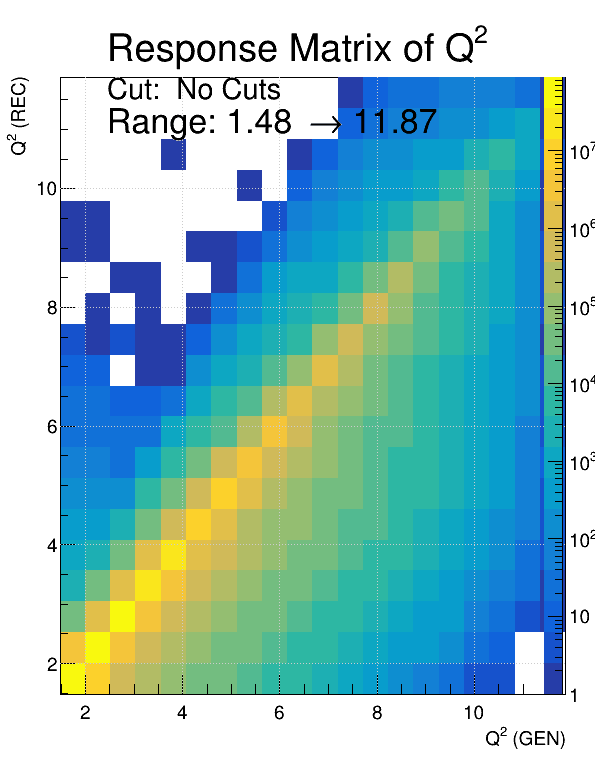

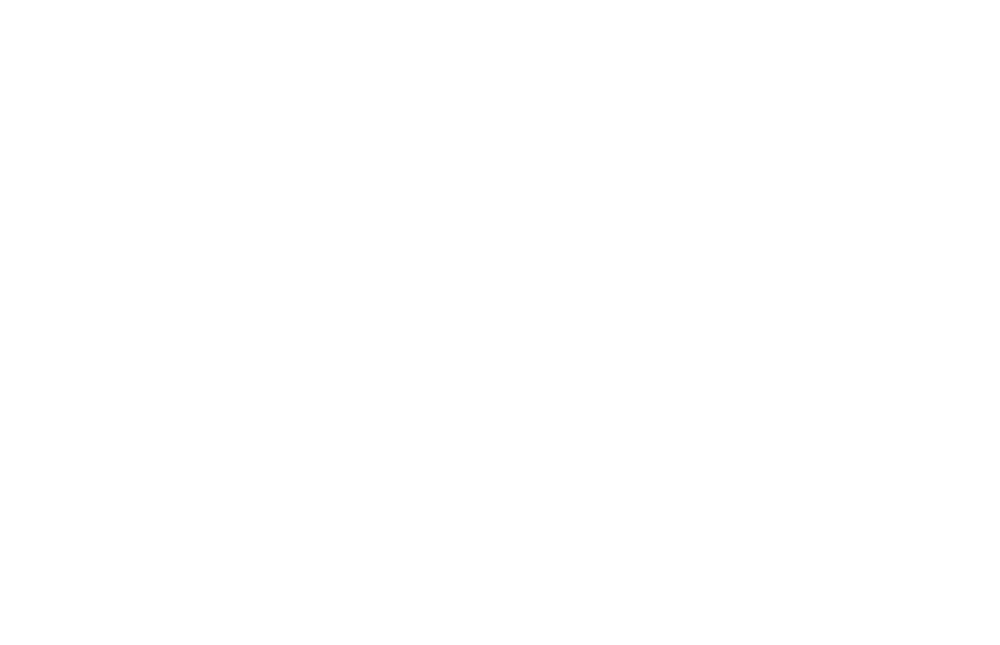

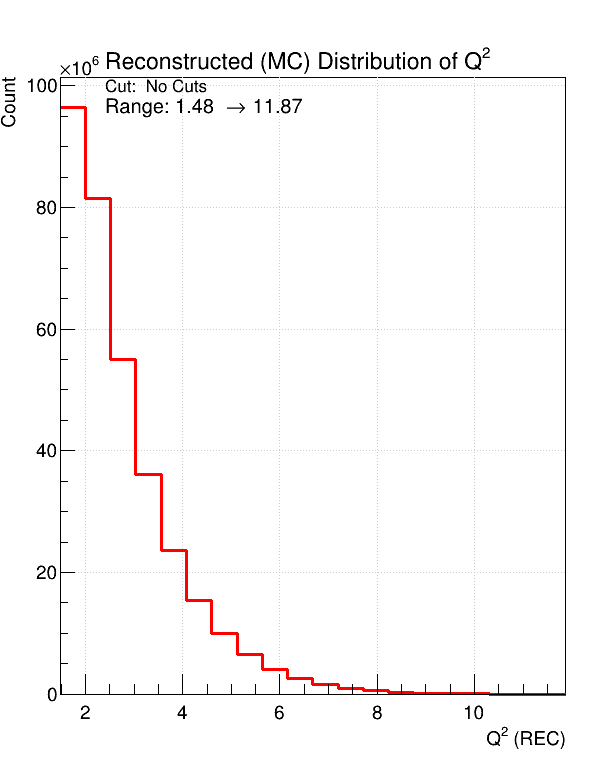

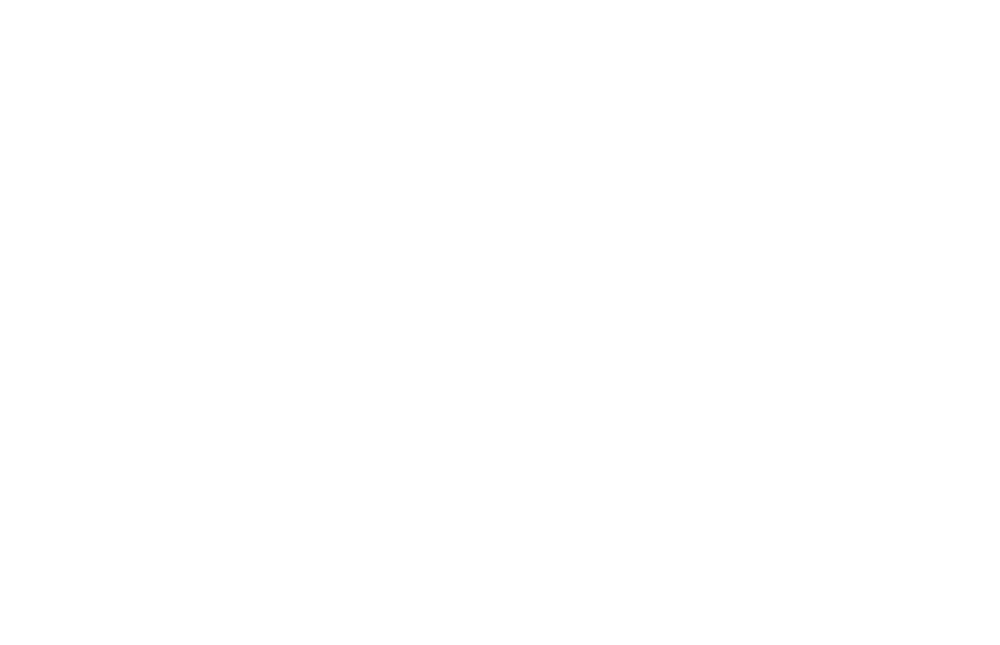

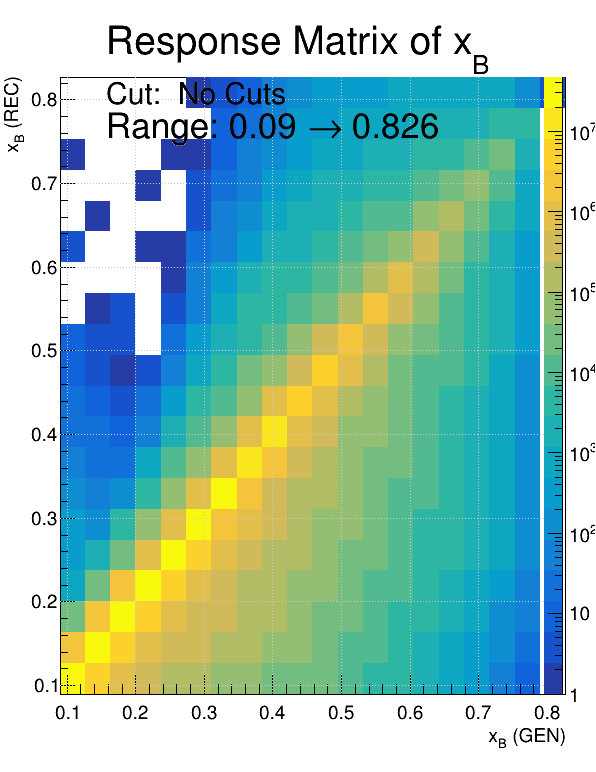

...

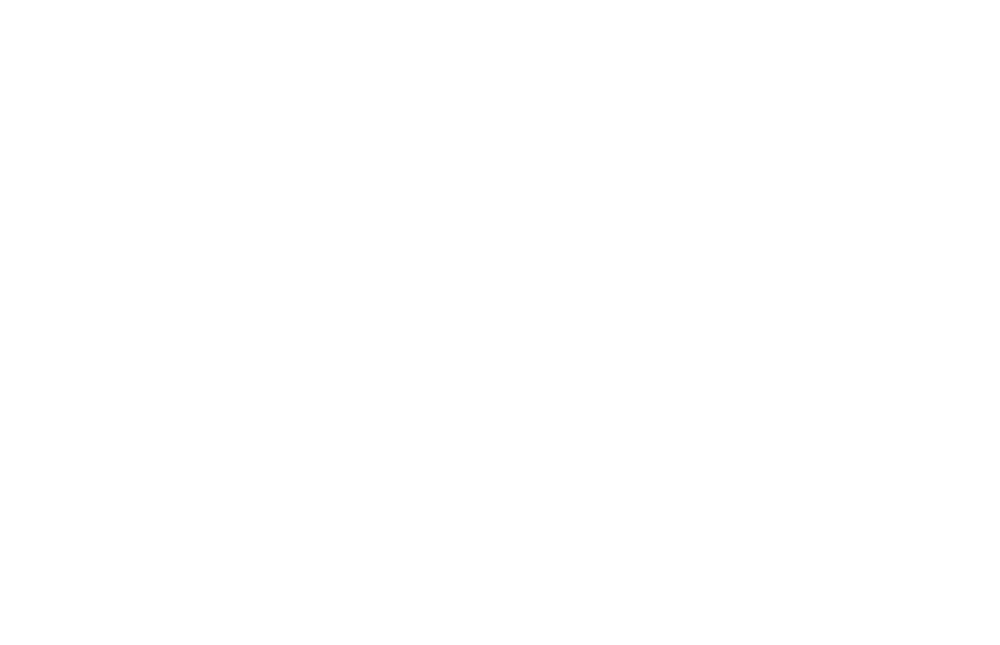

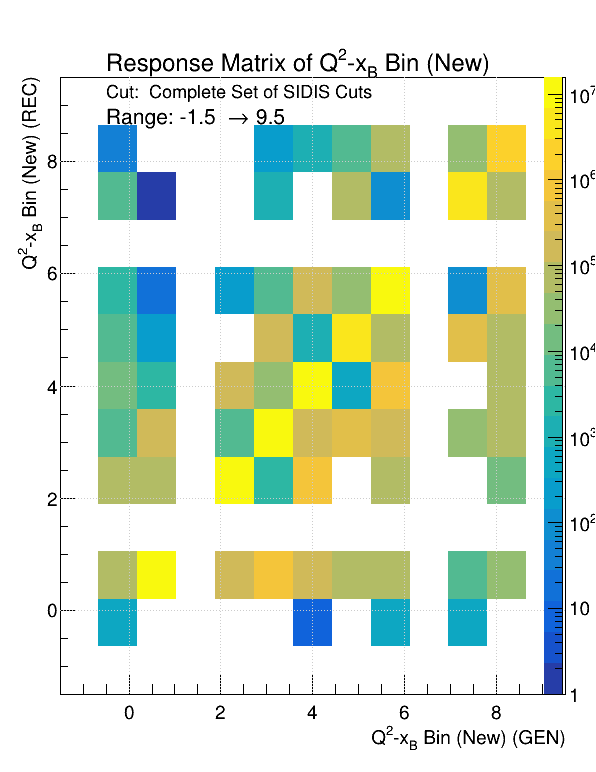

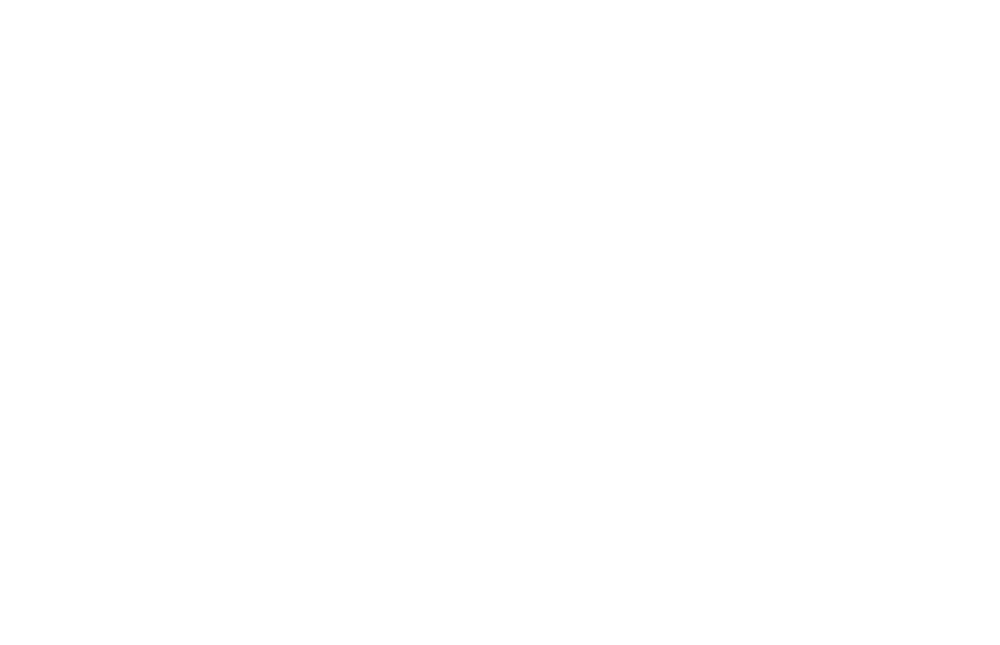

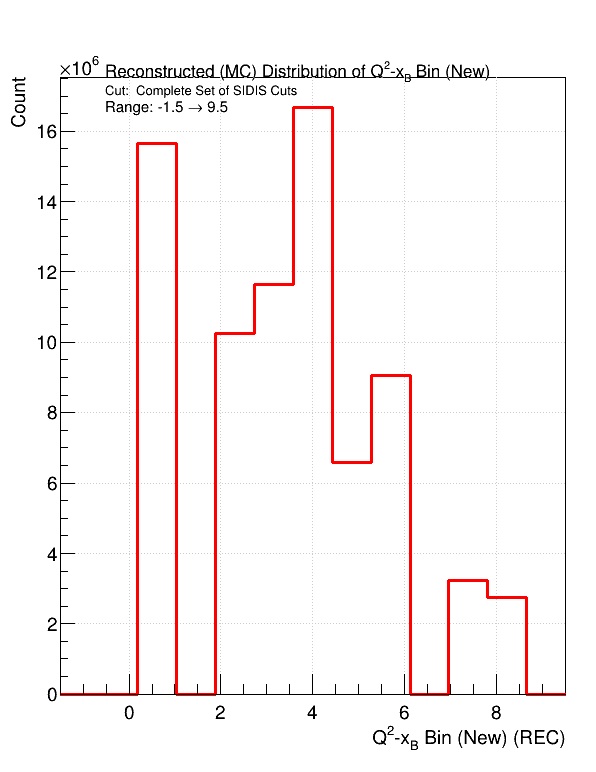

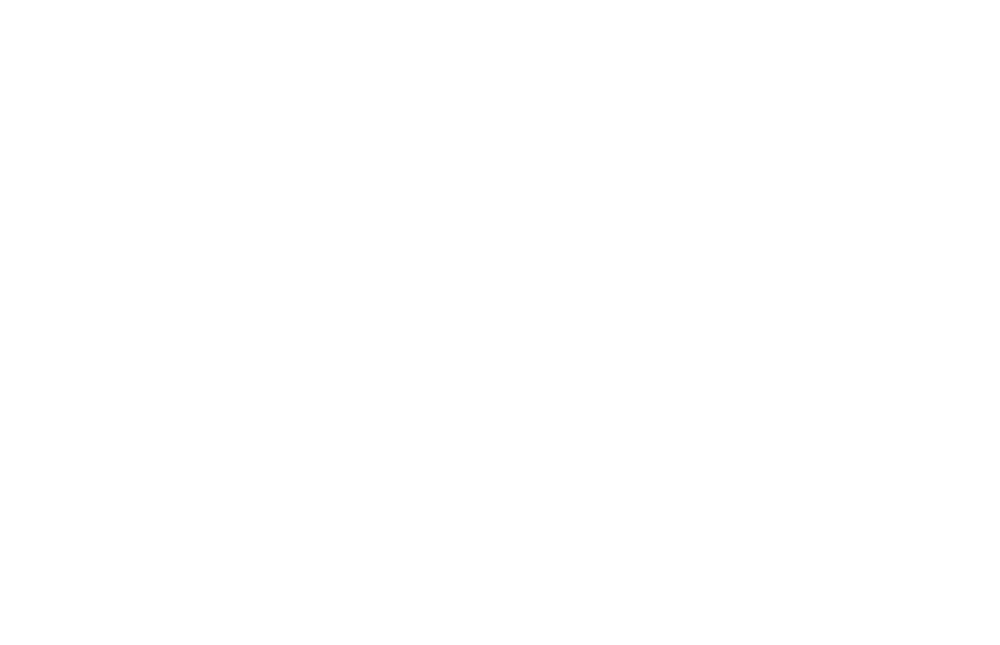

In [102]:
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
Divide_or_1_canvas = "one"

if('y' in Run_Exclusive_Study_Q and 'y' in Run_this_cell):
    
    canvas_Exclusive, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}
    list_of_canvas = []

    for datatype in list_of_DF:
        
        data_files_list = "error"

        if(datatype == 'rdf'):
            continue
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            # continue
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            continue
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files
        
        # print(data_files_list)
        
        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue
            
            
            
        for data_file in data_files_list:

            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##
            
            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
            for ii in rdf.GetListOfKeys():
                
                output_name = str(ii.GetName())
                   
                # print(output_name)
                
                if("Response" in output_name):
#                 if("2D Histogram" in output_name and 'Q2' in output_name and 'xB' in output_name and "SIDIS" in output_name and "'-1', '-1'" in output_name):
                        
                    if("3D -> 2D" in output_name and "-1, -1" not in output_name):
                        # print("Skipping Q2-xB bins")
                        continue
                    if("Bin_5D" in output_name or "Bin_4D" in output_name or "Bin_Res_4D" in output_name):
                        # print("Skipping 5D (and old 4D) bins")
                        continue
                    if("EDIS'" in output_name):
                        # print("Skipping Exculsive Cuts")
                        continue
                    if("smear" in output_name):
                        # print("Skipping smeared histograms")
                        continue
                        
                    for Dimension in ["2D", "1D"]:
                        
                        canvas_name = (((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        # print(output_name)
                        if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
                            canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                        if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
                            canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                        if(canvas_name not in list_of_canvas):
                            list_of_canvas.append(canvas_name)
                            count_mdf_s, count_mdf = 0, 0
                        try:
                            Exclusive_Histo[output_name] = rdf.Get(output_name)
                        except:
                            print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                            
                        try:
                            canvas_Exclusive[canvas_name]
                        except:
                            canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
                            canvas_Exclusive[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
                            canvas_Exclusive[canvas_name].SetGrid()
                            ROOT.gStyle.SetAxisColor(16, 'xy')
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)
                            Num_of_canvas_made += 1
                            

                        if("3D" in str(type(Exclusive_Histo[output_name]))):
                            Exclusive_Histo[output_name] = Exclusive_Histo[output_name].Project3D('yz')
                            
                        Draw_Canvas(canvas_Exclusive[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
                        ROOT.gPad.SetLogz(1)

                        Exclusive_Histo[output_name].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 5)
                        # Exclusive_Histo[output_name].SetLineWidth(2)
                        Exclusive_Histo[output_name].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)


#                         overflow_bins = 202 if("W" in output_name) else 51 if("z_pT_Bin" in output_name) else 297 if("Bin_Res_4D" in output_name) else 10 if("Q2_xB" in output_name) else 22



#                         if("Bin_Res_4D" not in output_name):
#                             for ii in range(0, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):

#                                 # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                 # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(0))
#                                 # print(Exclusive_Histo[output_name].GetBinContent(ii, 0))
#                                 # print("\n")

#                                 Exclusive_Histo[output_name].SetBinContent(ii, 1, 0)

#                                 for overflow in range(overflow_bins, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):
#                                     Exclusive_Histo[output_name].SetBinContent(ii, overflow, 0)


#                             for jj in range(0, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):

#                                 Exclusive_Histo[output_name].SetBinContent(1, jj, 0)

#                                 for overflow in range(overflow_bins, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):
#                                     Exclusive_Histo[output_name].SetBinContent(overflow, jj, 0)
                                    
#                         else:
#                             for ii in range(0, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):
#                                 low_overflow = Exclusive_Histo[output_name].GetBinContent(ii, 0)
                                
#                                 Exclusive_Histo[output_name].SetBinContent(ii, 1, low_overflow)
#                                 Exclusive_Histo[output_name].SetBinContent(ii, 0, 0)
                                
#                             for jj in range(0, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):
#                                 low_overflow = Exclusive_Histo[output_name].GetBinContent(0, jj)
                                
#                                 Exclusive_Histo[output_name].SetBinContent(1, jj, low_overflow)
#                                 Exclusive_Histo[output_name].SetBinContent(0, jj, 0)
                                
#                                 # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                 # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(0))
#                                 # print(Exclusive_Histo[output_name].GetBinContent(ii, 0))
#                                 # print("\n")
#                                 # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                 # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(1))
#                                 # print(Exclusive_Histo[output_name].GetBinContent(ii, 1))
#                                 # print("\nNew\n")


#                         Exclusive_Histo[output_name].GetXaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
#                         Exclusive_Histo[output_name].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 1))

#                         Exclusive_Histo[output_name].SetTitle((Exclusive_Histo[output_name].GetTitle().replace("->", "#rightarrow")))

                        if("2D" in Dimension):
                            Exclusive_Histo[output_name].Draw('colz')
#                             palette_move(canvas_Exclusive[canvas_name], Exclusive_Histo[output_name], 0, 0, 0, 0)
#                             Exclusive_Histo[output_name].GetYaxis().SetRangeUser(1.5, 11.5)
#                             Exclusive_Histo[output_name].GetXaxis().SetRangeUser(0.05, 0.85)
                        
#                             Exclusive_Histo[output_name].GetYaxis().SetRangeUser(1.5, 3.7)
#                             Exclusive_Histo[output_name].GetXaxis().SetRangeUser(0.05, 0.25)
                            
                            # x_left=0, x_right=0, y_up=0, y_down=0
                            palette_move(canvas_Exclusive[canvas_name], Exclusive_Histo[output_name], 0.01, 0.02)
                            if("Q2" in output_name and False):
                                Q2_xB_borders, line_num = {}, 0
                                for b_lines in Q2_xB_Border_Lines(-1):
                                    Q2_xB_borders[line_num] = ROOT.TLine()
                                    Q2_xB_borders[line_num].SetLineColor(1)    
                                    Q2_xB_borders[line_num].SetLineWidth(4)
                                    Q2_xB_borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                                    line_num += 1

#                                     ##=====================================================##
#                                     ##==========##     TEMPORARY CONDITION     ##==========##
#                                     ##=====================================================##
#                                     line_num_2 = 0
#                                     for b_lines_2 in Q2_xB_Border_Lines(8):
#                                         Q2_xB_borders[line_num_2] = ROOT.TLine()
#                                         Q2_xB_borders[line_num_2].SetLineColor(2)    
#                                         Q2_xB_borders[line_num_2].SetLineWidth(5)
#                                         Q2_xB_borders[line_num_2].DrawLine(b_lines_2[0][0], b_lines_2[0][1], b_lines_2[1][0], b_lines_2[1][1])
#                                         line_num_2 += + 1
#                                     ##=====================================================##
#                                     ##==========##     TEMPORARY CONDITION     ##==========##
#                                     ##=====================================================##

#                             # if((len(Variable_Loop_2D) != 3 and list2[2] == 2) or (len(Variable_Loop_2D) == 3 and list2[2] == 3)):
#                             if("z" in output_name or "pT" in output_name):
#                                 if(Q2_xB_Bin_Num > 0):
#                                     z_pT_borders = {}
#                                     Max_z = max(z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2])
#                                     Min_z = min(z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2])
#                                     Max_pT = max(z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2])
#                                     Min_pT = min(z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2])
#                                     for zline in z_pT_Border_Lines(Q2_xB_Bin_Num)[0][2]:
#                                         for pTline in z_pT_Border_Lines(Q2_xB_Bin_Num)[1][2]:
#                                             z_pT_borders[zline] = ROOT.TLine()
#                                             z_pT_borders[zline].SetLineColor(1)
#                                             z_pT_borders[zline].SetLineWidth(4)
#                                             z_pT_borders[zline].DrawLine(Max_pT, zline, Min_pT, zline)
#                                             z_pT_borders[pTline] = ROOT.TLine()
#                                             z_pT_borders[pTline].SetLineColor(1)
#                                             z_pT_borders[pTline].SetLineWidth(4)
#                                             z_pT_borders[pTline].DrawLine(pTline, Max_z, pTline, Min_z)
#                                     ##=====================================================##
#                                     ##==========##     TEMPORARY CONDITION     ##==========##
#                                     ##=====================================================##
#                                     if(Q2_xB_Bin_Num == 8):

#                                         z_pT_borders["fz_min"] = ROOT.TLine()

#                                         z_pT_borders["fz_min"].SetLineColor(2)
#                                         z_pT_borders["fz_min"].SetLineWidth(5)

#                                         z_pT_borders["fpT_min"] = ROOT.TLine()

#                                         z_pT_borders["fpT_min"].SetLineColor(2)
#                                         z_pT_borders["fpT_min"].SetLineWidth(5)

#                                         z_pT_borders["fz_max"] = ROOT.TLine()

#                                         z_pT_borders["fz_max"].SetLineColor(2)
#                                         z_pT_borders["fz_max"].SetLineWidth(5)

#                                         z_pT_borders["fpT_max"] = ROOT.TLine()

#                                         z_pT_borders["fpT_max"].SetLineColor(2)
#                                         z_pT_borders["fpT_max"].SetLineWidth(5)

#                                         z_pT_borders["fz_min"].DrawLine(0.05, 0.22, 0.05, 0.3)
#                                         z_pT_borders["fpT_min"].DrawLine(0.05, 0.22, 0.23, 0.22)
#                                         z_pT_borders["fz_max"].DrawLine(0.23, 0.22, 0.23, 0.3)
#                                         z_pT_borders["fpT_max"].DrawLine(0.05, 0.3, 0.23, 0.3)
#                                     ##=====================================================##
#                                     ##==========##     TEMPORARY CONDITION     ##==========##
#                                     ##=====================================================##


#                         ###################################################
#                         #--------#      2D Histograms (End)      #--------#
#                         ###################################################
#                         else:

#                             Exclusive_Histo[output_name].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))] = Exclusive_Histo[output_name].ProjectionY()
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetTitle(str(Exclusive_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Blue)
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Exclusive_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Exclusive[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))] = Exclusive_Histo[output_name].ProjectionX()
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetTitle(str(Exclusive_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Exclusive_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            


                    
    # print(list_of_canvas)


    for canvas_name_loop in list_of_canvas:
        print(canvas_name_loop)
        canvas_Exclusive[canvas_name_loop].Draw()
        
        
else:
    print(color.BOLD + color.RED + "\n\n\n\n\n\nCell not being run\n\n\n\n\n\n" + color.END)

.

.

.

.

.

.

.

.

.

.

# Response Matrix/Unfolding

In [47]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


# if('y' in Run_Exclusive_Study_Q and 'y' in Run_this_cell):
    
#     canvas_Exclusive, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                    
                    
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
#                 if("Response" in output_name and "'xB" in output_name):
                    
#                     if("1D" not in output_name and datatype_file != "mdf"):
#                         # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                         continue
                        
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
                        
#                     if("3D -> 2D" in output_name and "-1, -1" not in output_name):
#                         # print("Skipping Q2-xB bins")
#                         continue
                        
#                     if("Bin_5D" in output_name or "Bin_4D" in output_name):# or "Bin_Res_4D" not in output_name):
#                         # print("Skipping 5D (and old 4D) bins")
#                         continue
                    
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
                        
                        
#                     if("no_cut" not in output_name or "smear" in output_name):
#                         print("TEMP: Skips")
#                         continue
                        
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)
                    
                    
                    
                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
                        
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
                        
#                         canvas_name = (((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")

#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])

                        
#                         # print(output_name)

#                         if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')

#                         if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')


#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Exclusive_Histo[output_name] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))


#                         try:
#                             canvas_Exclusive[canvas_name]
#                         except:
#                             canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Exclusive[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Exclusive[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1



#                         Draw_Canvas(canvas_Exclusive[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         ROOT.gPad.SetLogz(1)

#                         # Exclusive_Histo[output_name].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 5)
#                         Exclusive_Histo[output_name].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         # Exclusive_Histo[output_name].SetLineWidth(2)
#                         Exclusive_Histo[output_name].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)


#                         overflow_bins = 202 if("W" in output_name) else 51 if("z_pT_Bin" in output_name) else 297 if("Bin_Res_4D" in output_name) else 10 if("Q2_xB" in output_name) else 22



#                         if("1D" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):

#                                     # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                     # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(0))
#                                     # print(Exclusive_Histo[output_name].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Exclusive_Histo[output_name].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):
#                                         Exclusive_Histo[output_name].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):

#                                     Exclusive_Histo[output_name].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):
#                                         Exclusive_Histo[output_name].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Exclusive_Histo[output_name].GetNbinsX() + 1, 1):
#                                     low_overflow = Exclusive_Histo[output_name].GetBinContent(ii, 0)

#                                     Exclusive_Histo[output_name].SetBinContent(ii, 1, low_overflow)
#                                     Exclusive_Histo[output_name].SetBinContent(ii, 0, 0)

#                                 for jj in range(0, Exclusive_Histo[output_name].GetNbinsY() + 1, 1):
#                                     low_overflow = Exclusive_Histo[output_name].GetBinContent(0, jj)

#                                     Exclusive_Histo[output_name].SetBinContent(1, jj, low_overflow)
#                                     Exclusive_Histo[output_name].SetBinContent(0, jj, 0)

#                                     # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                     # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(0))
#                                     # print(Exclusive_Histo[output_name].GetBinContent(ii, 0))
#                                     # print("\n")
#                                     # print(Exclusive_Histo[output_name].GetXaxis().GetBinCenter(ii))
#                                     # print(Exclusive_Histo[output_name].GetYaxis().GetBinCenter(1))
#                                     # print(Exclusive_Histo[output_name].GetBinContent(ii, 1))
#                                     # print("\nNew\n")


#                         Exclusive_Histo[output_name].GetXaxis().SetRangeUser(-5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
#                         if("1D" not in output_name):
#                             Exclusive_Histo[output_name].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 1))

#                         Exclusive_Histo[output_name].SetTitle((Exclusive_Histo[output_name].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Exclusive_Histo[output_name].Draw('colz')
#                             palette_move(canvas_Exclusive[canvas_name], Exclusive_Histo[output_name], 0, 0, 0, 0)
#                         elif("1D" not in output_name):

#                             Exclusive_Histo[output_name].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))] = Exclusive_Histo[output_name].ProjectionY()
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetTitle(str(Exclusive_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Exclusive_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Exclusive_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Exclusive[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))] = Exclusive_Histo[output_name].ProjectionX()
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetTitle(str(Exclusive_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Exclusive_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Exclusive_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Exclusive_Histo[output_name].Draw('same E1 H')
                            
                            
                            
                            
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                            


                    
#     # print(list_of_canvas)


#     for canvas_name_loop in list_of_canvas:
#         print(canvas_name_loop)
#         canvas_Exclusive[canvas_name_loop].Draw()
        
        
# else:
#     print("\n\n\nCell not being run\n\n\n")
    


In [48]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
#                 if("Response" in output_name and "'Q2" in output_name):
#                 # if("Response" in output_name and ("'pT" in output_name or "'z" in output_name or "'Q2" in output_name or "'xB" in output_name or "'Bin_Res_4D" in output_name)):
#                 # if("Response" in output_name and ("'pT" in output_name or "'z" in output_name or "'xB" in output_name or "'Bin_Res_4D" in output_name)):
#                 # if("Response" in output_name and ("'pT'" in output_name or "'z'" in output_name)):
# #                 if("Response" in output_name and ("'pT'" in output_name or "'z'" in output_name or "'xB'" in output_name or "'Q2'" in output_name or "Q2_xB" in output_name or "z_pT" in output_name or "Bin_Res_4D" in output_name)):
                    
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
                        
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
                        
#                     if("3D -> 2D" in output_name and "-1, -1" not in output_name):
#                         # print("Skipping Q2-xB bins")
#                         continue
                        
#                     if("Bin_5D" in output_name or "Bin_4D" in output_name):# or "Bin_Res_4D" not in output_name):
#                         # print("Skipping 5D (and old 4D) bins")
#                         continue
                    
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
                        
                        
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
                        
#                     if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                         # print("TEMP: Skips")
#                         continue
                        
                        
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)
                    
                    
                    
                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
                        
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
                        
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")


#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])

                        
#                         # print(output_name)

#                         if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')

#                         if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')


#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))


#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1


#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         # Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 5)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         # Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(2)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)


#                         overflow_bins = 202 if("W" in output_name) else 51 if("z_pT_Bin" in output_name) else 297 if("Bin_Res_4D" in output_name) else 10 if("Q2_xB" in output_name) else 22

                        
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):
#                             try:
                            
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")

#                                 output_name_gdf = ((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")

#                                 # print(output_name_gdf)
#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print("Potential error")

#                                 histo_gdf = gdf.Get(output_name_gdf)
#                                 # print(type(histo_gdf))

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)

#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)

#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                             # print("ERROR: norm_bin_gen = 0 in bin x = " + str(ii) + " and bin y = " + str(jj))

#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                                        
#                             except:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))


#                         if("1D" not in output_name and "test" != "test"):
# #                         if("1D" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetXaxis().GetBinCenter(ii))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().GetBinCenter(0))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)


#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
                            
                            
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and "'Response_Matrix'" in str(name)):
#                 Adet_name = str(name)
#                 bini_name = str(name.replace("mdf", "1D_rec"))

#                 unfold_name_base = ((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))
#                 print("bini_name = " + str(bini_name))
#                 print("xini_name = " + str(xini_name))
#                 print("bdata_name = " + str(bdata_name))
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2

#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)


#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 900, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(1, 3, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()

#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)

#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)

                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        

                    

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    







#                     # print(Unfolding_Canvas_Name)

#                     CD_Canvas_2[Unfolding_Canvas_Name] = canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

#                     CD_Canvas_2[Unfolding_Canvas_Name].Divide(3, 1)

#                     CD_Canvas_2[Unfolding_Canvas_Name].cd(1)
#                     Unfolding_Histo[Adet_name].Draw("colz")

#                     CD_Canvas_2[Unfolding_Canvas_Name].cd(2)
#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Draw("colz")

#                     CD_Canvas_2[Unfolding_Canvas_Name].cd(3)
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
        
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    

In [49]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                 # if("Response" in output_name and ("'pT" in output_name or "'z" in output_name or "'Q2" in output_name or "'xB" in output_name or "'Bin_Res_4D" in output_name)):
#                 # if("Response" in output_name and ("'pT" in output_name or "'z" in output_name or "'xB" in output_name or "'Bin_Res_4D" in output_name)):
#                 # if("Response" in output_name and ("'pT'" in output_name or "'z'" in output_name)):
# #                 if("Response" in output_name and ("'pT'" in output_name or "'z'" in output_name or "'xB'" in output_name or "'Q2'" in output_name or "Q2_xB" in output_name or "z_pT" in output_name or "Bin_Res_4D" in output_name)):
                    
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
                        
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
                        
#                     if("3D -> 2D" in output_name and "-1, -1" not in output_name):
#                         # print("Skipping Q2-xB bins")
#                         continue
                        
#                     if("Bin_5D" in output_name or "Bin_4D" in output_name):# or "Bin_Res_4D" not in output_name):
#                         # print("Skipping 5D (and old 4D) bins")
#                         continue
                    
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
                        
                        
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
                        
#                     if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                         # print("TEMP: Skips")
#                         continue
                        
                        
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)
                    
                    
                    
                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
                        
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
                        
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")


#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])

                        
#                         # print(output_name)

#                         if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')

#                         if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                             canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')


#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))


#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1


#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         # Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 5)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         # Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(2)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)


#                         overflow_bins = 202 if("W" in output_name) else 51 if("z_pT_Bin" in output_name) else 297 if("Bin_Res_4D" in output_name) else 10 if("Q2_xB" in output_name) else 22

                        
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):
#                             try:
                            
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")

#                                 output_name_gdf = ((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")

#                                 # print(output_name_gdf)
#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print("Potential error")

#                                 histo_gdf = gdf.Get(output_name_gdf)
#                                 # print(type(histo_gdf))

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)

#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)

#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                             # print("ERROR: norm_bin_gen = 0 in bin x = " + str(ii) + " and bin y = " + str(jj))

#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                                        
#                             except:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))


#                         if("1D" not in output_name and "test" == "test" and "Normal" not in output_name):
# #                         if("1D" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetXaxis().GetBinCenter(ii))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().GetBinCenter(0))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")


#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
                            
                            
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2

#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)


#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(0, nBins_CVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)   # Response Matrix (Y axis --> REC)


#                 Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                 if("'pT'" not in name):
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(2, 0)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                    
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")
                    

                    
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))
                    
#                     norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                     ROOT.gPad.SetLogy(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        
#                     Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
                    
                    
#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
#                     # Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(0.5, 20.5)
                    
                    
#                     ROOT.gPad.SetLogy(0)
                    
#                     Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(4)
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     # Unfolded_Clone.SetLineWidth(4)
#                     # Unfolded_Clone.Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].SetLineWidth(2)
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].SetLineWidth(2)
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetLineWidth(3)
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Clone
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])] = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Divide(Unfolding_Histo[xini_name])
                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Scale(norm_factor_Bin_by_bin/norm_factor_Generated)
                    
                    
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.15, 0.8, 0.3)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetNColumns(2)
# #                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2 - 0.05, 0.2 + 0.2, 0.4 + 0.2, 0.4 + 0.3)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data} (Before Normalizing)", "plE")
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
#                     else:
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        
                        
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().GetTitle())
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle())

                    
# #                     if(Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].FindBin(20)) == 0):
#                     if(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].FindBin(20)) == 0):
#                         print("\n\nTEST\n\n\n")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].FindBin(20), 0)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetRangeUser(0, 2.8)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetLineWidth(3)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Draw("Hist E1 same")
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    



#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
# #                     Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                     ROOT.gPad.SetLogy(0)
#                     ROOT.gPad.SetLogz(1)
# #                     if("Q2" not in name and "xB" not in name):
# #                         Unfolded_Determinate[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(21, 24)
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                     Tline_Simple_Test_1 = ROOT.TLine()
#                     Tline_Simple_Test_1.SetLineColor(2)
#                     Tline_Simple_Test_1.SetLineWidth(2)
#                     Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                     # Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(0.5, 20.5)
#                     Unfolding_Histo[Adet_name].Draw("colz")
#                     palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)
                    
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                     # Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetXaxis().SetRangeUser(-0.5, 15.5)
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
        
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    

In [50]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
#                     # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                     #     # print("TEMP: Skips")
#                     #     continue
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)

                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
#                         # print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))

#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1

#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)

#                         overflow_bins = 202 if("W" in output_name) else 51 if("z_pT_Bin" in output_name) else 297 if("Bin_Res_4D" in output_name) else 10 if("Q2_xB" in output_name) else 22

    
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):
#                             try:
                            
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")

#                                 output_name_gdf = ((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")

#                                 # print(output_name_gdf)
#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print("Potential error")

#                                 histo_gdf = gdf.Get(output_name_gdf)
#                                 # print(type(histo_gdf))

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)

#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)

#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                             # print("ERROR: norm_bin_gen = 0 in bin x = " + str(ii) + " and bin y = " + str(jj))

#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                                        
#                             except:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))


#                         if("1D" not in output_name and "test" == "test" and "Normal" not in output_name):
# #                         if("1D" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetXaxis().GetBinCenter(ii))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().GetBinCenter(0))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")


#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
                            
                            
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2

#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)


#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(0, nBins_CVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)   # Response Matrix (Y axis --> REC)


#                 Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                 if("'pT'" not in name):
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(2, 0)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                    
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")
                    

                    
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))
                    
#                     norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                     ROOT.gPad.SetLogy(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        
#                     Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
                    
                    
#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
#                     # Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(0.5, 20.5)
                    
                    
#                     ROOT.gPad.SetLogy(0)
                    
#                     Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(4)
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     # Unfolded_Clone.SetLineWidth(4)
#                     # Unfolded_Clone.Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].SetLineWidth(2)
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].SetLineWidth(2)
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetLineWidth(3)
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Clone
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])] = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Divide(Unfolding_Histo[xini_name])
                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Scale(norm_factor_Bin_by_bin/norm_factor_Generated)
                    
                    
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.15, 0.8, 0.3)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetNColumns(2)
# #                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2 - 0.05, 0.2 + 0.2, 0.4 + 0.2, 0.4 + 0.3)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data} (Before Normalizing)", "plE")
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
#                     else:
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        
                        
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().GetTitle())
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle())

                    
# #                     if(Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].FindBin(20)) == 0):
#                     if(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].FindBin(20)) == 0):
#                         print("\n\nTEST\n\n\n")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].FindBin(20), 0)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetRangeUser(0, 2.8)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetLineWidth(3)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Draw("Hist E1 same")
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    



#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
# #                     Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                     ROOT.gPad.SetLogy(0)
#                     ROOT.gPad.SetLogz(1)
# #                     if("Q2" not in name and "xB" not in name):
# #                         Unfolded_Determinate[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(21, 24)
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                     Tline_Simple_Test_1 = ROOT.TLine()
#                     Tline_Simple_Test_1.SetLineColor(2)
#                     Tline_Simple_Test_1.SetLineWidth(2)
#                     Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                     # Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(0.5, 20.5)
#                     Unfolding_Histo[Adet_name].Draw("colz")
#                     palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)
                    
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                     # Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetXaxis().SetRangeUser(-0.5, 15.5)
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
        
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    

In [51]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
#                     # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                     #     # print("TEMP: Skips")
#                     #     continue
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)

                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
#                         # print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))

#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1

#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)

    
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):
#                             try:
                            
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
                                
#                                 output_name_gdf = ((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")

#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print("Potential error")

#                                 histo_gdf = gdf.Get(output_name_gdf)

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)

#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)

#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                             # print("ERROR: norm_bin_gen = 0 in bin x = " + str(ii) + " and bin y = " + str(jj))

#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                                        
#                             except:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))


#                         if("1D" not in output_name and "test" == "test" and "Normal" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetXaxis().GetBinCenter(ii))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().GetBinCenter(0))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")


#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
                            
                            
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2

#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)


#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(0, nBins_CVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)   # Response Matrix (Y axis --> REC)


#                 Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                 if("'pT'" not in name):
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(2, 0)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                    
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")
                    

                    
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))
                    
#                     norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                     ROOT.gPad.SetLogy(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        
#                     Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
                    
                    
#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
#                     # Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(0.5, 20.5)
                    
                    
#                     ROOT.gPad.SetLogy(0)
                    
#                     Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(4)
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     # Unfolded_Clone.SetLineWidth(4)
#                     # Unfolded_Clone.Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].SetLineWidth(2)
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].SetLineWidth(2)
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetLineWidth(3)
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Clone
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])] = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Divide(Unfolding_Histo[xini_name])
                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Scale(norm_factor_Bin_by_bin/norm_factor_Generated)
                    
                    
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.15, 0.8, 0.3)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetNColumns(2)
# #                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2 - 0.05, 0.2 + 0.2, 0.4 + 0.2, 0.4 + 0.3)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data} (Before Normalizing)", "plE")
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
#                     else:
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        
                        
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().GetTitle())
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle())

                    
# #                     if(Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].FindBin(20)) == 0):
#                     if(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].FindBin(20)) == 0):
#                         print("\n\nTEST\n\n\n")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].FindBin(20), 0)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetRangeUser(0, 2.8)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetLineWidth(3)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Draw("Hist E1 same")
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    



#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
# #                     Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                     ROOT.gPad.SetLogy(0)
#                     ROOT.gPad.SetLogz(1)
# #                     if("Q2" not in name and "xB" not in name):
# #                         Unfolded_Determinate[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(21, 24)
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                     Tline_Simple_Test_1 = ROOT.TLine()
#                     Tline_Simple_Test_1.SetLineColor(2)
#                     Tline_Simple_Test_1.SetLineWidth(2)
#                     Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                     # Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(0.5, 20.5)
#                     Unfolding_Histo[Adet_name].Draw("colz")
#                     palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)
                    
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                     # Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetXaxis().SetRangeUser(-0.5, 15.5)
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
        
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    

In [52]:
# for test in Unfolding_Histo:
#     if("Normal" in test):
#         print(test)

In [53]:
# for name in canvas_Unfolding:
#     if("1D" not in name and "Unfolded" in name):
#         print(name)
#         canvas_Unfolding[name].Draw()
#         canvas_Unfolding[name].SaveAs("".join([str(name), ".png"]))

.

.

.

.

.

.

# Exclusive Studies (for Momentum Corrections and Smearing)

In [54]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# if('y' in Run_Exclusive_Study_Q and 'y' in Run_this_cell):
    
#     canvas_Exclusive, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             print("\nExclusive Studies does not (currently) require the generated Monte Carlo files.\n")
#             continue
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files


#         # if("exclusive" not in data_files_list[0] and "Exclusive" not in data_files_list[0]):
#         #     print("\nFile loaded may not be meant to show exclusive studies.\nMake sure the proper files are loaded.\n")
#         #     print(datatype_file)
#         #     print(data_files_list)
#         #     break


        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
#                 canvas_name = (((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                
#                 print(output_name)
                
#                 if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                    
#                 if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                   
                   
#                 # print(output_name)
                
#                 if("el" in output_name):
                        
#                     if("gen" in output_name or "Purity" in output_name or 'Bin Migration' in output_name or "pdf" in output_name or "No Cuts" in output_name):
#                         # print("Skipping some unnecessary options")
#                         continue
                        
#                     if("3D -> 2D" in output_name and "-1, -1" not in output_name):
#                         # print("Skipping Q2-xB bins")
#                         continue
                    
            
#                     if(canvas_name not in list_of_canvas):
#                         list_of_canvas.append(canvas_name)
#                         count_mdf_s, count_mdf = 0, 0
            
#                     try:
#                         Exclusive_Histo[output_name] = rdf.Get(output_name)
#                         if("3D ->" in output_name):
#                             Exclusive_Histo[output_name] = Exclusive_Histo[output_name].Project3D('z' if('1D' in output_name) else 'yz' if("MM" in output_name) else 'y')
                            
#                             title = Exclusive_Histo[output_name].GetTitle()
#                             title = ((title.replace(" z projection", "")).replace(" yz projection", "")).replace(" y projection", "")
#                             Exclusive_Histo[output_name].SetTitle(title)
                            
#                             if("MM" in output_name):
#                                 if('1D' in output_name):
#                                     Exclusive_Histo[output_name].GetXaxis().SetRangeUser(0.5, 1.1)
#                                 else:
#                                     Exclusive_Histo[output_name].GetYaxis().SetRangeUser(0.5, 1.1)
                            
                            
#                     except:
#                         print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
            
            
#                     try:
#                         canvas_Exclusive[canvas_name]
#                     except:
#                         canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 600, 800)
#                         canvas_Exclusive[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 1, 1, 0.001, 0.001)
#                         canvas_Exclusive[canvas_name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1
                        
                        
#                     # if("mdf" in datatype_file and "smeared" not in output_name):
#                     #     print(output_name)
#                     #     count_mdf += 1
#                     #     print("count_mdf = " + str(count_mdf))
#                     # elif("rdf" not in datatype_file):
#                     #     print(output_name)
#                     #     count_mdf_s += 1
#                     #     print("count_mdf_s = " + str(count_mdf_s))
                        
#                     Draw_Canvas(canvas_Exclusive[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                    
                        
#                     Exclusive_Histo[output_name].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 5)
#                     # Exclusive_Histo[output_name].SetLineWidth(2)
#                     Exclusive_Histo[output_name].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)
                    
#                     if(Divide_or_1_canvas != "one"):
#                         Exclusive_Histo[output_name].Draw("same P0 C" if('1D' in output_name) else 'col')
#                     else:
#                         # Exclusive_Histo[output_name] = Normalize_1D(Exclusive_Histo[output_name], datatype_file if("smeared" not in output_name) else "sdf")
#                         # Exclusive_Histo[output_name].Draw("same P0 C" if('1D' in output_name) else 'col')
#                         Exclusive_Histo[output_name].DrawNormalized("same HIST E1")
                    
#                     Stat_boxes[output_name] = ""
                    
#                     if('3D -> 2D' not in output_name and "MM" in output_name):
#                         fitMM_1D(Exclusive_Histo[output_name], 'no' if("Exclusive" not in output_name) else 'yes')
#                         line_list[output_name] = ROOT.TLine()
#                         line_list[output_name].SetLineColor(4 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3)
#                         line_list[output_name].DrawLine(Exclusive_Histo[output_name].FindPeak_1D_x, 0, Exclusive_Histo[output_name].FindPeak_1D_x, Exclusive_Histo[output_name].FindPeak_1D_y)
#                         statbox_move(Exclusive_Histo[output_name], canvas_Exclusive[canvas_name], Stat_boxes[output_name], 0.25, 0.25, 0.1, 0.1)
#                     # else:
#                     #     palette_move(canvas_Exclusive[canvas_name], Exclusive_Histo[output_name], 0, 0, 0, 0)
                        


                    
                    
#     # print(list_of_canvas)


#     for canvas_name_loop in list_of_canvas:
#         print(canvas_name_loop)
#         canvas_Exclusive[canvas_name_loop].Draw()
        
        
# else:
#     print("\n\n\nCell not being run\n\n\n")

In [55]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


# if(len(list_of_DF) == 1):
#     Divide_or_1_canvas = "one"


# if(('y' in Run_Exclusive_Study_Q) and 'y' in Run_this_cell):
    
#     canvas_Exclusive, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             print("\nExclusive Studies does not (currently) require the generated Monte Carlo files.\n")
#             continue
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files


#         # if("exclusive" not in data_files_list[0] and "Exclusive" not in data_files_list[0]):
#         #     print("\nFile loaded may not be meant to show exclusive studies.\nMake sure the proper files are loaded.\n")
#         #     print(datatype_file)
#         #     print(data_files_list)
#         #     break


        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                
#                 if(len(list_of_DF) != 1 and Divide_or_1_canvas != "one"):
#                     canvas_name = (((((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")).replace("smear", "")).replace("_", "")
#                 else:
#                     canvas_name = output_name
                
#                 cut_name = ((((((((((((((((output_name.replace("Mom_Cor_Histos - ", "")).replace("Missing Mass ", "")).replace("Delta P ", "")).replace("El - ", "")).replace("Pi+ - ", "")).replace("rdf", "")).replace("mdf", "")).replace("pdf", "")).replace("gdf", "")).replace("Delta_Pel_Cors", "")).replace("Delta_Ppip_Cors", "")).replace("2", "")).replace("MM", "")).replace("_smeared", "")).replace("smear_", "")).replace("', , '", "")).replace(", ''", "")
                
#                 if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                    
#                 if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                   
                   
#                 # print(output_name)
#                 # print(canvas_name)
                
#                 if('Mom_Cor_Histos' in output_name):
                    
                    
#                     if("Delta" in output_name and "Exclusive" not in cut_name):
#                         continue
#                         # ∆P histograms must use exclusivity cuts only
                        
#                     if("SIDIS" in cut_name):
#                         continue
#                         # Skipping SIDIS cuts
                    
#                     if("gen" in cut_name):
#                         continue
#                         # Skipping matched generated histograms
                    
#                     try:
#                         Exclusive_Histo[output_name] = rdf.Get(output_name)
#                         title_true = Exclusive_Histo[output_name].GetTitle()
#                     except:
#                         print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                        
#                     sector_list_MM = ["all", 1, 2, 3, 4, 5, 6]
#                     sector_list_MM = ["all"]
#                     sector_list_MM = [1, 2, 3, 4, 5, 6]
                    
#                     for sector in sector_list_MM:

#                         sector_name = "".join([" - Sector ", str(sector)]) if(sector != "all") else " - All Sectors"
                
#                         for ii in sector_list_MM:
#                             sector_name_2 = "".join([" - Sector ", str(ii)]) if(ii != "all") else " - All Sectors"
#                             canvas_name = canvas_name.replace(sector_name_2, "")
                        
#                         if(sector == "all" and sector_name not in canvas_name):
#                             canvas_name = "".join([canvas_name, sector_name])
                            
#                         if(sector != "all"):
#                             canvas_name = (((canvas_name.replace("_rdf", "")).replace("_pdf", "")).replace("_gdf", "")).replace("_mdf", "")
#                             canvas_name = "".join([canvas_name, "_", datatype_file])

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)


#                         output_name_2 = "".join([output_name, sector_name])
#                         Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name].Clone()

#                         if(sector != "all"):
#                             Exclusive_Histo[output_name_2].GetZaxis().SetRangeUser(sector, sector)
#                             Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')
#                         else:
#                             Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')
                        
#                         title = ((((title_true.replace(" z projection", "")).replace(" yz projection", "")).replace(" y projection", "")).replace(" yx projection", ""))
#                         title = "".join([root_color.Line, "{#scale[1]{", title, sector_name, "}}{#scale[1.25]{", "".join(["#color[", str(root_color.Blue),"]{Experimental Data}"]) if("rdf" in output_name) else "".join(["#color[", str(root_color.Red) if("smear" not in output_name) else str(root_color.Pink),"]{", "Smeared " if("smear" in output_name) else "", "Reconstructed Monte Carlo}"]) if("mdf" in output_name or "pdf" in output_name) else "".join(["#color[", str(root_color.Green),"]{Generated Monte Carlo}"]), " - ", cut_name,"}}"])
#                         Exclusive_Histo[output_name_2].SetTitle(title)

#                         title_x = Exclusive_Histo[output_name_2].GetXaxis().GetTitle()
#                         title_x = title_x.replace("#p_", "p_")
#                         Exclusive_Histo[output_name_2].GetXaxis().SetTitle(title_x)

#                         if("Delta" in output_name):
#                             Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(-0.3, 0.3)
#                             if("No" not in cut_name):
#                                 if('#pi' in title_x):
#                                     if("Exclusive" in cut_name):
#                                         fit2dPE(Exclusive_Histo[output_name_2], 1.25, 5, 0.5, title, "no", "pip")
#                                     Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
#                                 else:
#                                     if("Exclusive" in cut_name):
#                                         fit2dPE(Exclusive_Histo[output_name_2], 2.75, 7.75, 0.5, title, "no", "el")
#                                     Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)
#                         else:
#                             Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(0.5 if("Exclusive" not in cut_name) else 0.8, 1.05 if("Exclusive" in cut_name) else 3.5)
#                             if("No" not in cut_name):
#                                 if('#pi' in title_x):
#                                     Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
#                                 else:
#                                     Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)



#                         try:
#                             canvas_Exclusive[canvas_name]
#                         except:
                            
#                             Canvas_Divide_1 = 3 if(Divide_or_1_canvas != "one" or sector != "all") else 1
#                             Canvas_Divide_2 = 1 if(sector == "all") else 2
                            
#                             Canvas_Size_X = 1800 if(Divide_or_1_canvas != "one" or sector != "all") else 600
#                             Canvas_Size_Y = 800 if(sector == "all") else 1600
                            
#                             canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, Canvas_Size_X, Canvas_Size_Y)
#                             canvas_Exclusive[canvas_name].Divide(Canvas_Divide_1, Canvas_Divide_2, 0.001, 0.001)
#                             canvas_Exclusive[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1


#                         # if("mdf" in datatype_file and "smeared" not in output_name):
#                         # print(output_name)
#                         #     count_mdf += 1
#                         #     print("count_mdf = " + str(count_mdf))
#                         # elif("rdf" not in datatype_file):
#                         #     print(output_name)
#                         #     count_mdf_s += 1
#                         #     print("count_mdf_s = " + str(count_mdf_s))

#                         if(sector == "all"):
#                             cd_num = 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smear" not in output_name) else 3
#                         else:
#                             cd_num = sector
                            
#                         # print("canvas_name = " + str(canvas_name))
#                         # print("sector = " + str(sector))
#                         # print("Canvas_Divide_1 = " + str(Canvas_Divide_1))
#                         # print("Canvas_Divide_2 = " + str(Canvas_Divide_2))
#                         # print("cd_num = " + str(cd_num))
#                         # print("\n")
                            
#                         Draw_Canvas(canvas_Exclusive[canvas_name], cd_num, 0.1, -0.05, 0, 0)
                        

#                         # print(str(output_name) + " --> " + str(type(Exclusive_Histo[output_name])))
#                         if("TH2D" in str(type(Exclusive_Histo[output_name_2]))):
#                             Exclusive_Histo[output_name_2].Draw("col")
#                         else:
#                             print(str(output_name_2) + " --> " + str(type(Exclusive_Histo[output_name_2])))
                        
#                         try:
#                             if("Delta" in output_name_2 and "Exclusive" in cut_name):
#                                 # print("\n" + str(output_name_2) + " --> " + str(type(Exclusive_Histo[output_name_2].gr2)) + "\n")
#                                 if("TGraphErrors" in str(type(Exclusive_Histo[output_name_2].gr2))):
#                                     Exclusive_Histo[output_name_2].gr2.Draw("P")
#                                 else:
#                                     print("no points")
#                         except:
#                             print("No fit")
                            
                            
#                         if("Delta" in output_name and "No" not in cut_name and "Exclusive" in cut_name):
#                             # try:
#                             if(sector == 1):
#                                 Draw_1D_Histos_with_Canvas(Exclusive_Histo[output_name_2], canvas_Exclusive, canvas_name, sector, "no")
#                             else:
#                                 break
# #                             Draw_1D_Histos_with_Canvas(Exclusive_Histo[output_name_2], canvas_Exclusive, "".join([canvas_name, "_sector_" , str(sector)]), "all", "no")
#                             # except:
#                             #     print("\n" + color.BOLD + color.RED + "Failed to draw the 1D Histogram of: " + color.END + "Exclusive_Histo[" + str(output_name) + "]\n")
                            
                            
                            


                    
                    
#     # print(list_of_canvas)


# #     for canvas_name_loop in list_of_canvas:
#     for canvas_name_loop in canvas_Exclusive:
#         if("Delta P" in canvas_name_loop):
#             # print(canvas_name_loop)
#             # print(type(canvas_Exclusive[canvas_name_loop]))
#             # if("(MomCorHistos - Delta P El - Complete Set of Exclusive Cuts, 'data', DeltaPelCors, '2') - All Sectors" in canvas_name_loop):
#             canvas_Exclusive[canvas_name_loop].Draw()
        
        
# else:
#     print("\n\n\nCell not being run\n\n\n")
    

In [56]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


# if(len(list_of_DF) == 1):
#     Divide_or_1_canvas = "one"


# if(('y' in Run_Exclusive_Study_Q) and 'y' in Run_this_cell):
    
#     canvas_Exclusive, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             print("\nExclusive Studies does not (currently) require the generated Monte Carlo files.\n")
#             continue
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files


#         # if("exclusive" not in data_files_list[0] and "Exclusive" not in data_files_list[0]):
#         #     print("\nFile loaded may not be meant to show exclusive studies.\nMake sure the proper files are loaded.\n")
#         #     print(datatype_file)
#         #     print(data_files_list)
#         #     break


        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                
#                 if(len(list_of_DF) != 1 and Divide_or_1_canvas != "one"):
#                     canvas_name = (((((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")).replace("smear", "")).replace("_", "")
#                 else:
#                     canvas_name = output_name
                
#                 cut_name = ((((((((((((((((output_name.replace("Mom_Cor_Histos - ", "")).replace("Missing Mass ", "")).replace("Delta P ", "")).replace("El - ", "")).replace("Pi+ - ", "")).replace("rdf", "")).replace("mdf", "")).replace("pdf", "")).replace("gdf", "")).replace("Delta_Pel_Cors", "")).replace("Delta_Ppip_Cors", "")).replace("2", "")).replace("MM", "")).replace("_smeared", "")).replace("smear_", "")).replace("', , '", "")).replace(", ''", "")
                
#                 if('3D -> 1D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 1D Histogram - New 2D Binning - Valerii Cuts', '3D -> 1D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                    
#                 if('3D -> 2D Histogram - New 2D Binning - Valerii Cuts' in canvas_name):
#                     canvas_name = canvas_name.replace('3D -> 2D Histogram - New 2D Binning - Valerii Cuts', '3D -> 2D Histogram - New 2D Binning -  Exclusive  Cuts + Valerii Cuts')
                   
                   
#                 # print(output_name)
#                 # print(canvas_name)
                
#                 if('Mom_Cor_Histos' in output_name):
                    
#                     if("Delta" in output_name and "Exclusive" not in cut_name):
#                         continue
#                         # ∆P histograms must use exclusivity cuts only
#                     if("SIDIS" in cut_name):
#                         continue
#                         # Skipping SIDIS cuts
#                     if("gen" in cut_name):
#                         continue
#                         # Skipping matched generated histograms
                    
                    
#                     try:
#                         Exclusive_Histo[output_name] = rdf.Get(output_name)
#                         title_true = Exclusive_Histo[output_name].GetTitle()
#                     except:
#                         print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                        
#                     sector_list_MM = ["all", 1, 2, 3, 4, 5, 6]
#                     sector_list_MM = ["all"]
#                     # sector_list_MM = [1, 2, 3, 4, 5, 6]
                    
#                     for sector in sector_list_MM:

#                         sector_name = "".join([" - Sector ", str(sector)]) if(sector != "all") else " - All Sectors"
                
#                         for ii in sector_list_MM:
#                             sector_name_2 = "".join([" - Sector ", str(ii)]) if(ii != "all") else " - All Sectors"
#                             canvas_name = canvas_name.replace(sector_name_2, "")
                        
#                         if(sector == "all" and sector_name not in canvas_name):
#                             canvas_name = "".join([canvas_name, sector_name])
                            
#                         if(sector != "all"):
#                             canvas_name = (((canvas_name.replace("_rdf", "")).replace("_pdf", "")).replace("_gdf", "")).replace("_mdf", "")
#                             canvas_name = "".join([canvas_name, "_", datatype_file])

#                         output_name_2 = "".join([output_name, sector_name])
#                         Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name].Clone()

#                         if(sector != "all"):
#                             Exclusive_Histo[output_name_2].GetZaxis().SetRangeUser(sector, sector)
#                             Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')
#                         else:
#                             Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')
                        
#                         title = ((((title_true.replace(" z projection", "")).replace(" yz projection", "")).replace(" y projection", "")).replace(" yx projection", ""))
#                         title = "".join([root_color.Line, "{#scale[1.5]{", title, sector_name, "}}{#scale[1.25]{", "".join(["#color[", str(root_color.Blue),"]{Experimental Data}"]) if("rdf" in output_name) else "".join(["#color[", str(root_color.Red) if("smear" not in output_name) else str(root_color.Pink),"]{", "Smeared " if("smear" in output_name) else "", "Reconstructed Monte Carlo}"]) if("mdf" in output_name or "pdf" in output_name) else "".join(["#color[", str(root_color.Green),"]{Generated Monte Carlo}"]), " - ", cut_name,"}}"])
#                         Exclusive_Histo[output_name_2].SetTitle(title)

#                         title_x = Exclusive_Histo[output_name_2].GetXaxis().GetTitle()
#                         title_x = title_x.replace("#p_", "p_")
#                         Exclusive_Histo[output_name_2].GetXaxis().SetTitle(title_x)

#                         # if("Delta" in output_name):
#                         #     Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(-0.3, 0.3)
#                         #     if("No" not in cut_name):
#                         #         if('#pi' in title_x):
#                         #             if("Exclusive" in cut_name):
#                         #                 fit2dPE(Exclusive_Histo[output_name_2], 1.25, 5, 0.5, title, "no", "pip")
#                         #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
#                         #         else:
#                         #             if("Exclusive" in cut_name):
#                         #                 # fit2dPE(Exclusive_Histo[output_name_2], 2.75, 7.75, 0.5, title, "no", "el")
#                         #                 fit2dPE(Exclusive_Histo[output_name_2], 3.25, 7.75, 0.5, title, "no", "el")
#                         #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)
#                         # else:
#                         #     Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(0.5 if("Exclusive" not in cut_name) else 0.8, 1.05 if("Exclusive" in cut_name) else 3.5)
#                         #     if("No" not in cut_name):
#                         #         if('#pi' in title_x):
#                         #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
#                         #         else:
#                         #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)

                        
# Sigma_Smearing_Correction

#                         try:
#                             canvas_Exclusive[canvas_name]
#                         except:
#                             Canvas_Divide_1 = 3 if(Divide_or_1_canvas != "one" or sector != "all") else 1
#                             Canvas_Divide_2 = 1 if(sector == "all") else 2
#                             Canvas_Size_X = 1800 if(Divide_or_1_canvas != "one" or sector != "all") else 600
#                             Canvas_Size_Y = 800 if(sector == "all") else 1600
                            
#                             canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, Canvas_Size_X, Canvas_Size_Y)
#                             canvas_Exclusive[canvas_name].Divide(Canvas_Divide_1, Canvas_Divide_2, 0.001, 0.001)
#                             canvas_Exclusive[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1
                            
                            
#                         if("Delta P" in canvas_name):
#                             print(canvas_name)
#                             canvas_Exclusive[canvas_name].Draw()

#                         if(sector == "all"):
#                             cd_num = 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smear" not in output_name) else 3
#                         else:
#                             cd_num = sector
                        
                        
#                         if("TH2D" in str(type(Exclusive_Histo[output_name_2]))):
#                             Draw_Canvas(canvas_Exclusive[canvas_name], cd_num, 0.1, -0.05, 0, 0)
#                             Exclusive_Histo[output_name_2].Draw("col")
#                             try:
#                                 if("Delta" in output_name_2 and "Exclusive" in cut_name):
#                                     Exclusive_Histo[output_name_2].gr2.Draw("P")
                                    
#                                     try:
#                                         Exclusive_Histo[output_name_2].gr_sigma_up.SetLineColor(root_color.Green)
#                                         Exclusive_Histo[output_name_2].gr_sigma_down.SetLineColor(root_color.Green)
#                                         Exclusive_Histo[output_name_2].gr_sigma_up.SetMarkerColor(root_color.Green)
#                                         Exclusive_Histo[output_name_2].gr_sigma_down.SetMarkerColor(root_color.Green)
#                                         Exclusive_Histo[output_name_2].gr_sigma_up.Draw("P")
#                                         Exclusive_Histo[output_name_2].gr_sigma_down.Draw("P")
#                                     except:
#                                         print("Error with Sigma Peaks")
#                             except:
#                                 print("No fit")
#                         else:
#                             print(str(output_name_2) + " --> " + str(type(Exclusive_Histo[output_name_2])))
                            
                            
#                         if("Delta" in output_name_2 and "No" not in cut_name and "Exclusive" in cut_name):
#                             Draw_1D_Histos_with_Canvas(Exclusive_Histo[output_name_2], canvas_Exclusive, canvas_name, sector, "no")
#                             # Draw_1D_Histos_with_Canvas(Exclusive_Histo[output_name_2], canvas_Exclusive, "".join([canvas_name, "_sector_" , str(sector)]), "all", "no")
                            
                            
                            



# #     for canvas_name_loop in canvas_Exclusive:
# #         if("Delta P" in canvas_name_loop):
# #             print(canvas_name_loop)
# #             canvas_Exclusive[canvas_name_loop].Draw()
        
        
# else:
#     print("\n\n\nCell not being run\n\n\n")
print("""Exclusive Studies does not (currently) require the generated Monte Carlo files.


(MomCorHistos - Delta P El - Complete Set of Exclusive Cuts, 'data', DeltaPelCors, '2')

// Unsmeared Fit of el - All Sectors:
momR *= 0.0287*V4.P()*V4.P() + -0.31291*V4.P() + 1.5052;

// Smeared Fit of el - All Sectors:
momR *= 0.08267*V4.P()*V4.P() + -0.89415*V4.P() + 3.73819;

(MomCorHistos - Delta P Pi+ - Complete Set of Exclusive Cuts, 'data', DeltaPpipCors, '2')

// Unsmeared Fit of pip - All Sectors:
momR *= -0.06958*V4.P()*V4.P() + 0.40388*V4.P() + 0.05678;

// Smeared Fit of pip - All Sectors:
momR *= -0.10706*V4.P()*V4.P() + 0.41199*V4.P() + 1.14057;""")

Exclusive Studies does not (currently) require the generated Monte Carlo files.


(MomCorHistos - Delta P El - Complete Set of Exclusive Cuts, 'data', DeltaPelCors, '2')

// Unsmeared Fit of el - All Sectors:
momR *= 0.0287*V4.P()*V4.P() + -0.31291*V4.P() + 1.5052;

// Smeared Fit of el - All Sectors:
momR *= 0.08267*V4.P()*V4.P() + -0.89415*V4.P() + 3.73819;

(MomCorHistos - Delta P Pi+ - Complete Set of Exclusive Cuts, 'data', DeltaPpipCors, '2')

// Unsmeared Fit of pip - All Sectors:
momR *= -0.06958*V4.P()*V4.P() + 0.40388*V4.P() + 0.05678;

// Smeared Fit of pip - All Sectors:
momR *= -0.10706*V4.P()*V4.P() + 0.41199*V4.P() + 1.14057;


.

.

.


Exclusive Studies does not (currently) require the generated Monte Carlo files.

(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - All Sectors
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 1
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 2
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 3
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 4
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 5
(Mom_Cor_Histos - Missing Mass El - no_cut, 'data', MM, '2')_histos - Sector 6
(Mom_Cor_Histos - Missing Mass Pi+ - no_cut, 'data', MM, '2')
(Mom_Cor_Histos - Missing Mass Pi+ - no_cut, 'data', MM, '2')_histos - All Sectors
(Mom_Cor_Histos - Missing Mass Pi+ - no_cut, 'data', MM, '2')_histos - Sector 1
(Mom_Cor_Histos - Missing Mass Pi+ - no_cut, 'data', MM, '2')_histos - Secto

Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter value. The value will be set to (low+up)/2 
Info in <ROOT::Math::ParameterSettings>: lower/upper bounds outside current parameter valu

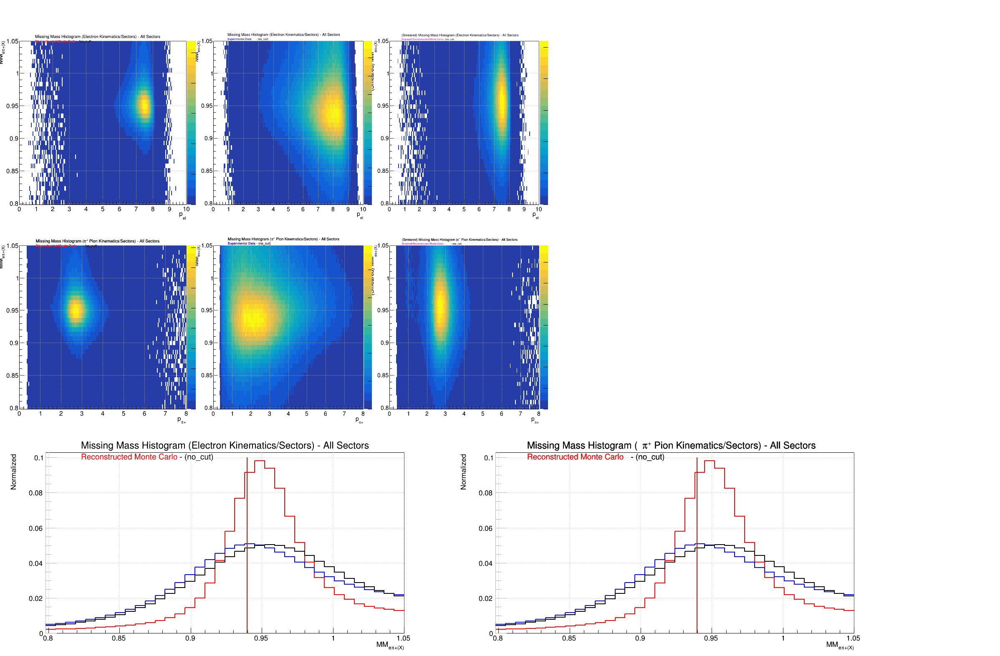

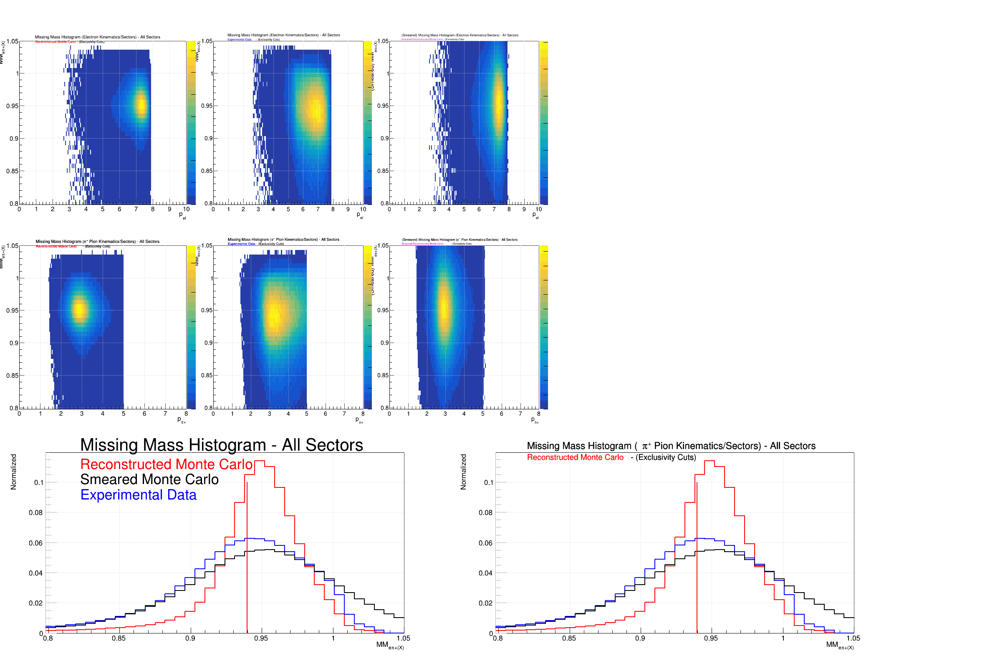

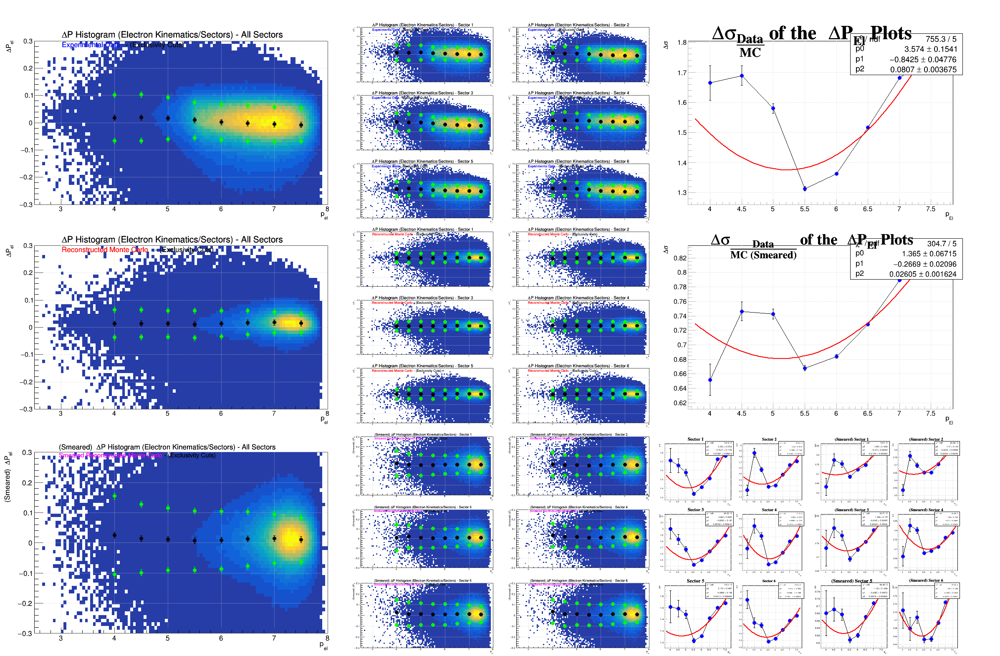

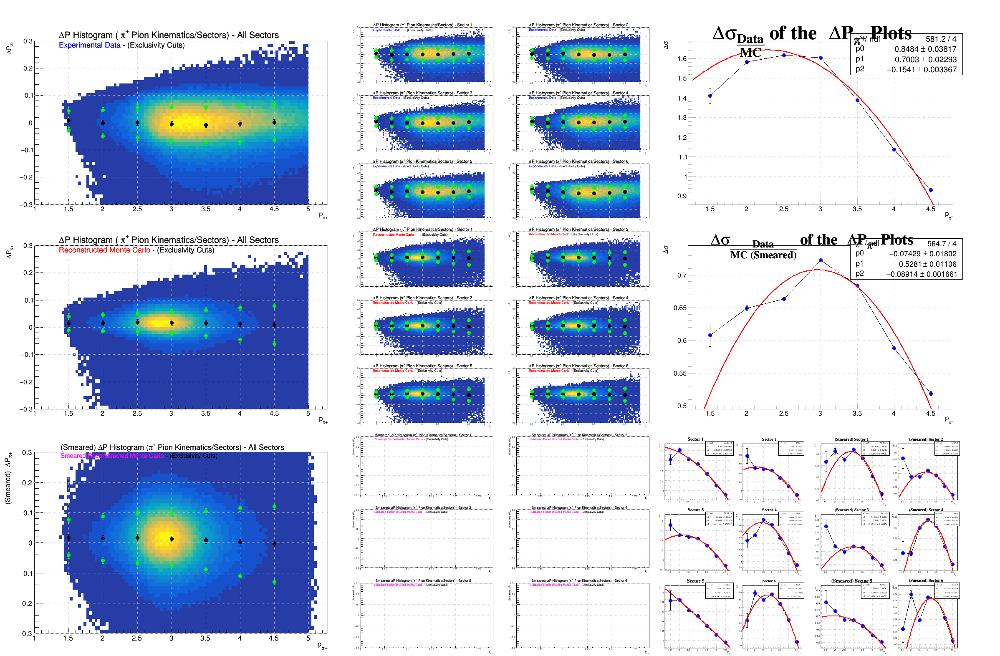

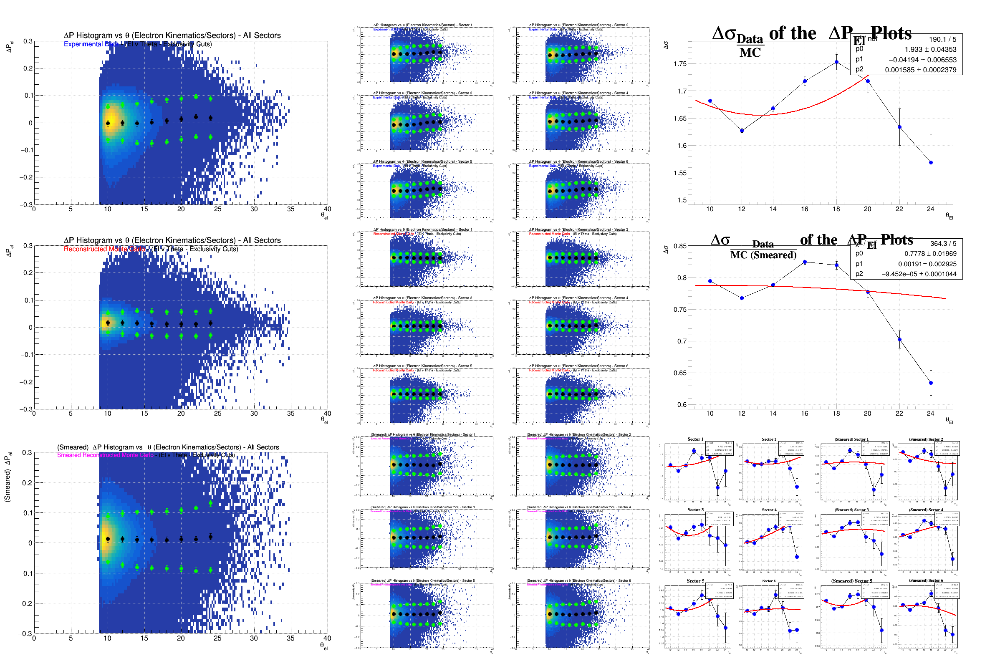

...

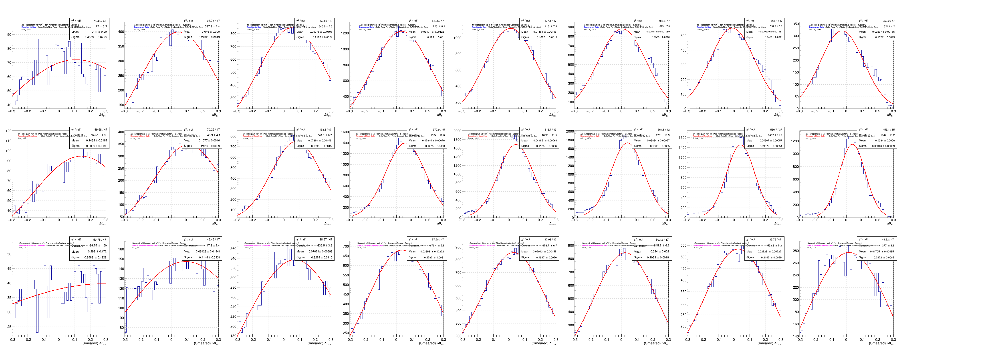

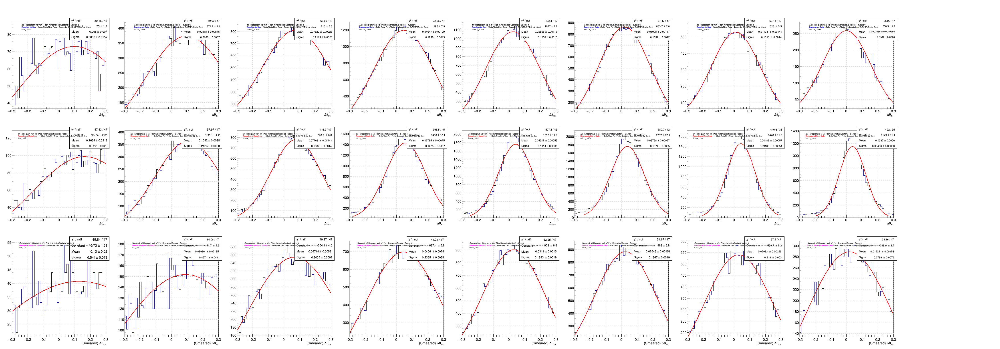

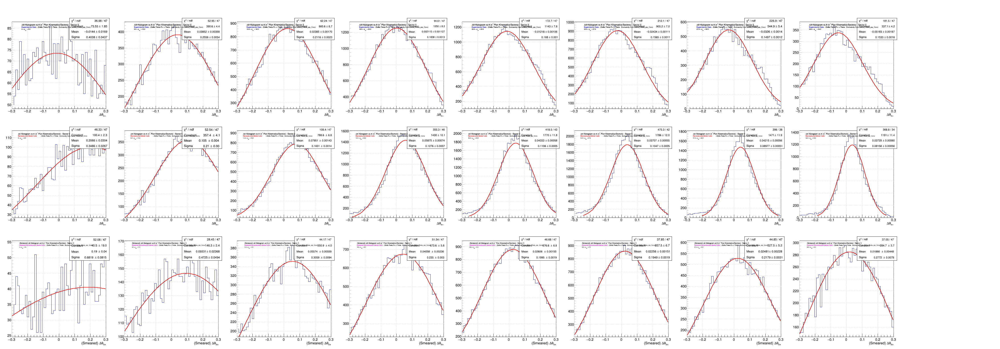

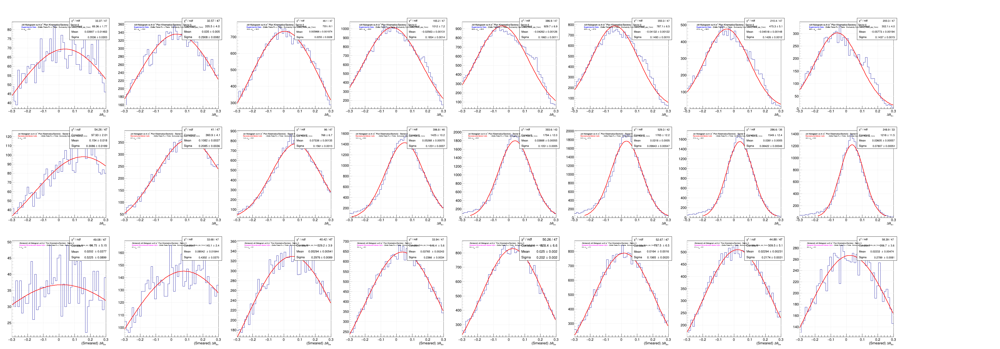

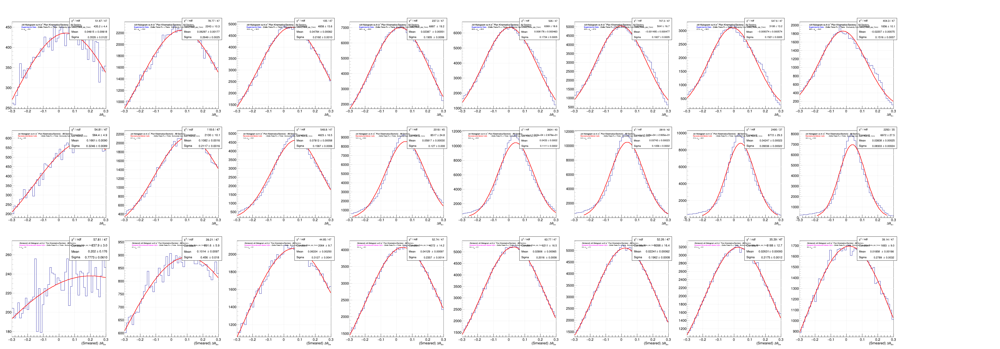

In [57]:
# try:
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


if(len(list_of_DF) == 1):
    Divide_or_1_canvas = "one"


if(('y' in Run_Exclusive_Study_Q) and 'y' in Run_this_cell):

    canvas_Exclusive, canvas_Exclusive_2, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}, {}
    list_of_canvas = []

    for datatype in list_of_DF:

        data_files_list = "error"

        if(datatype == 'rdf'):
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            print("\nExclusive Studies does not (currently) require the generated Monte Carlo files.\n")
            continue
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files


        # if("exclusive" not in data_files_list[0] and "Exclusive" not in data_files_list[0]):
        #     print("\nFile loaded may not be meant to show exclusive studies.\nMake sure the proper files are loaded.\n")
        #     print(datatype_file)
        #     print(data_files_list)
        #     break



        # print(data_files_list)

        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue



        for data_file in data_files_list:

            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##

            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")


            for ii in rdf.GetListOfKeys():

                output_name = str(ii.GetName())

                if(len(list_of_DF) != 1 and Divide_or_1_canvas != "one"):
                    canvas_name = (((((((output_name.replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")).replace("smear_", "")).replace("smear", "")
                else:
                    canvas_name = output_name

                cut_name = ((((((((((((((((output_name.replace("Mom_Cor_Histos - ", "")).replace("Missing Mass ", "")).replace("Delta P ", "")).replace("El - ", "")).replace("Pi+ - ", "")).replace("rdf", "")).replace("mdf", "")).replace("pdf", "")).replace("gdf", "")).replace("Delta_Pel_Cors", "")).replace("Delta_Ppip_Cors", "")).replace("2", "")).replace("MM", "")).replace("_smeared", "")).replace("smear_", "")).replace("', , '", "")).replace(", ''", "")

                # print(output_name)
                # print(canvas_name)

                if('Mom_Cor_Histos' in output_name):

                    if("Delta" in output_name and ("Exclusive" not in cut_name and "EDIS" not in cut_name)):
                        continue
                        # ∆P histograms must use exclusivity cuts only
                    if("SIDIS" in cut_name):
                        continue
                        # Skipping SIDIS cuts
                    if("gen" in cut_name):
                        continue
                        # Skipping matched generated histograms
                    # if("Theta" in output_name):
                    #     continue
                    #     # Skipping the anglular histograms for now
                    
                    # print(output_name)
                    # print(canvas_name)

                    try:
                        Exclusive_Histo[output_name] = rdf.Get(output_name)
                        title_true = Exclusive_Histo[output_name].GetTitle()
                    except:
                        print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))

                    sector_list_MM = ["all", 1, 2, 3, 4, 5, 6]
                    # sector_list_MM = ["all"]
                    # sector_list_MM = [1, 2, 3, 4, 5, 6]

                    # print(output_name)
                    # print(canvas_name)
                    # print("")

                    for sector in sector_list_MM:

                        sector_name = "".join([" - Sector ", str(sector)]) if(sector != "all") else " - All Sectors"

                        # for ii in sector_list_MM:
                        #     sector_name_2 = "".join([" - Sector ", str(ii)]) if(ii != "all") else " - All Sectors"
                        #     canvas_name = canvas_name.replace(sector_name_2, "")
                        # if(sector == "all" and sector_name not in canvas_name):
                        #     canvas_name = "".join([canvas_name, sector_name])
                        # if(sector != "all"):
                        #     canvas_name = (((canvas_name.replace("_rdf", "")).replace("_pdf", "")).replace("_gdf", "")).replace("_mdf", "")
                        #     canvas_name = "".join([canvas_name, "_", datatype_file])

                        output_name_2 = "".join([output_name, sector_name])
                        Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name].Clone()

                        if(sector != "all"):
                            Exclusive_Histo[output_name_2].GetZaxis().SetRangeUser(sector, sector)
                            Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')
                        else:
                            Exclusive_Histo[output_name_2] = Exclusive_Histo[output_name_2].Project3D('yx')

                        title = ((((title_true.replace(" z projection", "")).replace(" yz projection", "")).replace(" y projection", "")).replace(" yx projection", ""))
                        title = "".join([root_color.Line, "{#scale[1.5]{", title, sector_name, "}}{#scale[1.25]{", "".join(["#color[", str(root_color.Blue),"]{Experimental Data}"]) if("rdf" in output_name) else "".join(["#color[", str(root_color.Red) if("smear" not in output_name) else str(root_color.Pink),"]{", "Smeared " if("smear" in output_name) else "", "Reconstructed Monte Carlo}"]) if("mdf" in output_name or "pdf" in output_name) else "".join(["#color[", str(root_color.Green),"]{Generated Monte Carlo}"]), " - ", cut_name,"}}"])
                        title = title.replace("cut_Complete_EDIS", "Exclusivity Cuts")
                        Exclusive_Histo[output_name_2].SetTitle(title)

                        title_x = Exclusive_Histo[output_name_2].GetXaxis().GetTitle()
                        title_x = title_x.replace("#p_", "p_")
                        Exclusive_Histo[output_name_2].GetXaxis().SetTitle(title_x)

                        # if("Delta" in output_name):
                        #     Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(-0.3, 0.3)
                        #     if("No" not in cut_name):
                        #         if('#pi' in title_x):
                        #             if("Exclusive" in cut_name):
                        #                 fit2dPE(Exclusive_Histo[output_name_2], 1.25, 5, 0.5, title, "no", "pip")
                        #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
                        #         else:
                        #             if("Exclusive" in cut_name):
                        #                 # fit2dPE(Exclusive_Histo[output_name_2], 2.75, 7.75, 0.5, title, "no", "el")
                        #                 fit2dPE(Exclusive_Histo[output_name_2], 3.25, 7.75, 0.5, title, "no", "el")
                        #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)
                        # else:
                        #     Exclusive_Histo[output_name_2].GetYaxis().SetRangeUser(0.5 if("Exclusive" not in cut_name) else 0.8, 1.05 if("Exclusive" in cut_name) else 3.5)
                        #     if("No" not in cut_name):
                        #         if('#pi' in title_x):
                        #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(1, 5.25)
                        #         else:
                        #             Exclusive_Histo[output_name_2].GetXaxis().SetRangeUser(2.5, 8)

                        try:
                            canvas_Exclusive[canvas_name]
                        except:
                            Canvas_Divide_1 = 3 if("Missing Mass" not in canvas_name) else 1
                            Canvas_Divide_2 = 3 if(Divide_or_1_canvas != "one") else 1
                            Canvas_Size_X = 2400 if(Divide_or_1_canvas != "one") else 600
                            Canvas_Size_Y = 1600

                            canvas_Exclusive[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, Canvas_Size_X, Canvas_Size_Y)
                            canvas_Exclusive[canvas_name].Divide(Canvas_Divide_1, Canvas_Divide_2, 0, 0)
                            canvas_Exclusive[canvas_name].SetGrid()
                            ROOT.gStyle.SetAxisColor(16, 'xy')
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)
                            Num_of_canvas_made += 1


                        try:
                            canvas_Exclusive["".join([canvas_name, "_histos", sector_name])]
                        except:
                            canvas_Exclusive["".join([canvas_name, "_histos", sector_name])] = []

                        canvas_Exclusive["".join([canvas_name, "_histos", sector_name])].append(Exclusive_Histo[output_name_2])


    # Combined_List_of_Histograms = {}
    # Combined_List_of_Histograms["All Sectors"], Combined_List_of_Histograms["Sector 1"], Combined_List_of_Histograms["Sector 2"], Combined_List_of_Histograms["Sector 3"], Combined_List_of_Histograms["Sector 4"], Combined_List_of_Histograms["Sector 5"], Combined_List_of_Histograms["Sector 6"] = [], [], [], [], [], [], []




    for name in canvas_Exclusive:
        if("_histos" not in name and "Delta" in name):# and "v Theta" in name):
            # continue
            print("".join(["\n", str(name)]))
            canvas_Exclusive[name].Draw()

            canvas_Exclusive[name].cd(2).Divide(2, 3, 0, 0)
            canvas_Exclusive[name].cd(5).Divide(2, 3, 0, 0)
            canvas_Exclusive[name].cd(8).Divide(2, 3, 0, 0)
            canvas_Exclusive[name].cd(9).Divide(2, 1, 0.0001, 0.0001)
            canvas_Exclusive[name].cd(9).cd(1).Divide(2, 3, 0, 0)
            canvas_Exclusive[name].cd(9).cd(2).Divide(2, 3, 0, 0)

            # minR = 1.25 if("Pi+" in name) else 3.25
            minR = 1.25 if("Pi+" in name) else 3.75
            maxR = 5 if("Pi+" in name) else 7.75
            dR = 0.5
            Particle = "pip" if("Pi+" in name) else "el"

            if("v Theta" in name):
                minR = 6 if("Pi+" in name) else 9
                maxR = 34 if("Pi+" in name) else 25
                dR = 3.5 if("Pi+" in name) else 2
                Particle = "pip" if("Pi+" in name) else "el"


            for sector in [" - Sector 1", " - Sector 2", " - Sector 3", " - Sector 4", " - Sector 5", " - Sector 6", " - All Sectors"]:

                sector_num = 1 if("1" in sector) else 2 if("2" in sector) else 3 if("3" in sector) else 4 if("4" in sector) else 5 if("5" in sector) else 6 if("6" in sector) else 0

                name_histo = "".join([name, "_histos", sector])
                histos_from_list = canvas_Exclusive[name_histo]

                # print(histos_from_list)

                try:
                    histos_from_list[0].GetYaxis().SetRangeUser(-0.3, 0.3)
                    histos_from_list[1].GetYaxis().SetRangeUser(-0.3, 0.3)
                    histos_from_list[2].GetYaxis().SetRangeUser(-0.3, 0.3)
                except Exception as e: 
                    print(color.BOLD + color.RED + "Error Encountered:\n\t" + str(e) + color.END)
                    break

                # canvas_Exclusive[name].cd(3)
                Draw_Canvas(canvas_Exclusive[name], 3, 0.05, 0, 0, 0)

                Sigma_Smearing_Correction(histos_from_list[0], histos_from_list[1], histos_from_list[2], minR, maxR, dR, Particle, str(histos_from_list[0].GetTitle()), str(histos_from_list[1].GetTitle()), str(histos_from_list[2].GetTitle()))

                histos_from_list[0].gr2_Data_MC.SetMarkerColor(root_color.Blue)
                histos_from_list[0].gr2_Data_MC_Smear.SetMarkerColor(root_color.Blue)


                Sigma_Fit_Data_MC = ROOT.TF1("".join([str(name), sector, " MC"]), "[p0] + [p1]*x + [p2]*x*x", minR, maxR)
                Sigma_Fit_Data_MC_Smear = ROOT.TF1("".join([str(name), sector, " MC Smear"]), "[p0] + [p1]*x + [p2]*x*x", minR, maxR)

                histos_from_list[0].gr2_Data_MC.Fit("".join([str(name), sector, " MC"]), "RQ")
                histos_from_list[0].gr2_Data_MC_Smear.Fit("".join([str(name), sector, " MC Smear"]), "RQ")


                if("All" in sector):

                    print("".join(["\n// ", color.BOLD, "Unsmeared", color.END, " Fit of ", Particle, sector, ":\nmomR *= (", str(print_rounded_str(Sigma_Fit_Data_MC.GetParameter("p2"), 5)), ")*V4.P()*V4.P() + (", str(print_rounded_str(Sigma_Fit_Data_MC.GetParameter("p1"), 5)), ")*V4.P() + (", str(print_rounded_str(Sigma_Fit_Data_MC.GetParameter("p0"), 5)), ");"]))
                    print("".join(["\n// ", color.BOLD, "Smeared", color.END, " Fit of ", Particle, sector, ":\nmomR *= (", str(print_rounded_str(Sigma_Fit_Data_MC_Smear.GetParameter("p2"), 5)), ")*V4.P()*V4.P() + (", str(print_rounded_str(Sigma_Fit_Data_MC_Smear.GetParameter("p1"), 5)), ")*V4.P() + (", str(print_rounded_str(Sigma_Fit_Data_MC_Smear.GetParameter("p0"), 5)), ");"]))

                    # canvas_Exclusive[name].cd(3)
                    Draw_Canvas(canvas_Exclusive[name], 3, 0.05, 0, 0, 0)
                    histos_from_list[0].gr2_Data_MC.SetTitle("".join([root_color.Bold, "{#scale[2]{#Delta#sigma_{#frac{Data}{MC}} of the #DeltaP_{", "#pi^{+}" if(Particle == "pip") else "El","} Plots}}; ", "p" if("v Theta" not in name) else "#theta", "_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    histos_from_list[0].gr2_Data_MC.Draw("ALP same")


                    # canvas_Exclusive[name].cd(6)
                    Draw_Canvas(canvas_Exclusive[name], 6, 0.05, 0, 0, 0)
                    histos_from_list[0].gr2_Data_MC_Smear.SetTitle("".join([root_color.Bold, "{#scale[2]{#Delta#sigma_{#frac{Data}{MC (Smeared)}} of the #DeltaP_{", "#pi^{+}" if(Particle == "pip") else "El","} Plots}}; ", "p" if("v Theta" not in name) else "#theta", "_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    histos_from_list[0].gr2_Data_MC_Smear.Draw("ALP same")

                else:
                    Draw_Canvas(canvas_Exclusive[name].cd(9).cd(1), sector_num, 0.05, 0, 0, 0)
                    histos_from_list[0].gr2_Data_MC.SetTitle("".join([root_color.Bold, "{#scale[1.25]{Sector ", str(sector_num),"}}; ", "p" if("v Theta" not in name) else "#theta", "_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    # histos_from_list[0].gr2_Data_MC.SetTitle("".join([root_color.Bold, "{#splitline{#scale[1.25]{#Delta#sigma_{Data - MC} of the #DeltaP_{", "#pi^{+}" if(Particle == "pip") else "El","} Plots}{Sector ", str(sector_num),"}}}; p_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    histos_from_list[0].gr2_Data_MC.Draw("ALP same")

                    Draw_Canvas(canvas_Exclusive[name].cd(9).cd(2), sector_num, 0.05, 0, 0, 0)
                    histos_from_list[0].gr2_Data_MC_Smear.SetTitle("".join([root_color.Bold, "{#scale[1.25]{(Smeared) Sector ", str(sector_num),"}}; ", "p" if("v Theta" not in name) else "#theta", "_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    # histos_from_list[0].gr2_Data_MC_Smear.SetTitle("".join([root_color.Bold, "{#splitline{#scale[1.25]{#Delta#sigma_{Data - MC (Smeared)} of the #DeltaP_{", "#pi^{+}" if(Particle == "pip") else "El","} Plots}{Sector ", str(sector_num),"}}}; p_{", "#pi^{+}" if(Particle == "pip") else "El","}; #Delta#sigma"]))
                    histos_from_list[0].gr2_Data_MC_Smear.Draw("ALP same")

                # canvas_Exclusive[name].cd(9)
                # histos_from_list[0].gr2_Data_MC_Smear.Draw("AP same")

                if("All" in sector):
                    Draw_Canvas(canvas_Exclusive[name], 1, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[0].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[0].GetXaxis().SetRangeUser(1, 5.25)
                        else:
                            histos_from_list[0].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[0].Draw("col")
                        histos_from_list[0].gr.Draw("P")
                    else:
                        histos_from_list[0].Draw("col")
                        histos_from_list[0].gr.Draw("P")
                    try:
                        histos_from_list[0].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[0].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[0].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[0].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[0].gr_sigma_up.Draw("P")
                        histos_from_list[0].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")

                    Draw_Canvas(canvas_Exclusive[name], 4, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[1].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[1].GetXaxis().SetRangeUser(1, 5.25)
                        else:
                            histos_from_list[1].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[1].Draw("col")
                        histos_from_list[1].gr.Draw("P")
                    else:
                        histos_from_list[1].Draw("col")
                        histos_from_list[1].gr.Draw("P")
                    try:
                        histos_from_list[1].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[1].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[1].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[1].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[1].gr_sigma_up.Draw("P")
                        histos_from_list[1].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")

                    Draw_Canvas(canvas_Exclusive[name], 7, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[2].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[2].GetXaxis().SetRangeUser(1, 5.25)
                        else:
                            histos_from_list[2].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[2].Draw("col")
                        histos_from_list[2].gr.Draw("P")
                    else:
                        histos_from_list[2].Draw("col")
                        histos_from_list[2].gr.Draw("P")
                    try:
                        histos_from_list[2].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[2].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[2].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[2].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[2].gr_sigma_up.Draw("P")
                        histos_from_list[2].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")


                else:
                    Draw_Canvas(canvas_Exclusive[name].cd(2), sector_num, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[0].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[0].GetXaxis().SetRangeUser(1, 5.25)
                        else:
                            histos_from_list[0].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[0].Draw("col")
                        histos_from_list[0].gr.Draw("P")
                    else:
                        histos_from_list[0].Draw("col")
                        histos_from_list[0].gr.Draw("P")
                    try:
                        histos_from_list[0].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[0].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[0].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[0].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[0].gr_sigma_up.Draw("P")
                        histos_from_list[0].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")
                    Draw_Canvas(canvas_Exclusive[name].cd(5), sector_num, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[1].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[1].GetXaxis().SetRangeUser(1, 5.25)
                        else:
                            histos_from_list[1].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[1].Draw("col")
                        histos_from_list[1].gr.Draw("P")
                    else:
                        histos_from_list[1].Draw("col")
                        histos_from_list[1].gr.Draw("P")
                    try:
                        histos_from_list[1].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[1].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[1].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[1].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[1].gr_sigma_up.Draw("P")
                        histos_from_list[1].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")
                    Draw_Canvas(canvas_Exclusive[name].cd(8), sector_num, 0.05, 0, 0, 0)
                    if("Theta" not in name):
                        histos_from_list[2].GetYaxis().SetRangeUser(-0.3, 0.3)
                        if("Pi+" in name):
                            histos_from_list[2].GetXaxis().SetRangeUser(1, 1.25)
                        else:
                            histos_from_list[2].GetXaxis().SetRangeUser(2.5, 8)
                        histos_from_list[2].Draw("col")
                        histos_from_list[2].gr.Draw("P")
                    else:
                        histos_from_list[2].Draw("col")
                        histos_from_list[2].gr.Draw("P")
                    try:
                        histos_from_list[2].gr_sigma_up.SetLineColor(root_color.Green)
                        histos_from_list[2].gr_sigma_down.SetLineColor(root_color.Green)
                        histos_from_list[2].gr_sigma_up.SetMarkerColor(root_color.Green)
                        histos_from_list[2].gr_sigma_down.SetMarkerColor(root_color.Green)
                        histos_from_list[2].gr_sigma_up.Draw("P")
                        histos_from_list[2].gr_sigma_down.Draw("P")
                    except:
                        print("Error with Sigma Peaks")





                try:
#                     fail
                    # Sigma_Smearing_Correction(histos_from_list[0], histos_from_list[1], histos_from_list[2], minR, maxR, dR, Particle, str(histos_from_list[0].GetTitle()), str(histos_from_list[1].GetTitle()), str(histos_from_list[2].GetTitle()))

                    try:
                        canvas_Exclusive_2["".join([name, "_1D", sector])]
                    except:
                        Canvas_Divide_1 = 1
                        Canvas_Divide_2 = 3
                        Canvas_Size_X = 4500
                        Canvas_Size_Y = 1600

                        canvas_Exclusive_2["".join([name, "_1D", sector])] = ROOT.TCanvas("".join([name, "_1D", sector]), "".join([name, "_1D", sector]), Canvas_Size_X, Canvas_Size_Y)
                        canvas_Exclusive_2["".join([name, "_1D", sector])].Divide(Canvas_Divide_1, Canvas_Divide_2, 0, 0)
                        canvas_Exclusive_2["".join([name, "_1D", sector])].SetGrid()
                        ROOT.gStyle.SetAxisColor(16, 'xy')
                        ROOT.gStyle.SetOptStat(0)
                        ROOT.gStyle.SetOptFit(1)
                        Num_of_canvas_made += 1

                    canvas_Exclusive_2["".join([name, "_1D", sector])].Draw()

                    # canvas_Exclusive_2["".join([name, "_1D", sector])].cd(1)

                    canvas_Exclusive_2["".join([name, "_1D", sector])].cd(1).Divide(len(histos_from_list[0].hys), 1, 0.001, 0.001)
                    canvas_Exclusive_2["".join([name, "_1D", sector])].cd(2).Divide(len(histos_from_list[1].hys), 1, 0.001, 0.001)
                    canvas_Exclusive_2["".join([name, "_1D", sector])].cd(3).Divide(len(histos_from_list[2].hys), 1, 0.001, 0.001)

                    histo_1d_from_list_cd = 1
                    for histo_1d_from_list in histos_from_list[0].hys:
                        Draw_Canvas(canvas_Exclusive_2["".join([name, "_1D", sector])].cd(1), histo_1d_from_list_cd, 0.05, 0, 0, 0)
                        histo_1d_from_list.Draw("same")
                        histo_1d_from_list_cd += 1

                    histo_1d_from_list_cd = 1
                    for histo_1d_from_list in histos_from_list[1].hys:
                        Draw_Canvas(canvas_Exclusive_2["".join([name, "_1D", sector])].cd(2), histo_1d_from_list_cd, 0.05, 0, 0, 0)
                        histo_1d_from_list.Draw("same")
                        histo_1d_from_list_cd += 1

                    histo_1d_from_list_cd = 1
                    for histo_1d_from_list in histos_from_list[2].hys:
                        Draw_Canvas(canvas_Exclusive_2["".join([name, "_1D", sector])].cd(3), histo_1d_from_list_cd, 0.05, 0, 0, 0)
                        histo_1d_from_list.Draw("same")
                        histo_1d_from_list_cd += 1

                except:
                    print("Failed to fit...")

        else:
            # continue
            print(name)
            # print(canvas_Exclusive[name])
            if("Missing Mass "in name and "histo" not in name and "El" in name):
                test_canvas = canvas_Exclusive[name]
                test_canvas.cd(3).Divide(2, 1, 0.001, 0.001)
            if("Missing Mass " in name and "All Sectors" in name and "histos" in name):# and "cut_Complete_EDIS" in name): #"No Cut" in name):#"Exclusive" in name):
                try:
                    canvas_Exclusive[name].Draw()
                    print(str(name) + " -> not a list")
                except:
                    test_canvas.Draw()
                    # test_canvas.Divide(1, len(canvas_Exclusive[name]), 0, 0)
                    test_canvas.cd(1 if("El" in name) else 2).Divide(len(canvas_Exclusive[name]), 1, 0, 0)
                    cd_num = 1
                    for ii in [1, 0, 2]:
                        test = canvas_Exclusive[name][ii]
                        Draw_Canvas(test_canvas.cd(1 if("El" in name) else 2), cd_num, 0.05, 0, 0, 0)
                        # test_canvas.cd(1 if("El" in name) else 2).cd(cd_num)
                        # print(type(test))
                        test.GetYaxis().SetRangeUser(0.8, 1.05)
                        # test.GetXaxis().SetRangeUser(2.6 if("El" in name) else 1, 8 if("El" in name) else 5.05)
                        test.Draw("colz")
                        cd_num += 1
                        test_1D = test.ProjectionY()
                        test_1D.SetLineColor(root_color.Blue if("Experimental" in test_1D.GetTitle()) else root_color.Red if("Smeared" not in test_1D.GetTitle()) else root_color.Black)
                        test_1D.SetLineWidth(2)
                        test_canvas.cd(3).cd(1 if("El" in name) else 2)
                        ROOT.gPad.SetLogy(0)
                        test_1D.SetTitle(str(test_1D.GetTitle()).replace("#splitline{#scale[1.5]{Missing Mass Histogram (Electron Kinematics/Sectors) - All Sectors}}{#scale[1.25]{#color[2]{Reconstructed Monte Carlo} - (Exclusivity Cuts)}}", "".join(["#splitline{#scale[1.5]{Missing Mass Histogram - All Sectors}}{#scale[1.25]{#splitline{#splitline{#color[2]{Reconstructed Monte Carlo}}{#color[", str(root_color.Black),"]{Smeared Monte Carlo}}}{#color[", str(root_color.Blue),"]{Experimental Data}}}}"])))
                        test_1D.GetYaxis().SetTitle("Normalized")
                        test_1D.DrawNormalized("same")
                        line_test = ROOT.TLine()
                        line_test.SetLineColor(root_color.Red)
                        line_test.SetLineWidth(2)
                        line_test.DrawLine(0.9396, 0, 0.9396, 0.1)
#                         print(test_1D.GetTitle())

                        
                        # print(str(name) + " -> is a list")
            # for name_histo_2 in canvas_Exclusive[name]:
            #     print("".join(["\t", name_histo_2.GetName()]))







# #     for canvas_name_loop in canvas_Exclusive:
# #         if("Delta P" in canvas_name_loop):
# #             print(canvas_name_loop)
# #             canvas_Exclusive[canvas_name_loop].Draw()


else:
    print(color.BOLD + "\n\n\nCell not being run\n\n\n" + color.END)
# except Exception as e:
#     print(color.BOLD + color.RED + "ERROR:\n" + str(e) + color.END)

(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '-1', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '1', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '2', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '3', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '4', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '5', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '6', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '7', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '8', 'Q2', 'xB')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '-1', 'y', 'xF')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '1', 'y', 'xF')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '2', 'y', 'xF')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '3', 'y', 'xF')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '4', 'y', 'xF')
(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '5', 'y', 'xF')
(2D Histogram - 'no_cut', '2'

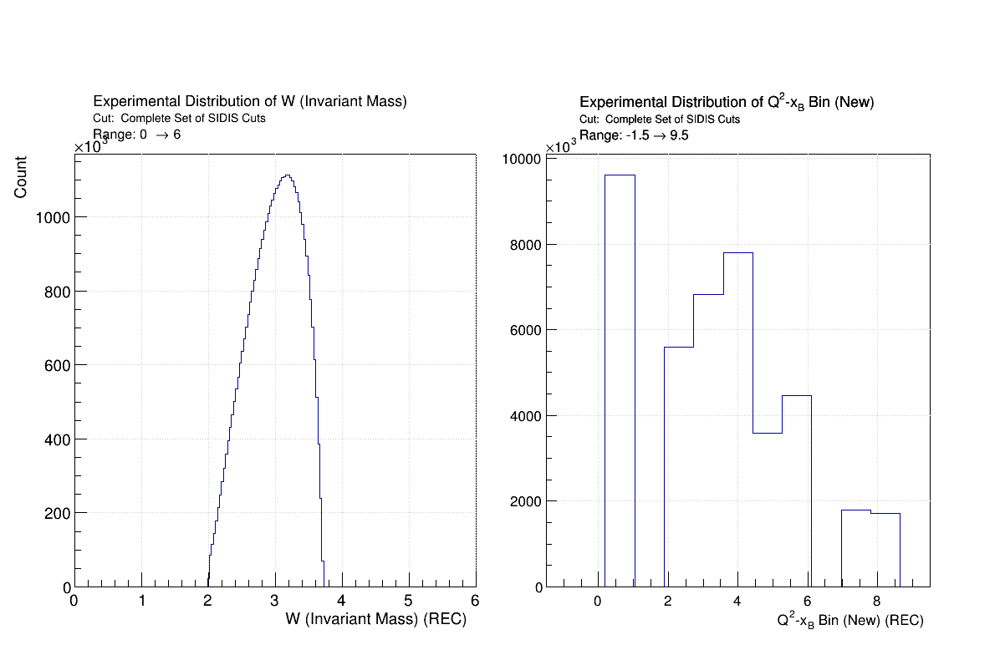

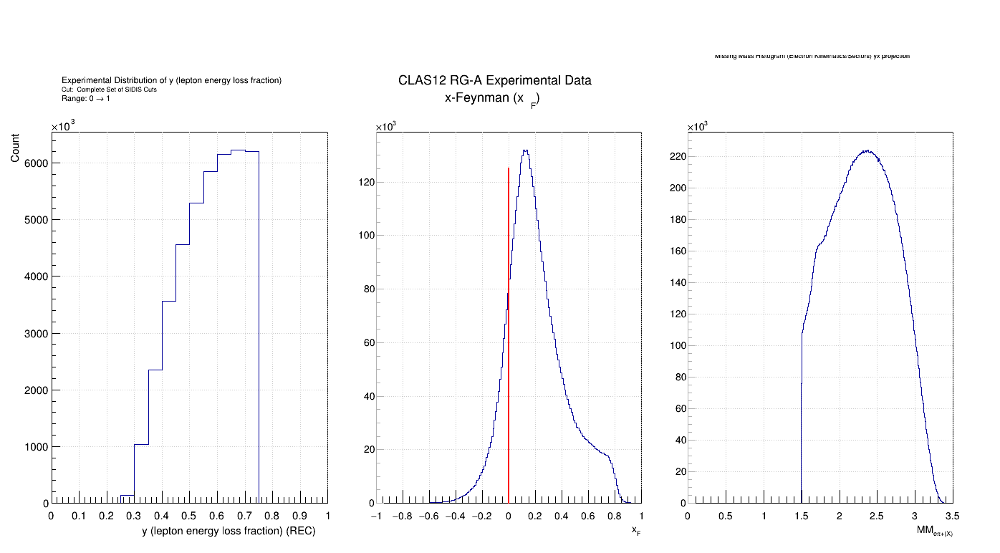

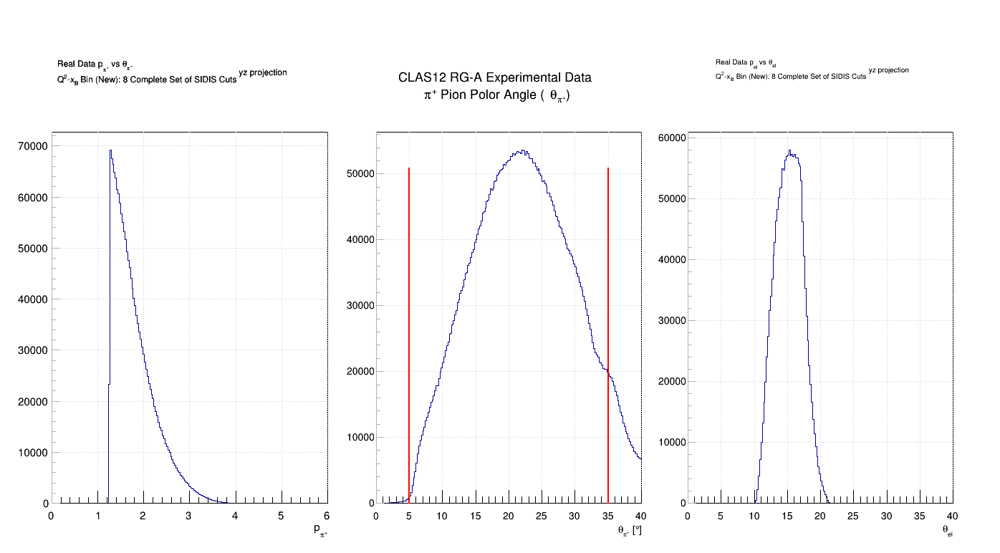

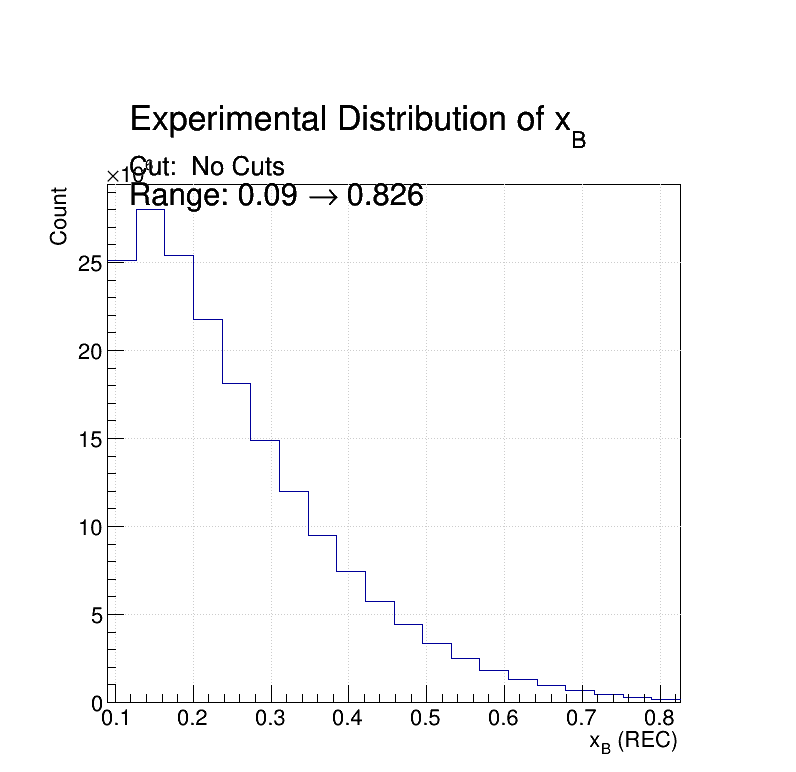

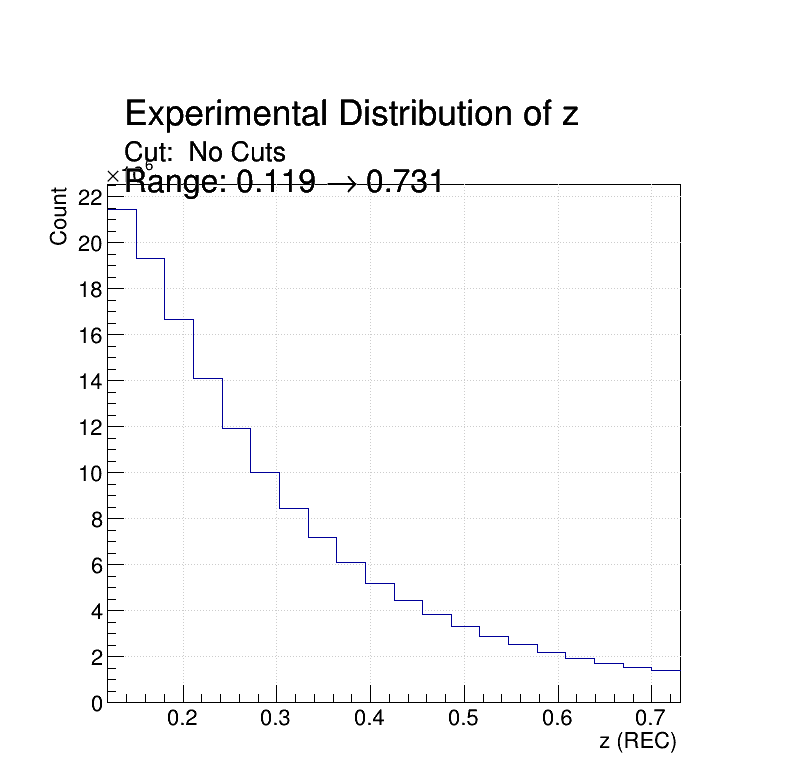

...

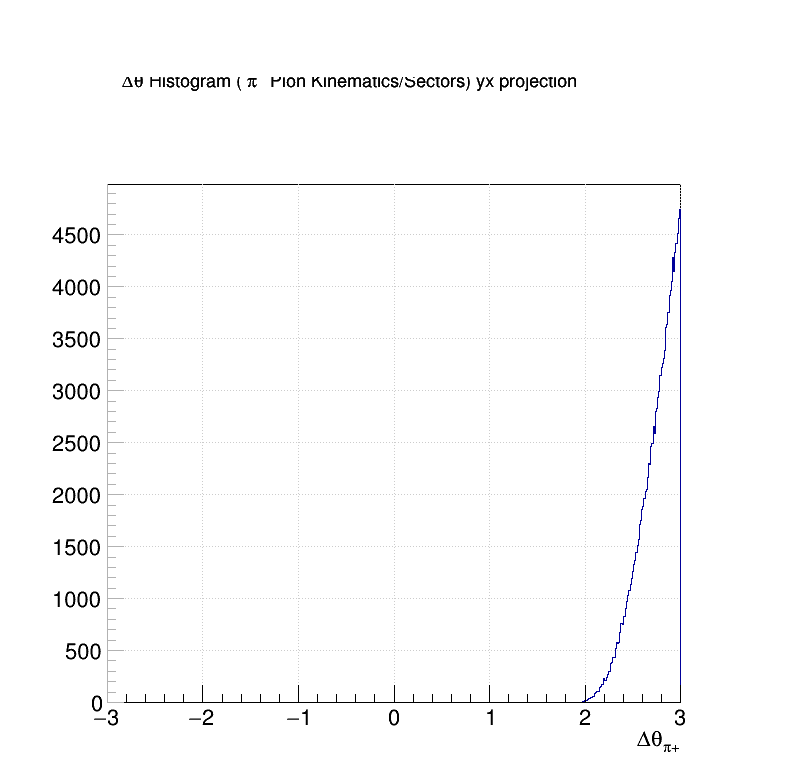

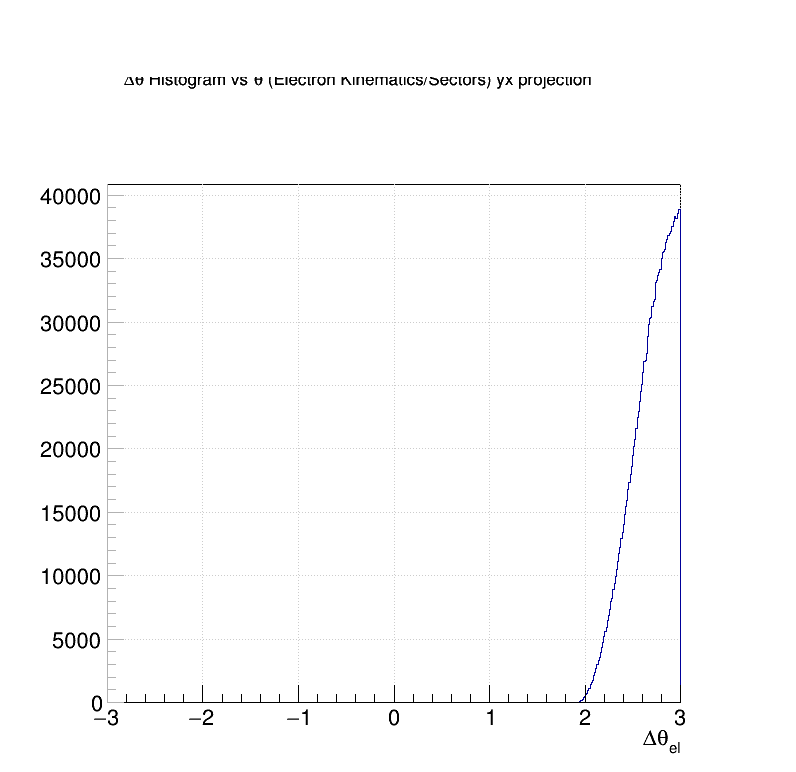

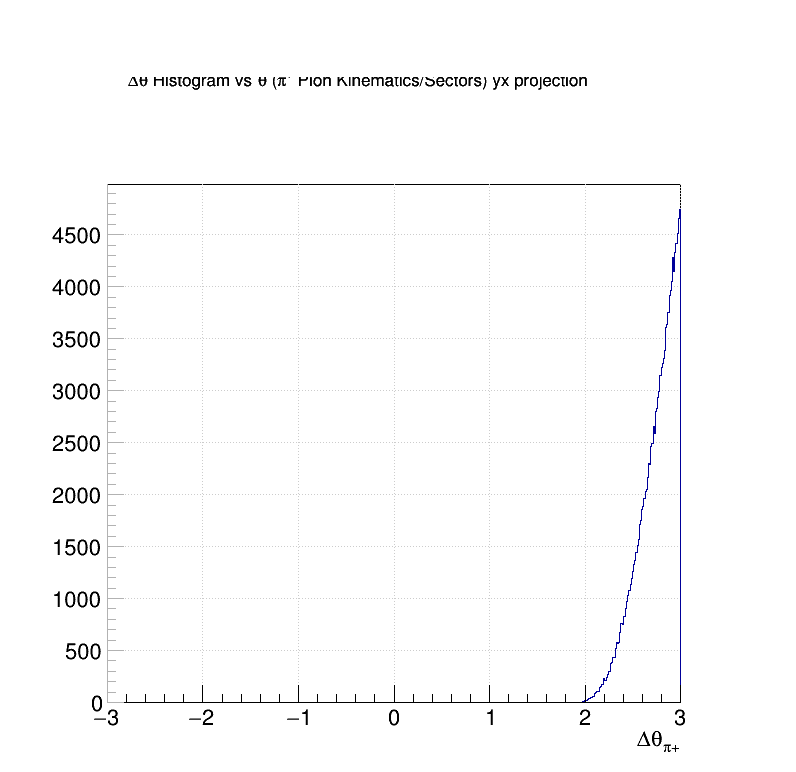

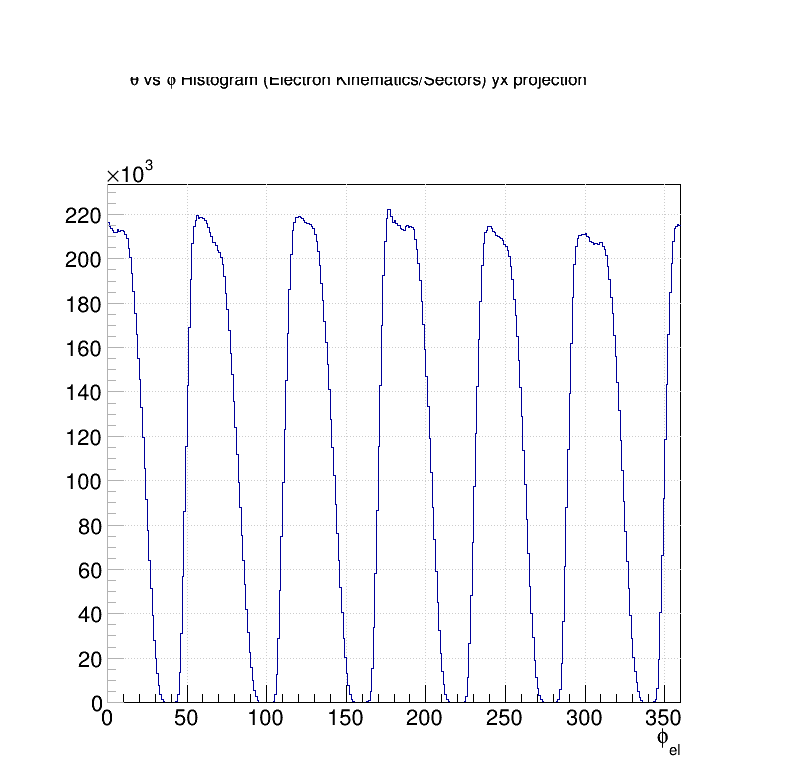

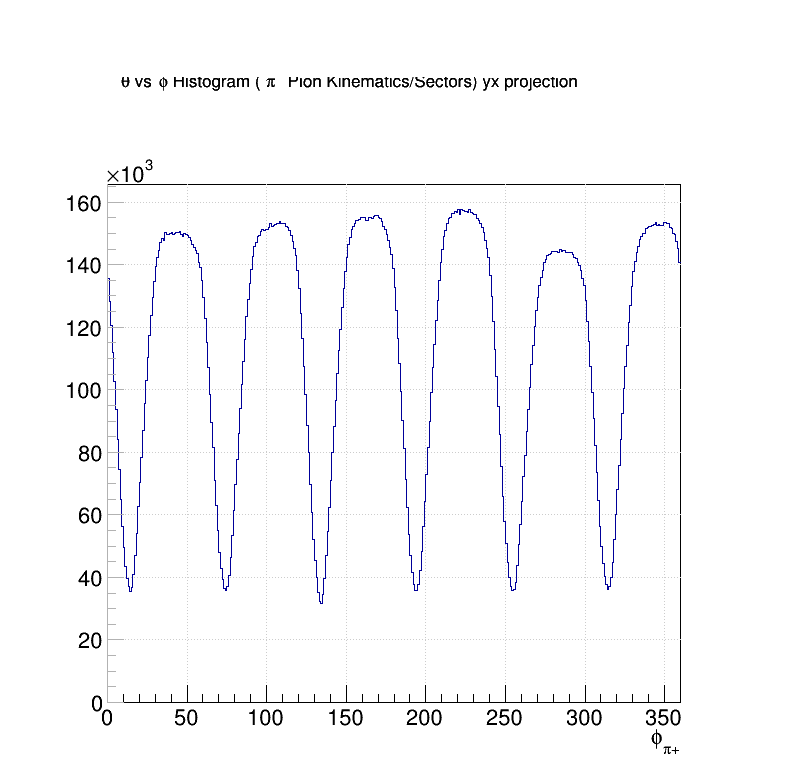

In [58]:
ROOT.gStyle.SetTitleY(1.025)
# try:
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


if(len(list_of_DF) == 1):
    Divide_or_1_canvas = "one"


if(('y' in Run_Exclusive_Study_Q) and 'y' in Run_this_cell):

    # canvas_Exclusive, canvas_Exclusive_2, Exclusive_Histo, Stat_boxes, line_list = {}, {}, {}, {}, {}
    # list_of_canvas = []
    canvas_MM = {}

    for datatype in list_of_DF:

        data_files_list = "error"

        if(datatype == 'rdf'):
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        else:
            continue
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             print("\nExclusive Studies does not (currently) require the generated Monte Carlo files.\n")
#             continue
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files


        # print(data_files_list)

        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue



        for data_file in data_files_list:

            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##

            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")


            for ii in rdf.GetListOfKeys():

                output_name = str(ii.GetName())
            
            
                if("'z', 'pT'" in output_name):
                    
                    if("no_cut" in output_name or ("'-1', '-1'" not in output_name and "'-1', '8'" not in output_name)):
                        continue

                    print(output_name)
                    canvas_name = output_name
                    num_X, num_Y, size_X, size_Y = 2, 1, 1200, 800
                    # output_name_2 = "(2D Histogram - 'cut_Complete_SIDIS', '2', 'rdf', '', '-1', '-1', 'Q2', 'xB')"
                    output_name_2 = "(2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '-1', 'Q2', 'xB')"
                    histo = rdf.Get(output_name)
                    histo2 = rdf.Get(output_name_2)
                    if("TH3D" in str(type(histo))):
                        histo = histo.Project3D("yz")
                    if("TH3D" in str(type(histo2))):
                        histo2 = histo2.Project3D("yz")  
                    try:
                        canvas_MM[canvas_name]
                    except:
                        canvas_MM[canvas_name] = Canvas_Create(canvas_name, num_X, num_Y, size_X, size_Y, 0)
                        
                    canvas_MM[canvas_name].Draw()
                    Draw_Canvas(canvas_MM[canvas_name], 1, left_add=0.05, right_add=0, up_add=0.055, down_add=0)
                    ROOT.gPad.SetLogz(1)
                    histo2.Draw("colz")
                    histo2.SetTitle("Q2-xB")
                    palette_move(canvas_MM[canvas_name], histo2, 0.0175, 0.0175, -0.05)
                    Q2_xB_borders, line_num = {}, 0
                    for b_lines in Q2_xB_Border_Lines(-1):
                        Q2_xB_borders[line_num] = ROOT.TLine()
                        Q2_xB_borders[line_num].SetLineColor(1)
                        Q2_xB_borders[line_num].SetLineWidth(4)
                        Q2_xB_borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                        line_num += 1
                    if("8" in output_name):
                        Q2_xB_borders, line_num = {}, 0
                        for b_lines in Q2_xB_Border_Lines(8):
                            Q2_xB_borders[line_num] = ROOT.TLine()
                            Q2_xB_borders[line_num].SetLineColor(root_color.Red)
                            Q2_xB_borders[line_num].SetLineWidth(5)
                            Q2_xB_borders[line_num].DrawLine(b_lines[0][0], b_lines[0][1], b_lines[1][0], b_lines[1][1])
                            line_num += 1

                    Draw_Canvas(canvas_MM[canvas_name], 2, left_add=0.05, right_add=0, up_add=0.055, down_add=0)
                    ROOT.gPad.SetLogz(1)
                    histo.Draw("colz")
                    histo.SetTitle("z-pT")
                    palette_move(canvas_MM[canvas_name], histo, 0.0175, 0.0175, -0.05)
                    if("8" in output_name):
                        histo.GetXaxis().SetRangeUser(0, 1)
                        histo.GetYaxis().SetRangeUser(0.1, 0.8)
                        
                        z_pT_borders = {}
                        Max_z = max(z_pT_Border_Lines(8)[0][2])
                        Min_z = min(z_pT_Border_Lines(8)[0][2])
                        Max_pT = max(z_pT_Border_Lines(8)[1][2])
                        Min_pT = min(z_pT_Border_Lines(8)[1][2])
                        for zline in z_pT_Border_Lines(8)[0][2]:
                            for pTline in z_pT_Border_Lines(8)[1][2]:
                                z_pT_borders[zline] = ROOT.TLine()
                                z_pT_borders[zline].SetLineColor(1)
                                z_pT_borders[zline].SetLineWidth(4)
                                z_pT_borders[zline].DrawLine(Max_pT, zline, Min_pT, zline)
                                z_pT_borders[pTline] = ROOT.TLine()
                                z_pT_borders[pTline].SetLineColor(1)
                                z_pT_borders[pTline].SetLineWidth(4)
                                z_pT_borders[pTline].DrawLine(pTline, Max_z, pTline, Min_z)
                        ##=====================================================##
                        ##==========##     TEMPORARY CONDITION     ##==========##
                        ##=====================================================##
                            z_pT_borders["fz_min"] = ROOT.TLine()

                            z_pT_borders["fz_min"].SetLineColor(2)
                            z_pT_borders["fz_min"].SetLineWidth(5)

                            z_pT_borders["fpT_min"] = ROOT.TLine()

                            z_pT_borders["fpT_min"].SetLineColor(2)
                            z_pT_borders["fpT_min"].SetLineWidth(5)

                            z_pT_borders["fz_max"] = ROOT.TLine()

                            z_pT_borders["fz_max"].SetLineColor(2)
                            z_pT_borders["fz_max"].SetLineWidth(5)

                            z_pT_borders["fpT_max"] = ROOT.TLine()

                            z_pT_borders["fpT_max"].SetLineColor(2)
                            z_pT_borders["fpT_max"].SetLineWidth(5)

                            z_pT_borders["fz_min"].DrawLine(0.05, 0.22, 0.05, 0.3)
                            z_pT_borders["fpT_min"].DrawLine(0.05, 0.22, 0.23, 0.22)
                            z_pT_borders["fz_max"].DrawLine(0.23, 0.22, 0.23, 0.3)
                            z_pT_borders["fpT_max"].DrawLine(0.05, 0.3, 0.23, 0.3)
                        ##=====================================================##
                        ##==========##     TEMPORARY CONDITION     ##==========##
                        ##=====================================================##
                    
                    
                else:
                    
#                     # print(output_name)
#                     if("no_cut" not in output_name):
#                         continue

#                     # print(output_name)
#                     if("Missing Mass El" not in output_name and "_Normal_1D', 'W'" not in output_name and "2D Histogram - 'no_cut', '2', 'rdf', '', '-1', '-1'" not in output_name):
#                         continue

                    canvas_name = output_name
                    num_X, num_Y, size_X, size_Y = 1, 1, 800, 800
                    cd_num = 1
                    if("_Normal_1D', 'W'" in output_name or 'Q2' in output_name):
                        canvas_name = "SIDIS_cut"
                        num_X, num_Y, size_X, size_Y = 2, 1, 1200, 800
                        cd_num = 1 if("_Normal_1D', 'W'" in output_name) else 2

                    if("'el', 'elth'" in output_name or "'pip', 'pipth'" in output_name):
                        canvas_name = "Other_cuts_1"
                        num_X, num_Y, size_X, size_Y = 3, 1, 1400, 800
                        cd_num = 3 if("'el', 'elth'" in output_name) else 1

                    if("y" in output_name or 'xF' in output_name or "Missing Mass El" in output_name):
                        canvas_name = "Other_cuts_2"
                        num_X, num_Y, size_X, size_Y = 3, 1, 1400, 800
                        cd_num = 3 if("Missing Mass El" in output_name) else 1



                    try:
                        canvas_MM[canvas_name]
                    except:
                        canvas_MM[canvas_name] = Canvas_Create(canvas_name, num_X, num_Y, size_X, size_Y, 0)

                    canvas_MM[canvas_name].Draw()
                    Draw_Canvas(canvas_MM[canvas_name], cd_num, left_add=0.1 if(cd_num == 1) else 0.05, right_add=0, up_add=0.055, down_add=0)
                    histo = rdf.Get(output_name)

                    histo2 = "error"
                    if("2D Histogram" not in output_name):
                        if("TH3D" in str(type(histo))):
                            histo = histo.Project3D("yx")
                        if("TH2D" in str(type(histo))):
                            histo = histo.ProjectionY()
                    else:
                        if("TH3D" in str(type(histo))):
                            histo = histo.Project3D("yz")    
                        if("TH2D" in str(type(histo))):
                            if("'y', 'xF'" not in output_name and "'el', 'elth'" not in output_name and "'pip', 'pipth'" not in output_name):
                                histo = histo.ProjectionY()
                            elif("'y', 'xF'" in output_name):
                                histo2 = histo
                                histo2 = histo2.ProjectionX()
                                histo = histo.ProjectionY()
                            elif("'el', 'elth'" in output_name):
                                histo = histo.ProjectionX()
                            elif("'pip', 'pipth'" in output_name):
                                histo2 = histo
                                histo2 = histo2.ProjectionX()
                                histo = histo.ProjectionY()

                    histo.GetYaxis().SetRangeUser(0, 1.05*histo.GetMaximum())

                    histo.Draw("colz")

                    cut_line = ROOT.TLine()
                    cut_line.SetLineColor(root_color.Red)
                    cut_line.SetLineWidth(2)

                    if("Normal" in output_name or "Mom_Cor_Histos" in output_name or "no_cut" not in output_name):
                        continue
                    print(output_name)
                    

                    if("Missing Mass El" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{                 Missing Mass}}; MM_{e#pi^{+}(X) [GeV]}")
                        cut_line.DrawLine(1.5, 0, 1.5, 0.95*histo.GetMaximum())
                    elif("_Normal_1D', 'W'" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{           Invariant Mass (W)}}; W [GeV];Counts")
                        cut_line.DrawLine(2, 0, 2, 0.95*histo.GetMaximum())
                    elif("Q2" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{             Q^{2} Distribution}}; Q^{2} [GeV^{2}]")
                        cut_line.DrawLine(2, 0, 2, 0.95*histo.GetMaximum())
                    elif("'y', 'xF'" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{ Lepton Energy Loss Fraction (y)}}; y;Counts")
                        cut_line.DrawLine(0.75, 0, 0.75, 0.95*histo.GetMaximum())
                        Draw_Canvas(canvas_MM[canvas_name], cd_num + 1, left_add=0.05, right_add=0, up_add=0.055, down_add=0)
                        histo2.Draw("colz")
                        histo2.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{             x-Feynman (x_{F})}}; x_{F}")
                        cut_line.DrawLine(0, 0, 0, 0.95*histo2.GetMaximum())
                    elif("'el', 'elth'" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{      Electron Polor Angle (#theta_{El})}}; #theta_{El} [#circ]")
                        cut_line.DrawLine(5, 0, 5, 0.95*histo.GetMaximum())
                        cut_line2 = ROOT.TLine()
                        cut_line2.SetLineColor(root_color.Red)
                        cut_line2.SetLineWidth(2)
                        cut_line2.DrawLine(35, 0, 35, 0.95*histo.GetMaximum())
                    elif("'pip', 'pipth'" in output_name):
                        histo.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{      #pi^{+} Pion Momentum (p_{#pi^{+}})}}; p_{#pi^{+} [GeV]}")
                        cut_line.DrawLine(5, 0, 5, 0.95*histo.GetMaximum())
                        cut_line2 = ROOT.TLine()
                        cut_line2.SetLineColor(root_color.Red)
                        cut_line2.SetLineWidth(2)
                        cut_line2.DrawLine(1.25, 0, 1.25, 0.95*histo.GetMaximum())
                        Draw_Canvas(canvas_MM[canvas_name], cd_num + 1, left_add=0.05, right_add=0, up_add=0.055, down_add=0)
                        histo2.SetTitle("#scale[2]{#splitline{CLAS12 RG-A Experimental Data}{      #pi^{+} Pion Polor Angle (#theta_{#pi^{+}})}}; #theta_{#pi^{+}} [#circ]")
                        histo2.Draw("colz")
                        cut_line.DrawLine(5, 0, 5, 0.95*histo2.GetMaximum())
                        cut_line2.DrawLine(35, 0, 35, 0.95*histo2.GetMaximum())


                    # print(histo.GetMaximum())

                

('Response_Matrix_Normal_1D', 'xB', '2', 'no_cut', '', -1, 'rdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2', '2', 'no_cut', '', -1, 'rdf')
1D
('Response_Matrix_Normal_1D', 'xB', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
1D
('Response_Matrix_Normal_1D', 'xB', '2', 'no_cut', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2', '2', 'no_cut', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'xB', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'xB_smeared', 'smear_2', 'no_cut', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2_smeared', 'smear_2', 'no_cut', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'xB_smeared', 'smear_2', 'cut_Complete_SIDIS', '', -1, 'mdf')
1D
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2_smeared', 'smear_2', 'cut_Complete_SIDIS', '', -1, 

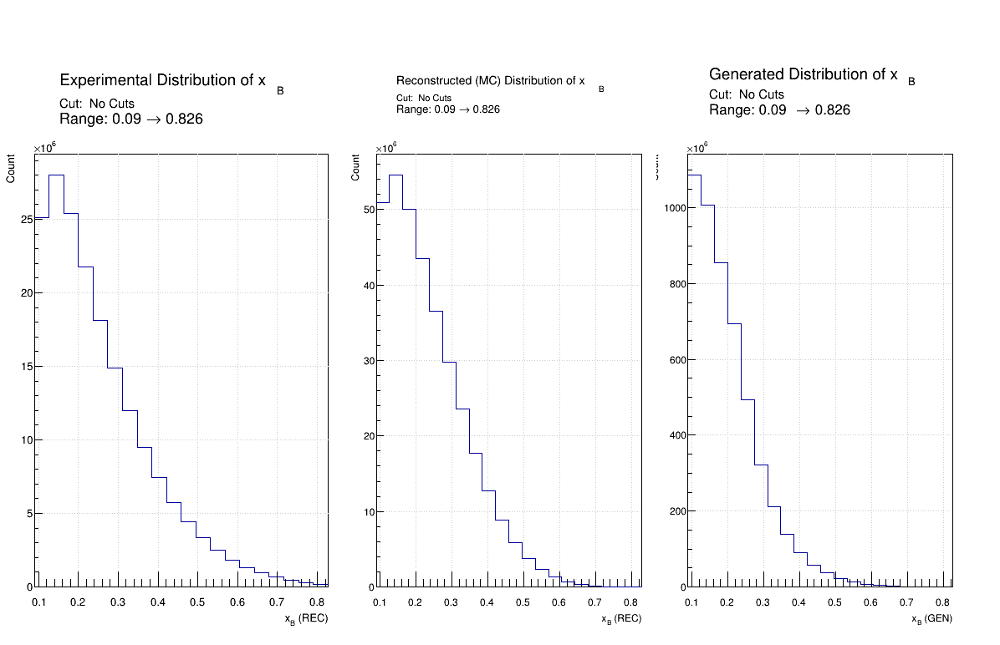

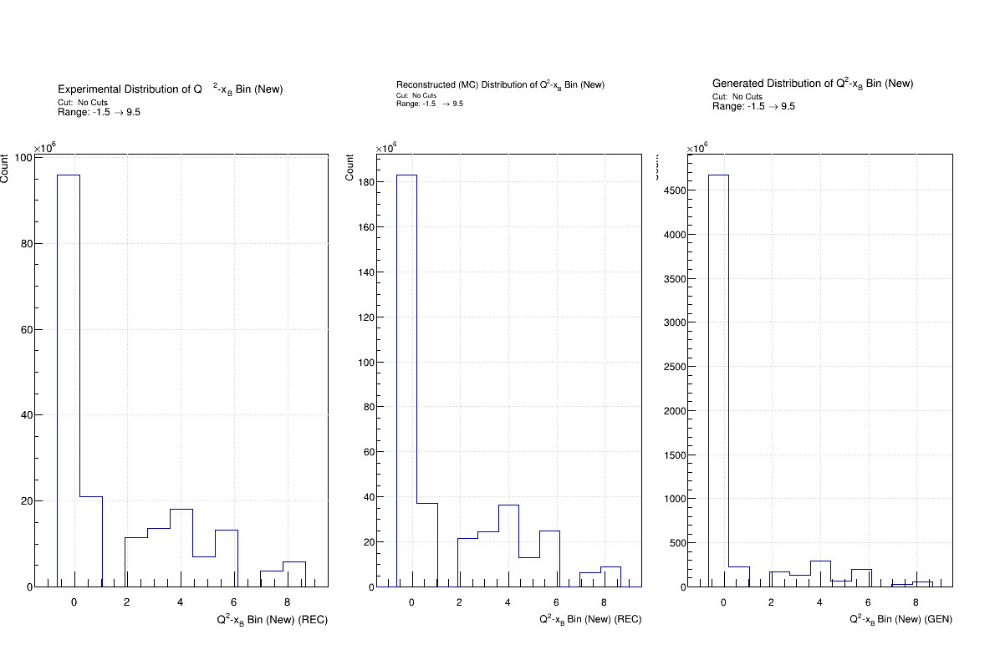

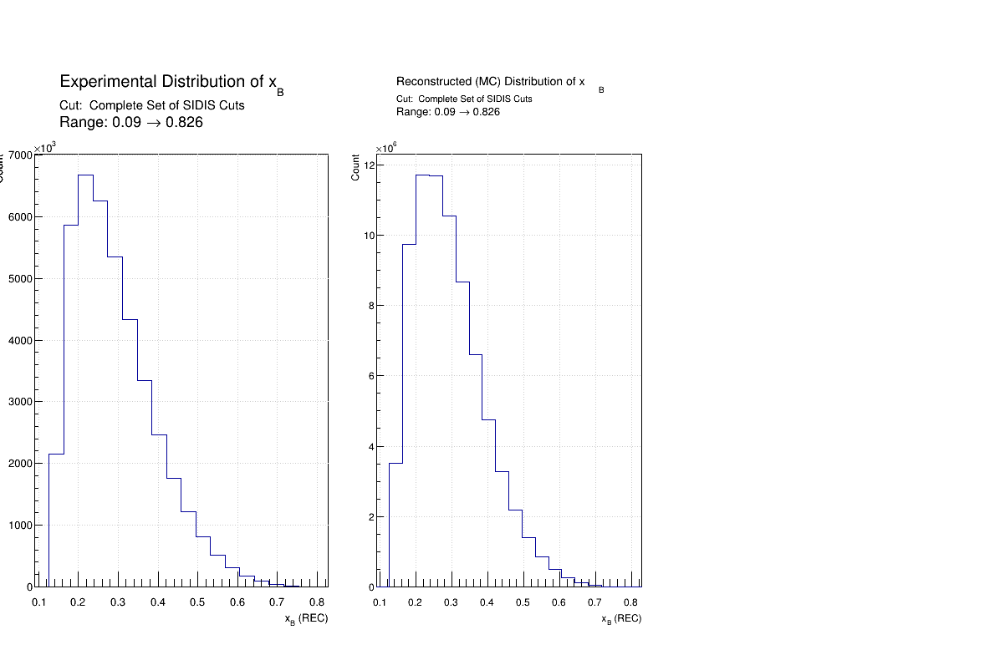

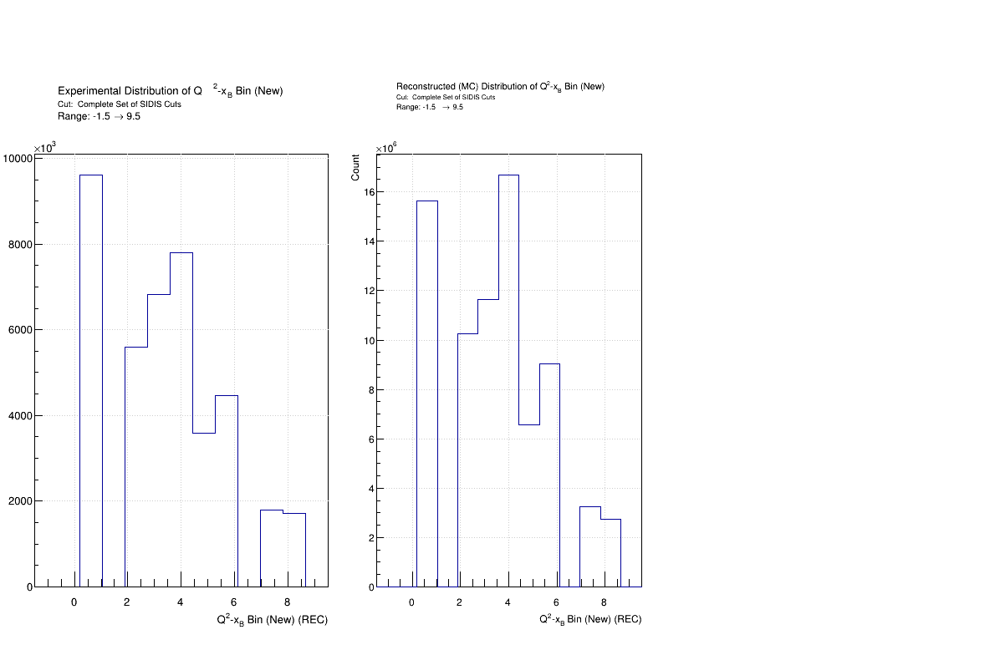

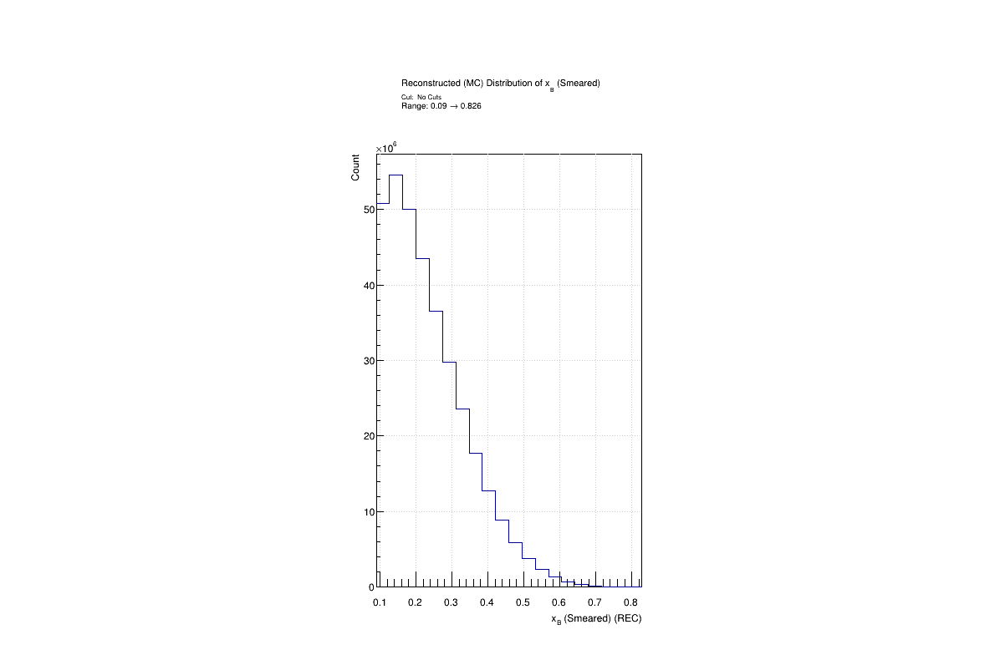

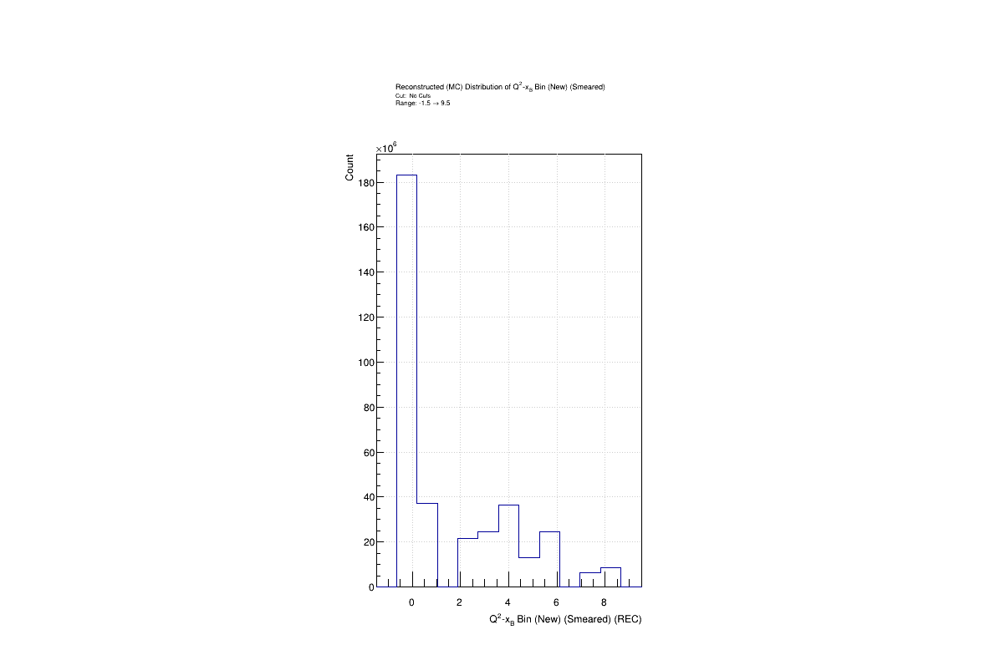

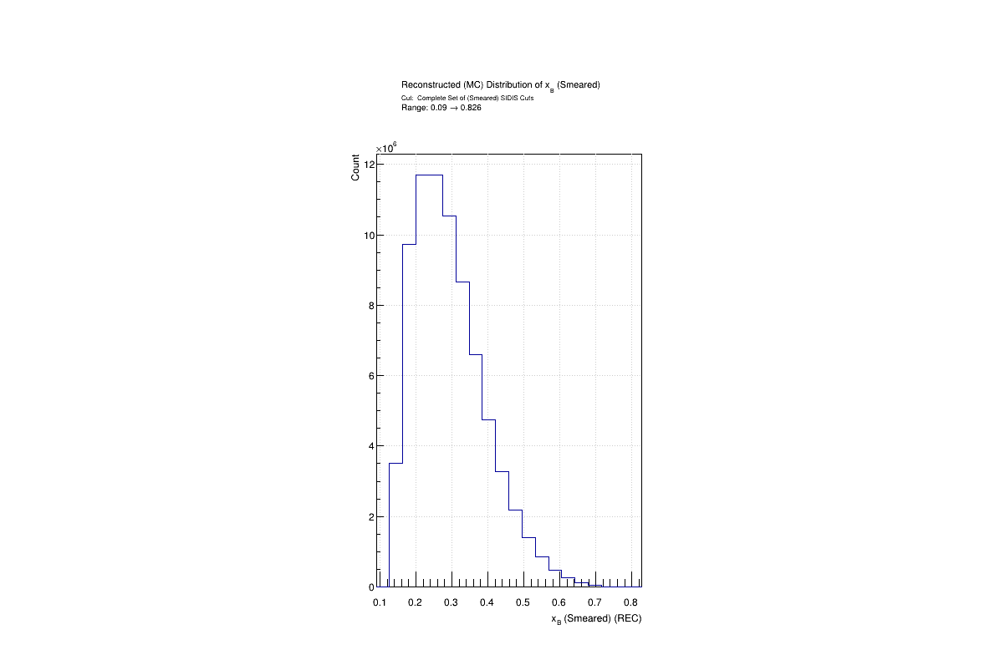

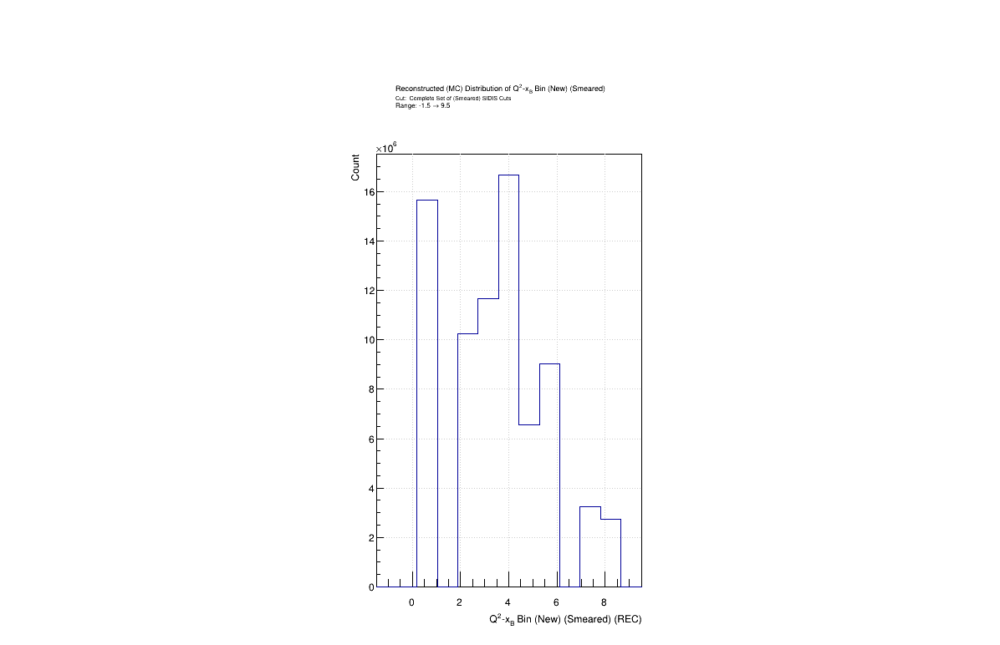

In [59]:
ROOT.gStyle.SetTitleY(1.025)
# try:
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"


if(len(list_of_DF) == 1):
    Divide_or_1_canvas = "one"


if(('y' in Run_Exclusive_Study_Q) and 'y' in Run_this_cell):
    canvas_MM = {}
    for datatype in list_of_DF:
        data_files_list = "error"
        if(datatype == 'rdf'):
            datatype_file, data_files_list = "rdf", list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files
        
        for data_file in data_files_list:
            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##
            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            for ii in rdf.GetListOfKeys():
                output_name = str(ii.GetName())

                if("xB" not in output_name or "1D" not in output_name or "EDIS" in output_name):
                    continue
                    
                print(output_name)
                
                
                histo = rdf.Get(output_name)

                try:
                    canvas_MM[((((output_name).replace("rdf", "data")).replace("mdf", "data")).replace("gdf", "data"))]
                except:
                    canvas_MM[((((output_name).replace("rdf", "data")).replace("mdf", "data")).replace("gdf", "data"))] = Canvas_Create(((((output_name).replace("rdf", "data")).replace("mdf", "data")).replace("gdf", "data")), 3, 1, 1200)#, num_X, num_Y, size_X, size_Y, 0)
                    
                canvas_MM[((((output_name).replace("rdf", "data")).replace("mdf", "data")).replace("gdf", "data"))].Draw()
                Draw_Canvas(canvas_MM[((((output_name).replace("rdf", "data")).replace("mdf", "data")).replace("gdf", "data"))], 1 if("rdf" in output_name) else 2 if("mdf" in output_name) else 3 if("gdf" in output_name) else 1, left_add=0.05, right_add=0, up_add=0.055, down_add=0)
                
                if("3D" in str(type(histo))):
                    print("3D")
                    histo.Draw("lego")
                if("2D" in str(type(histo))):
                    print("2D")
                    histo.Draw("colz")
                if("1D" in str(type(histo))):
                    print("1D")
                    histo.Draw("same")

In [60]:
if("save" == "nosave"):
    for canvas in canvas_Exclusive:
        if("_histos" not in canvas and "Delta" in canvas):
            if(type(canvas_Exclusive[canvas]) is list):
                continue
                for canvas_2 in canvas_Exclusive[canvas]:
                    print(type(canvas_2))
            else:
                try:
                    canvas_Exclusive[canvas].Draw()
                    Save_Name = ("".join([str(canvas), ".png"]).replace(" ", "_")).replace(",_'data'", "")
                    print(Save_Name)
                    # canvas_Exclusive[canvas].SaveAs("")
                except:
                    print(color.BOLD + color.RED + "\n\nFAILED TO SAVE SMEARING CANVASES\n\n")

        else:
            continue
    #     for canvas_2 in canvas_Exclusive[canvas]:
    #         print(type(canvas_2))
    #         canvas_2.Draw()
    for canvas in canvas_Exclusive_2:
        try:
            canvas_Exclusive_2[canvas].Draw()
            Save_Name = ("".join([str(canvas), ".png"]).replace(" ", "_")).replace(",_'data'", "")
            print(Save_Name)
            # canvas_Exclusive_2[canvas].SaveAs("")
        except:
            print(color.BOLD + color.RED + "\n\nFAILED TO SAVE SMEARING CANVASES\n\n")
else:
    print()

.

.

.

.

.

.

.


.

.

.

.

### Comparison Alert

In [61]:
if(runAlert == 'yes'):
    
    alert()

.

.

.

.

.

.

# Bin Matching/Purity Histograms

In [62]:
# matched_rdf_test = ROOT.RDataFrame("h22","/lustre19/expphy/volatile/clas12/richcap/Fall2021/Andrey_SIDIS/Monte_Carlo/Purity/MC_Matched_sidis_epip_richcap.inb.qa.45nA_job_*")

# print(matched_rdf_test.Filter("PID_el != PID_pip").Count().GetValue())

# histo_for_2D_Purity

In [63]:
if(Run_Purity_Q == "yes"):
    
    histo_for_counts, Canvas_for_Bin_Matching, histo_for_2D_Purity, Canvas_for_2D_Purity = {}, {}, {}, {}
    
#     for datatype_2 in ["miss_idf", "miss_idf_el", "miss_idf_pip", "pdf"]:
#     for datatype_2 in ["miss_idf", "pdf"]:
    for datatype_2 in ["pdf"]:


        ######################################################################
        ##=====##=====##=====##    Top of Main Loop    ##=====##=====##=====##
        ######################################################################

        ##=====##  Data File Loop  ##=====##

        for data_file in list_of_mdf_files:

            #########################     Openning TFile     #########################
            rdf = ROOT.TFile(str(FileLocation(str(data_file), str("mdf"))), "READ")
            #########################     Openning TFile     #########################

            ##=====##    Smearing Loop    ##=====##

            for smearing_Q in Smear_List:

                Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin", "z_pT_Bin"
                if("2" in smearing_Q):
                    Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_2"]), "".join([z_pT_Bin_Filter_str, "_2"])
                
                if("smear" in smearing_Q and (datatype_2 == "mdf" or datatype_2 == "pdf" or datatype_2 == "udf" or ("miss_idf" in datatype_2))):
                    Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D_smeared, List_of_Quantities_2D_smeared
                    Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_smeared"]), "".join([z_pT_Bin_Filter_str, "_smeared"])
                    
                else:
                    Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D, List_of_Quantities_2D

                ##=====##    Cut Loop     ##=====##

                for cut_choice in cut_list:

                    ##=====##    Sector Type Loop    ##=====##

                    for sec_type in Types_Of_Sectors:
                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers

                        ##=====##    Sector Number Loop    ##=====##

                        for sec_num in Sector_Numbers_List:
                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue

                            ##=====##    Histogram Option Loop/Selection    ##=====##

#                             for option in ["has_matched", "bin_purity", "delta_matched", "counts"]:
#                             for option in ["has_matched", "bin_purity", "bin_2D_purity", "counts"]:
#                             for option in ["has_matched", "bin_purity", "counts"]:
                            for option in ["has_matched", "bin_purity"]:

                                if(option != "counts" and option != "bin_2D_purity"):
                                    #####################################################################################################################
                                    ###############################################     1D Histograms     ###############################################
                                    for list1 in Variable_Loop:
                                        cutname, Histo_Title = "continue", "continue"

                                        if(option == "normal" or option == "has_matched"):
                                            cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))

                                        if(option == "bin_purity"):
                                            # Filtering events that migrated to a different bin after reconstruction
                                            cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))

                                        if(option == "delta_matched"):
                                            cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                            Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))

                                        if(cutname == "continue"):
                                            continue


                                        try:
                                            Temp_Histo = rdf.Get(str(Kinetic_Histo_3D_Name)).Clone()
                                        except:
                                            print("".join(["Error with ", str(Kinetic_Histo_3D_Name)]))
                                            count_3D_failed += 1
                                            continue

                                        Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)] = Temp_Histo

                                        Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].SetTitle((Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].GetTitle()).replace("∆", "#Delta"))

                                        count_3D += 1


                                        ######################################################
                                        ##########   Making the Binned Histograms   ##########
                                        ######################################################

                                        for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                                            for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):

                                                if(option == "normal" or option == "has_matched"):
                                                    Kinetic_Histo_Name = (''.join(['1D Histogram - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    if("2" in smearing_Q):
                                                        Kinetic_Histo_Name = (''.join(['1D Histogram - New 2D Binning - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)]
                                                if(option == "bin_purity"):
                                                    Kinetic_Histo_Name = (''.join(['1D Histogram - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    if("2" in smearing_Q):
                                                        Kinetic_Histo_Name = (''.join(['1D Histogram - New 2D Binning - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)]
                                                if(option == "delta_matched"):
                                                    Kinetic_Histo_Name = (''.join(['2D Histogram - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    if("2" in smearing_Q):
                                                        Kinetic_Histo_Name = (''.join(['2D Histogram - New 2D Binning - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)]

                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetYaxis().SetTitle((Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetYaxis().GetTitle()).replace("∆", "#Delta"))

                                                    count_2D += 1

                                                    Canvas_Name = str((datatype_2, smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, z_pT_Bin_Num, list1[0]))
                                                    try:
                                                        Canvas_for_Bin_Matching[Canvas_Name]
                                                    except:
                                                        Canvas_for_Bin_Matching[Canvas_Name] = ROOT.TCanvas(Canvas_Name, Canvas_Name, 800, 600)
                                                        Canvas_for_Bin_Matching[Canvas_Name].Divide(2, 1, 0.001, 0.001)
                                                        Canvas_for_Bin_Matching[Canvas_Name].SetGrid()
                                                    break


                                                ##=====##  Canvas Creation  ##=====##
                                                Canvas_Name = str((datatype_2, smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, z_pT_Bin_Num))
                                                
                                                if('y' in Canvas_For_Each_Var_Q):
                                                    Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
                                                
                                                try:
                                                    Canvas_for_Bin_Matching[Canvas_Name]
                                                except:
                                                    Canvas_for_Bin_Matching[Canvas_Name] = ROOT.TCanvas(Canvas_Name, Canvas_Name, size_of_canvas_1D[0], size_of_canvas_1D[1])
                                                    Canvas_for_Bin_Matching[Canvas_Name].Divide(size_of_canvas_1D[2], size_of_canvas_1D[3], 0.01, 0.01)
                                                    Canvas_for_Bin_Matching[Canvas_Name].SetGrid()

                                                histo_title_new = "".join([str(Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].GetTitle()), "  #color[2]{", Histo_Bin_Title(Q2_xB_Bin_Num, z_pT_Bin_Num, smearing_Q), "}"])

                                                if(option != "delta_matched"):
                                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] does not already exist yet
                                                    if(Q2_xB_Bin_Num == -1):
                                                        if(z_pT_Bin_Num == -2):
                                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Project3D("z")
                                                            Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].SetTitle(str(histo_title_new))
                                                            count_1D += 1
                                                        else:
                                                            continue

                                                    if(Q2_xB_Bin_Num == -2 and z_pT_Bin_Num == -1):
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetXaxis().SetRangeUser(1, 10)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetYaxis().SetRangeUser(1, 50)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].Project3D("z")
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].SetTitle(str(histo_title_new))
                                                        count_1D += 1

                                                    if(Q2_xB_Bin_Num != -1 and Q2_xB_Bin_Num != -2 and z_pT_Bin_Num == -2):
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetXaxis().SetRangeUser(Q2_xB_Bin_Num, Q2_xB_Bin_Num)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].Project3D("z")
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].SetTitle(str(histo_title_new))
                                                        count_1D += 1

                                                    elif(Q2_xB_Bin_Num != -1 and Q2_xB_Bin_Num != -2):
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_From_3D[str(Kinetic_Histo_3D_Name)].Clone()
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetXaxis().SetRangeUser(Q2_xB_Bin_Num, Q2_xB_Bin_Num)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetYaxis().SetRangeUser(z_pT_Bin_Num, z_pT_Bin_Num)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].Project3D("z")
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].SetTitle(str(histo_title_new))
                                                        count_1D += 1
                                                        # print(count_1D)


                                    ###############################################     1D Histograms     ###############################################
                                    #####################################################################################################################
                                    
                                elif(option == "bin_2D_purity" and datatype_2 == "pdf"):
                                    cutname = DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "2D_Purity", smearing_Q, datatype_2, cut_choice, "Cut")
                                    
                                    if("continue" in cutname or "continue" in str(DF_Filter_Function_Full(rdf, sec_type, sec_num, -1, -2, "2D_Purity", smearing_Q, "mdf", cut_choice, "Cut"))):
                                        continue
                                        
                                    for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:

                                        if((Q2_xB_Bin_Num < 1) or (Q2_xB_Bin_Num > 8 and "2" in smearing_Q)):
                                            continue
                                            # Q2_xB_Bin_Num < 1 will either give 0 purity (no z-pT bins defined) or can be seen in the "counts" option below
                                            # Also, 2nd definition of the Q2-xB bins do not go above bin 8
                                            
                                            
                                        Purity_2D_Histo_Name = (''.join(['2D Purity - ', str(cutname)]), datatype_2, smearing_Q, sec_type, sec_num, Q2_xB_Bin_Num)
                                        if("2" in smearing_Q):
                                            Purity_2D_Histo_Name = (''.join(['2D Purity - New 2D Binning - ', str(cutname)]), datatype_2, smearing_Q, sec_type, sec_num, Q2_xB_Bin_Num)

                                        Histo_Title = "".join(["#splitline{Number of Pure Events for ", variable_Title_name(Q2_xB_Bin_Filter_str), "}{Cuts in use: ", cutname if (cutname != "" and cutname != " ") else "No Cuts", "}"])

                                        
                                        if("continue" in str(DF_Filter_Function_Full(rdf, sec_type, sec_num, Q2_xB_Bin_Num, -2, "2D_Purity", smearing_Q, datatype_2, cut_choice, "Cut"))):
                                            continue
                                            
                                        try:
                                            histo_for_2D_Purity[str(Purity_2D_Histo_Name)] = rdf.Get(str(Purity_2D_Histo_Name))
                                        except:
                                            print("".join(["Error with: ", str(Histo_Title)]))
                                            count_3D_failed += 1
                                            continue
                                            
                                            
                                        tot_all_bin = histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetXaxis().FindFixBin("".join(["(Total) ", variable_Title_name(Q2_xB_Bin_Filter_str), " = ", str(Q2_xB_Bin_Num)]))
                                        tot_pure_bin = histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetXaxis().FindFixBin("".join(["(Pure) ", variable_Title_name(Q2_xB_Bin_Filter_str), " = ", str(Q2_xB_Bin_Num)]))
                                        end_bin = histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetXaxis().FindFixBin("".join(["(Pure) ", variable_Title_name(z_pT_Bin_Filter_str), " = 48"]))
                                            
                                        for histo_type in ["tot", "pure"]:
                                            Canvas_Name = str((smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, histo_type))
                                            
                                            if('y' in Canvas_For_Each_Var_Q):
                                                Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
                                            
                                            try:
                                                Canvas_for_2D_Purity[Canvas_Name]
                                            except:
                                                Canvas_for_2D_Purity[Canvas_Name] = ROOT.TCanvas(Canvas_Name, Canvas_Name, 800, 600)
                                                Canvas_for_2D_Purity[Canvas_Name].Divide(1, 1, 0, 0)
                                                Canvas_for_2D_Purity[Canvas_Name].SetGrid()

                                            total_count = 1
                                            if(histo_type == "tot"):
                                                histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetXaxis().SetRange(tot_all_bin, tot_pure_bin)
                                                total_count = histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetBinContent(tot_all_bin)
                                            else:
                                                histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetXaxis().SetRange(tot_pure_bin, end_bin)
                                                total_count = histo_for_2D_Purity[str(Purity_2D_Histo_Name)].GetBinContent(tot_pure_bin)
                                                
                                            histo_for_2D_Purity[str(Purity_2D_Histo_Name)].Scale((1/total_count)*100)
                                                
                                            try:
                                                Canvas_for_2D_Purity[Canvas_Name].Draw()
                                                Canvas_for_2D_Purity[Canvas_Name].cd(1)

                                                histo_for_2D_Purity[str(Purity_2D_Histo_Name)].Draw("BAR1 Hist text0")
                                            except:
                                                print("Failed to print canvas")

                                        


                                elif(option == "counts" and datatype_2 == "pdf"):
                                    cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, "Counts", smearing_Q, datatype_2, cut_choice, "Cut")
                                    if("continue" in cutname):
                                        continue
                                        
                                    count_or_ratio = "count"
#                                     count_or_ratio = "ratio"
                                    
#                                     count_focus = "All"
#                                     count_focus = "Matching"
#                                     count_focus = "Matching After"
# #                                     count_focus = "Matching Before"
#                                     count_focus = "2D Purity"
#                                     count_focus = "2D Purity After Cuts"
                                    
#                                     count_focus_list = ["Matching Before", "Matching After", "Purity After Cuts", "1D Purity After Cuts", "2D Purity After Cuts"]
                                    count_focus_list = ["Matching Before", "Matching After", "Purity After Cuts"]
                                    
                                    for count_focus in count_focus_list:

                                        try:
                                            Temp_Histo = rdf.Get("".join(["Histogram_for_event_counts", "" if smearing_Q == "" else "_", smearing_Q, " ", cutname])).Clone()
                                        except:
                                            print("".join(["Error with: (Histogram_for_event_counts", "" if smearing_Q == "" else "_", smearing_Q, " ", cutname, ")"]))
                                            count_3D_failed += 1
                                            continue


                                        Canvas_Name = str((smearing_Q, cut_choice, sec_type, sec_num, option, count_focus))
                                        
                                        if('y' in Canvas_For_Each_Var_Q):
                                            Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
                                        
                                        try:
                                            Canvas_for_Bin_Matching[Canvas_Name]
                                        except:
                                            Canvas_for_Bin_Matching[Canvas_Name] = ROOT.TCanvas(Canvas_Name, Canvas_Name, 800, 600)
                                            Canvas_for_Bin_Matching[Canvas_Name].Divide(1, 1, 0, 0)
                                            Canvas_for_Bin_Matching[Canvas_Name].SetGrid()

                                        histo_for_counts[str((cutname, smearing_Q, count_focus))] = Temp_Histo



                                        Canvas_for_Bin_Matching[Canvas_Name].Draw()
                                        Canvas_for_Bin_Matching[Canvas_Name].cd(1)


                                        LabelOffset_Setting, LabelSize_Setting = -0.245, 0.04
                                        if(count_focus == "Matching"):
                                            Count_title = count_focus
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("All REC Events")
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("MIS-MATCHED (Pi+ Pion) REC Events (After Cuts)")
                                        if(count_focus == "Matching Before"):
                                            Count_title = "".join([count_focus, " Cuts"])
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("All REC Events")
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("Mis-Identified (Pi+) Matches of REC Events")
                                            LabelOffset_Setting, LabelSize_Setting = -0.23, 0.04
                                        if(count_focus == "Matching After"):
                                            Count_title = "".join([count_focus, " Cuts"])
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("All REC Events (After Cuts)")
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("MIS-MATCHED (Pi+ Pion) REC Events (After Cuts)")
                                            LabelOffset_Setting, LabelSize_Setting = -0.245, 0.04
                                        if("Purity" in count_focus and "D" not in count_focus):
                                            if("After" in count_focus):
                                                LabelOffset_Setting, LabelSize_Setting = -0.125, 0.04
                                            else:
                                                LabelOffset_Setting, LabelSize_Setting = -0.16, 0.04
                                            Count_title = "".join(["Bin ", count_focus])
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindBin(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("MIS-MATCHED (Pi+ Pion) REC Events (After Cuts)"))
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("".join(["Purity of ", variable_Title_name("".join(["Q2_xB_Bin_2", "" if smearing_Q != "smear" else "_smeared"]))]))
                                        if("1D Purity" in count_focus):
                                            if("After" in count_focus):
                                                LabelOffset_Setting, LabelSize_Setting = -0.125, 0.04
                                            else:
                                                LabelOffset_Setting, LabelSize_Setting = -0.16, 0.04
                                            Count_title = count_focus.replace("1D P", "1D Bin P")
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindBin(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("MIS-MATCHED (Pi+ Pion) REC Events (After Cuts)"))
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindBin(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("".join(["Purity of ", variable_Title_name("".join(["Q2_xB_Bin", "" if smearing_Q != "smear" else "_smeared"]))])))
                                        if("2D Purity" in count_focus):
                                            if("After" in count_focus):
                                                LabelOffset_Setting, LabelSize_Setting = -0.125, 0.04
                                            else:
                                                LabelOffset_Setting, LabelSize_Setting = -0.16, 0.04
                                            Count_title = count_focus.replace("2D P", "2D Bin P")
                                            min_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("".join(["Purity of ", variable_Title_name("".join(["Q2_xB_Bin", "" if smearing_Q != "smear" else "_smeared"]))]))
                                            max_bin = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("".join(["Purity of ", variable_Title_name("".join(["Q2_xB_Bin_2", "" if smearing_Q != "smear" else "_smeared"]))]))
                                        if(count_focus != "All"):
                                            histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().SetRange(min_bin, max_bin)

                                        if(count_or_ratio == "ratio" and "After" not in count_focus):
                                            total_count = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetBinContent(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("All REC Events"))
                                            if(total_count > 0):
                                                histo_for_counts[str((cutname, smearing_Q, count_focus))].Scale((1/total_count)*100)
                                                histo_for_counts[str((cutname, smearing_Q, count_focus))].GetYaxis().SetRangeUser(0, 130)
                                            else:
                                                print("Error in total number of REC events")
                                        elif(count_or_ratio == "ratio" and "After" in count_focus):
                                            total_count = histo_for_counts[str((cutname, smearing_Q, count_focus))].GetBinContent(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().FindFixBin("All REC Events (After Cuts)"))
                                            if(total_count > 0):
                                                histo_for_counts[str((cutname, smearing_Q, count_focus))].Scale((1/total_count)*100)
                                                histo_for_counts[str((cutname, smearing_Q, count_focus))].GetYaxis().SetRangeUser(0, 130)
                                            else:
                                                print("Error in total number of REC events (after cuts)")


#                                         histo_for_counts[str((cutname, smearing_Q, count_focus))].GetYaxis().SetRangeUser(0, 2.5e08)
                                        Count_title_Full = "".join([(str(histo_for_counts[str((cutname, smearing_Q, count_focus))].GetTitle()).replace("Event Counts for", "".join(["Event Counts (", Count_title, ") for"]))).replace("Counts", "Ratio" if count_or_ratio == "ratio" else "Counts"), "; ; ", "".join(["% of Total ", "(After Cuts)" if "After" in count_focus else "(Before Cuts)"]) if count_or_ratio == "ratio" else "Counts"])

                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].SetFillColor(66)
                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().SetLabelOffset(LabelOffset_Setting)
                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().SetLabelSize(LabelSize_Setting)
                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].GetXaxis().LabelsOption("v")
                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].SetTitle(Count_title_Full)
#                                         histo_for_counts[str((cutname, smearing_Q, count_focus))].Draw("BAR1 text0")
                                        histo_for_counts[str((cutname, smearing_Q, count_focus))].Draw("BAR1 Hist text0")
                                        # histo_for_counts[str((cutname, smearing_Q))].Draw("hbar1")
                                        Canvas_for_Bin_Matching[Canvas_Name].Modified()
                                        Canvas_for_Bin_Matching[Canvas_Name].Update()
                
                                        if(SaveChoice == 'yes'):
                                            try:
                                                Canvas_for_Bin_Matching[Canvas_Name].SaveAs("".join([Bin_Option_For_Save, str((Count_title_Full.replace(":", "")).replace(" ", "_")), ".png"]))
                                            except:
                                                print("Save failed for: " + "".join([Bin_Option_For_Save, str((Count_title_Full.replace(":", "")).replace(" ", "_")), ".png"]))
                                            


        ######################################################################
        ##=====##=====##=====##    End of Main Loop    ##=====##=====##=====##
        ######################################################################
    
    
    print("".join(["Count (3D) Grabbed: ", str(count_3D)]))
    if(count_2D != 0):
        print("".join(["Count (2D) Made: ", str(count_2D)]))
    if(count_1D != 0):
        print("".join(["Count (1D) Made: ", str(count_1D)]))
    if(count_3D_failed != 0):
        print("".join(["Count (3D) Failed: ", str(count_3D_failed)]))
    if(count_2D_failed != 0):
        print("".join(["Count (2D) Failed: ", str(count_2D_failed)]))
    if(count_1D_failed != 0):
        print("".join(["Count (1D) Failed: ", str(count_1D_failed)]))
        
    print("Done")
    
else:
    print("Not running bin matching/purity histograms.")

Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'Q2')
Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'xB')
Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'z')
Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'pT')
Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'phi_t')
Error with ('3D -> 1D Histogram -  No Cuts', 'pdf', '', -1, 'Bin_4D')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'Q2')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'xB')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'z')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'pT')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'phi_t')
Error with ('3D -> 1D Histogram - Purity -  No Cuts', 'pdf', '', -1, 'Bin_4D')
Error with ('3D -> 1D Histogram -  Complete Set of Cuts', 'pdf', '', -1, 'Q2')
Error with ('3D -> 1D Histogram -  Complete Set of Cuts', 'pdf'

In [64]:
# for name in Kinetic_Histo_1D_WB:
#     if("mdf" in name and "No Cuts" in name):
#         print(name)
# List_of_Q2_xB_Bins_to_include = [-1]

In [65]:
run_this_cell = "y"
run_this_cell = "n"

if(Run_Purity_Q == "yes" and run_this_cell != "n"):

    ROOT.gStyle.SetAxisColor(16,'xy')
    # ROOT.gStyle.SetOptStat(1)
    ROOT.gStyle.SetOptStat(0)
    ROOT.gStyle.SetOptFit(1)
    
#     datatype_2 = 'pdf'
#     for datatype_2 in ["miss_idf", "miss_idf_el", "miss_idf_pip", "pdf"]:
#     for datatype_2 in ["miss_idf", "pdf"]:
    for datatype_2 in ["pdf"]:
    
        ######################################################################
        ##=====##=====##=====##    Top of Main Loop    ##=====##=====##=====##
        ######################################################################

        ##=====##    Smearing Loop    ##=====##

        for smearing_Q in Smear_List:

            Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "Q2_xB_Bin", "z_pT_Bin"
            
            if("2" in smearing_Q):
                Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_2"]), "".join([z_pT_Bin_Filter_str, "_2"])
                
            else:
                continue
            
            if("smear" in smearing_Q):
                Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D_smeared, List_of_Quantities_2D_smeared
                Q2_xB_Bin_Filter_str, z_pT_Bin_Filter_str = "".join([Q2_xB_Bin_Filter_str, "_smeared"]), "".join([z_pT_Bin_Filter_str, "_smeared"])
            else:
                Variable_Loop, Variable_Loop_2D = List_of_Quantities_1D, List_of_Quantities_2D

            ##=====##    Cut Loop     ##=====##

            for cut_choice in cut_list:

                ##=====##    Sector Type Loop    ##=====##

                for sec_type in Types_Of_Sectors:
                    if(sec_type == ''):
                        Sector_Numbers_List = [-1]
                    else:
                        Sector_Numbers_List = Sector_Numbers

                    ##=====##    Sector Number Loop    ##=====##

                    for sec_num in Sector_Numbers_List:
                        if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                            continue

                        ##=====##    Histogram Option Loop/Selection    ##=====##

                        if(datatype_2 == 'pdf'):
#                             histo_options = ["has_matched", "bin_purity", "delta_matched", "bin_purity_ratio", "counts"]
#                             histo_options = ["delta_matched", "bin_purity_ratio"]
                            histo_options = ["bin_purity_ratio"]
                        elif('miss_idf' in datatype_2):
#                             histo_options = ["normal", "bin_purity", "delta_matched"]
#                             histo_options = ["bin_purity_ratio", "delta_matched"]
                            histo_options = ["bin_purity_ratio"]
#                             histo_options = [""]
                        else:
                            histo_options = ["normal"]
                            # runs code normally

                        for option in histo_options:

                            if(option != "counts" and option != "bin_purity_ratio"):

                                ######################################################
                                ##########   Making the Binned Histograms   ##########
                                ######################################################

                                for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
                                    for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):

                                        if(option != "delta_matched"):
                                            Canvas_Name = str((datatype_2, smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, z_pT_Bin_Num))
                                            


                                        #####################################################################################################################
                                        ###############################################     1D Histograms     ###############################################
                                        for list1 in Variable_Loop:
                                            cutname, Histo_Title = "continue", "continue"
                                            
                                            if('y' in Canvas_For_Each_Var_Q):
                                                Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
                                            
                                                try:
                                                    Canvas_for_Bin_Matching[Canvas_Name].Draw()
                                                except:
                                                    continue

                                            if(option == "delta_matched"):
                                                if(smearing_Q != ""):
                                                    continue
                                                Canvas_Name = str((datatype_2, smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, z_pT_Bin_Num, list1[0]))
                                                
                                                if('y' in Canvas_For_Each_Var_Q):
                                                    Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
                                                    
                                                try:
                                                    Canvas_for_Bin_Matching[Canvas_Name].Draw()
                                                except:
                                                    continue
                                                    
                                                    

                                            if(option == "normal" or option == "has_matched"):
                                                cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                                Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                Kinetic_Histo_Name = (''.join(['1D Histogram - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                
                                                if("2" in smearing_Q):
                                                    Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - New 2D Binning - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                    Kinetic_Histo_Name = (''.join(['1D Histogram - New 2D Binning - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))

                                            if(option == "bin_purity"):
                                                # Filtering events that migrated to a different bin after reconstruction
                                                cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                                Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                Kinetic_Histo_Name = (''.join(['1D Histogram - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                
                                                if("2" in smearing_Q):
                                                    Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - New 2D Binning - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                    Kinetic_Histo_Name = (''.join(['1D Histogram - New 2D Binning - Purity - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))

                                            if(option == "delta_matched"):
                                                cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                                Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                Kinetic_Histo_Name = (''.join(['2D Histogram - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                
                                                if("2" in smearing_Q):
                                                    Kinetic_Histo_3D_Name = (''.join(['3D -> 1D Histogram - New 2D Binning - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, str(list1[0]))
                                                    Kinetic_Histo_Name = (''.join(['2D Histogram - New 2D Binning - Dif Match - ', str(cutname)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))


                                            if(cutname == "continue"):
                                                continue


                                            try:
                                                if(option == "delta_matched"):
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(1)
    #                                                 ROOT.gPad.SetLogz(1)
                                                    if("Phi" not in list1[0] and "th" not in list1[0]):
                                                        ROOT.gPad.SetLogz(1)
                                                    else:
                                                        ROOT.gPad.SetLogz(0)
                            
                                                    # match_type = "".join(["Mis-Identified Match" if "miss_idf" in datatype_2 else "", " (General)" if "miss_idf" == datatype_2 else "", " (Electron)" if "el" in datatype_2 else "", " (#pi+ Pion)" if "pip" in datatype_2 else ""])
                                                    # Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].SetTitle("".join(["#splitline{", str(Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].GetTitle()).replace(str(match_type), ""), "}{", str(match_type), "}"]))
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].Draw("colz")

                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(2)
    #                                                 ROOT.gPad.SetLogy(1)
                                                    if("Phi" not in list1[0] and "th" not in list1[0]):
                                                        ROOT.gPad.SetLogy(1)
                                                    else:
                                                        ROOT.gPad.SetLogy(0)
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].ProjectionY().Draw("same")


                                                    if(SaveChoice == 'yes'):
                                                        Canvas_for_Bin_Matching[Canvas_Name].SaveAs("".join([Bin_Option_For_Save, str(Kinetic_Histo_Name), " - ", str(Canvas_Name), ".png"]))
                                                else:
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(list1[1]).SetLeftMargin(0.1)
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(list1[1]).SetRightMargin(0.05)
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(list1[1]).SetTopMargin(0.1)
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(list1[1]).SetBottomMargin(0.075)
                                                    Canvas_for_Bin_Matching[Canvas_Name].cd(list1[1])
                                                    Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name)].Draw("same")

                                            except:
                                                continue

                                        if(SaveChoice == 'yes' and option != "delta_matched"):
                                            Canvas_for_Bin_Matching[Canvas_Name].SaveAs("".join([Bin_Option_For_Save, str(Kinetic_Histo_Name), " - ", str(Canvas_Name), ".png"]))

                                ###############################################     1D Histograms     ###############################################
                                #####################################################################################################################

                            elif(option == "bin_purity_ratio"):

                                for Q2_xB_Bin_Num in List_of_Q2_xB_Bins_to_include:
#                                 for Q2_xB_Bin_Num in [-1]:
                                    if("2" in smearing_Q and Q2_xB_Bin_Num > 8):
                                        continue
                                        
                                    
                                    for z_pT_Bin_Num in Choose_Correct_Bin_List(Q2_xB_Bin_Num):


                                        for version in ["V1.5"]:
#                                         for version in ["V2"]:

                                            ##=====##  Canvas Creation  ##=====##
                                            for list1 in Variable_Loop:
                                                Canvas_Name = str((datatype_2, smearing_Q, cut_choice, sec_type, sec_num, option, Q2_xB_Bin_Num, z_pT_Bin_Num, "purity_ratio"))

                                                if('y' in Canvas_For_Each_Var_Q):
                                                    Canvas_Name = "".join(["(", str(Canvas_Name), ", ", str(list1[0]), ")"])
        #                                         try:
        #                                             Canvas_for_Bin_Matching[str((Canvas_Name, version))]
        #                                         except:
                                                Canvas_for_Bin_Matching[str((Canvas_Name, version))] = ROOT.TCanvas("".join([str(Canvas_Name), "_", str(version)]), "".join([str(Canvas_Name), "_", str(version)]), size_of_canvas_1D[0], size_of_canvas_1D[1])
                                                Canvas_for_Bin_Matching[str((Canvas_Name, version))].Divide(size_of_canvas_1D[2], size_of_canvas_1D[3], 0.01, 0.01)
                                                Canvas_for_Bin_Matching[str((Canvas_Name, version))].SetGrid()

                                                Canvas_for_Bin_Matching[str((Canvas_Name, version))].Draw()

                                                cutname_All, cutname_Pure = "continue", "continue"

                                                cutname_All = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, "mdf", cut_choice, "Cut")
                                                cutname_Matched = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")
                                                cutname_Pure = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, datatype_2, cut_choice, "Cut")

                                                Kinetic_Histo_Name_All = (''.join(['1D Histogram - ', str(cutname_All)]), "mdf", sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                Kinetic_Histo_Name_Matched = (''.join(['1D Histogram - ', str(cutname_Matched)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                Kinetic_Histo_Name_Pure = (''.join(['1D Histogram - Purity - ', str(cutname_Pure)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                
                                                if("2" in smearing_Q):
                                                    # Kinetic_Histo_Name_All = (''.join(['1D Histogram - New 2D Binning - ', str(cutname_All)]), "mdf", sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    Kinetic_Histo_Name_Matched = (''.join(['1D Histogram - New 2D Binning - ', str(cutname_Matched)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                    Kinetic_Histo_Name_Pure = (''.join(['1D Histogram - New 2D Binning - Purity - ', str(cutname_Pure)]), datatype_2, sec_type, sec_num, Q2_xB_Bin_Num, z_pT_Bin_Num, str(list1[0]))
                                                
                                                Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_Pure)].Clone()
                                                Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))] = Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_Matched)].Clone()


                                                if(version != "V2"):

                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Divide(Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)])
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Divide(Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)])
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 3, str(list1[0])))] = Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Clone()
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 3, str(list1[0])))].Add(Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))], -1)

#                                                     Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Scale(100)
#                                                     Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Scale(100)

                                                    # Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetTitle("".join(["#splitline{", Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetTitle(), "}{PURITY/MATCHING RATIO}"]))
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetTitle("".join(["#splitline{", Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetTitle(), "}{PURITY RATIO}"]))
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetLineColor(51)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetFillColor(51)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetLineWidth(3)

                                                    # Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetTitle("".join(["#splitline{", Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].GetTitle(), "}{PURITY/MATCHING RATIO}"]))
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetTitle("".join(["#splitline{", Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].GetTitle(), "}{MATCHING RATIO}"]))
                                                    
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetLineColor(93)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetFillColor(93)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetLineWidth(3)

#                                                     Kinetic_Histo_1D_WB[str((Canvas_Name, 3, str(list1[0])))].SetLineColor(49)
#                                                     Kinetic_Histo_1D_WB[str((Canvas_Name, 3, str(list1[0])))].SetLineWidth(3)

                                                    # Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetXaxis().SetRangeUser(159, 161)

                                                    V2_choice = "pure"
#                                                     V2_choice = "match"
                                                    # V2_choice = "both"
                                                    
                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].cd(list1[1])
                                                    if(datatype_2 == "pdf"):
                                                        if(V2_choice == "pure" or V2_choice == "both"):
                                                            Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetYaxis().SetRangeUser(0, 1.35)
                                                            # if("hi_t" in list1[0]):
                                                            Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Draw("BAR1 Hist text90 same")
                                                            # else:
                                                            #     Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Draw("BAR1 Hist text0 same")
                                                        if(V2_choice == "match" or V2_choice == "both"):
                                                            Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].GetYaxis().SetRangeUser(0, 1.35)
                                                            # if("hi_t" in list1[0]):
                                                            Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Draw("BAR1 Hist text90 same")
                                                            # else:
                                                            #     Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Draw("BAR1 Hist text0 same")
                                                    if(datatype_2 != "pdf"):
                                                        # if("hi_t" in list1[0]):
                                                        Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Draw("BAR1 Hist text90 same")
                                                        # else:
                                                        #     Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Draw("BAR1 Hist text0 same")
    #                                                 Kinetic_Histo_1D_WB[str((Canvas_Name, 3, str(list1[0])))].Draw("same")

                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].Modified()
                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].Update()


                                                else:
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetTitle("".join(["#splitline{", Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetTitle(), "}{PURITY COMPARE}"]))
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetLineColor(7)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].SetLineWidth(3)

                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetLineColor(8)
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].SetLineWidth(2)


    #                                                 Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetYaxis().SetRangeUser(0, 1.2*Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)].GetMaximum())
    #                                                 Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)].GetXaxis().SetRangeUser(0, 360)
    #                                                 Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].GetXaxis().SetRangeUser(95, 105)

                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].cd(list1[1])
                                                    if(datatype_2 == "pdf"):
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)].SetLineColor(2)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)].SetLineWidth(2)
                                                        Kinetic_Histo_1D_WB[str(Kinetic_Histo_Name_All)].Draw("same")
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, 2, str(list1[0])))].Draw("same")
                                                    Kinetic_Histo_1D_WB[str((Canvas_Name, str(list1[0])))].Draw("same")


                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].Modified()
                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].Update()
                                            
                                                if('y' in Canvas_For_Each_Var_Q and SaveChoice == 'yes'):
                                                    Canvas_for_Bin_Matching[str((Canvas_Name, version))].SaveAs("".join([Bin_Option_For_Save, "Purity-Matching Ratio", str(Canvas_Name), " ", version,".png"]))



                                            if(SaveChoice == 'yes' and 'y' not in Canvas_For_Each_Var_Q):
                                                Canvas_for_Bin_Matching[str((Canvas_Name, version))].SaveAs("".join([Bin_Option_For_Save, "Purity-Matching Ratio", str(Canvas_Name), " ", version,".png"]))





    ######################################################################
    ##=====##=====##=====##    End of Main Loop    ##=====##=====##=====##
    ######################################################################
    
else:
    print("\n\n\n\n\n\n\n\nNot running bin matching/purity histograms.\n\n\n\n\n\n\n\n\n")
    
    
    
    









Not running bin matching/purity histograms.











In [66]:
try:   
    def fit2dall(h2, minR, maxR, dR, Title, Particle):
        # h2.RebinY()
        hx = h2.ProjectionX()
        hys2 = []
        gr2, gr2_V2, gr2_Sigma, gr2_Cut_Range_Up, gr2_Cut_Range_Down = ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors(), ROOT.TGraphErrors()
        gr2.SetMarkerStyle(20)
        gr2_V2.SetMarkerStyle(20)
        gr2_Sigma.SetMarkerStyle(20)
        gr2_Cut_Range_Up.SetMarkerStyle(20)
        gr2_Cut_Range_Down.SetMarkerStyle(20)

        FindPeak_x, FindPeak_y = [], []

        Find_Sigma_RU, Find_Sigma_RD = [], []


        while minR+dR<=maxR:
            ib0, ib1 = hx.FindBin(minR), hx.FindBin(minR+dR)
            hy2 = h2.ProjectionY(f"hy{ib1}", ib0, ib1)
            hy2.SetDirectory(0)

            hys2.append(hy2)


            fy2 = ROOT.TF1("fy2","gaus(0) + pol2(3)", -2, 2)
            mu = hy2.GetBinCenter(hy2.GetMaximumBin())



            fy2.SetParameters(1, mu, 0.06, 0, 0)
            fy2.SetParLimits(0, 0.85*hy2.GetMaximum(), 1.15*hy2.GetMaximum())
            # fy2.SetParLimits(2, 0.01, 0.075)

            fy2.SetRange(mu - 1, mu + 1)
            hy2.Fit(fy2,"RQ")


            sigma_factor = 2.5

            hy2.SetTitle("".join(["#splitline{", Title, "}{Bin: ", str(minR), "#circ < #theta_{", Particle.replace("pip", "#pi+"), "} < ", str(minR+dR), "#circ}"]))
            mu, sig = fy2.GetParameter(1), abs(fy2.GetParameter(2))
            fy2.SetRange(mu - (1 + sigma_factor)*sig, mu + (1 + sigma_factor)*sig)



            hy2.Fit(fy2,"RQ")


            gr2.SetPoint(gr2.GetN(), minR+dR/2.0, fy2.GetParameter(1))
            gr2_V2.SetPoint(gr2_V2.GetN(), minR+dR/2.0, fy2.GetParameter(1))
            gr2_Sigma.SetPoint(gr2_Sigma.GetN(), minR+dR/2.0, fy2.GetParameter(2))
            gr2_Cut_Range_Up.SetPoint(gr2_Sigma.GetN()-1, minR+dR/2.0, fy2.GetParameter(1) + sigma_factor*fy2.GetParameter(2))
            gr2_Cut_Range_Down.SetPoint(gr2_Sigma.GetN()-1, minR+dR/2.0, fy2.GetParameter(1) - sigma_factor*fy2.GetParameter(2))

            gr2.SetPointError(gr2.GetN()-1, 0, fy2.GetParError(1))
            gr2_V2.SetPointError(gr2_V2.GetN()-1, 0, fy2.GetParError(1) + sigma_factor*(fy2.GetParameter(2) + fy2.GetParError(2)))
            gr2_Sigma.SetPointError(gr2_Sigma.GetN()-1, 0, fy2.GetParError(2))
            gr2_Cut_Range_Up.SetPointError(gr2_Cut_Range_Up.GetN()-1, 0, fy2.GetParError(1) + sigma_factor*fy2.GetParError(2))
            gr2_Cut_Range_Down.SetPointError(gr2_Cut_Range_Down.GetN()-1, 0, fy2.GetParError(1) + sigma_factor*fy2.GetParError(2))


            gr2_Cut_Range_Up.SetTitle("".join(["#splitline{#splitline{", Title, "}{Bin: ", str(minR), "#circ < #theta_{", Particle.replace("pip", "#pi+"), "} < ", str(minR+dR), "#circ}}{UPPER DISTRIBUTION RANGE}"]))
            gr2_Cut_Range_Down.SetTitle("".join(["#splitline{#splitline{", Title, "}{Bin: ", str(minR), "#circ < #theta_{", Particle.replace("pip", "#pi+"), "} < ", str(minR+dR), "#circ}}{LOWER DISTRIBUTION RANGE}"]))


            FindPeak_x.append(fy2.GetParameter(1))
            FindPeak_y.append(hy2.GetBinContent(hy2.FindBin(fy2.GetParameter(1))))

            Find_Sigma_RU.append(fy2.GetParameter(1) + sigma_factor*sig)
            Find_Sigma_RD.append(fy2.GetParameter(1) - sigma_factor*sig)

            minR += dR



        setattr(h2,"hys2",hys2)
        setattr(h2,"gr2",gr2)
        setattr(h2,"gr2_V2",gr2_V2)
        setattr(h2,"gr2_Sigma",gr2_Sigma)
        setattr(h2,"gr2_Cut_Range_Up",gr2_Cut_Range_Up)
        setattr(h2,"gr2_Cut_Range_Down",gr2_Cut_Range_Down)
        setattr(h2,"FindPeak_x",FindPeak_x)
        setattr(h2,"FindPeak_y",FindPeak_y)
        setattr(h2,"Find_Sigma_RU",Find_Sigma_RU)
        setattr(h2,"Find_Sigma_RD",Find_Sigma_RD)





    title_ele = Kinetic_Histo_1D_WB["('2D Histogram - Dif Match -  No Cuts', 'pdf', '', -1, -1, -2, 'elth')"].GetTitle()
    title_pip = Kinetic_Histo_1D_WB["('2D Histogram - Dif Match -  No Cuts', 'pdf', '', -1, -1, -2, 'pipth')"].GetTitle()

    fit2dall(Kinetic_Histo_1D_WB["('2D Histogram - Dif Match -  No Cuts', 'pdf', '', -1, -1, -2, 'elth')"], 5, 35, 5, str(title_ele), "el")

    fit2dall(Kinetic_Histo_1D_WB["('2D Histogram - Dif Match -  No Cuts', 'pdf', '', -1, -1, -2, 'pipth')"], 5, 35, 5, str(title_pip), "pip")



    print("Done")
except:
    print("Couldn't run this cell...")

Couldn't run this cell...


In [67]:
try: 
    c1, ll = {}, {}
    temp_histo1, temp_histo2 = {}, {}

    for part in ["el", "pip"]:

        histo_name = str("('2D Histogram - Dif Match -  No Cuts', 'pdf', '', -1, -1, -2, 'pipth')".replace("el", part))

        len_of_slices = len(Kinetic_Histo_1D_WB[histo_name].hys2)

        c1_divides = int(len_of_slices/3) + 1




        c1[part] = ROOT.TCanvas("C1_test" + str(part), "C1_test" + str(part), 1800, 1200)
        c1[part].Divide(3, c1_divides, 0.001, 0.001)
        c1[part].SetGrid()



        c1[part].Draw()

        c1[part].cd(1)
        temp_histo1[str(part)] = Kinetic_Histo_1D_WB[histo_name].Clone()
        temp_histo1[str(part)].SetTitle("".join(["#splitline{", str(Kinetic_Histo_1D_WB[histo_name].GetTitle()), "}{UPPER DISTRIBUTION RANGE}"]))
        temp_histo1[str(part)].Draw("colz")
        Kinetic_Histo_1D_WB[histo_name].gr2_Cut_Range_Up.Fit("pol2")
        Kinetic_Histo_1D_WB[histo_name].gr2_Cut_Range_Up.Draw("P")

        c1[part].cd(2)
        Kinetic_Histo_1D_WB[histo_name].Draw("colz")
        Kinetic_Histo_1D_WB[histo_name].gr2.Fit("pol2")
        Kinetic_Histo_1D_WB[histo_name].gr2.Draw("P")

        c1[part].cd(3)
        temp_histo2[str(part)] = Kinetic_Histo_1D_WB[histo_name].Clone()
        temp_histo2[str(part)].SetTitle("".join(["#splitline{", str(Kinetic_Histo_1D_WB[histo_name].GetTitle()), "}{LOWER DISTRIBUTION RANGE}"]))
        temp_histo2[str(part)].Draw("colz")
        Kinetic_Histo_1D_WB[histo_name].gr2_Cut_Range_Down.Fit("pol2")
        Kinetic_Histo_1D_WB[histo_name].gr2_Cut_Range_Down.Draw("P")



        for ii in range(0, len_of_slices, 1):
            c1[part].cd(ii + 4)
            ROOT.gPad.SetLogy(0)

            Kinetic_Histo_1D_WB[histo_name].hys2[ii].Draw("same")
            ll[ii] = ROOT.TLine()
            ll[ii].SetLineColor(2)
            ll[ii].DrawLine(Kinetic_Histo_1D_WB[histo_name].FindPeak_x[ii], 0, Kinetic_Histo_1D_WB[histo_name].FindPeak_x[ii], Kinetic_Histo_1D_WB[histo_name].FindPeak_y[ii])

            ll[str((ii, 1))] = ROOT.TLine()
            ll[str((ii, 1))].SetLineColor(3)
            ll[str((ii, 1))].SetLineWidth(3)
            ll[str((ii, 1))].DrawLine(Kinetic_Histo_1D_WB[histo_name].Find_Sigma_RU[ii], 0, Kinetic_Histo_1D_WB[histo_name].Find_Sigma_RU[ii], Kinetic_Histo_1D_WB[histo_name].FindPeak_y[ii])

            ll[str((ii, 2))] = ROOT.TLine()
            ll[str((ii, 2))].SetLineColor(3)
            ll[str((ii, 2))].SetLineWidth(3)
            ll[str((ii, 2))].DrawLine(Kinetic_Histo_1D_WB[histo_name].Find_Sigma_RD[ii], 0, Kinetic_Histo_1D_WB[histo_name].Find_Sigma_RD[ii], Kinetic_Histo_1D_WB[histo_name].FindPeak_y[ii])

except:
    print("Couldn't run this cell...")

Couldn't run this cell...


In [68]:
# Kinetic_Histo_1D_WB

.

.

.

.

.

.

# Bin Migration Histograms

In [69]:
run_this_cell = "yes"
run_this_cell = "no"


if(run_this_cell == "yes"):

    try:
    #     Num_of_canvas_made = 0

        c1D_Migrated, histo_Migrated = {}, {}


        #################################################################################################
        ####----------------------------####     Making Canvases     ####----------------------------####
        #################################################################################################


        for cut_choice in cut_list:

            ###############################################################
            #-------------------#    Smearing Loop    #-------------------#
            ###############################################################

            for smearing_Q in Smear_List:

                if(smearing_Q in "smear"):
                    Variable_Loop = List_of_Quantities_1D_smeared
                else:
                    Variable_Loop = List_of_Quantities_1D

                if("2" not in smearing_Q):
                    print("Not using old 2D binning\n")
                    continue

                #####################################################################
                #-------------------#    Sector (Type) Loops    #-------------------#
                #####################################################################

                for sec_type in Types_Of_Sectors:

                    if(sec_type == ''):
                        Sector_Numbers_List = [-1]
                    else:
                        Sector_Numbers_List = Sector_Numbers

                    #######################################################################
                    #-------------------#    Sector (Number) Loops    #-------------------#
                    #######################################################################

                    for sec_num in Sector_Numbers_List:

                        if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                            continue

                        for list1 in Variable_Loop:

                            bin_count = -1
                            for ii in rdf.GetListOfKeys():
                                if("Bin Migration" in str(ii.GetName()) and str(list1[0]) in str(ii.GetName()) and str(smearing_Q) in str(ii.GetName()) and str(cut_choice) in str(ii.GetName()) and str(sec_type) in str(ii.GetName()) and str(sec_num) in str(ii.GetName())):
                                # if("1D Histogram - New 2D Binning - Purity -  All" in str(ii.GetName()) and list1[0] in str(ii.GetName()) and str(sec_type) in str(ii.GetName()) and str(sec_num) in str(ii.GetName()) and "smeared" in str(ii.GetName())):
                                    if("smear" not in str(smearing_Q) and "smear" in str(ii.GetName())):
                                        # print("Should not be smearing...")
                                        continue

                                    if("2" == str(smearing_Q) and ", '2'," not in str(ii.GetName())):
                                        # print("Wrong smear type...")
                                        continue

                                    bin_count += 1

                                    if("".join(["REC_Bin_", str(bin_count)]) not in str(ii.GetName())):
                                        # print("".join(["End of Binning for ", str(list1[0])]))
                                        break

                                    # print("".join([str(ii.GetName())]))


                                    try: c1D_Migrated[str(ii.GetName())]
                                    except:
                                        c1D_Migrated[str(ii.GetName())] = ROOT.TCanvas("".join(["c1D_Migrated_", str(ii.GetName())]), "".join(["c1D_Migrated_", str(ii.GetName())]), 800, 800)
                                        c1D_Migrated[str(ii.GetName())].Divide(1, 1, 0, 0)
                                        c1D_Migrated[str(ii.GetName())].SetGrid()
                                        ROOT.gStyle.SetAxisColor(16, 'xy')


                                    try:
                                        histo_Migrated[str(ii.GetName())] = rdf.Get(str(ii.GetName()))
                                    except:
                                        print("".join(["\nFailed to get the histogram with the name: ", str(ii.GetName()), "\n"]))
                                        continue

                                    c1D_Migrated[str(ii.GetName())].Draw()
                                    c1D_Migrated[str(ii.GetName())].cd(1)

                                    try:
                                        Total_Num_Events = histo_Migrated[str(ii.GetName())].GetEntries()

                                        histo_Migrated[str(ii.GetName())].Scale(100/Total_Num_Events)

                                        histo_Migrated[str(ii.GetName())].GetYaxis().SetTitle("% of Events in REC Bin")

                                        histo_Migrated[str(ii.GetName())].GetYaxis().SetRangeUser(0, 130)

                                        histo_Migrated[str(ii.GetName())].SetFillColor(46)

                                        histo_Migrated[str(ii.GetName())].Draw("BAR1 Hist text90 same")
                                    except:
                                        # print("Failed to Normalize\n")
                                        histo_Migrated[str(ii.GetName())].Draw("BAR1 Hist text90 same")
    #                                 except:
    #                                     print("Error in Histogram...\n")
    #                                     continue

                                    Num_of_canvas_made += 1
                                    # Migration_Histo_REF = ("Bin Migration", list1[0], "".join(["REC_Bin_", str(bin_count)]), smearing_Q, cut_choice, sec_type, sec_num)
                                    if(SaveChoice == "yes"):
                                        SaveName = str(("Bin Migration", list1[0], "".join(["REC_Bin_", str(bin_count)]), smearing_Q, cut_choice, sec_type, sec_num)).replace(" ", "_")
                                        SaveName = SaveName.replace("__", "_")

                                        SaveName = "".join([Bin_Option_For_Save, "Migration_Histogram_", SaveName, ".png"])

                                        c1D_Migrated[str(ii.GetName())].SaveAs(SaveName)

                                        # print(SaveName)
                                        # print("\n")

                                else:
                                    continue

    #     print(Num_of_canvas_made)
        # except:
        #     print("\n\nFailure to run this cell...\n\n\n")
        
    except:
        print("\n\nFailed to run this cell...\n\n\n")
        
        for error_out in range(0, 5):
            print("\n\nERROR ----- ERROR ----- ERROR ----- ERROR\n\n")
            
        print("\n\n\n\nFailed to run this cell...\n\n")
        
else:
    print("\n\nCell was not set to run.\n\nMust turn on to run.\n\n")



Cell was not set to run.

Must turn on to run.




.

.

.

.

.

.

.

.

.

.

.

.

# Bin Migration V3 (Optimal Multidimensional Binning Option)

In [70]:
run_this_cell = "yes"
# run_this_cell = "no"

ROOT.gStyle.SetPaintTextFormat("1.2e")

if("y" not in run1D_from_3D_histos_Q):
    run_this_cell = "no"

%jsroot off

# Flip x and y axis



# norm_Ver = 1
# norm_Ver = 2


if(run_this_cell == "yes"):

#     try:
    # Num_of_canvas_made = 0

    c2D_Migrated, histo_2D_Migrated, Norm_hist, Norm_Factor = {}, {}, {}, {}

    # for norm_Ver in [1, 2, 3]:
    for norm_Ver in [4]:


        ##=====##    Data Type Loop    ##=====##
        for datatype in list_of_DF:

            data_files_list = "error"

            if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
                datatype_file = "mdf"
                data_files_list = list_of_mdf_files
            else:
                continue

            if(data_files_list == "error"):
                print("\nERROR in data files.")
                continue


            for data_file in data_files_list:

                #########################     Openning TFile     #########################

                rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")

                #################################################################################################
                ####----------------------------####     Making Canvases     ####----------------------------####
                #################################################################################################


                for cut_choice in cut_list:


                    if("no" in cut_choice):
                        print("skipping uncut histograms...")
                        continue

                    ###############################################################
                    #-------------------#    Smearing Loop    #-------------------#
                    ###############################################################

                    for smearing_Q in Smear_List:

                        if(smearing_Q in "smear"):
                            Variable_Loop = List_of_Quantities_1D_smeared
                        else:
                            Variable_Loop = List_of_Quantities_1D

                        if("2" not in smearing_Q):
                            # print("Not using old 2D binning\n")
                            continue

                        #####################################################################
                        #-------------------#    Sector (Type) Loops    #-------------------#
                        #####################################################################

                        for sec_type in Types_Of_Sectors:

                            if(sec_type == ''):
                                Sector_Numbers_List = [-1]
                            else:
                                Sector_Numbers_List = Sector_Numbers

                            #######################################################################
                            #-------------------#    Sector (Number) Loops    #-------------------#
                            #######################################################################

                            for sec_num in Sector_Numbers_List:

                                if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                    continue

                                for list1 in Variable_Loop:

                                    #if("Q2" not in list1[0]):
                                    #    print("temp skip")
                                    #    continue

                                    bin_count = -1

                                    for ii in rdf.GetListOfKeys():

                                        # if("Bin Migration V3" in ii.GetName()):
                                        #     print(ii.GetName())
                                        # SaveName = str(("Bin Migration V2", list1[0], smearing_Q, cut_choice, sec_type, sec_num))

                                        SaveName = str(("Bin Migration V3", list1[0], smearing_Q, cut_choice, sec_type, sec_num))

                                        if(SaveName in str(ii.GetName())):
                                            if("smear" not in str(smearing_Q) and "smear" in str(ii.GetName())):
                                                # print("Should not be smearing...")
                                                continue

                                            if("2" == str(smearing_Q) and ", '2'," not in str(ii.GetName())):
                                                # print("Wrong smear type...")
                                                continue


                                            # print("".join([str(ii.GetName())]))
                                            # print(SaveName)

                                            try: c2D_Migrated[str((str(ii.GetName()), norm_Ver))]
                                            except:
                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 800 if(norm_Ver < 5) else 1600, 800)
                                                # # c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 1600, 800)
                                                # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1 if(norm_Ver < 2) else 2, 0.0001, 0.0001)
                                                # # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1, 0.0001, 0.0001)

                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(1 if(norm_Ver < 5) else 2, 1, 0.0001, 0.0001)

                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SetGrid()
                                                ROOT.gStyle.SetAxisColor(16, 'xy')


                                            try:
                                                histo_2D_Migrated[str(ii.GetName())] = rdf.Get(str(ii.GetName()))
                                            except:
                                                print("".join(["\nFailed to get the histogram with the name: ", str(ii.GetName()), "\n"]))
                                                continue

                                                
                                                
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Draw()
                                            Draw_Canvas(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], 1, 0.1, 0.1, 0.12 if("Q" in variable_Title_name(list1[0]) and "_" not in variable_Title_name(list1[0])) else 0.09 if("_" not in variable_Title_name(list1[0])) else 0.11, 0)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetLeftMargin(0.15)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetRightMargin(0.1)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetTopMargin(0.15)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetBottomMargin(0.1)

                                            if(norm_Ver == 0):
                                                ROOT.gPad.SetLogz(1)
                                            else:
                                                ROOT.gPad.SetLogz(1)



                                            if(norm_Ver == 1):
                                                Total_Num_Events = histo_2D_Migrated[str(ii.GetName())].GetEntries()
                                                histo_2D_Migrated[str(ii.GetName())].Scale(100/Total_Num_Events)
                                                # Normalizes to the total number of matched events (num of REC = num of GEN)





                                            if(norm_Ver == 2):
                                                # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)
                                                Num_of_bins = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()
                                                Min_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(0)
                                                Max_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(Num_of_bins)
                                                Bin_size = (Max_val - Min_val)/Num_of_bins

                                                Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins, Min_val, Max_val, Num_of_bins, Min_val, Max_val)

                                                for GEN_bin in range(0, Num_of_bins, 1):
                                                    Norm_Factor[str((str(ii.GetName()), GEN_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(0, Num_of_bins, GEN_bin, GEN_bin)
                                                    for REC_bin in range(0, Num_of_bins, 1):
                                                        Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(REC_bin, GEN_bin, Norm_Factor[str((str(ii.GetName()), GEN_bin))]/100)

                                                # histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
                                                histo_2D_Migrated[str(ii.GetName())] = Norm_hist[str((str(ii.GetName()), norm_Ver))]
                                                # Normalizes to the number of GEN events in the given bin (i.e., the sum of the events along the x-axis for a given value on the y-axis will equal 100%)





                                            if(norm_Ver == 3):
                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)
                                                Num_of_bins = histo_2D_Migrated[str(ii.GetName())].GetNbinsX()
                                                Min_val = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(0)
                                                Max_val = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(Num_of_bins)
                                                Bin_size = (Max_val - Min_val)/Num_of_bins
                                                
                                                Num_of_bins_Y = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()
                                                Min_val_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(0)
                                                Max_val_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(Num_of_bins_Y)

                                                Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins, Min_val, Max_val, Num_of_bins_Y, Min_val_Y, Max_val_Y)

                                                for REC_bin in range(0, Num_of_bins, 1):
                                                    Norm_Factor[str((str(ii.GetName()), REC_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(REC_bin, REC_bin, 0, Num_of_bins_Y)
                                                    
                                                    # if("Q2" in list1[0]):
                                                    #     print(list1[0] + " Rec bin = " + str(REC_bin) + " ==> " + str(Norm_Factor[str((str(ii.GetName()), REC_bin))]))
                                                    
                                                    for GEN_bin in range(0, Num_of_bins_Y, 1):
                                                        Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(REC_bin, GEN_bin, Norm_Factor[str((str(ii.GetName()), REC_bin))]/100)
                                                        # if("Q2" in list1[0]):
                                                        #     try:
                                                        #         print(histo_2D_Migrated[str(ii.GetName())].GetBinContent(REC_bin, GEN_bin)/Norm_Factor[str((str(ii.GetName()), REC_bin))])
                                                        #     except:
                                                        #         print("error calc")
                                                        

                                                histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
#                                                 histo_2D_Migrated[str(ii.GetName())] = Norm_hist[str((str(ii.GetName()), norm_Ver))]
                                                # Normalizes to the number of REC events in the given bin (i.e., the sum of the events along the y-axis for a given value on the x-axis will equal 100%)

#                                                 Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
#                                                 c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
#                                                 c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
#                                                 palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], Norm_hist[str((str(ii.GetName()), norm_Ver))], -0.03, -0.03, -0.13, -0.005)
#                                                 c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)

                                                histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetRangeUser(-0.5, 7.5 if("phi_t" not in list1[0]) else 38.5)
                                                histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetRangeUser(-0.5, 6.5 if("phi_t" not in list1[0]) else 37.5)



                                            if(norm_Ver == 4 and gen_or_rec == "Both" and run1D_from_3D_histos_Q == 'yes'):
                                                # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)

                                                Kinetic_Histo_1D_Name_gdf = (''.join(["1D Histogram - ", "New 2D Binning - " if("2" in smearing_Q) else "", " No Cuts"]), "gdf", sec_type, sec_num, -1, -2, str(list1[0]).replace("_smeared", ""))
                                                # Kinetic_Histo_1D_Name_gdf = (''.join(["1D Histogram - ", "New 2D Binning - " if("2" in smearing_Q) else "", " All Cuts + (New) Q^{2} Cut + Valerii Cuts"]), "mdf", sec_type, sec_num, -1, -2, str(list1[0]).replace("_smeared", ""))

                                                Num_of_bins_gdf = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetNbinsX()
                                                
                                                
                                                # Num_of_bins_gdf = 5 if("phi_t" not in list1[0]) else 36
                                                
                                                Min_val_gdf = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().GetBinCenter(0)
                                                Max_val_gdf = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetXaxis().GetBinCenter(Num_of_bins_gdf)
                                                Bin_size = (Max_val_gdf - Min_val_gdf)/Num_of_bins_gdf

                                                Min_val_gdf += Bin_size/2
                                                Max_val_gdf += Bin_size/2
                                                
                                                Min_val_gdf = round(Min_val_gdf, 4)
                                                Max_val_gdf = round(Max_val_gdf, 4)


                                                Num_of_bins = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()
                                                Num_of_bins_gen = histo_2D_Migrated[str(ii.GetName())].GetNbinsX()

                                                Min_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(0)
                                                Max_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(Num_of_bins)
                                                # Bin_size = (Max_val - Min_val)/Num_of_bins

                                                Min_val_gen = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(0)
                                                Max_val_gen = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(Num_of_bins_gen)

                                                # print("")
                                                # print(list1[0])
                                                # print(Num_of_bins_gen)

                                                Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins_gen, Min_val_gen, Max_val_gen, Num_of_bins, Min_val, Max_val)
#                                                 Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins, Min_val, Max_val, Num_of_bins_gen, Min_val_gen, Max_val_gen,)

                                                # for GEN_bin in range(0, Num_of_bins_gen + 1, 1):
                                                #     for REC_bin in range(0, Num_of_bins + 1, 1):
                                                for GEN_bin in range(1, Num_of_bins_gdf + 1, 1):
                                                    norm_factor = Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin)
                                                    for REC_bin in range(0, Num_of_bins + 1, 1):
                                                        current_content = histo_2D_Migrated[str(ii.GetName())].GetBinContent(REC_bin, GEN_bin + 1)
                                                        if(current_content != 0 and norm_factor == 0):
                                                            print("error?")
#                                                         if(norm_factor == 0):
#                                                             histo_2D_Migrated[str(ii.GetName())].SetBinContent(REC_bin, GEN_bin + 1, 0)
#                                                             # print(0)
#                                                         else:
                                                        if(norm_factor != 0):
                                                            histo_2D_Migrated[str(ii.GetName())].SetBinContent(REC_bin, GEN_bin + 1, current_content/norm_factor)
                                                            # print(current_content/norm_factor)
                                                            if(histo_2D_Migrated[str(ii.GetName())].GetBinContent(REC_bin, GEN_bin + 1) != (current_content/norm_factor)):
                                                                print("ERROR!!!!!!")
                                                            #print(histo_2D_Migrated[str(ii.GetName())].GetBinContent(REC_bin, GEN_bin + 1))
                            
#                                                         try:
                                                            # if(Num_of_bins_gdf >= GEN_bin and GEN_bin != 0):
                                                            #     Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin, REC_bin, Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin))
                                                            # else:
                                                            #     Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin, REC_bin, -10)
                                                            # Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin + 1, REC_bin + 1, Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin))
#                                                             Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin + 1, REC_bin, Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin))

#                                                         histo_2D_Migrated[str(ii.GetName())].SetBinContent(REC_bin, GEN_bin + 1, )
#                                                         Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(REC_bin, GEN_bin + 1, Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin))
                                                        Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin + 1, REC_bin, Kinetic_Histo_1D_WB[str(Kinetic_Histo_1D_Name_gdf)].GetBinContent(GEN_bin))
#                                                         except:
#                                                             print("\nFailed to make " + str(Kinetic_Histo_1D_Name_gdf))


                                                # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2)
                                                # Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
                                                # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)
                                                

#                                                 histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
#                                                 histo_2D_Migrated[str(ii.GetName())] = Norm_hist[str((str(ii.GetName()), norm_Ver))]
                                                # Normalizes to the TOTAL number of GEN events in the given bin (i.e., gives the Acceptance Matrix)

#                                                 histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetRangeUser(0.5, 5.5 if("phi_t" not in list1[0]) else 36.5)
#                                                 histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetRangeUser(0.5, 5.5 if("phi_t" not in list1[0]) else 36.5)

                                                histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetRangeUser(0.5, Num_of_bins_gdf)
                                                histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetRangeUser(0.5, Num_of_bins_gdf)





                                            histo_title = histo_2D_Migrated[str(ii.GetName())].GetTitle()
                                            histo_title_X = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetTitle()
                                            histo_title_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetTitle()

                                            histo_title_X = ((histo_title_X.replace(" (lepton energy loss fraction)", "")).replace("(REC)", "(GEN)")).replace("_{t}", "_{h}")
                                            histo_title_Y = ((histo_title_Y.replace(" (lepton energy loss fraction)", "")).replace("(GEN)", "(REC)")).replace("_{t}", "_{h}")


                                            if("4D Bin" in histo_title):
                                                histo_title = "".join(["#splitline{Bin Migration of Combined 4D Bins}{Cut: ", str(DF_Filter_Function_Full("DF", "sec_type", "sec_num", -1, -2, "variable", smearing_Q, "mdf", cut_choice, "Cut")), "}"])


                                            if(norm_Ver == 4):
                                                histo_title = "".join(["#splitline{#splitline{" if("no" in cut_choice) else "#splitline{", "#font[22]{#scale[3]{Acceptance Matrix of ", variable_Title_name(list1[0]), "".join(["}}}{Cut: ", str(DF_Filter_Function_Full("DF", "sec_type", "sec_num", -1, -2, "variable", smearing_Q, "mdf", cut_choice, "Cut")), "}{"]) if("no" in cut_choice) else "}}}{", "#font[22]{#scale[1.25]{Events Binned from: ", str(round(Min_val_gdf, 2)), "#circ" if("phi" in list1[0]) else "", " #rightarrow ", str(round(Max_val_gdf, 2)), " GeV^{2}" if("Q2" in list1[0]) else " GeV" if("pT" in list1[0]) else "#circ" if("phi" in list1[0]) else "", " (", str(round(Bin_size, 2)), " GeV^{2}" if("Q2" in list1[0]) else " GeV" if("pT" in list1[0]) else  "#circ" if("phi" in list1[0]) else "", " per bin)}}}"])


                                            histo_title_X = histo_title_X
                                            histo_title_Y = histo_title_Y


                                            histo_title = histo_title.replace("66666666667", "7")

                                            # histo_title = histo_title.replace("#scale[1.5]", "#scale[1]")
                                            # histo_title = "".join(["#scale[1.5]{", histo_title, "}"])

                                            # if("Q2" in list1[0]):
                                            #     print(histo_title)
                                            
                                            histo_title = ((histo_title.replace("#splitline{#splitline{#splitline{", "#splitline{#scale[2]{")).replace("{Cut:  All Cuts + (New) Q^{2} Cut + Valerii Cuts}}", "}")).replace("}{Same Binning Scheme as Other (Standard) Histograms}", "").replace("->", "#rightarrow")
                                            
                                    
                                            # if("Q2" in list1[0]):
                                            #     print(histo_title)
                                            
                                            histo_2D_Migrated[str(ii.GetName())].SetTitle(histo_title)
                                            histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetTitle(histo_title_X)
                                            histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetTitle(histo_title_Y)
                                            
                                            if(norm_Ver != 0):
                                                histo_2D_Migrated[str(ii.GetName())].GetZaxis().SetTitle("".join(["#font[22]{#color[1]{#scale[1.25]{", "% of Matched Events" if(norm_Ver == 1) else "% of GEN Events Per Bin" if(norm_Ver == 2) else "Acceptance" if(norm_Ver == 4) else "% of #frac{REC Events}{GEN Bin}", "}}}"]))
                                            else:
                                                histo_2D_Migrated[str(ii.GetName())].GetZaxis().SetTitle("".join(["#font[22]{#color[1]{#scale[1.25]{", "# of Events", "}}}"]))
                                                
                                                
                                            if(norm_Ver == 4 or norm_Ver == 3):
                                                histo_2D_Migrated[str(ii.GetName())].SetTitleOffset(0 if("_" not in variable_Title_name(list1[0])) else -0.1)
                                                histo_2D_Migrated[str(ii.GetName())].SetTitleSize(5 if("_" not in variable_Title_name(list1[0])) else 3)
                                                histo_2D_Migrated[str(ii.GetName())].SetTitleSize(0.035, "xyz")
                                                histo_2D_Migrated[str(ii.GetName())].SetTitleOffset(1.2, "xyz")
                                                histo_2D_Migrated[str(ii.GetName())].SetTitleOffset(1.5 if("Q2" in list1[0]) else 1.7, "z")
                                                if("Bin" not in list1[0]):
                                                    try:
                                                        histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetNdivisions(Num_of_bins_gdf if(norm_Ver == 4) else 8 if("phi_t" not in list1[0]) else 19)
                                                        histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetNdivisions(Num_of_bins_gdf if(norm_Ver == 4) else 5 if("phi_t" not in list1[0]) else 9)
                                                    except:
                                                        histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetNdivisions(8 if("phi_t" not in list1[0]) else 19)
                                                        histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetNdivisions(5 if("phi_t" not in list1[0]) else 9)


                                            if("phi_t" not in list1[0] and "Bin" not in list1[0]):
                                                histo_2D_Migrated[str(ii.GetName())].Draw("colz text")
#                                                 histo_2D_Migrated[str(ii.GetName())].Draw("colz")
                                                # if(norm_Ver == 4):
                                                #     histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetNdivisions(Num_of_bins_gdf)
                                                #     histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetNdivisions(Num_of_bins_gdf)
                                            else:
                                                if(norm_Ver == 4 and ("Bin" not in list1[0])):
#                                                     for ii_x in range(0, histo_2D_Migrated[str(ii.GetName())].GetNbinsX() + 1, 1):
#                                                         for ii_y in range(0, histo_2D_Migrated[str(ii.GetName())].GetNbinsY() + 1, 1):
#                                                             if(histo_2D_Migrated[str(ii.GetName())].GetBinContent(ii_x, ii_y) > 1):
#                                                                 print("".join(["\nError in bin x = ", str(ii_x), " and y = ", str(ii_y), "\nCannot have acceptance of ", str(round(histo_2D_Migrated[str(ii.GetName())].GetBinContent(ii_x, ii_y), 2)), " (greater than 1)\n"]))
#                                                                 # histo_2D_Migrated[str(ii.GetName())].SetBinContent(ii_x, ii_y, 0)
                                                    histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetNdivisions(9)
                                                    histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetNdivisions(9)
                                                    
                                                histo_2D_Migrated[str(ii.GetName())].Draw("colz")

                                            # histo_2D_Migrated[str(ii.GetName())].Draw("lego2Z")
                                            
                                            


                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()


                                            # Num_of_bins_X = histo_2D_Migrated[str(ii.GetName())].GetNbinsX()
                                            # Num_of_bins_Y = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()
                                            # lineX1, lineX2, lineX3, lineX4, lineY1, lineY2 = ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine()
                                            # lineX1.SetLineColor(2)
                                            # lineX2.SetLineColor(2)
                                            # lineY1.SetLineColor(2)
                                            # lineY2.SetLineColor(2)
                                            # lineX3.SetLineColor(3)
                                            # lineX4.SetLineColor(3)
                                            # lineX3.SetLineWidth(3)
                                            # lineX4.SetLineWidth(3)
                                            # lineX1.SetLineWidth(3)
                                            # lineX2.SetLineWidth(3)
                                            # lineY1.SetLineWidth(3)
                                            # lineY2.SetLineWidth(3)
                                            # lineX1.DrawLine(0.5, -0.5, 0.5, Num_of_bins_Y - 0.5)
                                            # lineX2.DrawLine(Num_of_bins_X - 3.5, -0.5, Num_of_bins_X - 3.5, Num_of_bins_Y - 0.5)
                                            # lineX3.DrawLine(Num_of_bins_X - 1.5, -0.5, Num_of_bins_X - 1.5, Num_of_bins_Y - 0.5)
                                            # lineX4.DrawLine(Num_of_bins_X - 2.5, -0.5, Num_of_bins_X - 2.5, Num_of_bins_Y - 0.5)
                                            # lineY1.DrawLine(-0.5, 0.5, Num_of_bins_X - 0.5, 0.5)
                                            # lineY2.DrawLine(-0.5, Num_of_bins_Y - 2.5, Num_of_bins_X - 0.5, Num_of_bins_Y - 2.5)
                                            # lineX2.DrawLine(Num_of_bins_X - 2, -1, Num_of_bins_X - 2, Num_of_bins_Y - 1)



                                            palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], -0.05, -0.05, -0.075 if("z" in list1[0]) else -0.1, -0.005)



                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetLeftMargin(0.15)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetRightMargin(0.1)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetTopMargin(0.15)
                                            # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetBottomMargin(0.1)

                                            if(norm_Ver == 0):
                                                ROOT.gPad.SetLogz(1)
                                            else:
                                                ROOT.gPad.SetLogz(0)


                                            # histo_2D_Migrated[str(ii.GetName())].Draw("LEGO2")



                                            Num_of_canvas_made += 1

                                            if(SaveChoice == "yes"):
                                                SaveName = str(("Bin Migration V3", list1[0], smearing_Q, cut_choice, sec_type, sec_num, norm_Ver)).replace(" ", "_")
                                                SaveName = SaveName.replace("__", "_")

                                                SaveName = "".join([Bin_Option_For_Save, "Migration_Histogram_", SaveName, ".png"])

                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SaveAs(SaveName)

                                                # print(SaveName)
                                                # print("\n")

                                        else:
                                            continue



#     except:
#         print("\n\nFailed to run this cell...\n\n\n")
        
#         for error_out in range(0, 5):
#             print("\n\nERROR ----- ERROR ----- ERROR ----- ERROR\n\n")
            
#         print("\n\n\n\nFailed to run this cell...\n\n")
        
else:
    print("\n\nCell was not set to run.\n\nMust turn on to run.\n\n")

skipping uncut histograms...
skipping uncut histograms...


In [71]:
# for ii in Kinetic_Histo_1D_WB:
#     if("rdf" in ii):
#         print(ii)

In [72]:
run_this_cell = "yes"
# run_this_cell = "no"

%jsroot off


# norm_Ver = 1
# norm_Ver = 2


if(run_this_cell == "yes"):

    try:
        # Num_of_canvas_made = 0

        c2D_Migrated, histo_2D_Migrated, Norm_hist, Norm_Factor = {}, {}, {}, {}

    #         for norm_Ver in [1, 2, 3]:
        for norm_Ver in [1]:
            #################################################################################################
            ####----------------------------####     Making Canvases     ####----------------------------####
            #################################################################################################


            for cut_choice in cut_list:

                ###############################################################
                #-------------------#    Smearing Loop    #-------------------#
                ###############################################################

                for smearing_Q in Smear_List:

                    if(smearing_Q in "smear"):
                        Variable_Loop = List_of_Quantities_1D_smeared
                    else:
                        Variable_Loop = List_of_Quantities_1D

                    if("2" not in smearing_Q):
                        print("Not using old 2D binning\n")
                        continue

                    #####################################################################
                    #-------------------#    Sector (Type) Loops    #-------------------#
                    #####################################################################

                    for sec_type in Types_Of_Sectors:

                        if(sec_type == ''):
                            Sector_Numbers_List = [-1]
                        else:
                            Sector_Numbers_List = Sector_Numbers

                        #######################################################################
                        #-------------------#    Sector (Number) Loops    #-------------------#
                        #######################################################################

                        for sec_num in Sector_Numbers_List:

                            if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                continue

                            for list1 in Variable_Loop:

                                bin_count = -1
                                for ii in rdf.GetListOfKeys():
                                    # SaveName = str(("Bin Migration V2", list1[0], smearing_Q, cut_choice, sec_type, sec_num))
                                    SaveName = str(("Bin Migration V3", list1[0], smearing_Q, cut_choice, sec_type, sec_num))
                                    if(SaveName in str(ii.GetName())):
                                        
                                        if("smear" not in str(smearing_Q) and "smear" in str(ii.GetName())):
                                            # print("Should not be smearing...")
                                            continue

                                        if("2" == str(smearing_Q) and ", '2'," not in str(ii.GetName())):
                                            # print("Wrong smear type...")
                                            continue


    #                                     print("".join([str(ii.GetName())]))
                                        # print(SaveName)

    #                                     try: c2D_Migrated[str((str(ii.GetName()), norm_Ver))]
    #                                     except:
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 1600, 800 if(norm_Ver == 1) else 1600)
    #                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 1600, 800)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1 if(norm_Ver == 1) else 2, 0.0001, 0.0001)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1, 0.0001, 0.0001)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SetGrid()
                                        ROOT.gStyle.SetAxisColor(16, 'xy')


                                        try:
                                            histo_2D_Migrated[str(ii.GetName())] = rdf.Get(str(ii.GetName()))
                                        except:
                                            print("".join(["\nFailed to get the histogram with the name: ", str(ii.GetName()), "\n"]))
                                            continue

                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Draw()
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetLeftMargin(0.15)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetRightMargin(0.05)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetTopMargin(0.235)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetBottomMargin(0.09)

    #                                     try:

                                        if(norm_Ver == 1):
                                            Total_Num_Events = histo_2D_Migrated[str(ii.GetName())].GetEntries()
                                            histo_2D_Migrated[str(ii.GetName())].Scale(100/Total_Num_Events)
                                            # Normalizes to the total number of matched events (num of REC = num of GEN)

                                        if(norm_Ver == 2):
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)
                                            Num_of_bins = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()
                                            Min_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(0)
                                            Max_val = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetBinCenter(Num_of_bins)
                                            Bin_size = (Max_val - Min_val)/Num_of_bins

                                            Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins, Min_val, Max_val, Num_of_bins, Min_val, Max_val)

                                            for GEN_bin in range(0, Num_of_bins, 1):
                                                Norm_Factor[str((str(ii.GetName()), GEN_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(0, Num_of_bins, GEN_bin, GEN_bin)
                                                for REC_bin in range(0, Num_of_bins, 1):
                                                    Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(REC_bin, GEN_bin, Norm_Factor[str((str(ii.GetName()), GEN_bin))]/100)

                                            histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
                                            # Normalizes to the number of GEN events in the given bin (i.e., the sum of the events along the x-axis for a given value on the y-axis will equal 100%)

                                            Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
                                            palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], Norm_hist[str((str(ii.GetName()), norm_Ver))], -0.03, -0.03, -0.13, -0.005)
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)

                                        if(norm_Ver == 3):
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)
                                            Num_of_bins = histo_2D_Migrated[str(ii.GetName())].GetNbinsX()
                                            Min_val = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(0)
                                            Max_val = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetBinCenter(Num_of_bins)
                                            Bin_size = (Max_val - Min_val)/Num_of_bins

                                            Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), Num_of_bins, Min_val, Max_val, Num_of_bins, Min_val, Max_val)

                                            for REC_bin in range(0, Num_of_bins, 1):
                                                Norm_Factor[str((str(ii.GetName()), REC_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(REC_bin, REC_bin, 0, Num_of_bins)
                                                for GEN_bin in range(0, Num_of_bins, 1):
                                                    Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(REC_bin, GEN_bin, Norm_Factor[str((str(ii.GetName()), REC_bin))]/100)

                                            histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
                                            # Normalizes to the number of REC events in the given bin (i.e., the sum of the events along the y-axis for a given value on the x-axis will equal 100%)

                                            Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
                                            palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], Norm_hist[str((str(ii.GetName()), norm_Ver))], -0.03, -0.03, -0.13, -0.005)
                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)

                                        histo_title = histo_2D_Migrated[str(ii.GetName())].GetTitle()
                                        histo_title_X = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetTitle()
                                        histo_title_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetTitle()

                                        histo_title_X = histo_title_X.replace(" (lepton energy loss fraction)", "")
                                        histo_title_Y = histo_title_Y.replace(" (lepton energy loss fraction)", "")

                                        histo_title_X = "".join([histo_title_X, " (REC)"])
                                        histo_title_Y = histo_title_Y.replace("(Generated)", "(GEN)")

                                        histo_title = histo_title.replace("- Size", "Size")

                                        histo_title = histo_title.replace("66666666667", "7")

                                        histo_title = histo_title.replace("#scale[1.5]", "#scale[1]")

                                        histo_title = "".join(["#scale[1.5]{", histo_title, "}"])


                                        histo_2D_Migrated[str(ii.GetName())].SetTitle(histo_title)
                                        histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetTitle(histo_title_X)
                                        histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetTitle(histo_title_Y)
                                        histo_2D_Migrated[str(ii.GetName())].GetZaxis().SetTitle("% of Matched Events" if(norm_Ver == 1) else "% of GEN Events Per Bin" if(norm_Ver == 2) else "% of REC Events Per Bin")


                                        histo_2D_Migrated[str(ii.GetName())].Draw("colz")


                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()

                                        palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], 0.03, 0.03, -0.13, -0.005)
                                        # palette_move(c2D_Migrated[str(ii.GetName())], histo_2D_Migrated[str(ii.GetName())], 0, 0, 0, 0)


                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetLeftMargin(0.15)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetRightMargin(0.05)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetTopMargin(0.15)
                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetBottomMargin(0.1)


                                        histo_2D_Migrated[str(ii.GetName())].Draw("LEGO2")


    #                                     except:
    #                                         print("Failed to Normalize\n")
    #                                         histo_2D_Migrated[str(ii.GetName())].Draw("colz")



                                        Num_of_canvas_made += 1

                                        if(SaveChoice == "yes"):
                                            SaveName = str(("Bin Migration V2", list1[0], smearing_Q, cut_choice, sec_type, sec_num, norm_Ver)).replace(" ", "_")
                                            SaveName = SaveName.replace("__", "_")

                                            SaveName = "".join([Bin_Option_For_Save, "Migration_Histogram_", SaveName, ".png"])

                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SaveAs(SaveName)

    #                                             print(SaveName)
    #                                             print("\n")

                                    else:
                                        continue


    #     print(Num_of_canvas_made)
        # except:
        #     print("\n\nFailure to run this cell...\n\n\n")

    except:
        print("\n\nFailed to run this cell...\n\n\n")
        
        for error_out in range(0, 5):
            print("\n\nERROR ----- ERROR ----- ERROR ----- ERROR\n\n")
            
        print("\n\n\n\nFailed to run this cell...\n\n")
        
else:
    print("\n\nCell was not set to run.\n\nMust turn on to run.\n\n")

.

.

.

# Bin Migration (Version 4)

In [73]:
run_this_cell = "yes"
run_this_cell = "no"

%jsroot off


print_option_Migration = "all"
# print_option_Migration = "slices"
# print_option_Migration = "2D"
print_option_Migration_out = 0

if(run_this_cell == "yes"):
    
    try:
        print("".join(["\nNumber of Canvases being made at the start of this cell = ", str(Num_of_canvas_made_start), "\n"]))
    except:
        Num_of_canvas_made_start = Num_of_canvas_made

    try:
        # Num_of_canvas_made = 0

        c2D_Migrated_Projection, c2D_Migrated, histo_2D_Migrated, Norm_hist, Norm_Factor = {}, {}, {}, {}, {}


        ##=====##    Data Type Loop    ##=====##
        for datatype in list_of_DF:

            data_files_list = "error"

            if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
                datatype_file = "mdf"
                data_files_list = list_of_mdf_files
            else:
                continue

            if(data_files_list == "error"):
                print("\nERROR in data files.")
                continue


            for data_file in data_files_list:

                #########################     Openning TFile     #########################

                rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")

                
                
                
                
                
                for norm_Ver in [0, 3]:
#                 for norm_Ver in [3]:
                    
                    
                    
                    
                    
                    
                    #################################################################################################
                    ####----------------------------####     Making Canvases     ####----------------------------####
                    #################################################################################################


                    for cut_choice in cut_list:

                        ###############################################################
                        #-------------------#    Smearing Loop    #-------------------#
                        ###############################################################

                        for smearing_Q in Smear_List:

                            if(smearing_Q in "smear"):
                                Variable_Loop = List_of_Quantities_1D_smeared
                            else:
                                Variable_Loop = List_of_Quantities_1D

                            if("2" not in smearing_Q):
                                # print("Not using old 2D binning\n")
                                continue

                            #####################################################################
                            #-------------------#    Sector (Type) Loops    #-------------------#
                            #####################################################################

                            for sec_type in Types_Of_Sectors:

                                if(sec_type == ''):
                                    Sector_Numbers_List = [-1]
                                else:
                                    Sector_Numbers_List = Sector_Numbers

                                #######################################################################
                                #-------------------#    Sector (Number) Loops    #-------------------#
                                #######################################################################

                                for sec_num in Sector_Numbers_List:

                                    if(sec_num == -1 and sec_type != '' and '' in Types_Of_Sectors):
                                        continue


                                    for bin_option in [2, 3, 4, 5, 10, 20, 40]:
#                                     for bin_option in [10]:

                                        for list1 in Variable_Loop:

                                            for ii in rdf.GetListOfKeys():

                                                SaveName = str(("Bin Migration V4", list1[0], smearing_Q, cut_choice, sec_type, sec_num, bin_option))

                                                if(SaveName in str(ii.GetName())):

                                                    if("smear" not in str(smearing_Q) and "smear" in str(ii.GetName())):
                                                        # print("Should not be smearing...")
                                                        continue

                                                    if("2" == str(smearing_Q) and ", '2'," not in str(ii.GetName())):
                                                        # print("Wrong smear type...")
                                                        continue


                                                    try: c2D_Migrated[str((str(ii.GetName()), norm_Ver))]
                                                    except:
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 1600, 800 if(norm_Ver < 2) else 1600)
                                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 800, 800)
                                                        # c2D_Migrated[str((str(ii.GetName()), norm_Ver))] = ROOT.TCanvas("".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 1600, 800)
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1 if(norm_Ver < 2) else 2, 0.0001, 0.0001)
                                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(1, 1, 0.0001, 0.0001)
                                                        # c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Divide(2, 1, 0.0001, 0.0001)
                                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SetGrid()
                                                        ROOT.gStyle.SetAxisColor(16, 'xy')


                                                    try:
                                                        histo_2D_Migrated[str(ii.GetName())] = rdf.Get(str(ii.GetName()))
                                                    except:
                                                        print("".join(["\nFailed to get the histogram with the name: ", str(ii.GetName()), "\n"]))
                                                        continue

                                                    if(print_option_Migration == "all" or print_option_Migration == "2D"):
                                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Draw()
                                                    elif(print_option_Migration_out == 0):
                                                        print_option_Migration_out = 1
                                                        print("Not Printing 2D histograms")
                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)
                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetLeftMargin(0.15)
                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetRightMargin(0.05)
                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetTopMargin(0.235)
                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1).SetBottomMargin(0.09)

                                                    if(norm_Ver == 0):
                                                        ROOT.gPad.SetLogz(1)
                                                    else:
                                                        ROOT.gPad.SetLogz(0)

                                                    try:

                                                        if(norm_Ver == 1):
                                                            Total_Num_Events = histo_2D_Migrated[str(ii.GetName())].GetEntries()
                                                            histo_2D_Migrated[str(ii.GetName())].Scale(100/Total_Num_Events)
                                                            # Normalizes to the total number of matched events (num of REC = num of GEN)

                                                        if(norm_Ver == 2):
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)

                                                            num_of_GEN_bins, min_GEN_bin, Max_GEN_bin = (bin_option + 4), -0.5, (bin_option + 3.5)
                                                            num_of_REC_bins, min_REC_bin, Max_REC_bin = (bin_option + 3), -0.5, (bin_option + 2.5)
                                                            
#                                                             num_of_GEN_bins, min_GEN_bin, Max_GEN_bin = (bin_option + 5), -2, (bin_option + 3)
#                                                             num_of_REC_bins, min_REC_bin, Max_REC_bin = (bin_option + 4), -2, (bin_option + 2)

                                                            Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), num_of_GEN_bins, min_GEN_bin, Max_GEN_bin, num_of_REC_bins, min_REC_bin, Max_REC_bin)

                                                            for GEN_bin in range(0, num_of_GEN_bins + 1, 1):
                                                                Norm_Factor[str((str(ii.GetName()), GEN_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(GEN_bin, GEN_bin, 0, num_of_REC_bins)
                                                                for REC_bin in range(0, num_of_REC_bins + 1, 1):
                                                                    Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin, REC_bin, Norm_Factor[str((str(ii.GetName()), GEN_bin))]/100)

                                                            histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
                                                            # Normalizes to the number of GEN events in the given bin (i.e., the sum of the events along the y-axis for a given value on the x-axis will equal 100%)
                                                            
                                                            histo_title = histo_2D_Migrated[str(ii.GetName())].GetTitle()
                                                            histo_title_X = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetTitle()
                                                            histo_title_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetTitle()

                                                            histo_title_X = histo_title_X.replace(" (lepton energy loss fraction)", "")
                                                            histo_title_Y = histo_title_Y.replace(" (lepton energy loss fraction)", "")


                                                            histo_title_X = histo_title_X.replace("(REC)", "(GEN)")
                                                            histo_title_Y = histo_title_Y.replace("(GEN)", "(REC)")
                                                            
                                                            Norm_Title = "".join(["#splitline{Normalization Factor of the 2D Histogram}{", str(histo_title), "};", str(histo_title_X), ";", str(histo_title_Y)])
                                                            
                                                            Norm_hist[str((str(ii.GetName()), norm_Ver))].SetTitle(Norm_Title)
                                                            
#                                                             Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
#                                                             palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], Norm_hist[str((str(ii.GetName()), norm_Ver))], -0.03, -0.03, -0.13, -0.005)
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)



                                                        if(norm_Ver == 3):
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(3)

                                                            num_of_GEN_bins, min_GEN_bin, Max_GEN_bin = (bin_option + 4), -0.5, (bin_option + 3.5)
                                                            num_of_REC_bins, min_REC_bin, Max_REC_bin = (bin_option + 3), -0.5, (bin_option + 2.5)
                                                            
#                                                             num_of_GEN_bins, min_GEN_bin, Max_GEN_bin = (bin_option + 5), -2, (bin_option + 3)
#                                                             num_of_REC_bins, min_REC_bin, Max_REC_bin = (bin_option + 4), -2, (bin_option + 2)

                                                            Norm_hist[str((str(ii.GetName()), norm_Ver))] = ROOT.TH2F("".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), "".join(["Norm_hist_", str(norm_Ver), "_", str(ii.GetName())]), num_of_GEN_bins, min_GEN_bin, Max_GEN_bin, num_of_REC_bins, min_REC_bin, Max_REC_bin)

                                                            for REC_bin in range(0, num_of_REC_bins + 1, 1):
                                                                Norm_Factor[str((str(ii.GetName()), REC_bin))] = histo_2D_Migrated[str(ii.GetName())].Integral(0, num_of_GEN_bins, REC_bin, REC_bin)
                                                                for GEN_bin in range(0, num_of_GEN_bins + 1, 1):
                                                                    Norm_hist[str((str(ii.GetName()), norm_Ver))].SetBinContent(GEN_bin, REC_bin, Norm_Factor[str((str(ii.GetName()), REC_bin))]/100)

                                                            histo_2D_Migrated[str(ii.GetName())].Divide(Norm_hist[str((str(ii.GetName()), norm_Ver))])
                                                            # Normalizes to the number of REC events in the given bin (i.e., the sum of the events along the x-axis for a given value on the y-axis will equal 100%)
                                                            
#                                                             histo_title = histo_2D_Migrated[str(ii.GetName())].GetTitle()
#                                                             histo_title_X = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetTitle()
#                                                             histo_title_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetTitle()
#                                                             histo_title_X = histo_title_X.replace(" (lepton energy loss fraction)", "")
#                                                             histo_title_Y = histo_title_Y.replace(" (lepton energy loss fraction)", "")
#                                                             histo_title_X = histo_title_X.replace("(REC)", "(GEN)")
#                                                             histo_title_Y = histo_title_Y.replace("(GEN)", "(REC)")
#                                                             Norm_Title = "".join(["#splitline{#scale[1.5]{Normalization Factor of the 2D Histogram}}{", str(histo_title), "};", str(histo_title_X), ";", str(histo_title_Y)])
#                                                             Norm_hist[str((str(ii.GetName()), norm_Ver))].SetTitle(Norm_Title)
#                                                             Norm_hist[str((str(ii.GetName()), norm_Ver))].GetYaxis().SetRangeUser(-0.5, bin_option + 1.5)
#                                                             Norm_hist[str((str(ii.GetName()), norm_Ver))].Draw("colz")
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
#                                                             palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], Norm_hist[str((str(ii.GetName()), norm_Ver))], -0.03, -0.03, -0.13, -0.005)
#                                                             lineX1, lineX2, lineX3, lineX4, lineY1, lineY2 = ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine()
#                                                             lineX1.SetLineColor(2)
#                                                             lineX2.SetLineColor(2)
#                                                             lineY1.SetLineColor(2)
#                                                             lineY2.SetLineColor(2)
#                                                             lineX3.SetLineColor(3)
#                                                             lineX4.SetLineColor(3)
#                                                             lineX3.SetLineWidth(4)
#                                                             lineX4.SetLineWidth(4)
#                                                             lineX1.SetLineWidth(4)
#                                                             lineX2.SetLineWidth(4)
#                                                             lineY1.SetLineWidth(4)
#                                                             lineY2.SetLineWidth(4)
#                                                             lineY1.DrawLine(-0.5, 0.5, bin_option + 2.5, 0.5)
#                                                             lineY2.DrawLine(-0.5, bin_option + 0.5, bin_option + 2.5, bin_option + 0.5)
#                                                             lineX1.DrawLine(0.5, -0.5, 0.5, bin_option + 1.5)
#                                                             lineX2.DrawLine(bin_option + 0.5, -0.5, bin_option + 0.5, bin_option + 1.5)
#                                                             lineX3.DrawLine(bin_option + 1.5, -0.5, bin_option + 1.5, bin_option + 1.5)
#                                                             lineX3.DrawLine(bin_option + 2.5, -0.5, bin_option + 2.5, bin_option + 1.5)
#                                                             continue
#                                                             c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(1)

                                                        histo_title = histo_2D_Migrated[str(ii.GetName())].GetTitle()
                                                        histo_title_X = histo_2D_Migrated[str(ii.GetName())].GetXaxis().GetTitle()
                                                        histo_title_Y = histo_2D_Migrated[str(ii.GetName())].GetYaxis().GetTitle()

                                                        histo_title_X = histo_title_X.replace(" (lepton energy loss fraction)", "")
                                                        histo_title_Y = histo_title_Y.replace(" (lepton energy loss fraction)", "")


                                                        histo_title_X = histo_title_X.replace("(REC)", "(GEN)")
                                                        histo_title_Y = histo_title_Y.replace("(GEN)", "(REC)")

                                                        histo_title = histo_title.replace("- Size", "Size")

                                                        histo_title = histo_title.replace("66666666667", "7")

                                                        histo_title = histo_title.replace("#scale[1.5]", "#scale[1]")

                                                        histo_title = "".join(["#scale[1.5]{", histo_title, "}"])


                                                        histo_2D_Migrated[str(ii.GetName())].SetTitle(histo_title)
                                                        histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetTitle(histo_title_X)
                                                        histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetTitle(histo_title_Y)
                                                        if(norm_Ver != 0):
                                                            histo_2D_Migrated[str(ii.GetName())].GetZaxis().SetTitle("".join(["#font[22]{#color[1]{#scale[1.25]{", "% of Total Events" if(norm_Ver == 1) else "% of GEN Events Per Bin" if(norm_Ver == 2) else "% of REC Events Per Bin", "}}}"]))
                                                        else:
                                                            histo_2D_Migrated[str(ii.GetName())].GetZaxis().SetTitle("".join(["#font[22]{#color[1]{#scale[1.25]{", "# of Events", "}}}"]))

                                                        
                                                        
                                                        histo_2D_Migrated[str(ii.GetName())].GetYaxis().SetRangeUser(-0.5, bin_option + 1.5)
                                                        histo_2D_Migrated[str(ii.GetName())].GetXaxis().SetRangeUser(-0.5, bin_option + 3)
                                                        
                                                        
                                                        
                                                        if(bin_option < 10):
                                                            histo_2D_Migrated[str(ii.GetName())].Draw("colz text")
#                                                             if(norm_Ver != 0):
#                                                                 histo_2D_Migrated[str(ii.GetName())].Draw("colz text")
#                                                             else:
#                                                                 histo_2D_Migrated[str(ii.GetName())].Draw("colz")


                                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()

    #                                                         palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], 0.03, 0.03, -0.13, -0.005)
                                                            palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], -0.040, -0.013, -0.13, -0.005)
    #                                                         palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], 0, 0, 0, 0)

                                                        else:
                                                            histo_2D_Migrated[str(ii.GetName())].Draw("colz")
                                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Modified()
                                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver))].Update()
                                                            palette_move(c2D_Migrated[str((str(ii.GetName()), norm_Ver))], histo_2D_Migrated[str(ii.GetName())], 0.035 if(bin_option == 40) else 0.01, 0.02 if(bin_option == 40) else 0.01, -0.13, -0.005)
                        

                                                        Num_of_bins_X = histo_2D_Migrated[str(ii.GetName())].GetNbinsX()
                                                        Num_of_bins_Y = histo_2D_Migrated[str(ii.GetName())].GetNbinsY()

                                                        lineX1, lineX2, lineX3, lineX4, lineY1, lineY2 = ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine(), ROOT.TLine()
                                                        lineX1.SetLineColor(2)
                                                        lineX2.SetLineColor(2)
                                                        lineY1.SetLineColor(2)
                                                        lineY2.SetLineColor(2)

                                                        lineX3.SetLineColor(3)
                                                        lineX4.SetLineColor(3)
                                                        lineX3.SetLineWidth(4)
                                                        lineX4.SetLineWidth(4)
                                    
                                    

                                                        lineX1.SetLineWidth(4)
                                                        lineX2.SetLineWidth(4)
                                                        lineY1.SetLineWidth(4)
                                                        lineY2.SetLineWidth(4)



                                                        lineY1.DrawLine(-0.5, 0.5, bin_option + 2.5, 0.5)
                                                        lineY2.DrawLine(-0.5, bin_option + 0.5, bin_option + 2.5, bin_option + 0.5)
                                                        
                                                        lineX1.DrawLine(0.5, -0.5, 0.5, bin_option + 1.5)
                                                        lineX2.DrawLine(bin_option + 0.5, -0.5, bin_option + 0.5, bin_option + 1.5)
                                                        lineX3.DrawLine(bin_option + 1.5, -0.5, bin_option + 1.5, bin_option + 1.5)
                                                        lineX3.DrawLine(bin_option + 2.5, -0.5, bin_option + 2.5, bin_option + 1.5)

#                                                         lineY1.DrawLine(-2, -1, Num_of_bins_X - 2, -1)
#                                                         lineY2.DrawLine(-2, Num_of_bins_Y - 3, Num_of_bins_X - 2, Num_of_bins_Y - 3)
#                                                         bin_option





#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2)
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetLeftMargin(0.15)
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetRightMargin(0.05)
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetTopMargin(0.15)
#                                                         c2D_Migrated[str((str(ii.GetName()), norm_Ver))].cd(2).SetBottomMargin(0.1)

#                                                         if(norm_Ver == 0):
#                                                             ROOT.gPad.SetLogz(1)
#                                                         else:
#                                                             ROOT.gPad.SetLogz(0)


#                                                         histo_2D_Migrated[str(ii.GetName())].Draw("LEGO2")


                                                    except:
                                                        print("Failed to Normalize\n")
                                                        histo_2D_Migrated[str(ii.GetName())].Draw("col")



                                                    Num_of_canvas_made += 1

                                                    if(SaveChoice == "yes"):
                                                        SaveName = str(("Bin Migration V4", list1[0], smearing_Q, cut_choice, sec_type, sec_num, bin_option, norm_Ver)).replace(" ", "_")
                                                        SaveName = SaveName.replace("__", "_")

                                                        SaveName = "".join([str(bin_option), "_Migration_Histogram_", SaveName, ".png"])

                                                        c2D_Migrated[str((str(ii.GetName()), norm_Ver))].SaveAs(SaveName)



                                                    if((print_option_Migration == "all" or print_option_Migration == "slices") and norm_Ver != 0):
                                                        try:
                                                            cDivide_num_Y_col = int(ROOT.sqrt(bin_option))
                                                            cDivide_num_Y_row = int(ROOT.sqrt(bin_option))
                                                            loop_test = 1
                                                            while((cDivide_num_Y_col*cDivide_num_Y_row < (Num_of_bins_Y - 1)) and (loop_test < 10)):
                                                                if(loop_test%2 == 0):
                                                                    cDivide_num_Y_row += 1
                                                                else:
                                                                    cDivide_num_Y_col += 1
                                                                loop_test += 1


                                                            try: c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))]
                                                            except:
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))] = ROOT.TCanvas("".join(["c2D_xProjections_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_xProjections_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 2400, 2400)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].Divide(cDivide_num_Y_col, cDivide_num_Y_row, 0.0001, 0.0001)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].SetGrid()
                                                                ROOT.gStyle.SetAxisColor(16, 'xy')


                                                            c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].Draw()

                                                            for Y_bin in range(1, bin_option + 3, 1):

                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].cd(Y_bin)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].cd(Y_bin).SetLeftMargin(0.15)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].cd(Y_bin).SetRightMargin(0.05)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].cd(Y_bin).SetTopMargin(0.15)
                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].cd(Y_bin).SetBottomMargin(0.1)

                                                                c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin))] = histo_2D_Migrated[str(ii.GetName())].ProjectionX(str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin)), Y_bin, Y_bin)

                                                                cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, "mdf", cut_choice, "Cut")

                                                                Projection_X_Migration_Title = "".join(["#splitline{#splitline{Bin Migration of ", variable_Title_name(list1[0]), "}{Cut: ", str(cutname), "}}{#scale[1.5]{Projection of REC Bin: ", str(Y_bin - 1) if(Y_bin != 1 and Y_bin < bin_option + 2) else "Overflow Bin (Below Bin Range)" if(Y_bin == 1) else "Overflow Bin (Above Bin Range)" if(Y_bin == bin_option + 2) else "Unmatched", "}}"])

                                                                c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin))].SetTitle(Projection_X_Migration_Title)

                                                                c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin))].SetFillColor(3)
                                                                
                                                                c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin))].GetYaxis().SetRangeUser(0, 120)

                                                                c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "X Projections", Y_bin))].Draw("BAR1 Hist text90 same")

                                                            Num_of_canvas_made += 1

                                                            if(SaveChoice == "yes"):
                                                                SaveName = str(("Bin Migration V4", list1[0], smearing_Q, cut_choice, sec_type, sec_num, bin_option, norm_Ver)).replace(" ", "_")
                                                                SaveName = SaveName.replace("__", "_")

                                                                SaveName = "".join([str(bin_option), "_Migration_Histogram_ProjectionX_", SaveName, ".png"])

                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "X Projections"))].SaveAs(SaveName)

                                                        except:
                                                            print("Error in X Projections")
                                                            
                                                            
                                                            
                                                            
                                                            
                                                            

                                                        if(norm_Ver == 2):

                                                            try:
                                                                cDivide_num_X_col = int(ROOT.sqrt(bin_option + 1))
                                                                cDivide_num_X_row = int(ROOT.sqrt(bin_option))
                                                                loop_test = 0
                                                                while((cDivide_num_X_col*cDivide_num_X_row < (Num_of_bins_X)) and (loop_test < 10)):
                                                                    if(loop_test%2 == 0):
                                                                        cDivide_num_X_col += 1
                                                                    else:
                                                                        cDivide_num_X_row += 1
                                                                    loop_test += 1


                                                                try: c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))]
                                                                except:
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))] = ROOT.TCanvas("".join(["c2D_yProjections_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), "".join(["c2D_yProjections_Migrated_V", str(norm_Ver), "_", str(ii.GetName())]), 2400, 2400)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].Divide(cDivide_num_X_col, cDivide_num_X_row, 0.0001, 0.0001)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].SetGrid()
                                                                    ROOT.gStyle.SetAxisColor(16, 'xy')


                                                                c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].Draw()

                                                                for X_bin in range(1, Num_of_bins_X, 1):

                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].cd(X_bin)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].cd(X_bin).SetLeftMargin(0.15)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].cd(X_bin).SetRightMargin(0.05)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].cd(X_bin).SetTopMargin(0.15)
                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].cd(X_bin).SetBottomMargin(0.1)

                                                                    c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin))] = histo_2D_Migrated[str(ii.GetName())].ProjectionY(str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin)), X_bin, X_bin)

                                                                    cutname = DF_Filter_Function_Full_2(rdf, sec_type, sec_num, -1, -2, list1[0], smearing_Q, "mdf", cut_choice, "Cut")

                                                                    Projection_Y_Migration_Title = "".join(["#splitline{#splitline{Bin Migration of ", variable_Title_name(list1[0]), "}{Cut: ", str(cutname), "}}{#scale[1.5]{Projection of GEN Bin: ", str(X_bin - 1) if(X_bin != 1 and X_bin <= bin_option) else "Overflow Bin (Below Bin Range)" if(X_bin == 1) else "Overflow Bin (Above Bin Range)" if(X_bin == bin_option + 2) else "Unmatched", "}}"])

                                                                    c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin))].SetTitle(Projection_Y_Migration_Title)

                                                                    c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin))].SetFillColor(4)

                                                                    c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin))].GetYaxis().SetRangeUser(0, 120)

                                                                    c2D_Migrated_Projection[str((str(ii.GetName()), norm_Ver, "Y Projections", X_bin))].Draw("BAR1 Hist text90 same")

                                                                Num_of_canvas_made += 1

                                                                if(SaveChoice == "yes"):
                                                                    SaveName = str(("Bin Migration V4", list1[0], smearing_Q, cut_choice, sec_type, sec_num, bin_option, norm_Ver)).replace(" ", "_")
                                                                    SaveName = SaveName.replace("__", "_")

                                                                    SaveName = "".join([str(bin_option), "_Migration_Histogram_ProjectionY_", SaveName, ".png"])

                                                                    c2D_Migrated[str((str(ii.GetName()), norm_Ver, "Y Projections"))].SaveAs(SaveName)

                                                            except:
                                                                print("Error in Y Projections")

                                                    elif(print_option_Migration_out == 0):
                                                        print_option_Migration_out = 1
                                                        print("Not Printing Slices")


                                                else:
                                                    continue





                #     print(Num_of_canvas_made)
                    # except:
                    #     print("\n\nFailure to run this cell...\n\n\n")

    except:
        print("\n\nFailed to run this cell...\n\n\n")
        
        for error_out in range(0, 5):
            print("\n\nERROR ----- ERROR ----- ERROR ----- ERROR\n\n")
            
        print("\n\n\n\nFailed to run this cell...\n\n")
        
else:
    print("\n\nCell was not set to run.\n\nMust turn on to run.\n\n")



Cell was not set to run.

Must turn on to run.




.

.

.

.


.

.


.

.

.

.

.

.

.

.

.

.

.

<!-- ### All (2D) z-pT bins (for given Q2-xB bin) -->

.

.

.

# End of Code

In [74]:
print("The code has finished running...")

print("Total Images Made = "+str(Num_of_canvas_made))

# getting current date
datetime_object_full = datetime.now()
# print(datetime_object)

endMin_full = datetime_object_full.minute
endHr_full = datetime_object_full.hour

if(datetime_object_full.minute <10):
    timeMin_full = '0'+str(datetime_object_full.minute)
else:
    timeMin_full = str(datetime_object_full.minute)

# printing current time
if(datetime_object_full.hour > 12 and datetime_object_full.hour < 24):
    print("The time that the code finished is "+str((datetime_object_full.hour)-12)+":"+timeMin_full+" p.m.")
if(datetime_object_full.hour < 12 and datetime_object_full.hour > 0):
    print("The time that the code finished is "+str(datetime_object_full.hour)+":"+timeMin_full+" a.m.")
if(datetime_object_full.hour == 12):
    print("The time that the code finished is "+str(datetime_object_full.hour)+":"+timeMin_full+" p.m.")
if(datetime_object_full.hour == 0 or datetime_object_full.hour == 24):
    print("The time that the code finished is 12:"+timeMin_full+" a.m.")
    
    

DtHr_full = abs(endHr_full - startHr_full)*60
NewDayQ = 'error'


if(endHr_full >= startHr_full):
    DtHr_full = abs(endHr_full - startHr_full)*60
    NewDayQ = 'ok'
elif(endHr_full < startHr_full):
    DtHr_full = abs((endHr_full+24) - startHr_full)*60
    NewDayQ = 'ok'
    
DtMin_full = (endMin_full - startMin_full) + DtHr_full

if(DtMin_full < 0):
    print("Error")
else:
    print("Total time elapsed: "+str(DtMin_full)+" minutes")
    if(DtMin_full != 0):
        print("Rate of Images made: "+str(Num_of_canvas_made/DtMin_full)+" Images/minute")
              
if(NewDayQ == 'error'):
    print("\nThere may have been an error with the timer.")


    
    
if(runAlert == 'yes'):
    
    alert()
    
else:
    print("Alarm not set for this run of the code")

The code has finished running...
Total Images Made = 368
The time that the code finished is 1:12 p.m.
Total time elapsed: 1 minutes
Rate of Images made: 368.0 Images/minute
Alarm not set for this run of the code


## Final Save

In [75]:
if(SaveChoice == 'yes'):

    import shutil
    import os

    MovingToFolder = []

    # print(os.listdir())

    # print("\n")


    if(datetime_object_full.minute < 10):
        minuteTime = ''.join(['0', str(datetime_object_full.minute)])
    else:
        minuteTime = str(datetime_object_full.minute)


    if(datetime_object_full.hour > 12):
        timeClock = "".join([str(datetime_object_full.hour - 12), ":", str(minuteTime), "_pm"])
    if(datetime_object_full.hour < 12):
        timeClock = "".join([str(datetime_object_full.hour), ":", str(minuteTime), "_am"])
    if(datetime_object_full.hour == 12):
        timeClock = "".join([str(datetime_object_full.hour), ":", str(minuteTime), "_pm"])

        

    destination = "".join([Bin_Option_For_Save, "SIDIS_Images_From_", str(datetime_object_full.date()), "_at_", str(timeClock)])
    

    os.mkdir(destination)



    for Entry in os.listdir():
        if('.png' in Entry):
            MovingToFolder.append(Entry)

    print(MovingToFolder)

    for movingFiles in MovingToFolder:
        shutil.move(movingFiles,destination)


    print("Done")
else:
    print("Not saving results.")

Not saving results.


In [76]:
# "runnum    --->     5306"

# "evnum    --->     70"

# "e_p    --->     5.04386"

# "e_theta    --->     0.24988"

# "p_p    --->     1.71931"

# "p_theta    --->     0.36034"

# "Q2    --->     3.32226"

# "W    --->     2.82704"

# "Mx    --->     2.30254"

# "Mx2    --->     5.30171"

# "x    --->     0.31841"

# "y    --->     0.52435"

# "z    --->     0.31023"

# "xF    --->     0.21302"

# "pT    --->     0.34579"

# "zet    --->     0.22222"

# "eta    --->     -0.37861"

# "phi    --->     2.09014"

# "vz_e    --->     -5.12153"

# "vz_p    --->     -5.19303"

# "p_phi(lab)    --->     3.66767"

# "e_phi(lab)    --->     1.04414"




In [77]:
# "My results"                        "Timothy's Results"
# Run Number = 5306                   "runnum   --->     5306"
# Event Number = 70                   "evnum    --->     70"

# e_p = 5.04386                       "e_p      --->     5.04386"
# e_theta = 0.249878                  "e_theta  --->     0.24988"
# p_p = 1.71931                       "p_p      --->     1.71931"
# p_theta = 0.360342                  "p_theta  --->     0.36034"
# Q2 = 3.32225                        "Q2       --->     3.32226"
# W = 2.82641                         "W        --->     2.82704"
# Mx = 2.30198                        "Mx       --->     2.30254"
# Mx2 = 5.29911                       "Mx2      --->     5.30171"
# xB = 0.318498                       "x        --->     0.31841"
# y = 0.524349                        "y        --->     0.52435"
# z = 0.310231                        "z        --->     0.31023"
#                                     "xF       --->     0.21302"

# pT Rotation = 0.345788              "pT       --->     0.34579"     "(within rounding)"
# phi_t Rotation = 3.14432            "phi      --->     119.7562"  
# phi_t cross product = 5.18002

.

.

.

.

In [78]:
if(runAlert == 'yes'):
    
    alert()

In [79]:
bin_max = 1
bin_min = 0.05
per_bin = round((bin_max - bin_min)/18, 2)

output = "".join(["bin_max = ", str(bin_max), "\nbin_min = ", str(bin_min), "\nper_bin = ", str(per_bin), "\n\nNew bin_max = ", str(round(bin_max + per_bin, 5)), "\nNew bin_min = ", str(round(bin_min - per_bin, 5)), "\n\n"])


print(output)



# bin_max += round(per_bin, 5)
# bin_min += round(-per_bin, 5)

# bin_max = round(bin_max, 5)
# bin_min = round(bin_min, 5)

# per_bin = round((bin_max - bin_min)/20, 5)

# output = "".join(["bin_max = ", str(bin_max), "\nbin_min = ", str(bin_min), "\nper_bin = ", str(per_bin), "\n\nNew bin_max = ", str(round(bin_max - per_bin, 5)), "\nNew bin_min = ", str(round(bin_min + per_bin, 5))])


# print(output)






bin_max = 1
bin_min = 0.05
per_bin = 0.05

New bin_max = 1.05
New bin_min = 0.0




In [80]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# presentation_print = False
# presentation_print = True

# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
        
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
#                 # if("gdf" in output_name):
#                 #     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
# #                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("'pT'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
#                     # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                     #     # print("TEMP: Skips")
#                     #     continue
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)

                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
                    
#                     for Dimension in ["2D", "1D"]:
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
#                         # print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))

#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1

#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)

    
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):
#                             try:
                            
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
                                
#                                 output_name_gdf = (((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")

#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print("Potential error")

#                                 histo_gdf = gdf.Get(output_name_gdf)

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)

#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)

#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                             # print("ERROR: norm_bin_gen = 0 in bin x = " + str(ii) + " and bin y = " + str(jj))

#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                                        
#                             except Exception as e:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))
#                                 print("".join([color.BOLD, color.RED, "ERROR:\n", str(e), color.END]))


#                         if("1D" not in output_name and "test" == "test" and "Normal" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetXaxis().GetBinCenter(ii))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().GetBinCenter(0))
#                                     # print(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0))
#                                     # print("\n")

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")


#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
                            
                            
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

                
#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2

#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)


#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(0, nBins_CVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)   # Response Matrix (Y axis --> REC)


#                 Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                 if("'pT'" not in name):
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(2, 0)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                    
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")
                    

                    
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))
                    
#                     norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                     ROOT.gPad.SetLogy(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        
#                     Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
                    
                    
#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
# #                     # Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(0.5, 20.5)
                    
                    
#                     ROOT.gPad.SetLogy(0)
                    
#                     Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(4)
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     # Unfolded_Clone.SetLineWidth(4)
#                     # Unfolded_Clone.Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].SetLineWidth(2)
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].SetLineWidth(2)
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetLineWidth(3)
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Clone
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])] = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Divide(Unfolding_Histo[xini_name])
                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Scale(norm_factor_Bin_by_bin/norm_factor_Generated)
                    
                    
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.15, 0.8, 0.3)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetNColumns(2)
# #                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2 - 0.05, 0.2 + 0.2, 0.4 + 0.2, 0.4 + 0.3)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data} (Before Normalizing)", "plE")
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
#                     else:
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        
                        
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().GetTitle())
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle())

                    
# #                     if(Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].FindBin(20)) == 0):
#                     if(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].FindBin(20)) == 0):
#                         print("\n\nTEST\n\n\n")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].FindBin(20), 0)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetRangeUser(0, 2.8)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetLineWidth(3)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Draw("Hist E1 same")
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    



#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
#                     # Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                     ROOT.gPad.SetLogy(0)
#                     ROOT.gPad.SetLogz(1)
#                     # if("Q2" not in name and "xB" not in name):
#                     #     Unfolded_Determinate[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(21, 24)
# #                     if(presentation_print):
# #                         Unfolded_Determinate[Unfolding_Canvas_Name]
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                     Tline_Simple_Test_1 = ROOT.TLine()
#                     Tline_Simple_Test_1.SetLineColor(2)
#                     Tline_Simple_Test_1.SetLineWidth(2)
#                     Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                     # Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(0.5, 20.5)
#                     Unfolding_Histo[Adet_name].Draw("colz")
#                     palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)
                    
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                     # Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetXaxis().SetRangeUser(-0.5, 15.5)
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
        
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    

In [81]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
# #                 if("gdf" in output_name):
# #                     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
# #                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("'pT'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
#                     # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                     #     # print("TEMP: Skips")
#                     #     continue
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     print(output_name)

                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
#                     # for Dimension in ["1D"]:
#                     for Dimension in ["2D", "1D"]:
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
#                         # print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                            

#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1

#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)
                        
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):# and Dimension != "1D"):
#                             try:
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
#                                 output_name_gdf = (((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")

#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print(color.RED + color.BOLD + "\n\n\nPotential error\n\n\n" + color.END)
#                                 histo_gdf = gdf.Get(output_name_gdf)
#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)
#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)
#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
#                             except Exception as e:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))
#                                 print("".join([color.BOLD, color.RED, "ERROR:\n", str(e), color.END]))


#                         if("1D" not in output_name and "test" == "test"):# and "Normal" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")
                                        
#                         if("gdf" in output_name):
#                             print(output_name)
#                             below_bin = Unfolding_Histo[str((output_name, datatype_file))].FindBin(1.5)
#                             print(below_bin)
#                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(below_bin, 0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             print("""testif("2D" in Dimension):""")
#                             # Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             # palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                          
                        
                        
                        
                        
                        
                        
                        
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                

#                 overflow_bins = 202 if("W" in name) else 51 if("z_pT_Bin" in name) else 297 if("Bin_Res_4D" in name) else 10 if("Q2_xB" in name) else 22
#                 overflow_bins += -2
#                 minBin, maxBin, numBin = [1.8, 12, 20] if("Q2" in name) else [0.09, 0.83, 20] if("xB" in name) else [0.12, 0.75, 20] if("z" in name) else [0, 1.05, 20] if("pT" in name) else [0, 360, 36]
                
#                 nBins_CVM = Unfolding_Histo[bdata_name].FindBin(overflow_bins)
#                 nBins_CVM = Unfolding_Histo[bdata_name].GetNbinsX()
#                 MinBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(0)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].GetBinCenter(nBins_CVM)
                
#                 nBins_CVM = numBin
#                 MinBinCVM = Unfolding_Histo[bdata_name].FindBin(minBin)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].FindBin(maxBin)

#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (Y axis --> REC)
                
#                 # Unfolding_Histo[Adet_name].SetTitle(str((Unfolding_Histo[Adet_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#splitline{#scale[1.5]")).replace("}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 # Unfolding_Histo[bdata_name].SetTitle(str((Unfolding_Histo[bdata_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#splitline{#scale[1.5]")).replace("}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 # Unfolding_Histo[bini_name].SetTitle(str((Unfolding_Histo[bini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#splitline{#scale[1.5]")).replace("}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 # Unfolding_Histo[xini_name].SetTitle(str((Unfolding_Histo[xini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#splitline{#scale[1.5]")).replace("}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                
#                 Unfolding_Histo[Adet_name].SetTitle(str((Unfolding_Histo[Adet_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[bdata_name].SetTitle(str((Unfolding_Histo[bdata_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[bini_name].SetTitle(str((Unfolding_Histo[bini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[xini_name].SetTitle(str((Unfolding_Histo[xini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                

#                 # Unfolding_Histo[bdata_name].GetXaxis().SetRange(0, nBins_CVM)  # Experimental/real data (rdf)
#                 # Unfolding_Histo[bini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Reconstructed data (mdf)
#                 # Unfolding_Histo[xini_name].GetXaxis().SetRange(0, nBins_CVM)   # MC Generated data (gdf)
#                 # Unfolding_Histo[Adet_name].GetXaxis().SetRange(0, nBins_CVM)   # Response Matrix (X axis --> GEN)
#                 # Unfolding_Histo[Adet_name].GetYaxis().SetRange(0, nBins_CVM)   # Response Matrix (Y axis --> REC)


#                 if("'Q2'" in name):
#                     Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
                    
#                     for ybin in range(0, Unfolding_Histo[Adet_name].GetNbinsY() + 1, 1):
#                         Unfolding_Histo[Adet_name].SetBinContent(0, ybin, 0)
                    
# #                 if("'pT'" not in name):
# #                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
# #                     Unfolding_Histo[xini_name].SetBinContent(2, 0)


#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)

#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
# #                     try:
#                     Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                     Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                     Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)


#                     Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()

#                     # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()

#                     unfolding_toys = 100

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)

#                     Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)

#                     Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()

#                     Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])

#                     # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()

#                     for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))


#                     try:
#                         canvas_Unfolding[Unfolding_Canvas_Name]
#                     except:
#                         canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                         canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.001, 0.001)
#                         canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                         ROOT.gStyle.SetAxisColor(16, 'xy')
#                         ROOT.gStyle.SetOptStat(0)
#                         ROOT.gStyle.SetOptFit(1)
#                         Num_of_canvas_made += 1

#                     canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                    
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")
                    

                    
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))
                    
#                     norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)
                    
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                     ROOT.gPad.SetLogy(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name] = ROOT.TLegend(0.6, 0.6 - 0.1, 0.99, 0.8 - 0.1)

#                     Unfolding_Legend[Unfolding_Canvas_Name].SetBorderSize(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillColor(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].SetFillStyle(0)
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "plE")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "l")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "l")
#                     else:
#                         Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[bini_name], "REC MC", "l")
#                     Unfolding_Legend[Unfolding_Canvas_Name].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "l")
                    
#                     # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                     # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                     if("smear" in str(name)):
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        
#                     Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
                    
                    
#                     norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                     Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                    
#                     #print(type(Unfolding_Histo[bdata_name]))
#                     norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                     Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                    
#                     norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                     Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                    
                    
#                     norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                     Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)
                    
# #                     # Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[bdata_name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[bini_name].GetXaxis().SetRangeUser(0.5, 20.5)
# #                     # Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(-0.5, 20.5)
# #                     Unfolding_Histo[xini_name].GetXaxis().SetRangeUser(0.5, 20.5)
                    
                    
#                     ROOT.gPad.SetLogy(0)
                    
#                     Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
# #                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                    
#                     Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
# #                     Unfolded_Histo[Unfolding_Canvas_Name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bdata_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[bini_name].DrawNormalized("Hist E1 same")
# #                     Unfolding_Histo[xini_name].DrawNormalized("Hist E1 same")
#                     Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(4)
#                     Unfolded_Histo[Unfolding_Canvas_Name].Draw("Hist E1 same")
#                     # Unfolded_Clone.SetLineWidth(4)
#                     # Unfolded_Clone.Draw("Hist E1 same")
#                     Unfolding_Histo[bdata_name].SetLineWidth(2)
#                     Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                     Unfolding_Histo[bini_name].SetLineWidth(2)
#                     Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetLineWidth(3)
#                     Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                     Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("Hist E1 same")
#                     Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                     # Unfolding_Histo[xini_name].Draw("same")
#                     # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                     # Unfolding_Histo[bdata_name].Draw("same")
#                     # Unfolding_Histo[bini_name].Draw("same")

#                     Unfolding_Legend[Unfolding_Canvas_Name].Draw()


#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(3)

                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])] = Unfolded_Clone
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])] = Unfolding_Histo[bdata_name].Clone()
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])] = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Divide(Unfolding_Histo[xini_name])
                    
#                     # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Scale(norm_factor_Bin_by_bin/norm_factor_Generated)
                    
                    
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.2 - 0.1, 0.4, 0.4 - 0.1)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2, 0.15, 0.8, 0.3)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetNColumns(2)
# #                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))] = ROOT.TLegend(0.2 - 0.05, 0.2 + 0.2, 0.4 + 0.2, 0.4 + 0.3)
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetBorderSize(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillColor(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].SetFillStyle(0)
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])], "#frac{Unfolded Data}{Generated Data}", "plE")
#                     # Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data} (Before Normalizing)", "plE")
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])], "#frac{Bin-by-Bin Corrected Data}{Generated Data}", "plE")
#                     if("smear" in str(name)):
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC (Smeared) Reconstructed Data}", "plE")
#                     else:
#                         Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].AddEntry(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])], "#frac{Experimental Data}{MC Reconstructed Data}", "plE")

#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Divide(Unfolding_Histo[xini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
#                     else:
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         # Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().SetTitle("Ratio of Distributions")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle()).replace("Unfolded", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}}, #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}, and #color[", str(root_color.Brown), "]{#frac{Bin-by-bin Corrected}{Generated}}"])))
                        

                    
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Divide(Unfolding_Histo[bini_name])
#                     if("smear" in str(name)):
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{(Smeared) Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
#                     else:
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle("".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"]))
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(str(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetTitle()).replace("Experimental", "".join(["Ratio of #color[", str(root_color.Blue), "]{#frac{Experimental}{Reconstructed}} and #color[", str(root_color.Pink), "]{#frac{Unfolded}{Generated}}"])))
                        
                        
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetYaxis().GetTitle())
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetTitle(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].GetTitle())

                    
# #                     if(Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].FindBin(20)) == 0):
#                     if(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].FindBin(20)) == 0):
#                         print("\n\nTEST\n\n\n")
#                         Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetBinContent(Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].FindBin(20), 0)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].GetYaxis().SetRangeUser(0, 2.8)
                    
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].SetLineWidth(3)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_REC"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio"])].Draw("Hist E1 same")
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].SetLineWidth(2)
#                     Unfolding_Histo_2["".join([Unfolding_Canvas_Name, "_ratio_bin-by-bin"])].Draw("Hist E1 same")
                    
                    
#                     Unfolding_Legend[str((Unfolding_Canvas_Name, "V2"))].Draw()
    



#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
# #                     Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                     ROOT.gPad.SetLogy(0)
#                     ROOT.gPad.SetLogz(1)
# #                     if("Q2" not in name and "xB" not in name):
# #                         Unfolded_Determinate[Unfolding_Canvas_Name].GetXaxis().SetRangeUser(21, 24)
#                     Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                     Tline_Simple_Test_1 = ROOT.TLine()
#                     Tline_Simple_Test_1.SetLineColor(2)
#                     Tline_Simple_Test_1.SetLineWidth(2)
#                     Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                     # Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetXaxis().SetRangeUser(0.5, 20.5)
#                     # Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(-0.5, 20.5)
#                     Unfolding_Histo[Adet_name].GetYaxis().SetRangeUser(0.5, 20.5)
#                     Unfolding_Histo[Adet_name].Draw("colz")
#                     palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)
                    
                    
#                     canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                     # Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetXaxis().SetRangeUser(-0.5, 15.5)
#                     Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")


# #                     except:

# #                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM...\n\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
    
    
    
# #     for ii in canvas_Unfolding:
# #         canvas_Unfolding[ii].Draw()
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    
    
    

In [82]:

def A_Calc_Fit(Histo):
    
    Histo_180_bin = Histo.FindBin(180)
    Histo_240_bin = Histo.FindBin(300)
    Histo_max_bin = Histo.GetMaximumBin()
    
    if(Histo_max_bin == Histo_180_bin or Histo_max_bin == Histo_240_bin):
        print("error")
        Histo_max_bin = Histo.FindBin(100)
    
    Histo_180_bin_y = Histo.GetBinContent(Histo_180_bin)
    Histo_240_bin_y = Histo.GetBinContent(Histo_240_bin)
    Histo_max_bin_y = Histo.GetBinContent(Histo_max_bin)
    
    Histo_180_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_180_bin)
    Histo_240_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_240_bin)
    Histo_max_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_max_bin)
    
    Histo_180_bin_Cos_phi = ROOT.cos(Histo_180_bin_x)
    Histo_240_bin_Cos_phi = ROOT.cos(Histo_240_bin_x)
    Histo_max_bin_Cos_phi = ROOT.cos(Histo_max_bin_x)
    
    Histo_180_bin_Cos_2_phi = ROOT.cos(2*Histo_180_bin_x)
    Histo_240_bin_Cos_2_phi = ROOT.cos(2*Histo_240_bin_x)
    Histo_max_bin_Cos_2_phi = ROOT.cos(2*Histo_max_bin_x)
    
    numerator = (Histo_180_bin_y*Histo_240_bin_Cos_phi*Histo_max_bin_Cos_2_phi) - (Histo_180_bin_Cos_phi*Histo_240_bin_y*Histo_max_bin_Cos_2_phi) - (Histo_180_bin_y*Histo_240_bin_Cos_2_phi*Histo_max_bin_Cos_phi) + (Histo_180_bin_Cos_2_phi*Histo_240_bin_y*Histo_max_bin_Cos_phi) + (Histo_180_bin_Cos_phi*Histo_240_bin_Cos_2_phi*Histo_max_bin_y) - (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi*Histo_max_bin_y)
    denominator = (Histo_180_bin_Cos_phi*Histo_240_bin_Cos_2_phi) - (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi) - (Histo_180_bin_Cos_phi*Histo_max_bin_Cos_2_phi) + (Histo_240_bin_Cos_phi*Histo_max_bin_Cos_2_phi) + (Histo_180_bin_Cos_2_phi*Histo_max_bin_Cos_phi) - (Histo_240_bin_Cos_2_phi*Histo_max_bin_Cos_phi)

    try:
        A = numerator/denominator
        
        C = ((Histo_240_bin_y - A) + (Histo_180_bin_y - A)*(Histo_240_bin_Cos_phi/Histo_180_bin_Cos_phi))/((Histo_240_bin_Cos_2_phi + (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi)/Histo_180_bin_Cos_phi))
        
        B = (Histo_180_bin_y - A - C*Histo_180_bin_Cos_2_phi)/(Histo_180_bin_Cos_phi)
        
    except:
        print("".join([color.RED, color.BOLD, str(traceback.format_exc()), color.END]))
        A, B, C = "Error", "Error", "Error"
        
        
    return A
    

    
    

def Full_Calc_Fit(Histo):
    
    Histo_180_bin = Histo.FindBin(155)
    Histo_240_bin = Histo.FindBin(300)
    Histo_max_bin = Histo.GetMaximumBin()
    
    if(Histo_max_bin == Histo_180_bin or Histo_max_bin == Histo_240_bin):
        print("error")
        Histo_max_bin = Histo.FindBin(100)
    
    Histo_180_bin_y = Histo.GetBinContent(Histo_180_bin)
    Histo_240_bin_y = Histo.GetBinContent(Histo_240_bin)
    Histo_max_bin_y = Histo.GetBinContent(Histo_max_bin)
    
    Histo_180_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_180_bin)
    Histo_240_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_240_bin)
    Histo_max_bin_x = (3.1415926/180)*Histo.GetBinCenter(Histo_max_bin)
    
    Histo_180_bin_Cos_phi = ROOT.cos(Histo_180_bin_x)
    Histo_240_bin_Cos_phi = ROOT.cos(Histo_240_bin_x)
    Histo_max_bin_Cos_phi = ROOT.cos(Histo_max_bin_x)
    
    Histo_180_bin_Cos_2_phi = ROOT.cos(2*Histo_180_bin_x)
    Histo_240_bin_Cos_2_phi = ROOT.cos(2*Histo_240_bin_x)
    Histo_max_bin_Cos_2_phi = ROOT.cos(2*Histo_max_bin_x)
    
    numerator = (Histo_180_bin_y*Histo_240_bin_Cos_phi*Histo_max_bin_Cos_2_phi) - (Histo_180_bin_Cos_phi*Histo_240_bin_y*Histo_max_bin_Cos_2_phi) - (Histo_180_bin_y*Histo_240_bin_Cos_2_phi*Histo_max_bin_Cos_phi) + (Histo_180_bin_Cos_2_phi*Histo_240_bin_y*Histo_max_bin_Cos_phi) + (Histo_180_bin_Cos_phi*Histo_240_bin_Cos_2_phi*Histo_max_bin_y) - (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi*Histo_max_bin_y)
    denominator = (Histo_180_bin_Cos_phi*Histo_240_bin_Cos_2_phi) - (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi) - (Histo_180_bin_Cos_phi*Histo_max_bin_Cos_2_phi) + (Histo_240_bin_Cos_phi*Histo_max_bin_Cos_2_phi) + (Histo_180_bin_Cos_2_phi*Histo_max_bin_Cos_phi) - (Histo_240_bin_Cos_2_phi*Histo_max_bin_Cos_phi)

    try:
        A = numerator/denominator
        
#         A = 0.025
        B = -0.2*A
        C = -0.1*A
#         C = ((Histo_240_bin_x - A) + (Histo_180_bin_x - A)*(Histo_240_bin_Cos_phi/Histo_180_bin_Cos_phi))/((Histo_240_bin_Cos_2_phi + (Histo_180_bin_Cos_2_phi*Histo_240_bin_Cos_phi)/Histo_180_bin_Cos_phi))
        
#         B = (Histo_max_bin - A - C*Histo_max_bin_Cos_2_phi)/(Histo_max_bin_Cos_phi)
        
    except:
        print("".join([color.RED, color.BOLD, str(traceback.format_exc()), color.END]))
        A, B, C = "Error", "Error", "Error"
        
        
    return [A, B, C]
    
    
    
# def Full_Calc_Fit(Histo, Histo_Ideal_1=180, Histo_Ideal_2=240, Histo_Ideal_3=120):
    
#     Histo_Ideal_Bin_1 = Histo.FindBin(Histo_Ideal_1)
#     Histo_Ideal_Bin_2 = Histo.FindBin(Histo_Ideal_2)
#     Histo_Ideal_Bin_3 = Histo.GetMaximumBin()
    
#     if(Histo_Ideal_Bin_3 == Histo_Ideal_Bin_1 or Histo_Ideal_Bin_3 == Histo_Ideal_Bin_2):
#         print("error")
#         Histo_max_bin = Histo.FindBin(Histo_Ideal_3)
    
#     Histo_Ideal_Bin_1_y = Histo.GetBinContent(Histo_Ideal_Bin_1)
#     Histo_Ideal_Bin_2_y = Histo.GetBinContent(Histo_Ideal_Bin_2)
#     Histo_Ideal_Bin_3_y = Histo.GetBinContent(Histo_Ideal_Bin_3)
    
#     Histo_Ideal_Bin_1_phi = (3.1415926/180)*Histo.GetBinCenter(Histo_Ideal_Bin_1)
#     Histo_Ideal_Bin_2_phi = (3.1415926/180)*Histo.GetBinCenter(Histo_Ideal_Bin_2)
#     Histo_Ideal_Bin_3_phi = (3.1415926/180)*Histo.GetBinCenter(Histo_Ideal_Bin_3)
    
#     Histo_Ideal_Bin_1_Cos_phi = ROOT.cos(Histo_Ideal_Bin_1_phi)
#     Histo_Ideal_Bin_2_Cos_phi = ROOT.cos(Histo_Ideal_Bin_2_phi)
#     Histo_Ideal_Bin_3_Cos_phi = ROOT.cos(Histo_Ideal_Bin_3_phi)
    
#     Histo_Ideal_Bin_1_Cos_2_phi = ROOT.cos(2*Histo_Ideal_Bin_1_phi)
#     Histo_Ideal_Bin_2_Cos_2_phi = ROOT.cos(2*Histo_Ideal_Bin_2_phi)
#     Histo_Ideal_Bin_3_Cos_2_phi = ROOT.cos(2*Histo_Ideal_Bin_3_phi)
    
#     numerator = Histo_Ideal_Bin_3_y*(Histo_Ideal_Bin_2_Cos_phi - Histo_Ideal_Bin_1_Cos_phi) - Histo_Ideal_Bin_2_y*(Histo_Ideal_Bin_3_Cos_phi - Histo_Ideal_Bin_1_Cos_phi) - Histo_Ideal_Bin_1_y*(Histo_Ideal_Bin_3_Cos_phi - Histo_Ideal_Bin_2_Cos_phi)
#     denominator = Histo_Ideal_Bin_3_Cos_phi*(Histo_Ideal_Bin_1_Cos_2_phi - Histo_Ideal_Bin_2_Cos_2_phi) + Histo_Ideal_Bin_2_Cos_phi*(Histo_Ideal_Bin_3_Cos_2_phi - Histo_Ideal_Bin_1_Cos_2_phi) + Histo_Ideal_Bin_1_Cos_phi*(Histo_Ideal_Bin_2_Cos_2_phi - Histo_Ideal_Bin_3_Cos_2_phi)

#     try:
#         C = numerator/denominator
#         B = ((Histo_Ideal_Bin_2_y - Histo_Ideal_Bin_1_y) + C*(Histo_Ideal_Bin_2_Cos_2_phi - Histo_Ideal_Bin_1_Cos_2_phi))/(Histo_Ideal_Bin_2_Cos_phi - Histo_Ideal_Bin_1_Cos_phi)
#         A = Histo_Ideal_Bin_1_y - B*Histo_Ideal_Bin_1_Cos_phi - C*Histo_Ideal_Bin_1_Cos_2_phi
        
#     except:
#         print("".join([color.RED, color.BOLD, str(traceback.format_exc()), color.END]))
#         A, B, C = "Error", "Error", "Error"
        
#     return [A, B, C]

print("\n\nFINISHED CALCULATING PARAMETERS...\n\n")
# print("\n\nFINISHED CALCULATING PARAMETER A...\n\n")



FINISHED CALCULATING PARAMETERS...




('Response_Matrix_Normal_1D', 'Q2', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'xB', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'z', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'pT', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'phi_t', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'y', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'W', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal_1D', 'Q2_xB_Bin_2', '2', 'cut_Complete_SIDIS', '', -1, 'rdf')
('Response_Matrix_Normal', 'Q2', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
('Response_Matrix_Normal', 'Q2', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
('Response_Matrix_Normal', 'xB', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
('Response_Matrix_Normal', 'xB', '2', 'cut_Complete_SIDIS', '', -1, 'mdf')
('Response_Matrix_Normal', 'z', '2', 'cut_Complete_SIDIS', '', -1, 

Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 0.002110
Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 0.002756
Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 0.003363
Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 0.001837
Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 0.000663
Info in <TSVDUnfold::Unfold>: Unfolding param: 13
Info in <TSVDUnfold::Unfold>: Curvature of weight distribution: 125473.446051


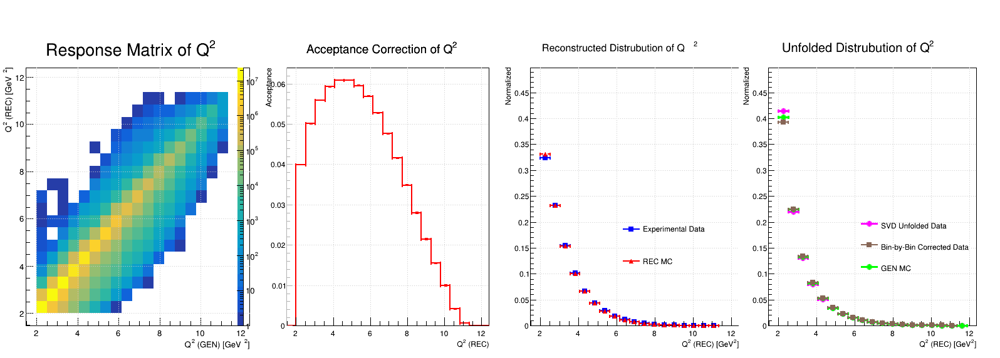

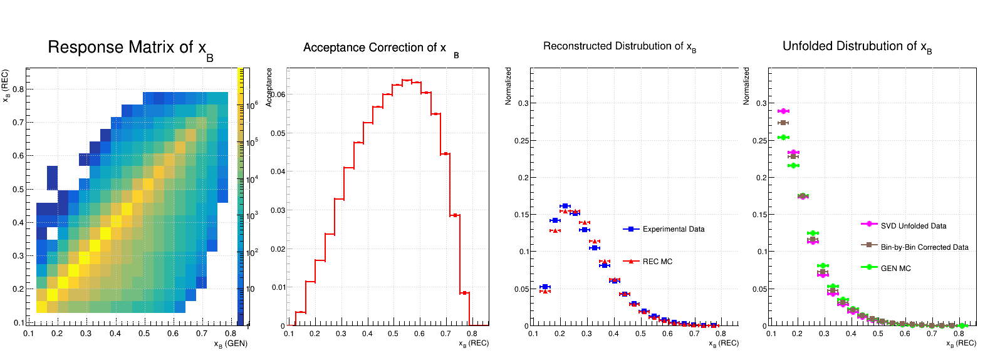

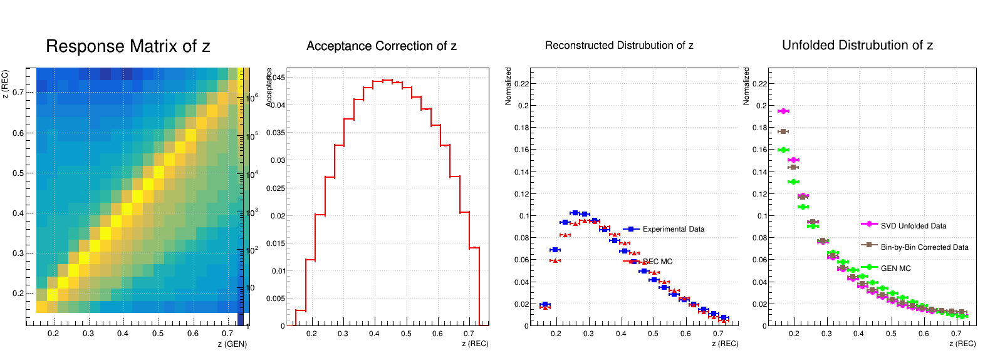

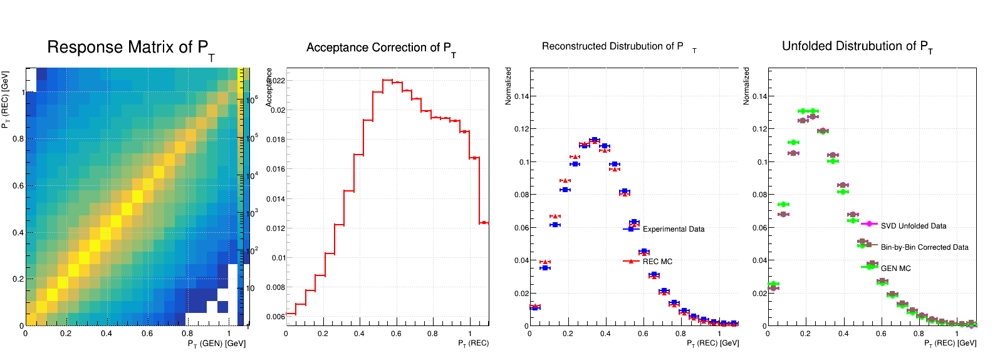

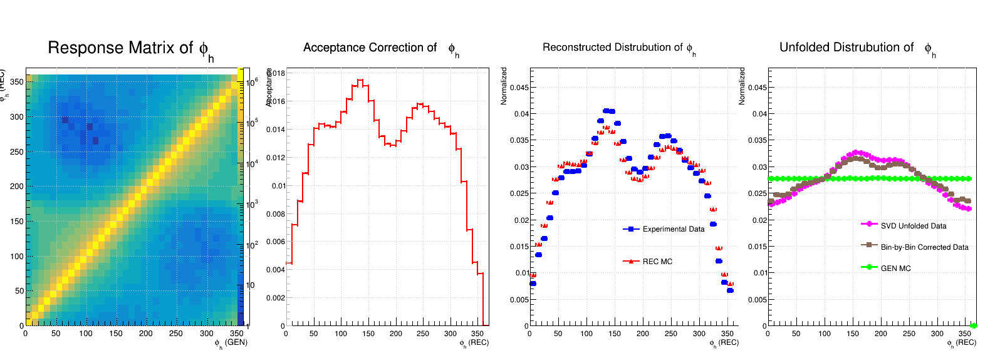

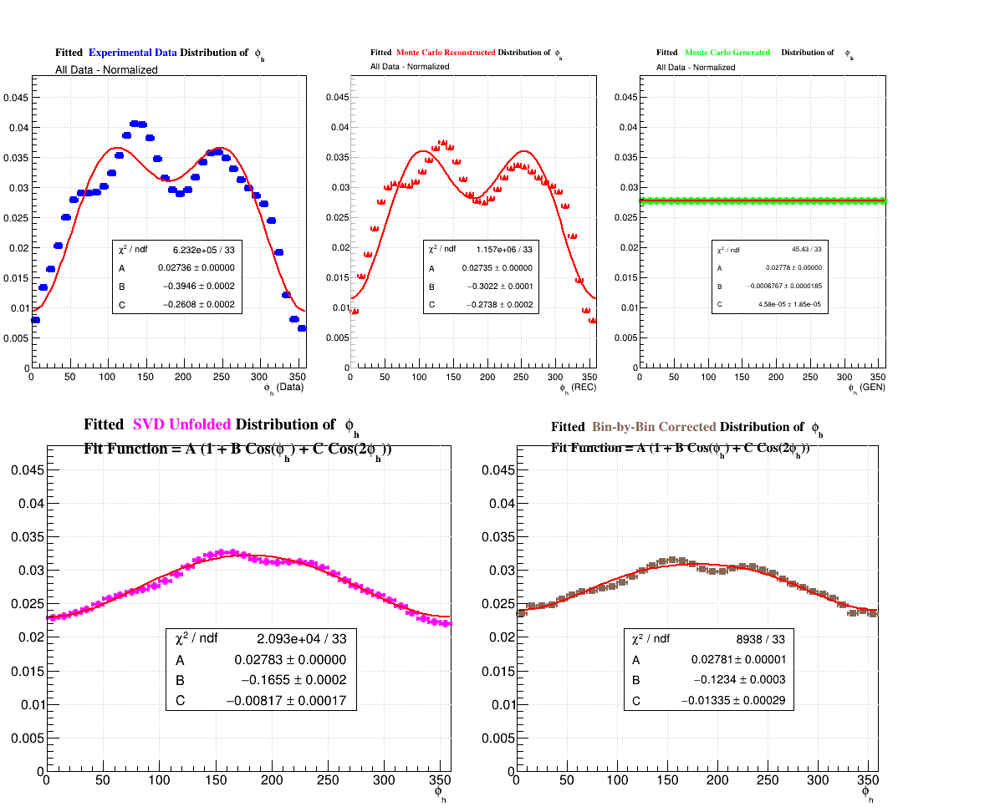

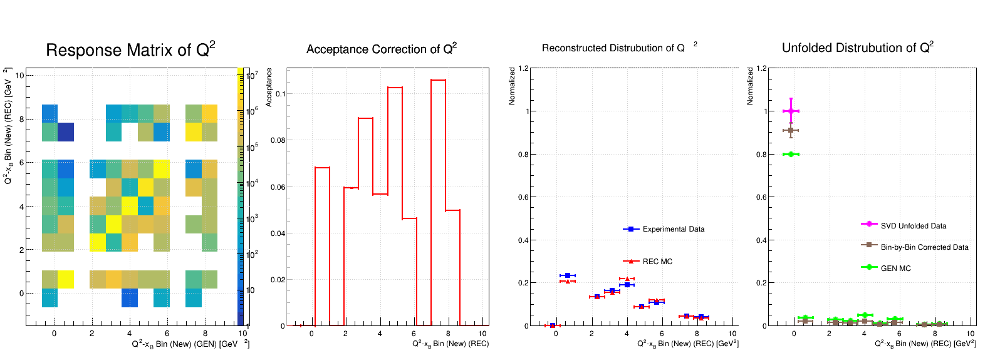

In [105]:
ROOT.gStyle.SetTitleY(1.0)
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
Divide_or_1_canvas = "one"

print_as_response_or_acceptance = "Response"
# print_as_response_or_acceptance = "Acceptance"


if('y' in Run_this_cell):
    
    canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
    list_of_canvas = []

    for datatype in list_of_DF:
        data_files_list = "error"

        if(datatype == 'rdf'):
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files
        
        # print(data_files_list)
        
        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue
            
            
        for data_file in data_files_list:

            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##
            
            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            ################################################################################
            ##==========##==========##============================##==========##==========##
            ##==========##==========##     Loop of DataFrames     ##==========##==========##
            ##==========##==========##============================##==========##==========##
            ################################################################################
            
            for ii in rdf.GetListOfKeys():
                
                output_name = str(ii.GetName())
                   
                # print(output_name)
                
#                 if("rdf" in output_name and "Response" in output_name):
#                     print(output_name)
                
                #################################################################################
                ##==========##==========##=============================##==========##==========##
                ##==========##==========##     Histogram Selection     ##==========##==========##
                ##==========##==========##=============================##==========##==========##
                #################################################################################
                    
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("phi" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
                if("Normal" in output_name and "Response" in output_name and ("SIDIS" in output_name or "gdf" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("Q2_xB_Bin_2" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
                    # if("1D" not in output_name and datatype_file != "mdf"):
                    #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
                    #     continue
                    if("1D" in output_name and datatype_file == "mdf"):
                        # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
                        continue
                    if("EDIS'" in output_name):
                        # print("Skipping Exculsive Cuts")
                        continue
                    # if("no_cut" not in output_name or "smear" in output_name):
                    #     print("TEMP: Skips")
                    #     continue
                    # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
                    #     # print("TEMP: Skips")
                    #     continue
                    #if("smear" not in output_name):
                    #    # print("Skipping Unsmeared histograms")
                    #    continue
                        
                        
                    # print(output_name)

                    
                    ###############################################################################################
                    ##==========##==========##===========================================##==========##==========##
                    ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
                    ##==========##==========##===========================================##==========##==========##
                    ###############################################################################################
                    # for Dimension in ["1D"]:
                    for Dimension in ["2D", "1D"]:
                        if("1D" in output_name and Dimension == "2D"):
                            continue
                        canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
                        if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
                            canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
                        else:
                            canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
                        print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

                        try:
                            Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
                        except:
                            print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                            print("".join([color.BOLD, color.RED, "Traceback:\n", color.END, color.RED, str(traceback.format_exc()), color.END]))
                            

                        try:
                            canvas_Unfolding[canvas_name]
                        except:
                            canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
                            canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
                            canvas_Unfolding[canvas_name].SetGrid()
                            ROOT.gStyle.SetAxisColor(16, 'xy')
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)
                            Num_of_canvas_made += 1

                        Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
                        if(print_as_response_or_acceptance != "Acceptance"):
                            ROOT.gPad.SetLogz(1)
                        else:
                            ROOT.gPad.SetLogz(0)

                        Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
                        Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)
                        
                        if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):# and Dimension != "1D"):
                            try:
                                gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
                                output_name_gdf = (((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")

                                if(output_name_gdf not in gdf.GetListOfKeys()):
                                    print(color.RED + color.BOLD + "\n\n\nPotential error\n\n\n" + color.END)
                                histo_gdf = gdf.Get(output_name_gdf)
                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                    norm_bin_gen = histo_gdf.GetBinContent(jj)
                                    for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                        count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)
                                        if(norm_bin_gen != 0):
                                            Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
                                        else:
                                            Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
                                Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                            except Exception as e:
                                print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))
                                print("".join([color.BOLD, color.RED, "ERROR: ", str(e), color.END]))
                                print("".join([color.BOLD, color.RED, "Traceback:\n", color.END, color.RED, str(traceback.format_exc()), color.END]))


                        if("1D" not in output_name and False and "Q2" in output_name):# and "Normal" not in output_name):
                            if("Bin_Res_4D" not in output_name):
                                for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

                                    Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

                                    for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

                                    Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

                                    for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

                            else:
                                for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                    low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

                                    if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
                                    else:
                                        print("\nError?\n")

                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                    low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

                                    if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
                                    else:
                                        print("\nError?\n")
                                        
#                         if("gdf" in output_name):
#                             print("\n\n\nTEST\n\n\n")
#                             print(output_name)
#                             below_bin = Unfolding_Histo[str((output_name, datatype_file))].FindBin(1.5)
#                             print(below_bin)
#                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(below_bin, 0)

                        Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

                        if("2D" in Dimension):
                            # print("""testif("2D" in Dimension):""")
                            Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
                            palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
                        elif("1D" not in output_name):
                            # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
                            Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
                            Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
                            Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
                        else:
                            Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                          
                        
                        
                        
                        
                        
                        
                        
    if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
        print(color.BOLD + "\n\nUnfolding..." + color.END)
        ###############################################################################################
        ##==========##==========##===========================================##==========##==========##
        ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
        ##==========##==========##===========================================##==========##==========##
        ###############################################################################################
        for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
            if("smear" in str(name)):
                print("skipping smearing (temp)")
                continue
            
            name_2 = str(name).replace("'pdf')", "'mdf')")
            if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
                Adet_name = str(name).replace("1D_rec", "mdf")
                bini_name = str(name.replace("mdf", "1D_rec"))
                bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

                unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
                xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
                xini_name = xini_name.replace("1D_rec", "1D_gen")
                bdata_name = unfold_name_base.replace("mdf", "rdf")

                
                print("Adet_name = " + str(Adet_name))   # Response Matrix
                print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
                print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
                print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                
                minBin, maxBin, numBin = [-1.5, 9.5, 13] if("Q2_xB_Bin_2" in name) else [1.8, 12, 20] if("Q2" in name) else [0.09, 0.83, 20] if("xB" in name) else [0.12, 0.75, 20] if("z" in name) else [0, 1.05, 20] if("pT" in name) else [0, 360, 36]
                
                nBins_CVM = numBin
                MinBinCVM = Unfolding_Histo[bdata_name].FindBin(minBin)
                MaxBinCVM = Unfolding_Histo[bdata_name].FindBin(maxBin)

                Unfolding_Histo[bdata_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)  # Experimental/real data (rdf)
                Unfolding_Histo[bini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Reconstructed data (mdf)
                Unfolding_Histo[xini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Generated data (gdf)
                Unfolding_Histo[Adet_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (X axis --> GEN)
                Unfolding_Histo[Adet_name].GetYaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (Y axis --> REC)
                
                
                Unfolding_Histo[Adet_name].SetTitle(str((Unfolding_Histo[Adet_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                Unfolding_Histo[bdata_name].SetTitle(str((Unfolding_Histo[bdata_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                Unfolding_Histo[bini_name].SetTitle(str((Unfolding_Histo[bini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                Unfolding_Histo[xini_name].SetTitle(str((Unfolding_Histo[xini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                
                Unfold_variable_title = "Q^{2}" if("Q2" in Adet_name) else "x_{B}" if("xB" in Adet_name) else "P_{T}" if("pT" in Adet_name) else "z" if("z" in Adet_name) else "#phi_{h}" if("phi_t" in Adet_name) else "ERROR"
                
                Unfolding_Histo[Adet_name].SetTitle("".join(["#scale[1.5]{Response Matrix of ", str(Unfold_variable_title), "}"]))
                Unfolding_Histo[bdata_name].SetTitle("".join(["#scale[1.5]{Reconstructed Distrubution of ", str(Unfold_variable_title), "}"]))
                Unfolding_Histo[bini_name].SetTitle("".join(["#scale[1.5]{Reconstructed Distrubution of ", str(Unfold_variable_title), "}"]))
                Unfolding_Histo[xini_name].SetTitle("".join(["#scale[1.5]{Unfolded Distrubution of ", str(Unfold_variable_title), "}"]))
                
                
                Unfolding_Histo[Adet_name].GetXaxis().SetTitle(str(Unfolding_Histo[Adet_name].GetXaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[bdata_name].GetXaxis().SetTitle(str(Unfolding_Histo[bdata_name].GetXaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[bini_name].GetXaxis().SetTitle(str(Unfolding_Histo[bini_name].GetXaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[xini_name].GetXaxis().SetTitle(str(Unfolding_Histo[xini_name].GetXaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                    
                Unfolding_Histo[Adet_name].GetYaxis().SetTitle(str(Unfolding_Histo[Adet_name].GetYaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[bdata_name].GetYaxis().SetTitle(str(Unfolding_Histo[bdata_name].GetYaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[bini_name].GetYaxis().SetTitle(str(Unfolding_Histo[bini_name].GetYaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))
                Unfolding_Histo[xini_name].GetYaxis().SetTitle(str(Unfolding_Histo[xini_name].GetYaxis().GetTitle()).replace("#phi_{t}", "#phi_{h}"))


#                 if("'Q2'" in name):
                if("'pT'" not in name and "phi_t" not in name):
#                 if("'errortest'" not in name and False):
                    Unfolding_Histo[bini_name].SetBinContent(0, 0)
                    Unfolding_Histo[bini_name].SetBinContent(1, 0)
                    Unfolding_Histo[bini_name].SetBinContent(Unfolding_Histo[bini_name].GetNbinsX() + 1, 0)
                    Unfolding_Histo[xini_name].SetBinContent(0, 0)
                    Unfolding_Histo[xini_name].SetBinContent(1, 0)
                    Unfolding_Histo[xini_name].SetBinContent(Unfolding_Histo[xini_name].GetNbinsX() + 1, 0)
                    Unfolding_Histo[bdata_name].SetBinContent(0, 0)
                    Unfolding_Histo[bdata_name].SetBinContent(1, 0)
                    Unfolding_Histo[bdata_name].SetBinContent(Unfolding_Histo[bdata_name].GetNbinsX() + 1, 0)
                    for ybin in range(0, Unfolding_Histo[Adet_name].GetNbinsY() + 2, 1):
                        Unfolding_Histo[Adet_name].SetBinContent(0, ybin, 0)
                    for ybin in range(0, Unfolding_Histo[Adet_name].GetNbinsY() + 2, 1):
                        Unfolding_Histo[Adet_name].SetBinContent(1, ybin, 0)
#                     for ybin in range(0, Unfolding_Histo[Adet_name].GetNbinsY() + 2, 1):
#                         Unfolding_Histo[Adet_name].SetBinContent(Unfolding_Histo[Adet_name].GetNbinsX() + 1, ybin, 0)
#                     for xbin in range(0, Unfolding_Histo[Adet_name].GetNbinsX() + 2, 1):
#                         Unfolding_Histo[Adet_name].SetBinContent(xbin, Unfolding_Histo[Adet_name].GetNbinsY() + 1, 0)
                    for xbin in range(0, Unfolding_Histo[Adet_name].GetNbinsX() + 2, 1):
                        Unfolding_Histo[Adet_name].SetBinContent(xbin, 1, 0)

                Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)
                # Filling the Covariance Matrix
                for CVM_Bin in range(0, nBins_CVM, 1):
                    Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

                Reg_Par = 13 # Unfolding Regularization Parameter

                Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
                # print(Unfolding_Canvas_Name)

                if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
                    try:
                        Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
                        Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

                        Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

                        Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)

                        Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()
                        # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()
                        unfolding_toys = 100
                        Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)
                        Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)
                        Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])
                        Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()
                        Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])
                        # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()
                        for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
                            Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))
                        try:
                            canvas_Unfolding[Unfolding_Canvas_Name]
                        except:
#                             canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                             canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 2, 0.00, 0.00)
                            canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1600, 600)
                            canvas_Unfolding[Unfolding_Canvas_Name].Divide(4, 1, 0.00, 0.00)
                            canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
                            ROOT.gStyle.SetAxisColor(16, 'xy')
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)
                            Num_of_canvas_made += 1
                        canvas_Unfolding[Unfolding_Canvas_Name].Draw()
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle("".join(["#scale[1.5]{Acceptance Correction of ", str(Unfold_variable_title), "}"]))
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")


                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))

                        norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)

                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)


                        Unfolding_Legend[(Unfolding_Canvas_Name, 1)], Unfolding_Legend[(Unfolding_Canvas_Name, 2)] = ROOT.TLegend(0.6 - 0.1, 0.6 - 0.35, 0.99 - 0.1, 0.8 - 0.35), ROOT.TLegend(0.6 - 0.1, 0.6 - 0.35, 0.99 - 0.1, 0.8 - 0.35)
                        for ii in [1, 2]:
                            Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetBorderSize(0)
                            Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetFillColor(0)
                            Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetFillStyle(0)
                            Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetTextSize(0.0345)
                        Unfolding_Legend[(Unfolding_Canvas_Name, 1)].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "pl")
                        Unfolding_Legend[(Unfolding_Canvas_Name, 1)].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "pl")
                        Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "pl")
                        if("smear" in str(name)):
                            Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "pl")
                        else:
                            Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bini_name], "REC MC", "pl")
                        Unfolding_Legend[(Unfolding_Canvas_Name, 1)].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "pl")

                        # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
                        Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
                        # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
                        if("smear" in str(name)):
                            Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

                        Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())
#                         Max_value = max([Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin()), Unfolding_Histo[bdata_name].GetBinContent(Unfolding_Histo[bdata_name].GetMaximumBin()), Unfolding_Histo[bini_name].GetBinContent(Unfolding_Histo[bini_name].GetMaximumBin()), Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].GetMaximumBin())])

                        norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
                        norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
                        norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
                        norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
                
                        norm_factor_all = max([norm_factor_Unfolded, norm_factor_Data, norm_factor_Reconstructed, norm_factor_Generated])
                        norm_factor_all = max([norm_factor_Unfolded, norm_factor_Generated])
                
#                         Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_all)
#                         Unfolding_Histo[bdata_name].Scale(1/max([norm_factor_Data, norm_factor_Reconstructed]))
#                         Unfolding_Histo[bini_name].Scale(1/max([norm_factor_Data, norm_factor_Reconstructed]))
#                         # Unfolding_Histo[bdata_name].Scale(1/norm_factor_all)
#                         # Unfolding_Histo[bini_name].Scale(1/norm_factor_all)
#                         Unfolding_Histo[xini_name].Scale(1/norm_factor_all)
                        
                        Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)
                        Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)
                        Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)
                        Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)

                    

                        Max_value_2 = max([Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin()), Unfolding_Histo[bdata_name].GetBinContent(Unfolding_Histo[bdata_name].GetMaximumBin()), Unfolding_Histo[bini_name].GetBinContent(Unfolding_Histo[bini_name].GetMaximumBin()), Unfolding_Histo[xini_name].GetBinContent(Unfolding_Histo[xini_name].GetMaximumBin())])
                        norm_factor = 1# /max([norm_factor_Unfolded, norm_factor_Data, norm_factor_Reconstructed, norm_factor_Generated])
                    
                    
    ###################################################################################
    ##==========##==========##     CD 4 - Unfolded Plots     ##==========##==========##
    ###################################################################################
                        Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 4, 0.075, -0.05)#0.1)
                        # canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
                        ROOT.gPad.SetLogy(0)

                        Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
                        # Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                        Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
#                         Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_all))

                        Unfolded_Histo[Unfolding_Canvas_Name].SetTitle("".join(["#scale[1.5]{Unfolded Distrubution of ", str(Unfold_variable_title), "}"]))
                        Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
                        Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(1)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerStyle(20)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(3)
                        Unfolded_Histo[Unfolding_Canvas_Name].SetLineStyle(1)
                        Unfolded_Histo[Unfolding_Canvas_Name].Draw("PL E1 same")
                        Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join([str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()), " [GeV^{2}]" if("Q2" in Unfolding_Canvas_Name) else " [GeV]" if("pT" in Unfolding_Canvas_Name) else ""]))
                        # Unfolded_Clone.SetLineWidth(4)
                        # Unfolded_Clone.Draw("Hist E1 same")
                        # Unfolding_Histo[bdata_name].SetLineWidth(2)
                        # Unfolding_Histo[bdata_name].Draw("Hist E1 same")
                        # Unfolding_Histo[bini_name].SetLineWidth(2)
                        # Unfolding_Histo[bini_name].Draw("Hist E1 same")
                        # Unfolding_Histo[xini_name].SetLineWidth(3)
                        # Unfolding_Histo[xini_name].Draw("Hist E1 same")
                        Unfolding_Histo[xini_name].SetMarkerColor(root_color.Green)
                        Unfolding_Histo[xini_name].SetLineColor(root_color.Green)
                        Unfolding_Histo[xini_name].SetMarkerSize(1)
                        Unfolding_Histo[xini_name].SetMarkerStyle(20)
                        Unfolding_Histo[xini_name].SetLineWidth(3)
                        Unfolding_Histo[xini_name].SetLineStyle(1)
                        Unfolding_Histo[xini_name].Draw("PL E1 same")
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerSize(1)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerStyle(21)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineStyle(1)
                        Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("PL E1 same")
                        Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
                        Unfolding_Histo[xini_name].GetXaxis().SetTitle("".join([str(Unfolding_Histo[xini_name].GetXaxis().GetTitle()), " [GeV^{2}]" if("Q2" in xini_name) else " [GeV]" if("pT" in xini_name) else ""]))

                        # Unfolding_Histo[xini_name].Draw("same")
                        # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
                        # Unfolding_Histo[bdata_name].Draw("same")
                        # Unfolding_Histo[bini_name].Draw("same")

                        Unfolding_Legend[(Unfolding_Canvas_Name, 1)].Draw()

                        
                        
    ##################################################################################
    ##==========##==========##     CD 2 - Initial Plots     ##==========##==========##
    ##################################################################################
                        Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 3, 0.075, -0.05)#, 0.05)#, 0.05)
                        ROOT.gPad.SetLogy(0)
#                         Unfolding_Histo[bini_name].GetYaxis().SetRangeUser(0, 1.8*Unfolding_Histo[bini_name].GetMaximum())
                        # Unfolding_Histo[bdata_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                        Unfolding_Histo[bdata_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
        
#                         Unfolding_Histo[bdata_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_all))
                        Unfolding_Histo[bdata_name].GetYaxis().SetTitle("Normalized")
                        Unfolding_Histo[bdata_name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded", "Reconstructed"))
                        Unfolding_Histo[bdata_name].SetMarkerColor(root_color.Blue)
                        Unfolding_Histo[bdata_name].SetLineColor(root_color.Blue)
                        Unfolding_Histo[bdata_name].SetMarkerSize(1)
                        Unfolding_Histo[bdata_name].SetMarkerStyle(21)
                        Unfolding_Histo[bdata_name].SetLineWidth(2)
                        Unfolding_Histo[bdata_name].SetLineStyle(1)
                        Unfolding_Histo[bdata_name].Draw("PL E1 same")
                        Unfolding_Histo[bdata_name].GetXaxis().SetTitle("".join([str(Unfolding_Histo[bdata_name].GetXaxis().GetTitle()), " [GeV^{2}]" if("Q2" in bdata_name) else " [GeV]" if("pT" in bdata_name) else ""]))
                        Unfolding_Legend[(Unfolding_Canvas_Name, 2)].Draw()
                        
                        
                        # Unfolding_Histo[bini_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))
                        Unfolding_Histo[bini_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
#                         Unfolding_Histo[bini_name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_all))
                        Unfolding_Histo[bini_name].GetYaxis().SetTitle("Normalized")
                        Unfolding_Histo[bini_name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded", "Reconstructed"))
                        Unfolding_Histo[bini_name].SetMarkerColor(root_color.Red)
                        Unfolding_Histo[bini_name].SetLineColor(root_color.Red)
                        Unfolding_Histo[bini_name].SetMarkerSize(1)
                        Unfolding_Histo[bini_name].SetMarkerStyle(22)
                        Unfolding_Histo[bini_name].SetLineWidth(2)
                        Unfolding_Histo[bini_name].SetLineStyle(1)
                        Unfolding_Histo[bini_name].Draw("PL E1 same")
                        Unfolding_Histo[bini_name].GetXaxis().SetTitle("".join([str(Unfolding_Histo[bini_name].GetXaxis().GetTitle()), " [GeV^{2}]" if("Q2" in bini_name) else " [GeV]" if("pT" in bini_name) else ""]))
                        
                        canvas_Unfolding[Unfolding_Canvas_Name].Update()

#                         # Get scale of GEN Histo
#                         right_max = 1.1*Unfolding_Histo[xini_name].GetMaximum()
#                         scale_right = (ROOT.gPad.GetUymax())/right_max

#                         Unfolding_Histo[xini_name].Scale(scale_right)
#                         Unfolding_Histo[xini_name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded", "Initial"))
#                         Unfolding_Histo[xini_name].GetYaxis().SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().GetTitle())
#                         Unfolding_Histo[xini_name].SetMarkerColor(root_color.Green)
#                         Unfolding_Histo[xini_name].SetLineColor(root_color.Green)
#                         Unfolding_Histo[xini_name].SetMarkerSize(1)
#                         Unfolding_Histo[xini_name].SetMarkerStyle(20)
#                         Unfolding_Histo[xini_name].SetLineWidth(3)
#                         Unfolding_Histo[xini_name].SetLineStyle(1)
#                         Unfolding_Histo[xini_name].Draw("PL E1 same")
                        # Draw GEN axis on the right side
#                         axis_right = ROOT.TGaxis(ROOT.gPad.GetUxmax(), ROOT.gPad.GetUymin(), ROOT.gPad.GetUxmax(), ROOT.gPad.GetUymax(), 0, right_max, 510, "+L")
#                         axis_right.SetLineColor(root_color.Green)
#                         axis_right.SetTextColor(3)
#                         axis_right.Draw()
                        # ROOT.gStyle.SetAxisColor(3, 'xy')






    ####################################################################################
    ##==========##==========##     CD 1 - Response Matrix     ##==========##==========##
    ####################################################################################
                        Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 1, 0.05)
                        # Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
                        ROOT.gPad.SetLogy(0)
                        ROOT.gPad.SetLogz(1)
                        # Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
                        Tline_Simple_Test_1 = ROOT.TLine()
                        Tline_Simple_Test_1.SetLineColor(2)
                        Tline_Simple_Test_1.SetLineWidth(2)
                        Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
                        Unfolding_Histo[Adet_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)
                        Unfolding_Histo[Adet_name].GetYaxis().SetRange(MinBinCVM, MaxBinCVM)
                        Unfolding_Histo[Adet_name].GetXaxis().SetTitle("".join([str(Unfolding_Histo[Adet_name].GetXaxis().GetTitle()), " [GeV^{2}]" if("Q2" in Adet_name) else " [GeV]" if("pT" in Adet_name) else ""]))
                        Unfolding_Histo[Adet_name].GetYaxis().SetTitle("".join([str(Unfolding_Histo[Adet_name].GetYaxis().GetTitle()), " [GeV^{2}]" if("Q2" in Adet_name) else " [GeV]" if("pT" in Adet_name) else ""]))
                        Unfolding_Histo[Adet_name].Draw("colz")
                        palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)


                        
    ##########################################################################################
    ##==========##==========##     CD 3 - Bin-by-bin Acceptance     ##==========##==========##
    ##########################################################################################
                        # canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
                        Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 2, 0.05)
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded Distribution", "Acceptance Correction"))
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("Acceptance")
                        Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")
        
        
        
        
        
        
        
    ##########################################################################################
    ##==========##==========##    Fitting the phi_h distribution    ##==========##==========##
    ##########################################################################################
                        if("phi" in str(name)):
                            canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])] = Canvas_Create(Name="".join([str(Unfolding_Canvas_Name), "_Fitted"]), Num_Columns=1, Num_Rows=2, Size_X=1200, Size_Y=1000, cd_Space=0)
                            canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].Draw()
                    
                            canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1).Divide(3, 1, 0, 0)
                            canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(2).Divide(2, 1, 0, 0)
                            
                            
                            
                        ##################################################################
                        ##==========##          Cloning Histograms          ##==========##
                        ##################################################################
                            Unfolded_C_clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
                            Bin_by_Bin_clone = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Clone()
                            MC_GEN_clone = Unfolding_Histo[xini_name].Clone()
                            R_Data_clone = Unfolding_Histo[bdata_name].Clone()
                            MC_REC_clone = Unfolding_Histo[bini_name].Clone()
                            
                            
                            Unfolded_C_max_bin = Unfolded_C_clone.GetMaximumBin()
                            Bin_by_Bin_max_bin = Bin_by_Bin_clone.GetMaximumBin()
                            MC_GEN_max_bin = MC_GEN_clone.GetMaximumBin()
                            R_Data_max_bin = R_Data_clone.GetMaximumBin()
                            MC_REC_max_bin = MC_REC_clone.GetMaximumBin()
                            
                            Unfolded_C_max_bin_y = Unfolded_C_clone.GetBinContent(Unfolded_C_max_bin)
                            Bin_by_Bin_max_bin_y = Bin_by_Bin_clone.GetBinContent(Bin_by_Bin_max_bin)
                            MC_GEN_max_bin_y = MC_GEN_clone.GetBinContent(MC_GEN_max_bin)
                            R_Data_max_bin_y = R_Data_clone.GetBinContent(R_Data_max_bin)
                            MC_REC_max_bin_y = MC_REC_clone.GetBinContent(MC_REC_max_bin)
                            
                            
                            Unfolded_C_max_bin_x = (3.1415926/180)*Unfolded_C_clone.GetBinCenter(Unfolded_C_max_bin)
                            Bin_by_Bin_max_bin_x = (3.1415926/180)*Bin_by_Bin_clone.GetBinCenter(Bin_by_Bin_max_bin)
                            MC_GEN_max_bin_x = (3.1415926/180)*MC_GEN_clone.GetBinCenter(MC_GEN_max_bin)
                            R_Data_max_bin_x = (3.1415926/180)*R_Data_clone.GetBinCenter(R_Data_max_bin)
                            MC_REC_max_bin_x = (3.1415926/180)*MC_REC_clone.GetBinCenter(MC_REC_max_bin)
                            
                            
                            
                            Max_value_2 = max([Unfolded_C_max_bin_y, Bin_by_Bin_max_bin_y, MC_GEN_max_bin_y, R_Data_max_bin_y, MC_REC_max_bin_y])
                            norm_factor = 1# /max([norm_factor_Unfolded, norm_factor_Data, norm_factor_Reconstructed, norm_factor_Generated])
                            
                            # Unfolded_C_clone.Scale(1/norm_factor)
                            # Bin_by_Bin_clone.Scale(1/norm_factor)
                            # MC_GEN_clone.Scale(1/norm_factor)
                            # R_Data_clone.Scale(1/norm_factor)
                            # MC_REC_clone.Scale(1/norm_factor)
                            
                            
                            # fit_function_title = "A + B Cos(#phi_{h}) + C Cos(2#phi_{h}) + D Cos(3#phi_{h})"
                            # fit_function = "[A] + [B]*cos(x*(3.1415926/180)) + [C]*cos(2*x*(3.1415926/180)) + [D]*cos(3*x*(3.1415926/180))"
                            fit_function_title = "A + B Cos(#phi_{h}) + C Cos(2#phi_{h})"
                            fit_function = "[A] + [B]*cos(x*(3.1415926/180)) + [C]*cos(2*x*(3.1415926/180))"
                            

                            fit_function_title = "A (1 + B Cos(#phi_{h}) + C Cos(2#phi_{h}))"
                            fit_function = "[A]*(1 + [B]*cos(x*(3.1415926/180)) + [C]*cos(2*x*(3.1415926/180)))"

                    
                        ##################################################################
                        ##==========##         Matrix Unfolded Fits         ##==========##
                        ##################################################################
                            Draw_Canvas(canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(2), 1, 0.05)
                            Unfolded_C_clone.SetTitle("".join(["#splitline{", root_color.Bold, "{Fitted #color[", str(root_color.Pink),"]{SVD Unfolded} Distribution of #phi_{h}}}{", root_color.Bold, "{Fit Function = ", str(fit_function_title), "}}"]))
                            Unfolded_C_clone.GetYaxis().SetTitle("")
                            Unfolded_C_clone.GetXaxis().SetTitle(str(Unfolded_C_clone.GetXaxis().GetTitle()).replace("(REC)", ""))
                            Unfolded_C_clone.GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
                            Unfolded_C_clone.Draw("PL E1 same")
                            Unfolded_Fit_Function = ROOT.TF1("Unfolded_Fit_Function", str(fit_function), 0, 360)
                            A_Unfold, B_Unfold, C_Unfold = Full_Calc_Fit(Unfolded_C_clone)
                            print("\n".join([str(A_Unfold), str(B_Unfold), str(C_Unfold)]))
#                             Unfolded_Fit_Function.SetParameter(0, A_Unfold)
#                             Unfolded_Fit_Function.SetParLimits(0, 0.85*A_Unfold if(A_Unfold > 0) else 1.25*A_Unfold, 1.25*A_Unfold if(A_Unfold > 0) else 0.85*A_Unfold)
#                             Unfolded_Fit_Function.SetParameter(1, B_Unfold)
#                             Unfolded_Fit_Function.SetParLimits(1, 0.65*B_Unfold if(B_Unfold > 0) else 1.45*B_Unfold, 1.45*B_Unfold if(B_Unfold > 0) else 0.65*B_Unfold)
#                             Unfolded_Fit_Function.SetParameter(2, C_Unfold)
#                             Unfolded_Fit_Function.SetParLimits(2, 0.65*C_Unfold if(C_Unfold > 0) else 1.45*C_Unfold, 1.45*C_Unfold if(C_Unfold > 0) else 0.65*C_Unfold)
                            # Unfolded_Fit_Function.SetParameter(0, A_Calc_Fit(Unfolded_C_clone))
                            # Unfolded_Fit_Function.SetParLimits(0, 0.85*A_Calc_Fit(Unfolded_C_clone), 1.25*A_Calc_Fit(Unfolded_C_clone))
                            Unfolded_C_clone.Fit(Unfolded_Fit_Function, "RQ")
                            statbox_move_new(Histogram=Unfolded_C_clone, Canvas=canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(2).cd(1), Default_Stat_Obj="", Y1_add=0.25, Y2_add=0.45, X1_add=0.35, X2_add=0.75)
                            # Unfolded_C_clone.ShowPeaks()
                            Unfolded_C_clone.GetXaxis().SetRangeUser(0, 360)
                            
                            
                        ##################################################################
                        ##==========##      Bin-by-Bin Correction Fits      ##==========##
                        ##################################################################
                            Draw_Canvas(canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(2), 2, 0.05)
                            Bin_by_Bin_clone.SetTitle("".join(["#splitline{", root_color.Bold, "{Fitted #color[", str(root_color.Brown),"]{Bin-by-Bin Corrected} Distribution of #phi_{h}}}{", root_color.Bold, "{Fit Function = ", str(fit_function_title), "}}"]))
                            Bin_by_Bin_clone.GetYaxis().SetTitle("")
                            Bin_by_Bin_clone.GetXaxis().SetTitle(str(Bin_by_Bin_clone.GetXaxis().GetTitle()).replace("(REC)", ""))
                            Bin_by_Bin_clone.GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
                            Bin_by_Bin_clone.Draw("PL E1 same")
                            Bin_by_Bin_Fit_Function = ROOT.TF1("Bin_by_Bin_Fit_Function", str(fit_function), 0, 360)
                            Bin_by_Bin_Fit_Function.SetParameter(0, A_Calc_Fit(Bin_by_Bin_clone))
                            Bin_by_Bin_Fit_Function.SetParLimits(0, 0.85*A_Calc_Fit(Bin_by_Bin_clone), 1.25*A_Calc_Fit(Bin_by_Bin_clone))
                            Bin_by_Bin_clone.Fit(Bin_by_Bin_Fit_Function, "BRQ")
                            statbox_move_new(Histogram=Bin_by_Bin_clone, Canvas=canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(2).cd(2), Default_Stat_Obj="", Y1_add=0.25, Y2_add=0.45, X1_add=0.35, X2_add=0.75)
                            # Bin_by_Bin_clone.ShowPeaks()
                            Bin_by_Bin_clone.GetXaxis().SetRangeUser(0, 360)
                          
                            
                        ##################################################################
                        ##==========##   Experimental Data (Initial) Fits   ##==========##
                        ##################################################################
                            Draw_Canvas(canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1), 1, 0.05)
                            R_Data_clone.SetTitle("".join(["#splitline{", root_color.Bold, "{Fitted #color[", str(root_color.Blue),"]{Experimental Data} Distribution of #phi_{h}}}{All Data - Normalized}"]))
                            R_Data_clone.GetYaxis().SetTitle("")
                            R_Data_clone.GetXaxis().SetTitle(str(R_Data_clone.GetXaxis().GetTitle()).replace("REC", "Data"))
                            R_Data_clone.GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
                            R_Data_clone.Draw("PL E1 same")
                            REAL_DATA_Fit_Function = ROOT.TF1("REAL_DATA_Fit_Function", str(fit_function), 0, 360)
                            REAL_DATA_Fit_Function.SetParameter(0, A_Calc_Fit(R_Data_clone))
                            REAL_DATA_Fit_Function.SetParLimits(0, 0.85*A_Calc_Fit(R_Data_clone), 1.25*A_Calc_Fit(R_Data_clone))
                            R_Data_clone.Fit(REAL_DATA_Fit_Function, "BRQ")
                            statbox_move_new(Histogram=R_Data_clone, Canvas=canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1).cd(1), Default_Stat_Obj="", Y1_add=0.25, Y2_add=0.45, X1_add=0.35, X2_add=0.75)
                            # R_Data_clone.ShowPeaks()
                            R_Data_clone.GetXaxis().SetRangeUser(0, 360)
                            
                            
                        ##################################################################
                        ##==========##    Monte Carlo Reconstructed Fits    ##==========##
                        ##################################################################
                            Draw_Canvas(canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1), 2, 0.05)
                            MC_REC_clone.SetTitle("".join(["#splitline{", root_color.Bold, "{Fitted #color[", str(root_color.Red),"]{Monte Carlo Reconstructed} Distribution of #phi_{h}}}{All Data - Normalized}"]))
                            MC_REC_clone.GetYaxis().SetTitle("")
                            MC_REC_clone.GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
                            MC_REC_clone.Draw("PL E1 same")
                            MC_REC_Fit_Function = ROOT.TF1("MC_REC_Fit_Function", str(fit_function), 0, 360)
                            MC_REC_Fit_Function.SetParameter(0, A_Calc_Fit(MC_REC_clone))
                            MC_REC_Fit_Function.SetParLimits(0, 0.85*A_Calc_Fit(MC_REC_clone), 1.25*A_Calc_Fit(MC_REC_clone))
                            MC_REC_clone.Fit(MC_REC_Fit_Function, "BRQ")
                            statbox_move_new(Histogram=MC_REC_clone, Canvas=canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1).cd(2), Default_Stat_Obj="", Y1_add=0.25, Y2_add=0.45, X1_add=0.35, X2_add=0.75)
                            # MC_REC_clone.ShowPeaks()
                            MC_REC_clone.GetXaxis().SetRangeUser(0, 360)
                            
                            
                        ##################################################################
                        ##==========##      Monte Carlo Generated Fits      ##==========##
                        ##################################################################
                            Draw_Canvas(canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1), 3, 0.05)
                            MC_GEN_clone.SetTitle("".join(["#splitline{", root_color.Bold, "{Fitted #color[", str(root_color.Green),"]{Monte Carlo Generated} Distribution of #phi_{h}}}{All Data - Normalized}"]))
                            MC_GEN_clone.GetYaxis().SetTitle("")
                            MC_GEN_clone.GetYaxis().SetRangeUser(0, 1.2*(Max_value_2/norm_factor))
                            MC_GEN_clone.Draw("PL E1 same")
                            MC_GEN_Fit_Function = ROOT.TF1("MC_GEN_Fit_Function", str(fit_function), 0, 360)
                            MC_GEN_clone.Fit(MC_GEN_Fit_Function, "BRQ")
                            statbox_move_new(Histogram=MC_GEN_clone, Canvas=canvas_Unfolding["".join([str(Unfolding_Canvas_Name), "_Fitted"])].cd(1).cd(3), Default_Stat_Obj="", Y1_add=0.25, Y2_add=0.45, X1_add=0.35, X2_add=0.75)
                            # MC_GEN_clone.ShowPeaks()
                            MC_GEN_clone.GetXaxis().SetRangeUser(0, 360)

                            
                    except Exception as e:
                        print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM..." + color.END)
                        print(color.BOLD + color.RED + "ERROR: " + str(e) + color.END + "\n\n")
                        print(traceback.format_exc())

                else:
                    print(color.RED + "\nUnequal bins..." + color.END)
                    print("nBins_CVM = " + str(nBins_CVM))
                    print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
                    print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
                    print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
                    print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




            # else:
            #     continue

        ###############################################################################################
        ##==========##==========##===========================================##==========##==========##
        ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
        ##==========##==========##===========================================##==========##==========##
        ###############################################################################################
        print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
    else:
        print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
    
    
    
#     for ii in canvas_Unfolding:
#         canvas_Unfolding[ii].Draw()
        
else:
    print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    
    
    

In [84]:
Unfolding_Histo

{'("(\'Response_Matrix_Normal_1D\', \'Q2_xB_Bin_2\', \'2\', \'cut_Complete_SIDIS\', \'\', -1, \'rdf\')", \'rdf\')': <cppyy.gbl.TH1D object at 0x5613423ea210>,
 '("(\'Response_Matrix_Normal\', \'Q2_xB_Bin_2\', \'2\', \'cut_Complete_SIDIS\', \'\', -1, \'mdf\')", \'mdf\')': <cppyy.gbl.TH2D object at 0x5613423e49f0>,
 '("(\'Response_Matrix_Normal\', \'Q2_xB_Bin_2\', \'2\', \'cut_Complete_SIDIS\', \'\', -1, \'mdf\')", \'1D_rec\')': <cppyy.gbl.TH1D object at 0x561328abc910>,
 '("(\'Response_Matrix_Normal\', \'Q2_xB_Bin_2\', \'2\', \'cut_Complete_SIDIS\', \'\', -1, \'mdf\')", \'1D_gen\')': <cppyy.gbl.TH1D object at 0x56131c3d8920>,
 '("(\'Response_Matrix_Normal\', \'Q2_xB_Bin_2_smeared\', \'smear_2\', \'cut_Complete_SIDIS\', \'\', -1, \'mdf\')", \'mdf\')': <cppyy.gbl.TH2D object at 0x56136357f520>,
 '("(\'Response_Matrix_Normal\', \'Q2_xB_Bin_2_smeared\', \'smear_2\', \'cut_Complete_SIDIS\', \'\', -1, \'mdf\')", \'1D_rec\')': <cppyy.gbl.TH1D object at 0x5613423f99e0>,
 '("(\'Response_Matrix_N

In [85]:
if(False):
# if(True):
    for canvas in canvas_Unfolding:
        if("_Unfolded" in str(canvas)):
            save_name = (((((canvas.replace(", ", "_")).replace("_'mdf')\"_'mdf')", "")).replace("(", "")).replace('"', "")).replace("'", "")).replace("__", "_")
            print(save_name)
            canvas_Unfolding[canvas].Draw()
            # canvas_Unfolding[canvas].SaveAs("".join([str(save_name), ".png"]))
        else:
            continue
else:
    print("".join([color.BOLD, color.BLUE, "\n\n\n\n\n\n\n\n\nSIMPLE SAVING OPTION (MANUAL)\n\n\n\n\n\n\n\n\n"]))










SIMPLE SAVING OPTION (MANUAL)











.

.

.

.

In [86]:
# Run_this_cell = 'y'
# # Run_this_cell = 'n'

# Divide_or_1_canvas = "div"
# Divide_or_1_canvas = "one"

# print_as_response_or_acceptance = "Response"
# # print_as_response_or_acceptance = "Acceptance"


# if('y' in Run_this_cell):
    
#     canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
#     list_of_canvas = []

#     for datatype in list_of_DF:
#         data_files_list = "error"

#         if(datatype == 'rdf'):
#             datatype_file = "rdf"
#             data_files_list = list_of_rdf_files
#         if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
#             datatype_file = "mdf"
#             data_files_list = list_of_mdf_files
#         if(datatype == 'gdf'):
#             datatype_file = "gdf"
#             data_files_list = list_of_gdf_files
        
#         # print(data_files_list)
        
#         if(data_files_list == "error"):
#             print("\nERROR in data files.")
#             continue
            
            
#         for data_file in data_files_list:

#             ##======================##========================##======================##
#             ##==========##==========##     Openning TFile     ##==========##==========##
#             ##======================##========================##======================##
            
#             rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
#             ################################################################################
#             ##==========##==========##============================##==========##==========##
#             ##==========##==========##     Loop of DataFrames     ##==========##==========##
#             ##==========##==========##============================##==========##==========##
#             ################################################################################
            
#             for ii in rdf.GetListOfKeys():
                
#                 output_name = str(ii.GetName())
                   
#                 # print(output_name)
                
# #                 if("gdf" in output_name):
# #                     print(output_name)
                
#                 #################################################################################
#                 ##==========##==========##=============================##==========##==========##
#                 ##==========##==========##     Histogram Selection     ##==========##==========##
#                 ##==========##==========##=============================##==========##==========##
#                 #################################################################################
                    
# #                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
#                     # if("1D" not in output_name and datatype_file != "mdf"):
#                     #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
#                     #     continue
#                     if("1D" in output_name and datatype_file == "mdf"):
#                         # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
#                         continue
#                     if("EDIS'" in output_name):
#                         # print("Skipping Exculsive Cuts")
#                         continue
#                     # if("no_cut" not in output_name or "smear" in output_name):
#                     #     print("TEMP: Skips")
#                     #     continue
#                     # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
#                     #     # print("TEMP: Skips")
#                     #     continue
#                     #if("smear" not in output_name):
#                     #    # print("Skipping Unsmeared histograms")
#                     #    continue
                        
                        
#                     # print(output_name)

                    
#                     ###############################################################################################
#                     ##==========##==========##===========================================##==========##==========##
#                     ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
#                     ##==========##==========##===========================================##==========##==========##
#                     ###############################################################################################
#                     # for Dimension in ["1D"]:
#                     for Dimension in ["2D", "1D"]:
#                         if("1D" in output_name and Dimension == "2D"):
#                             continue
#                         canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
#                         if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
#                             canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
#                         else:
#                             canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
#                         # print(output_name)

#                         if(canvas_name not in list_of_canvas):
#                             list_of_canvas.append(canvas_name)
#                             count_mdf_s, count_mdf = 0, 0

#                         try:
#                             Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
#                         except:
#                             print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                            

#                         try:
#                             canvas_Unfolding[canvas_name]
#                         except:
#                             canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
#                             canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
#                             canvas_Unfolding[canvas_name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1

#                         Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
#                         if(print_as_response_or_acceptance != "Acceptance"):
#                             ROOT.gPad.SetLogz(1)
#                         else:
#                             ROOT.gPad.SetLogz(0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
#                         Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)
                        
#                         if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):# and Dimension != "1D"):
#                             try:
#                                 gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
#                                 output_name_gdf = (((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")

#                                 if(output_name_gdf not in gdf.GetListOfKeys()):
#                                     print(color.RED + color.BOLD + "\n\n\nPotential error\n\n\n" + color.END)
#                                 histo_gdf = gdf.Get(output_name_gdf)
#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     norm_bin_gen = histo_gdf.GetBinContent(jj)
#                                     for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)
#                                         if(norm_bin_gen != 0):
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
#                                         else:
#                                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
#                                 Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
#                             except Exception as e:
#                                 print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))
#                                 print("".join([color.BOLD, color.RED, "ERROR:\n", str(e), color.END]))


#                         if("1D" not in output_name and "test" == "test"):# and "Normal" not in output_name):
#                             if("Bin_Res_4D" not in output_name):
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

#                                     Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

#                                     for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

#                             else:
#                                 for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
#                                     else:
#                                         print("\nError?\n")

#                                 for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
#                                     low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

#                                     if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
#                                         Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
#                                     else:
#                                         print("\nError?\n")
                                        
#                         if("gdf" in output_name):
#                             print(output_name)
#                             below_bin = Unfolding_Histo[str((output_name, datatype_file))].FindBin(1.5)
#                             print(below_bin)
#                             Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(below_bin, 0)

#                         Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

#                         if("2D" in Dimension):
#                             print("""testif("2D" in Dimension):""")
#                             # Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
#                             # palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
#                         elif("1D" not in output_name):
#                             # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
#                             Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
#                             Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
#                         else:
#                             Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                          
                        
                        
                        
                        
                        
                        
                        
#     if("rdf" in list_of_DF and "mdf" in list_of_DF and "gdf" in list_of_DF and print_as_response_or_acceptance != "Acceptance"):
#         print(color.BOLD + "\n\nUnfolding..." + color.END)
#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##        Unfolding Procedure (Start)        ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         for name in Unfolding_Histo:
#             if("Q2_xB" in name or "z_pT" in name or "Bin_Res_4D" in name):
#                 # These histograms need to be skipped for now due to running errors
#                 continue
            
#             name_2 = str(name).replace("'pdf')", "'mdf')")
#             if("mdf" in str(name) and ("'Response_Matrix'" in str(name) or "'Response_Matrix_Normal'" in str(name)) and "1D_rec" not in str(name) and "1D_gen" not in str(name)):
#                 Adet_name = str(name).replace("1D_rec", "mdf")
#                 bini_name = str(name.replace("mdf", "1D_rec"))
#                 bini_name = bini_name.replace('\'1D_rec\')", \'1D_rec\'', '\'mdf\')", \'1D_rec\'')

#                 unfold_name_base = (((str(name_2).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("_smeared", "")).replace("smear_", "")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")
#                 xini_name = (unfold_name_base.replace("mdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")
#                 xini_name = xini_name.replace("1D_rec", "1D_gen")
#                 bdata_name = unfold_name_base.replace("mdf", "rdf")

                
#                 print("Adet_name = " + str(Adet_name))   # Response Matrix
#                 print("bini_name = " + str(bini_name))   # MC Reconstructed data (mdf)
#                 print("xini_name = " + str(xini_name))   # MC Generated data (gdf)
#                 print("bdata_name = " + str(bdata_name)) # Experimental/real data (rdf)
                
#                 minBin, maxBin, numBin = [1.8, 12, 20] if("Q2" in name) else [0.09, 0.83, 20] if("xB" in name) else [0.12, 0.75, 20] if("z" in name) else [0, 1.05, 20] if("pT" in name) else [0, 360, 36]
                
#                 nBins_CVM = numBin
#                 MinBinCVM = Unfolding_Histo[bdata_name].FindBin(minBin)
#                 MaxBinCVM = Unfolding_Histo[bdata_name].FindBin(maxBin)

#                 Unfolding_Histo[bdata_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)  # Experimental/real data (rdf)
#                 Unfolding_Histo[bini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Reconstructed data (mdf)
#                 Unfolding_Histo[xini_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # MC Generated data (gdf)
#                 Unfolding_Histo[Adet_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (X axis --> GEN)
#                 Unfolding_Histo[Adet_name].GetYaxis().SetRange(MinBinCVM, MaxBinCVM)   # Response Matrix (Y axis --> REC)
                
                
#                 Unfolding_Histo[Adet_name].SetTitle(str((Unfolding_Histo[Adet_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[bdata_name].SetTitle(str((Unfolding_Histo[bdata_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[bini_name].SetTitle(str((Unfolding_Histo[bini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
#                 Unfolding_Histo[xini_name].SetTitle(str((Unfolding_Histo[xini_name].GetTitle()).replace("#splitline{#splitline{#scale[1.5]", "#scale[1.5]")).replace("}{#scale[1.15]{Cut:  Complete Set of SIDIS Cuts}}}{#scale[1.35]{Range: 1.48 #rightarrow 11.87}}", ""))
                


#                 if("'Q2'" in name):
#                     Unfolding_Histo[xini_name].SetBinContent(0, 0)
#                     Unfolding_Histo[xini_name].SetBinContent(1, 0)
#                     for ybin in range(0, Unfolding_Histo[Adet_name].GetNbinsY() + 1, 1):
#                         Unfolding_Histo[Adet_name].SetBinContent(0, ybin, 0)

#                 Covariance_Matrix[name] = ROOT.TH2D("".join(["statcov_", str(name)]), "".join(["Covariance Matrix for: ", str(name)]), nBins_CVM, MinBinCVM, MaxBinCVM, nBins_CVM, MinBinCVM, MaxBinCVM)
#                 # Filling the Covariance Matrix
#                 for CVM_Bin in range(0, nBins_CVM, 1):
#                     Covariance_Matrix[name].SetBinContent(CVM_Bin, CVM_Bin, Unfolding_Histo[bdata_name].GetBinError(CVM_Bin)*Unfolding_Histo[bdata_name].GetBinError(CVM_Bin))

#                 Reg_Par = 13 # Unfolding Regularization Parameter

#                 Unfolding_Canvas_Name = "".join([name, "_Unfolded"])
#                 # print(Unfolding_Canvas_Name)

#                 if(nBins_CVM == Unfolding_Histo[bini_name].GetNbinsX() == Unfolding_Histo[xini_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsX() == Unfolding_Histo[Adet_name].GetNbinsY()):
#                     try:
#                         Unfold_Obj[Unfolding_Canvas_Name] = ROOT.TSVDUnfold(Unfolding_Histo[bdata_name], Covariance_Matrix[name], Unfolding_Histo[bini_name], Unfolding_Histo[xini_name], Unfolding_Histo[Adet_name])
#                         Unfold_Obj[Unfolding_Canvas_Name].SetNormalize(False)

#                         Unfolded_Histo[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].Unfold(Reg_Par)

#                         Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(5)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(2)

#                         Unfolded_Determinate[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetD()
#                         # Unfolded_Single_Value = Unfold_Obj[Unfolding_Canvas_Name].GetSV()
#                         unfolding_toys = 100
#                         Unfolded_Covariance_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetUnfoldCovMatrix(Covariance_Matrix[name], unfolding_toys)
#                         Error_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetAdetCovMatrix(100)
#                         Unfolded_Covariance_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])
#                         Regularized_CV_Matrix[Unfolding_Canvas_Name] = Unfold_Obj[Unfolding_Canvas_Name].GetXtau()
#                         Regularized_CV_Matrix[Unfolding_Canvas_Name].Add(Error_Matrix[Unfolding_Canvas_Name])
#                         # Inverse_CV_Matrix = Unfold_Obj[Unfolding_Canvas_Name].GetXinv()
#                         for ii in range(1, Unfolded_Histo[Unfolding_Canvas_Name].GetNbinsX() + 1, 1):
#                             Unfolded_Histo[Unfolding_Canvas_Name].SetBinError(ii, ROOT.sqrt(Regularized_CV_Matrix[Unfolding_Canvas_Name].GetBinContent(ii, ii)))
#                         try:
#                             canvas_Unfolding[Unfolding_Canvas_Name]
#                         except:
#                             canvas_Unfolding[Unfolding_Canvas_Name] = ROOT.TCanvas(Unfolding_Canvas_Name, Unfolding_Canvas_Name, 1200, 1200)
#                             canvas_Unfolding[Unfolding_Canvas_Name].Divide(2, 1, 0.00, 0.00)
#                             canvas_Unfolding[Unfolding_Canvas_Name].cd(2).Divide(1, 2, 0.00, 0.00)
#                             canvas_Unfolding[Unfolding_Canvas_Name].SetGrid()
#                             ROOT.gStyle.SetAxisColor(16, 'xy')
#                             ROOT.gStyle.SetOptStat(0)
#                             ROOT.gStyle.SetOptFit(1)
#                             Num_of_canvas_made += 1
#                         canvas_Unfolding[Unfolding_Canvas_Name].Draw()
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)] = Unfolding_Histo[bini_name].Clone()
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Sumw2()
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Divide(Unfolding_Histo[xini_name])
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle((str((Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetTitle()).replace("#splitline{Bin-by-Bin Acceptance Correction factor for ", "#splitline{")).replace("#splitline{", "#splitline{Bin-by-Bin Acceptance Correction factor for ")).replace("#splitline{Bin-by-Bin Acceptance Correction factor for #splitline{", "#splitline{#splitline{"))
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("#frac{Number of REC Events}{Number of GEN Events}")


#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)] = Unfolding_Histo[bdata_name].Clone()
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Divide(Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)])

#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].GetTitle().replace("Experimental", "Bin-by-Bin Acceptance Corrected"))

#                         norm_factor_Bin_by_bin = Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Integral()
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Scale(1/norm_factor_Bin_by_bin)

#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)


#                         Unfolding_Legend[(Unfolding_Canvas_Name, 1)], Unfolding_Legend[(Unfolding_Canvas_Name, 2)] = ROOT.TLegend(0.6 - 0.1, 0.6 - 0.15, 0.99 - 0.1, 0.8 - 0.15), ROOT.TLegend(0.6 - 0.1, 0.6 - 0.15, 0.99 - 0.1, 0.8 - 0.15)
#                         for ii in [1, 2]:
#                             Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetBorderSize(0)
#                             Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetFillColor(0)
#                             Unfolding_Legend[(Unfolding_Canvas_Name, ii)].SetFillStyle(0)
#                         Unfolding_Legend[(Unfolding_Canvas_Name, 1)].AddEntry(Unfolded_Histo[Unfolding_Canvas_Name], "SVD Unfolded Data", "pl")
#                         Unfolding_Legend[(Unfolding_Canvas_Name, 1)].AddEntry(Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)], "Bin-by-Bin Corrected Data", "pl")
#                         Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bdata_name], "Experimental Data", "pl")
#                         if("smear" in str(name)):
#                             Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bini_name], "(Smeared) REC MC", "pl")
#                         else:
#                             Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[bini_name], "REC MC", "pl")
#                         Unfolding_Legend[(Unfolding_Canvas_Name, 2)].AddEntry(Unfolding_Histo[xini_name], "GEN MC", "pl")

#                         # Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "SVD Unfolded"))
#                         Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))
#                         # Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "SVD Unfolded"))
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Experimental", "Unfolded"))
#                         if("smear" in str(name)):
#                             Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().SetTitle("".join(["(Smeared) ", str(Unfolded_Histo[Unfolding_Canvas_Name].GetXaxis().GetTitle()).replace("(Smeared) ", "")]))

#                         Max_value = Unfolded_Histo[Unfolding_Canvas_Name].GetBinContent(Unfolded_Histo[Unfolding_Canvas_Name].GetMaximumBin())

#                         norm_factor_Unfolded = Unfolded_Histo[Unfolding_Canvas_Name].Integral()
#                         Unfolded_Histo[Unfolding_Canvas_Name].Scale(1/norm_factor_Unfolded)

#                         #print(type(Unfolding_Histo[bdata_name]))
#                         norm_factor_Data = Unfolding_Histo[bdata_name].Integral()
#                         Unfolding_Histo[bdata_name].Scale(1/norm_factor_Data)

#                         norm_factor_Reconstructed = Unfolding_Histo[bini_name].Integral()
#                         Unfolding_Histo[bini_name].Scale(1/norm_factor_Reconstructed)


#                         norm_factor_Generated = Unfolding_Histo[xini_name].Integral()
#                         Unfolding_Histo[xini_name].Scale(1/norm_factor_Generated)

#                         Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 1, 0.1)
#                         # canvas_Unfolding[Unfolding_Canvas_Name].cd(1)
#                         ROOT.gPad.SetLogy(0)

#                         Unfolded_Clone = Unfolded_Histo[Unfolding_Canvas_Name].Clone()
#                         # Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Max_value/norm_factor_Unfolded))

#                         Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().SetTitle("Normalized")
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerColor(root_color.Pink)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetLineColor(root_color.Pink)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerSize(1)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetMarkerStyle(20)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetLineWidth(3)
#                         Unfolded_Histo[Unfolding_Canvas_Name].SetLineStyle(1)
#                         Unfolded_Histo[Unfolding_Canvas_Name].Draw("PL E1 same")
#                         # Unfolded_Clone.SetLineWidth(4)
#                         # Unfolded_Clone.Draw("Hist E1 same")
#                         # Unfolding_Histo[bdata_name].SetLineWidth(2)
#                         # Unfolding_Histo[bdata_name].Draw("Hist E1 same")
#                         # Unfolding_Histo[bini_name].SetLineWidth(2)
#                         # Unfolding_Histo[bini_name].Draw("Hist E1 same")
#                         # Unfolding_Histo[xini_name].SetLineWidth(3)
#                         # Unfolding_Histo[xini_name].Draw("Hist E1 same")
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerColor(root_color.Brown)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineColor(root_color.Brown)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerSize(1)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetMarkerStyle(21)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineWidth(2)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].SetLineStyle(1)
#                         Unfolded_Histo[("bin-by-bin corrected", Unfolding_Canvas_Name)].Draw("PL E1 same")
#                         Unfolding_Histo[xini_name].SetTitle(Unfolding_Histo[xini_name].GetTitle().replace("Generated", "Unfolded"))

#                         # Unfolding_Histo[xini_name].Draw("same")
#                         # Unfolded_Histo[Unfolding_Canvas_Name].Draw("same")
#                         # Unfolding_Histo[bdata_name].Draw("same")
#                         # Unfolding_Histo[bini_name].Draw("same")

#                         Unfolding_Legend[(Unfolding_Canvas_Name, 1)].Draw()


#                         # canvas_Unfolding[Unfolding_Canvas_Name].cd(3)
#                         # Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 3, 0.1)
#                         # Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 1, 0.1)
#                         # Unfolding_Histo[xini_name].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded", "Initial"))
#                         # Unfolding_Histo[xini_name].GetYaxis().SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetYaxis().GetTitle())
#                         # Unfolding_Histo[xini_name].SetMarkerColor(root_color.Green)
#                         # Unfolding_Histo[xini_name].SetLineColor(root_color.Green)
#                         # Unfolding_Histo[xini_name].SetMarkerSize(1)
#                         # Unfolding_Histo[xini_name].SetMarkerStyle(20)
#                         # Unfolding_Histo[xini_name].SetLineWidth(3)
#                         # Unfolding_Histo[xini_name].SetLineStyle(1)
#                         # Unfolding_Histo[xini_name].Draw("PL E1 same")
#                         # Unfolding_Histo[bdata_name].SetMarkerColor(root_color.Blue)
#                         # Unfolding_Histo[bdata_name].SetLineColor(root_color.Blue)
#                         # Unfolding_Histo[bdata_name].SetMarkerSize(1)
#                         # Unfolding_Histo[bdata_name].SetMarkerStyle(21)
#                         # Unfolding_Histo[bdata_name].SetLineWidth(2)
#                         # Unfolding_Histo[bdata_name].SetLineStyle(1)
#                         # Unfolding_Histo[bdata_name].Draw("PL E1 same")
#                         # Unfolding_Histo[bini_name].SetMarkerColor(root_color.Red)
#                         # Unfolding_Histo[bini_name].SetLineColor(root_color.Red)
#                         # Unfolding_Histo[bini_name].SetMarkerSize(1)
#                         # Unfolding_Histo[bini_name].SetMarkerStyle(22)
#                         # Unfolding_Histo[bini_name].SetLineWidth(2)
#                         # Unfolding_Histo[bini_name].SetLineStyle(1)
#                         # Unfolding_Histo[bini_name].Draw("PL E1 same")
#                         # Unfolding_Legend[(Unfolding_Canvas_Name, 2)].Draw()




#                         # canvas_Unfolding[Unfolding_Canvas_Name].cd(2)
#                         # Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 2, 0.05)
#                         Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name].cd(2), 1, 0.05)
#                         # Unfolded_Determinate[Unfolding_Canvas_Name].GetYaxis().SetRangeUser(0, 1.2*(Unfolded_Determinate[Unfolding_Canvas_Name].GetBinContent(Unfolded_Determinate[Unfolding_Canvas_Name].GetMaximumBin())))
#                         ROOT.gPad.SetLogy(0)
#                         ROOT.gPad.SetLogz(1)
#                         Unfolded_Determinate[Unfolding_Canvas_Name].Draw("same")
#                         Tline_Simple_Test_1 = ROOT.TLine()
#                         Tline_Simple_Test_1.SetLineColor(2)
#                         Tline_Simple_Test_1.SetLineWidth(2)
#                         Tline_Simple_Test_1.DrawLine(0, 1, 24, 1)
#                         Unfolding_Histo[Adet_name].GetXaxis().SetRange(MinBinCVM, MaxBinCVM)
#                         Unfolding_Histo[Adet_name].GetYaxis().SetRange(MinBinCVM, MaxBinCVM)
#                         Unfolding_Histo[Adet_name].Draw("colz")
#                         palette_move(canvas_Unfolding[Unfolding_Canvas_Name], Unfolding_Histo[Adet_name], 0, 0, 0, 0)


#                         # canvas_Unfolding[Unfolding_Canvas_Name].cd(4)
#                         # Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name], 4, 0.05)
#                         Draw_Canvas(canvas_Unfolding[Unfolding_Canvas_Name].cd(2), 2, 0.05)
                        
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].SetTitle(Unfolded_Histo[Unfolding_Canvas_Name].GetTitle().replace("Unfolded Distribution", "Acceptance Correction"))
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].GetYaxis().SetTitle("Acceptance")
#                         Unfolded_Histo[("bin-by-bin acceptance", Unfolding_Canvas_Name)].Draw("Hist E1 same")

#                     except Exception as e:
#                         print(color.BOLD + color.RED + "\n\n\nFAILED TO UNFOLD A HISTOGRAM..." + color.END)
#                         print(color.BOLD + color.RED + "ERROR: " + str(e) + color.END + "\n\n")

#                 else:
#                     print("unequal bins...")
#                     print("nBins_CVM = " + str(nBins_CVM))
#                     print("Unfolding_Histo[bini_name].GetNbinsX() = " + str(Unfolding_Histo[bini_name].GetNbinsX()))
#                     print("Unfolding_Histo[xini_name].GetNbinsX() = " + str(Unfolding_Histo[xini_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsX() = " + str(Unfolding_Histo[Adet_name].GetNbinsX()))
#                     print("Unfolding_Histo[Adet_name].GetNbinsY() = " + str(Unfolding_Histo[Adet_name].GetNbinsY()))




#             # else:
#             #     continue

#         ###############################################################################################
#         ##==========##==========##===========================================##==========##==========##
#         ##==========##==========##         Unfolding Procedure (End)         ##==========##==========##
#         ##==========##==========##===========================================##==========##==========##
#         ###############################################################################################
#         print(color.BOLD + "Unfolding Complete.\n\n" + color.END)
#     else:
#         print("\nCannot unfold without all 3 data types (i.e., list_of_DF must contain 'rdf', 'mdf', and 'gdf' to unfold data)\n\n")




#     print(color.BOLD + "\nPrinting Canvases...\n" + color.END)
#     for canvas_name_loop in list_of_canvas:
#         if(("Q2" in canvas_name_loop or "Q2_xB" in canvas_name_loop or "z_pT" in canvas_name_loop or "Bin_Res_4D" in canvas_name_loop) and "1D" not in canvas_name_loop):
#             print(canvas_name_loop)
#             canvas_Unfolding[canvas_name_loop].Draw()
    
    
    
# #     for ii in canvas_Unfolding:
# #         canvas_Unfolding[ii].Draw()
        
# else:
#     print(color.BOLD + color.RED + "\n\n\nCell not being run\n\n\n" + color.END)
    
    
    

('Response_Matrix_Normal_1D', 'Q2', '2', 'no_cut', '', -1, 'gdf')
1


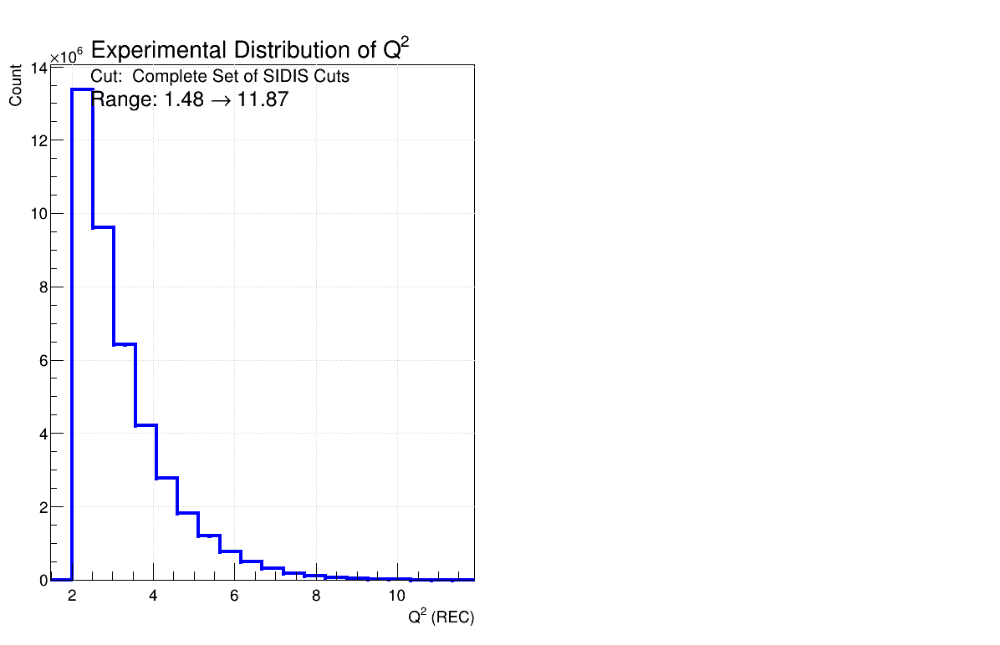

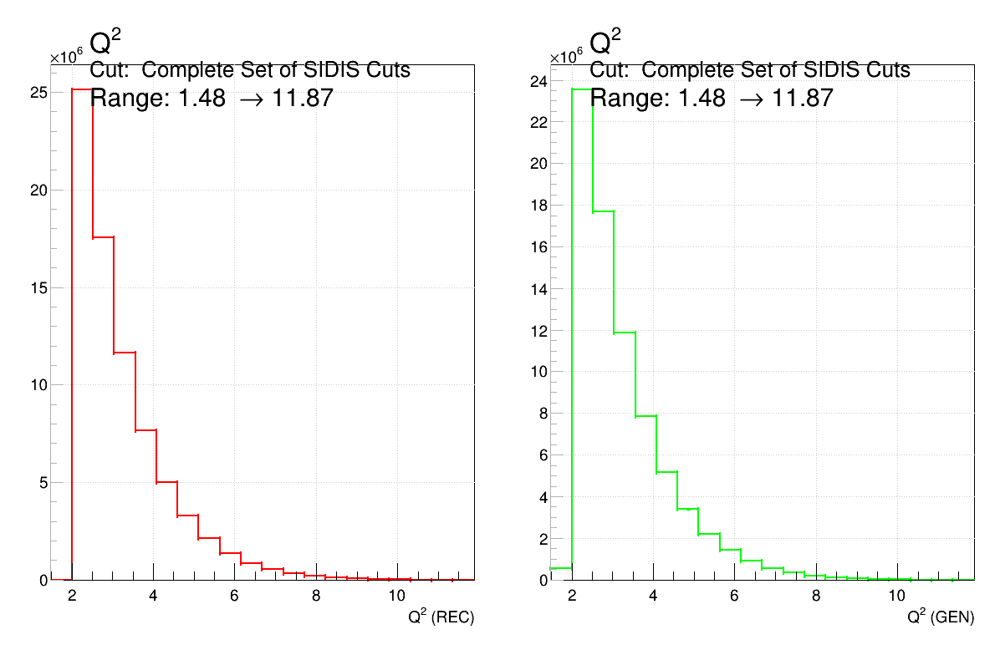

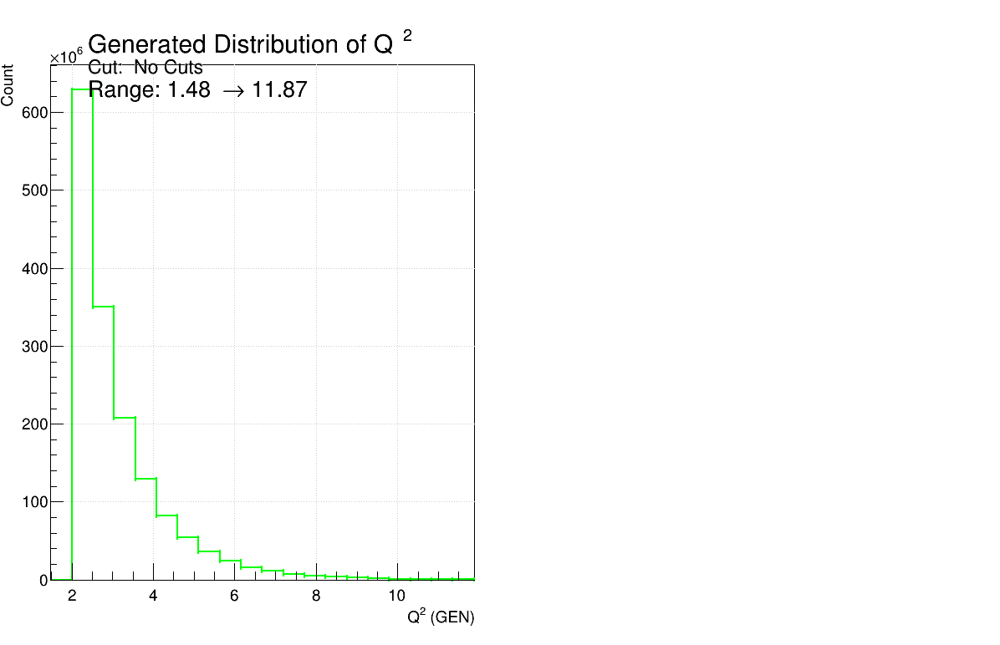

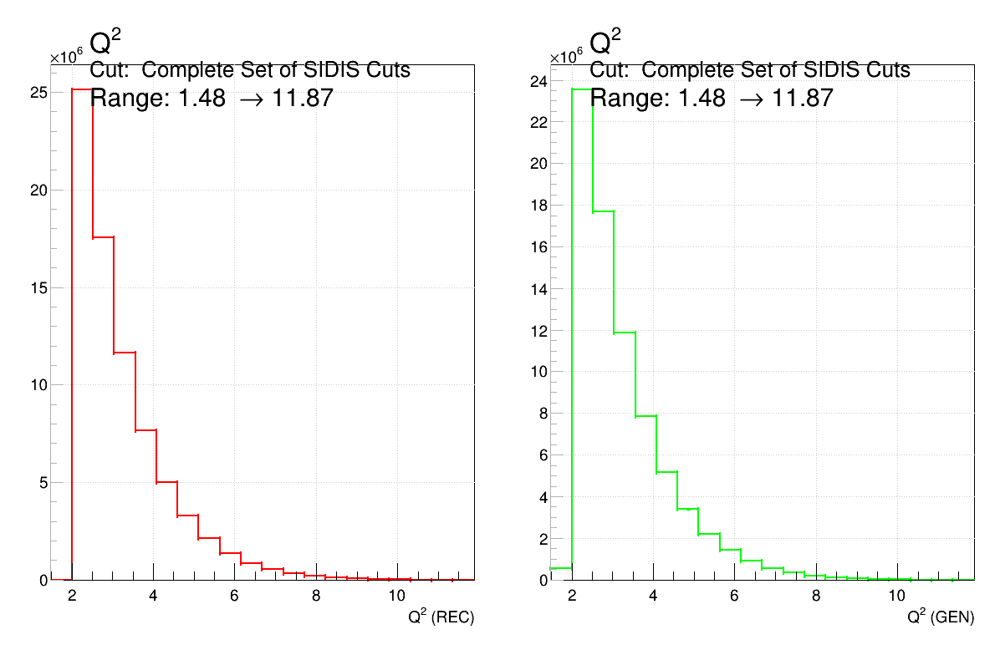

In [90]:
Run_this_cell = 'y'
# Run_this_cell = 'n'

Divide_or_1_canvas = "div"
Divide_or_1_canvas = "one"

print_as_response_or_acceptance = "Response"
# print_as_response_or_acceptance = "Acceptance"


if('y' in Run_this_cell):
    
    canvas_Unfolding, Unfolding_Histo, Unfolding_Histo_2, Stat_boxes, line_list, Covariance_Matrix, Unfolding_Legend, Unfold_Obj, Unfolded_Histo, Unfolded_Determinate, Unfolded_Covariance_Matrix, Error_Matrix, Regularized_CV_Matrix, CD_Canvas_2 = {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}
    list_of_canvas = []

    for datatype in list_of_DF:
        data_files_list = "error"

        if(datatype == 'rdf'):
            datatype_file = "rdf"
            data_files_list = list_of_rdf_files
        if((datatype == 'mdf') or (datatype == 'pdf') or (datatype == 'udf') or ('miss_idf' in datatype)):
            datatype_file = "mdf"
            data_files_list = list_of_mdf_files
        if(datatype == 'gdf'):
            datatype_file = "gdf"
            data_files_list = list_of_gdf_files
        
        # print(data_files_list)
        
        if(data_files_list == "error"):
            print("\nERROR in data files.")
            continue
            
            
        for data_file in data_files_list:

            ##======================##========================##======================##
            ##==========##==========##     Openning TFile     ##==========##==========##
            ##======================##========================##======================##
            
            rdf = ROOT.TFile(str(FileLocation(str(data_file), str(datatype_file))), "READ")
            
            ################################################################################
            ##==========##==========##============================##==========##==========##
            ##==========##==========##     Loop of DataFrames     ##==========##==========##
            ##==========##==========##============================##==========##==========##
            ################################################################################
            
            for ii in rdf.GetListOfKeys():
                
                output_name = str(ii.GetName())
                   
                # print(output_name)
                
#                 if("gdf" in output_name):
#                     print(output_name)
                
                #################################################################################
                ##==========##==========##=============================##==========##==========##
                ##==========##==========##     Histogram Selection     ##==========##==========##
                ##==========##==========##=============================##==========##==========##
                #################################################################################
                    
#                 if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name or "'z'" in output_name or "'pT'" in output_name or "'xB'" in output_name)):
                if("Normal" in output_name and "Response" in output_name and ("'Q2'" in output_name) and ("SIDIS" in output_name or "gdf" in output_name)):
                    # if("1D" not in output_name and datatype_file != "mdf"):
                    #     # print("No option to print 2D Resonse Matricies from files that are not the MC matched files (mdf/pdf)")
                    #     continue
                    if("1D" in output_name and datatype_file == "mdf"):
                        # print("Do not need 1D MC REC histograms (will make from the Response Matrix)")
                        continue
                    if("EDIS'" in output_name):
                        # print("Skipping Exculsive Cuts")
                        continue
                    # if("no_cut" not in output_name or "smear" in output_name):
                    #     print("TEMP: Skips")
                    #     continue
                    # if(("no_cut" in output_name and datatype_file != "gdf") or ("no_cut" not in output_name and "cut_Complete_SIDIS" not in output_name) or ("smear" not in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance != "Response") or ("smear" in output_name and datatype_file != "rdf" and datatype_file != "gdf" and print_as_response_or_acceptance == "Response")):
                    #     # print("TEMP: Skips")
                    #     continue
                    #if("smear" not in output_name):
                    #    # print("Skipping Unsmeared histograms")
                    #    continue
                        
                        
                    # print(output_name)

                    
                    ###############################################################################################
                    ##==========##==========##===========================================##==========##==========##
                    ##==========##==========##     (Basic) Histogram/Canvas Creation     ##==========##==========##
                    ##==========##==========##===========================================##==========##==========##
                    ###############################################################################################
                    for Dimension in ["1D"]:
                    # for Dimension in ["2D", "1D"]:
                        if("1D" in output_name and Dimension == "2D"):
                            continue
                        canvas_name = ((((((output_name.replace("gdf", "data")).replace("rdf", "data")).replace("mdf", "data")).replace("pdf", "data")).replace("_smeared", "")).replace(" (Smeared)", "")).replace("new", "New")
                        
                        if(len(list_of_DF) > 1 and Divide_or_1_canvas == "one"):
                            canvas_name = "".join([canvas_name, "_", str(Dimension), "_", str(datatype)])
                        else:
                            canvas_name = "".join([canvas_name, "_", str(Dimension)])
                        
                        # print(output_name)

                        if(canvas_name not in list_of_canvas):
                            list_of_canvas.append(canvas_name)
                            count_mdf_s, count_mdf = 0, 0

                        try:
                            Unfolding_Histo[str((output_name, datatype_file))] = rdf.Get(output_name)
                        except:
                            print("".join([color.BOLD, "\n\nError with the histogram...\n\n", color.END]))
                            

                        try:
                            canvas_Unfolding[canvas_name]
                        except:
                            canvas_Unfolding[canvas_name] = ROOT.TCanvas(canvas_name, canvas_name, 1500 if(Divide_or_1_canvas != "one") else 1200 if(Dimension == "1D") else 600, 800)
                            canvas_Unfolding[canvas_name].Divide(3 if(Divide_or_1_canvas != "one") else 2 if(Dimension == "1D") else 1, 1, 0.001, 0.001)
                            canvas_Unfolding[canvas_name].SetGrid()
                            ROOT.gStyle.SetAxisColor(16, 'xy')
                            ROOT.gStyle.SetOptStat(0)
                            ROOT.gStyle.SetOptFit(1)
                            Num_of_canvas_made += 1

                        Draw_Canvas(canvas_Unfolding[canvas_name], 1 if(Divide_or_1_canvas == "one") else 1 if("rdf" in datatype_file) else 2 if("mdf" in datatype_file and "smeared" not in output_name) else 3, 0.05, 0, 0, 0)
                        
                        if(print_as_response_or_acceptance != "Acceptance"):
                            ROOT.gPad.SetLogz(1)
                        else:
                            ROOT.gPad.SetLogz(0)

                        Unfolding_Histo[str((output_name, datatype_file))].SetLineColor(root_color.Blue if("rdf" in datatype_file) else root_color.Red if("mdf" in datatype_file) else root_color.Green)
                        Unfolding_Histo[str((output_name, datatype_file))].SetLineWidth(4 if("rdf" in datatype_file) else 3 if("mdf" in datatype_file and "smeared" not in output_name) else 2)
                        
                        if(print_as_response_or_acceptance == "Acceptance" and ("mdf" in output_name or "pdf" in output_name) and "Response_Matrix_1D" not in output_name):# and Dimension != "1D"):
                            try:
                                gdf = ROOT.TFile(str(FileLocation(str(data_file), "gdf")), "READ")
                                output_name_gdf = (((((((output_name.replace("mdf", "gdf")).replace("pdf", "gdf")).replace("cut_Complete_SIDIS", "no_cut")).replace("smear_", "")).replace("_smeared", "")).replace("smear", "")).replace("'Response_Matrix'", "'Response_Matrix_1D'")).replace("'Response_Matrix_Normal'", "'Response_Matrix_Normal_1D'")

                                if(output_name_gdf not in gdf.GetListOfKeys()):
                                    print(color.RED + color.BOLD + "\n\n\nPotential error\n\n\n" + color.END)
                                histo_gdf = gdf.Get(output_name_gdf)
                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                    norm_bin_gen = histo_gdf.GetBinContent(jj)
                                    for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                        count_in_bin_ii_jj = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(jj, ii)
                                        if(norm_bin_gen != 0):
                                            Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, count_in_bin_ii_jj/norm_bin_gen)
                                        else:
                                            Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(jj, ii, 0)
                                Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle()).replace("Response", "Acceptance"))
                            except Exception as e:
                                print("".join([color.BOLD, color.RED, "Failed to get acceptance matrix...", color.END]))
                                print("".join([color.BOLD, color.RED, "ERROR:\n", str(e), color.END]))


                        if("1D" not in output_name and False):# and "Normal" not in output_name):
                            if("Bin_Res_4D" not in output_name):
                                for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):

                                    Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, 0)

                                    for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, overflow, 0)


                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):

                                    Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, 0)

                                    for overflow in range(overflow_bins, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(overflow, jj, 0)

                            else:
                                for ii in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsX() + 1, 1):
                                    low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 0)

                                    if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(ii, 1) == 0):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 1, low_overflow)
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(ii, 0, 0)
                                    else:
                                        print("\nError?\n")

                                for jj in range(0, Unfolding_Histo[str((output_name, datatype_file))].GetNbinsY() + 1, 1):
                                    low_overflow = Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(0, jj)

                                    if(Unfolding_Histo[str((output_name, datatype_file))].GetBinContent(1, jj) == 0):
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(1, jj, low_overflow)
                                        Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(0, jj, 0)
                                    else:
                                        print("\nError?\n")
                                        
                        if("gdf" in output_name):
                            print(output_name)
                            below_bin = Unfolding_Histo[str((output_name, datatype_file))].FindBin(1.5)
                            print(below_bin)
                            Unfolding_Histo[str((output_name, datatype_file))].SetBinContent(below_bin, 0)

                        Unfolding_Histo[str((output_name, datatype_file))].SetTitle((Unfolding_Histo[str((output_name, datatype_file))].GetTitle().replace("->", "#rightarrow")))

                        if("2D" in Dimension):
                            print("""testif("2D" in Dimension):""")
                            Unfolding_Histo[str((output_name, datatype_file))].Draw('colz')
                            palette_move(canvas_Unfolding[canvas_name], Unfolding_Histo[str((output_name, datatype_file))], 0, 0, 0, 0)
                        elif("1D" not in output_name):
                            # Unfolding_Histo[str((output_name, datatype_file))].GetYaxis().SetRangeUser(0.5 if("Bin_Res_4D" not in output_name) else -0.5, (overflow_bins - 2))
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionY()
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_rec"))].GetTitle()).replace("Response Matrix of ", ""))
                            
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetLineColor(root_color.Red)
                            Unfolding_Histo[str((output_name, "1D_rec"))].SetLineWidth(2)
                            Unfolding_Histo[str((output_name, "1D_rec"))].Draw('same E1 H')
                            
                            Draw_Canvas(canvas_Unfolding[canvas_name], 2, 0.05, 0, 0, 0)
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))] = Unfolding_Histo[str((output_name, datatype_file))].ProjectionX()
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetTitle(str(Unfolding_Histo[str((output_name, "1D_gen"))].GetTitle()).replace("Response Matrix of ", ""))
                            
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetLineColor(root_color.Green)
                            Unfolding_Histo[str((output_name, "1D_gen"))].SetLineWidth(2)
                            Unfolding_Histo[str((output_name, "1D_gen"))].Draw('same E1 H')
                            
                        else:
                            Unfolding_Histo[str((output_name, datatype_file))].Draw('same E1 H')
                            
for ii in canvas_Unfolding:
    canvas_Unfolding[ii].Draw()